Adapted from https://github.com/Specufex/specufex Specufex code

Created Feb 1, 2023
Updated Feb 15, 2023

In [1]:
#imports
from eqcorrscan import Tribe
import obspy
from obspy import Stream
import csv
import numpy as np
import pandas as pd
from glob import glob
import scipy.signal as sp
import yaml
import matplotlib.pyplot as plt
from tqdm import trange

from specufex import BayesianNonparametricNMF, BayesianHMM

#set parameters
# path = '/home/smocz/expand_redpy_new_files/templates/' #path to .tgz file
# volcano = 'Rainier'
# filename = f'Volcano_{volc}_Network_*_Station_*_Channel_*.tgz' #name of .tgz files to glob
# T = Tribe().read(f'{path}{filename}') #read the .tgz file, use for skipping a the volcano loop

Matched-filter CPU is not compiled! Should be here: /home/jupyter_share/miniconda3/envs/seismo/lib/python3.8/site-packages/fast_matched_filter/lib/matched_filter_CPU.so


In [2]:
#set parameters
with open('/home/smocz/expand_redpy/scripts/config.yaml') as file:
    config = yaml.load(file, Loader=yaml.FullLoader)
    
volc_list_names = config['volc_list_names']
vv = config['vv']
volc = volc_list_names[vv]
print(volc)
filename = f'Volcano_{volc}_Network_*_Station_*_Channel_*.tgz' #name of .tgz files to glob
homedir = config['homedir']
path = homedir+'templates/'

winlen = 40

fs = config['fs']
len_data = 10000
fqmin = config['fqmin']
fqmax = config['fqmax']

# spectrogram parameters
sgramMode='magnitude'
sgramScaling='spectrum'

# frequency/time resolution
nperseg = 64 #affects time resolution
noverlap = nperseg/4
nfft = 1024

Baker


## functions

In [3]:
# create window with max possible sum(abs(amplitudes))
# goal is to align stream windows and provide shorter windows without as much noise
def maxwindow(st,winlen): #provide stream object (one trace each) and window length in s
    fs = st[0].stats.sampling_rate
    stt = st[0].stats.starttime
        
    numwindows = round(len(st[0])/fs)-winlen+1 #how many windows will be cycled (+1 is for range)
    print('number of windows:',numwindows-1)

    sum_list = []
    for i in range(0,numwindows):
        tr = st[0].copy() #create copy to avoid trimming st[0]
        tt = tr.trim(stt+i,stt+i+winlen) #trim to a window the length of winlen

        amps_list = []
        for ii in tt: #for each amplitude/point in the trace
            amps_list.append(abs(ii)) #append the amplitude 
        sum_list.append(sum(amps_list)) #sum and save the amplitude for this possible window

    max_inx = sum_list.index(max(sum_list)) #find the index of the window with maximum sum(abs(amplitudes))
    
    print('maximum amp window index:',max_inx) #
    
    final_tr = st[0].copy()

    
    tr_trim = final_tr.trim(stt+max_inx,stt+max_inx+winlen) #use index to find the window
    print('Max Window:')
    tr_trim.plot();
    
    return(Stream(tr_trim))

## Create spectrogram from templates

Create a dataframe of trimmed template waveforms

vdbehzrpba013 template original stream:


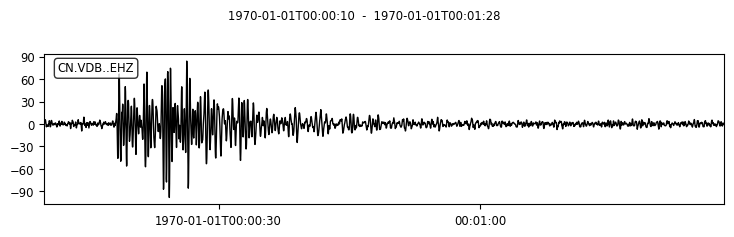

number of windows: 38
maximum amp window index: 8
Max Window:


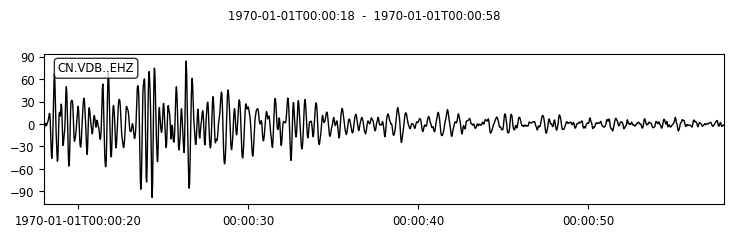

---
vdbehzrpba017 template original stream:


/home/jupyter_share/miniconda3/envs/seismo/lib/python3.8/site-packages/pandas/core/dtypes/cast.py:948: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  element = np.asarray(element)


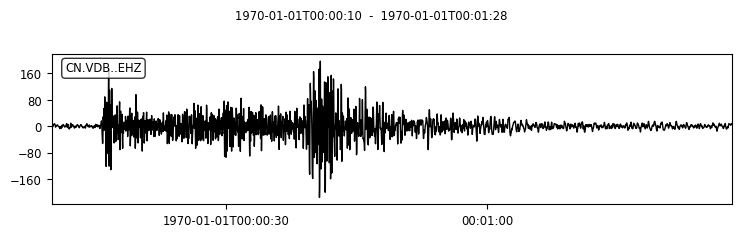

number of windows: 38
maximum amp window index: 6
Max Window:


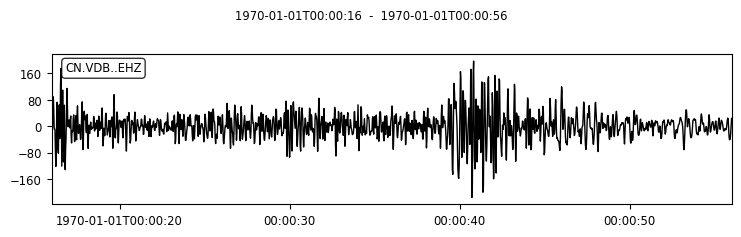

---
vdbehzrpba018 template original stream:


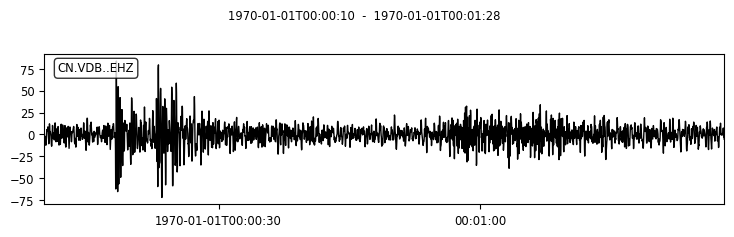

number of windows: 38
maximum amp window index: 8
Max Window:


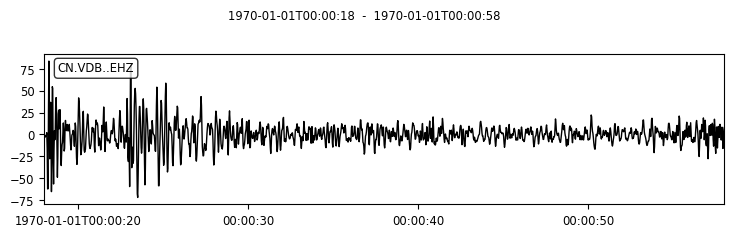

---
vdbehzrpba019 template original stream:


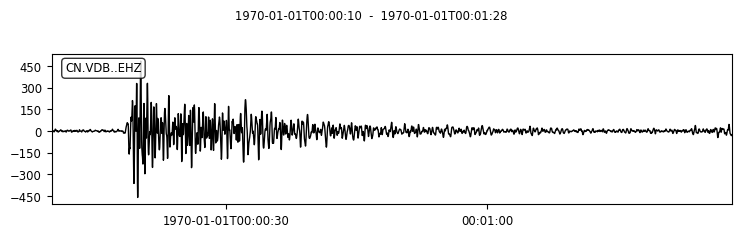

number of windows: 38
maximum amp window index: 8
Max Window:


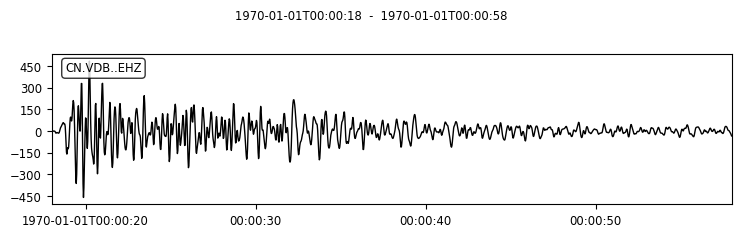

---
vdbehzrpba020 template original stream:


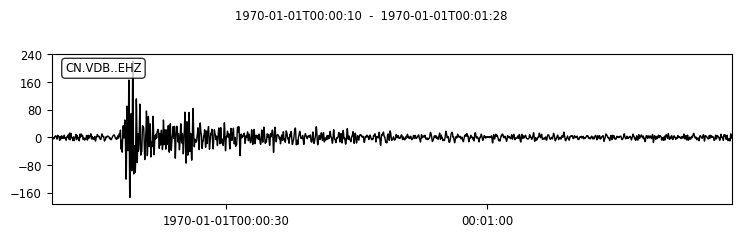

number of windows: 38
maximum amp window index: 7
Max Window:


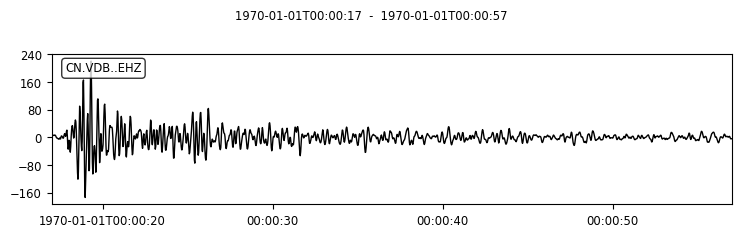

---
vdbehzrpba021 template original stream:


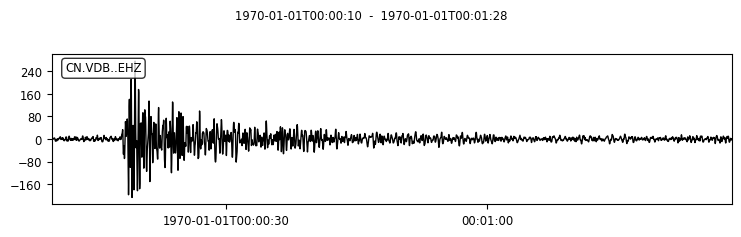

number of windows: 38
maximum amp window index: 8
Max Window:


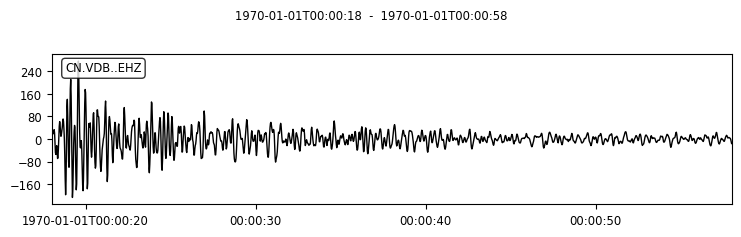

---
vdbehzrpba022 template original stream:


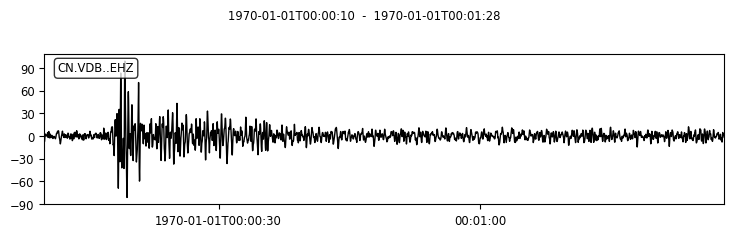

number of windows: 38
maximum amp window index: 7
Max Window:


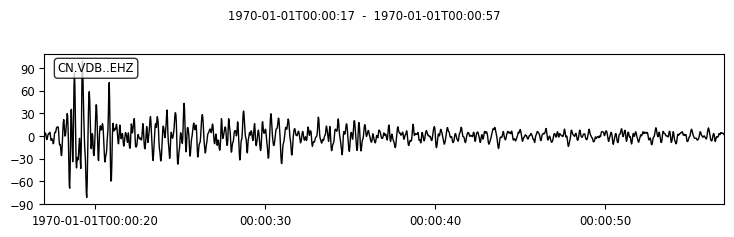

---
vdbehzrpba023 template original stream:


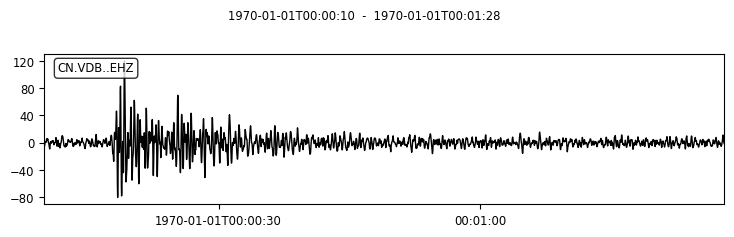

number of windows: 38
maximum amp window index: 7
Max Window:


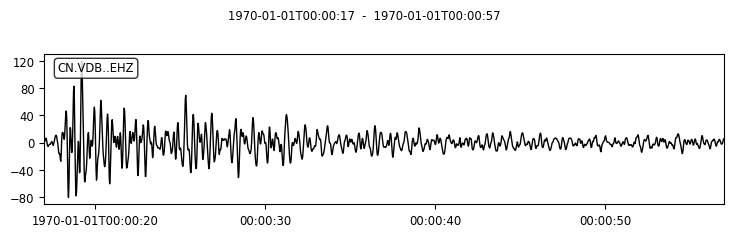

---
vdbehzrpba024 template original stream:


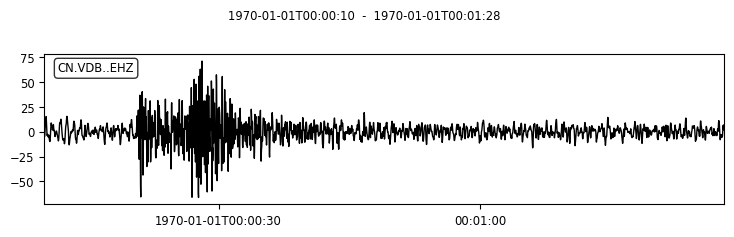

number of windows: 38
maximum amp window index: 0
Max Window:


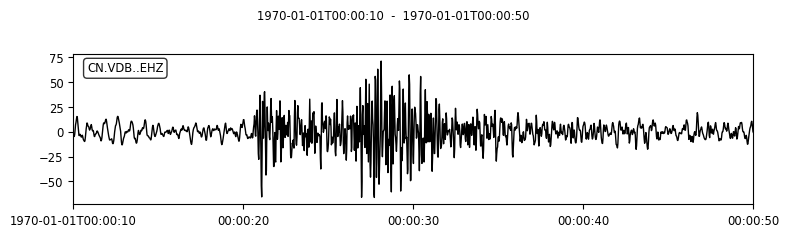

---
vdbehzrpba025 template original stream:


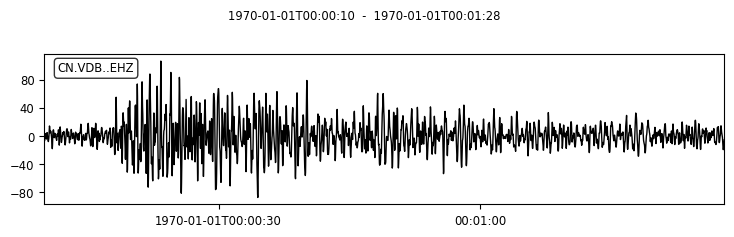

number of windows: 38
maximum amp window index: 9
Max Window:


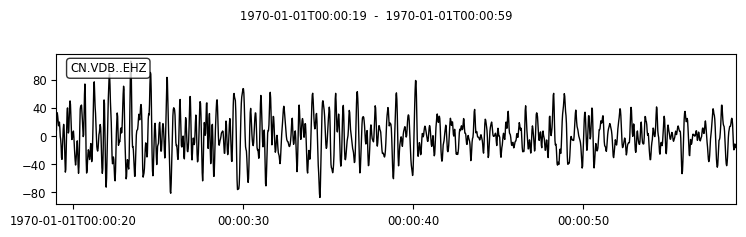

---
vdbehzrpba027 template original stream:


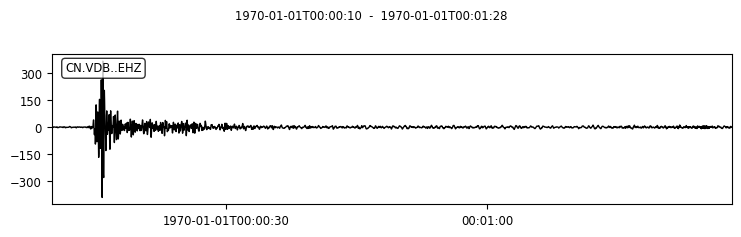

number of windows: 38
maximum amp window index: 4
Max Window:


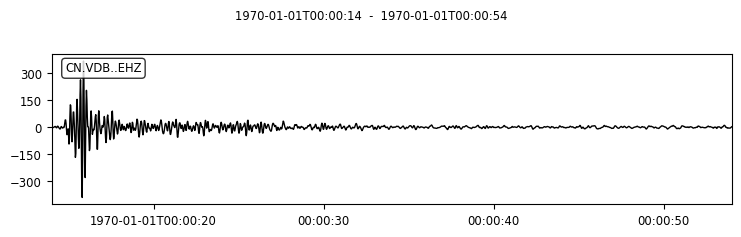

---
vdbehzrpba029 template original stream:


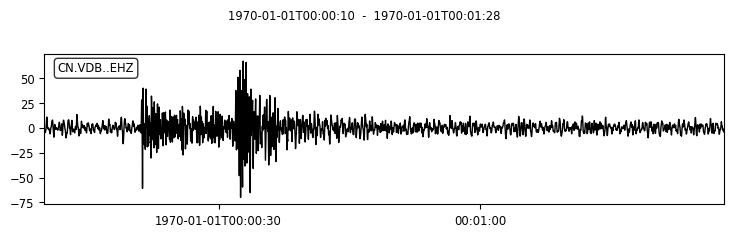

number of windows: 38
maximum amp window index: 9
Max Window:


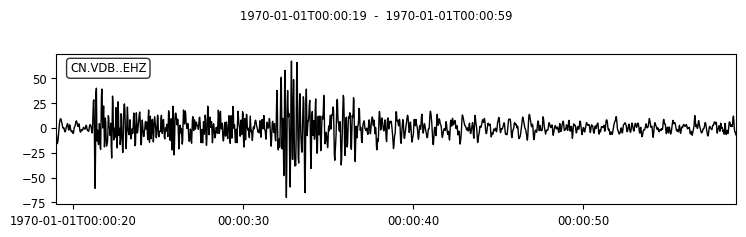

---
vdbehzrpba032 template original stream:


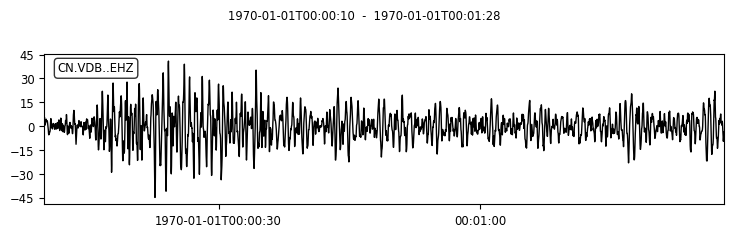

number of windows: 38
maximum amp window index: 6
Max Window:


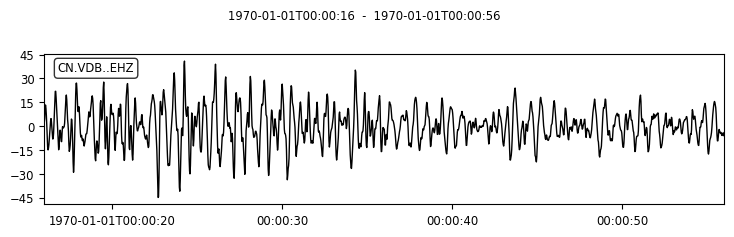

---
vdbehzrpba033 template original stream:


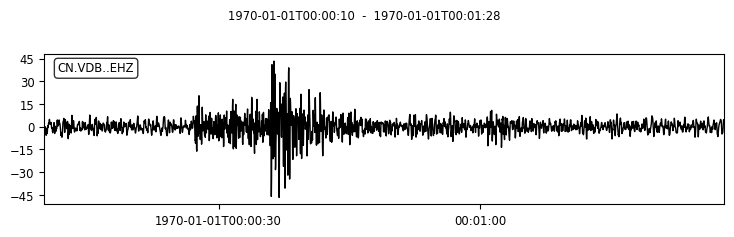

number of windows: 38
maximum amp window index: 17
Max Window:


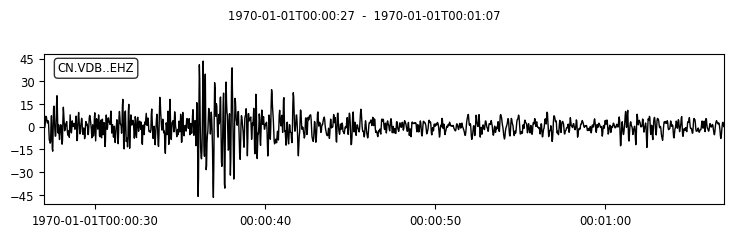

---
vdbehzrpba034 template original stream:


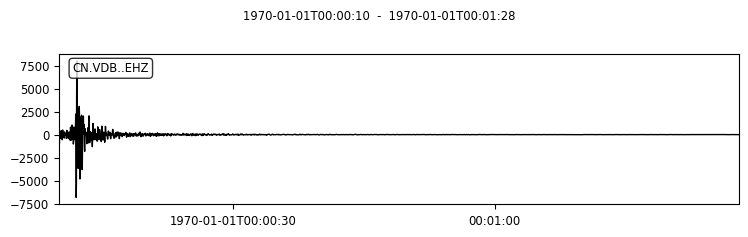

number of windows: 38
maximum amp window index: 0
Max Window:


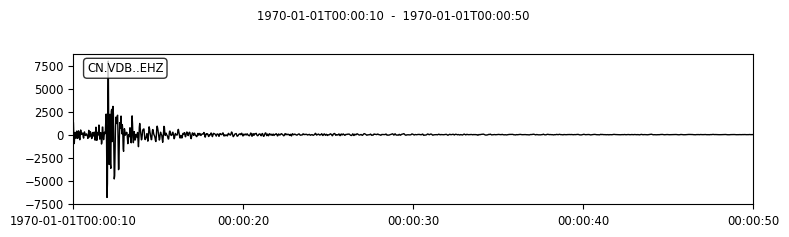

---
vdbehzrpba036 template original stream:


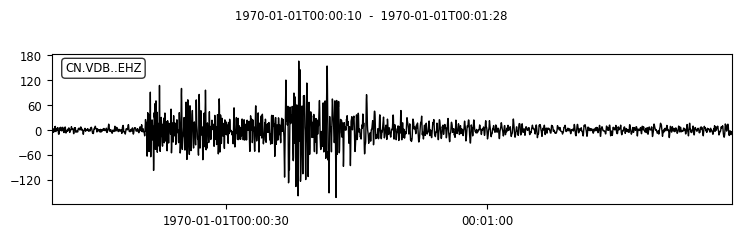

number of windows: 38
maximum amp window index: 10
Max Window:


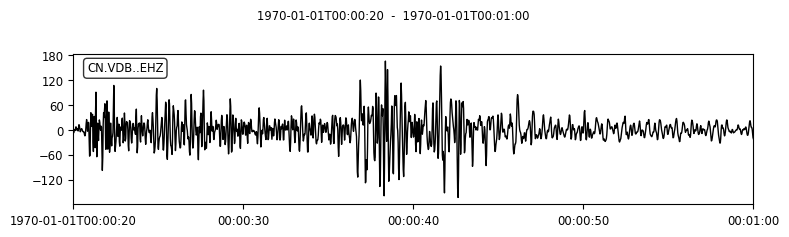

---
vdbehzrpba037 template original stream:


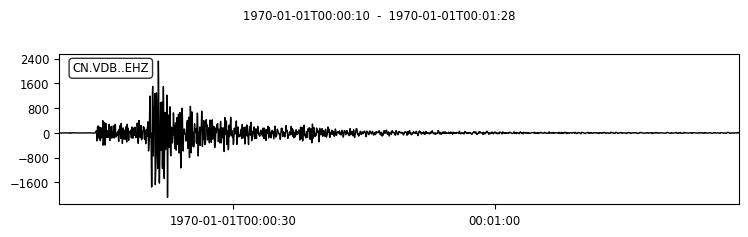

number of windows: 38
maximum amp window index: 4
Max Window:


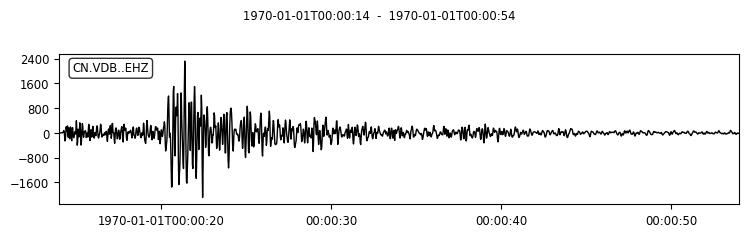

---
vdbehzrpba038 template original stream:


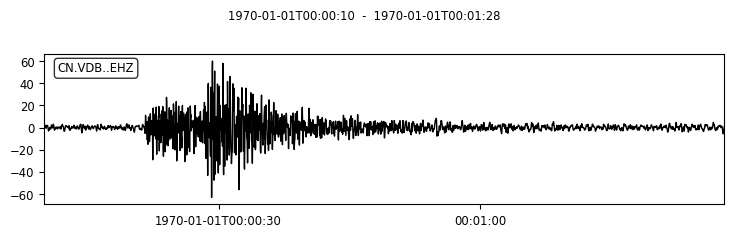

number of windows: 38
maximum amp window index: 11
Max Window:


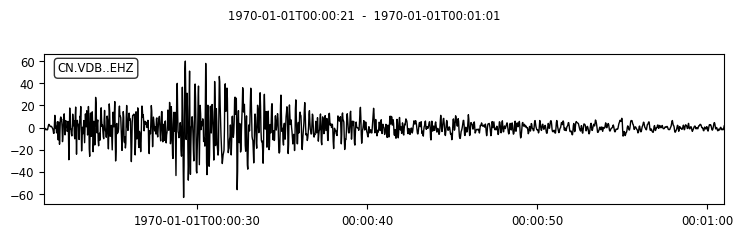

---
vdbehzrpba044 template original stream:


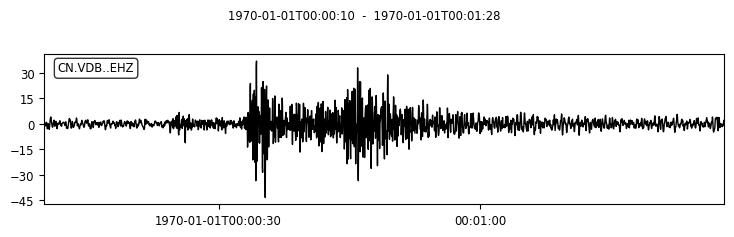

number of windows: 38
maximum amp window index: 23
Max Window:


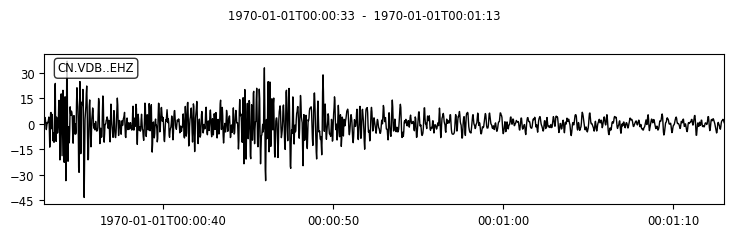

---
vdbehzrpba049 template original stream:


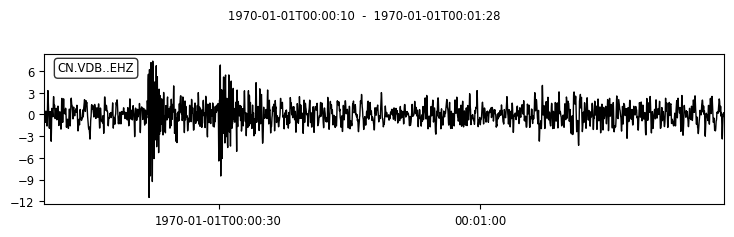

number of windows: 38
maximum amp window index: 0
Max Window:


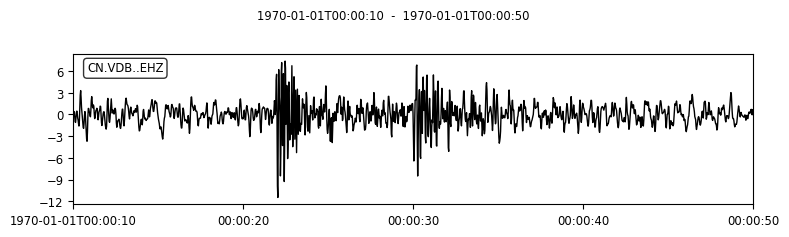

---
vdbehzrpba050 template original stream:


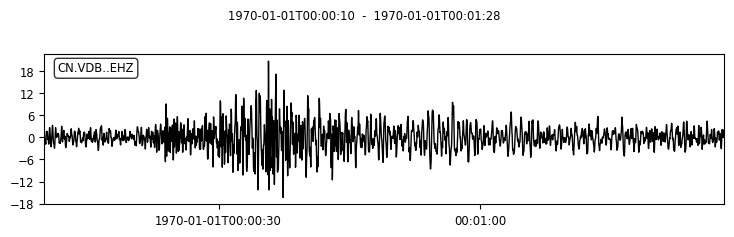

number of windows: 38
maximum amp window index: 14
Max Window:


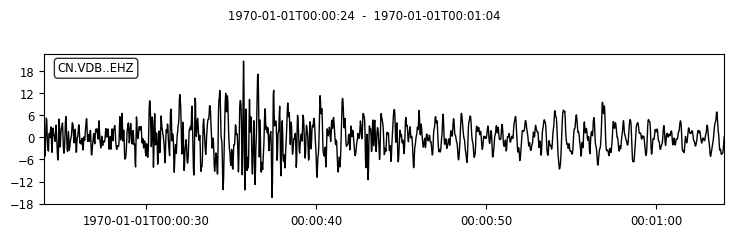

---
vdbehzrpba051 template original stream:


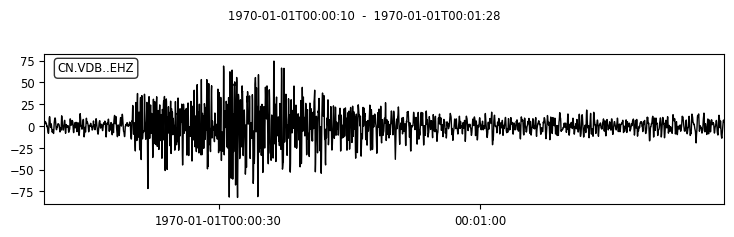

number of windows: 38
maximum amp window index: 7
Max Window:


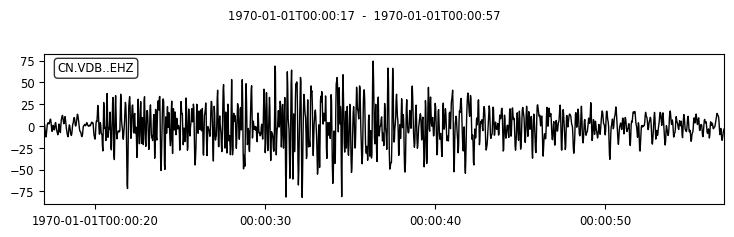

---
vdbehzrpba053 template original stream:


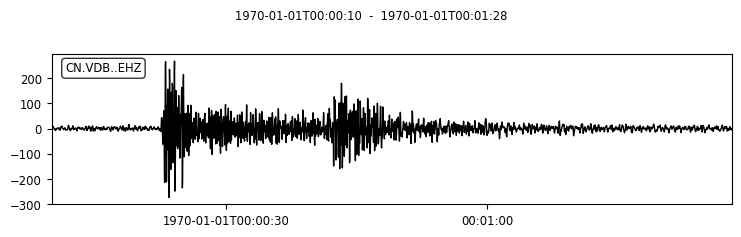

number of windows: 38
maximum amp window index: 12
Max Window:


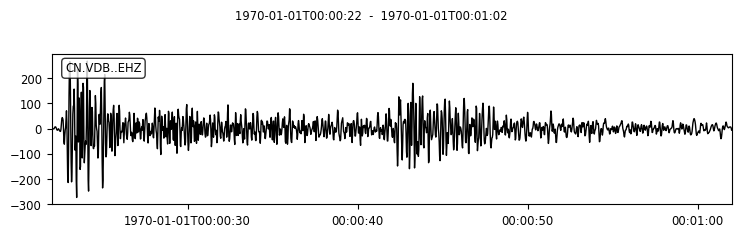

---
vdbehzrpba055 template original stream:


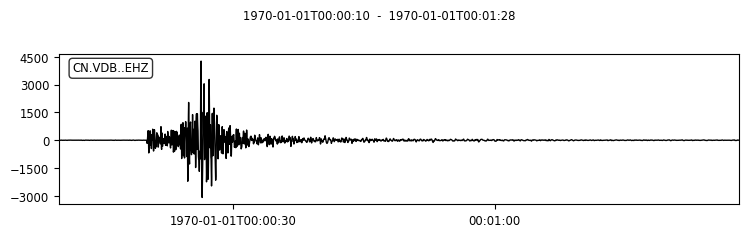

number of windows: 38
maximum amp window index: 10
Max Window:


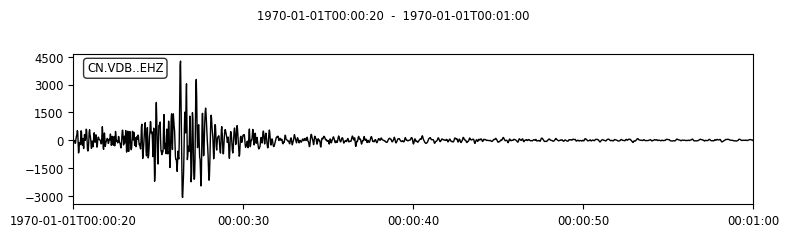

---
vdbehzrpba056 template original stream:


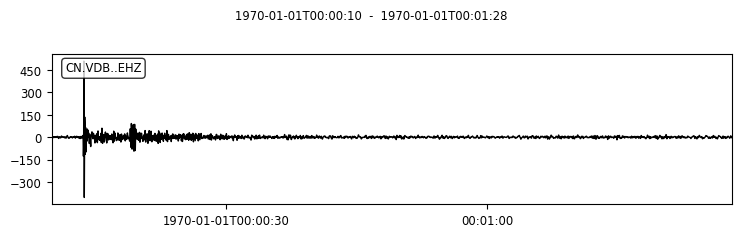

number of windows: 38
maximum amp window index: 1
Max Window:


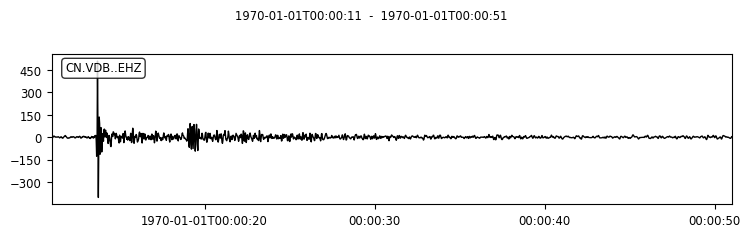

---
vdbehzrpba057 template original stream:


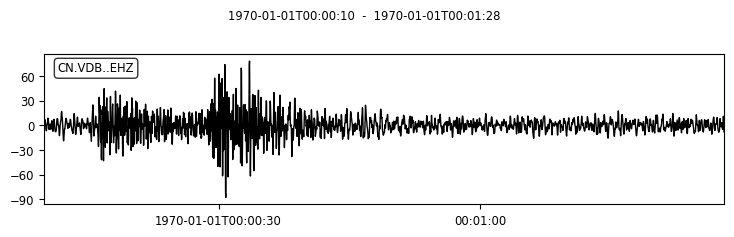

number of windows: 38
maximum amp window index: 2
Max Window:


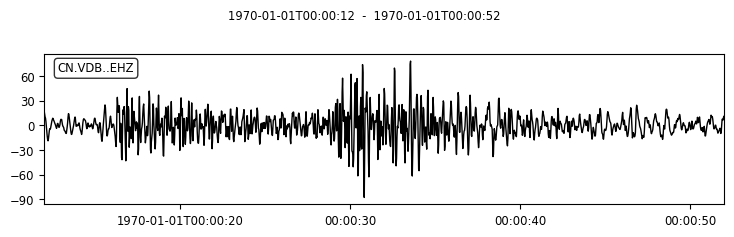

---
vdbehzrpba058 template original stream:


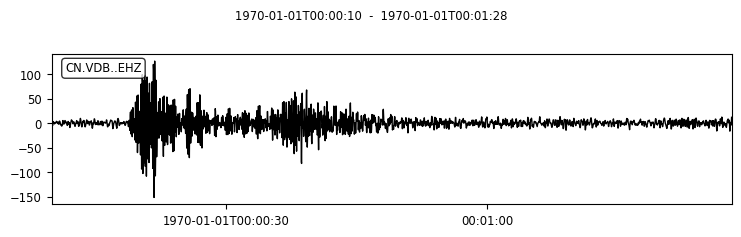

number of windows: 38
maximum amp window index: 7
Max Window:


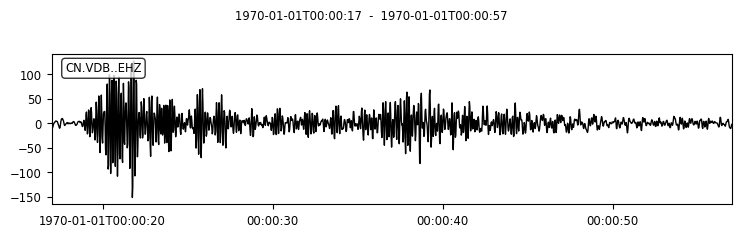

---
vdbehzrpba059 template original stream:


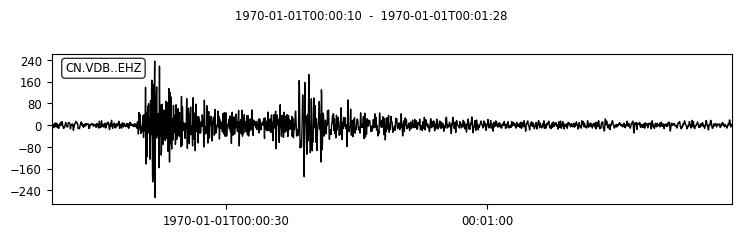

number of windows: 38
maximum amp window index: 10
Max Window:


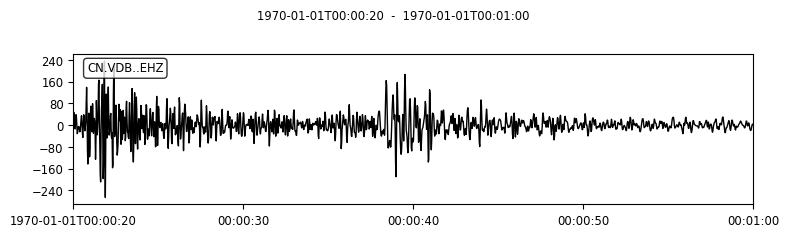

---
vdbehzrpba060 template original stream:


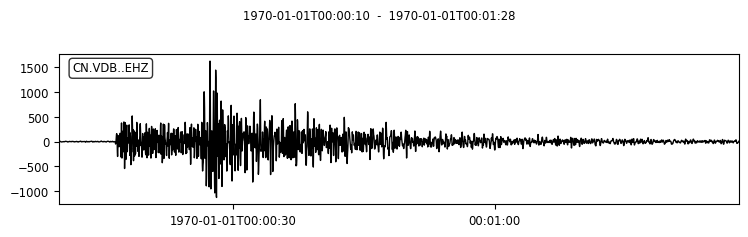

number of windows: 38
maximum amp window index: 7
Max Window:


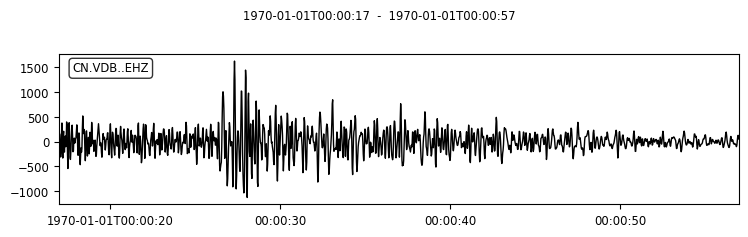

---
vdbehzrpba063 template original stream:


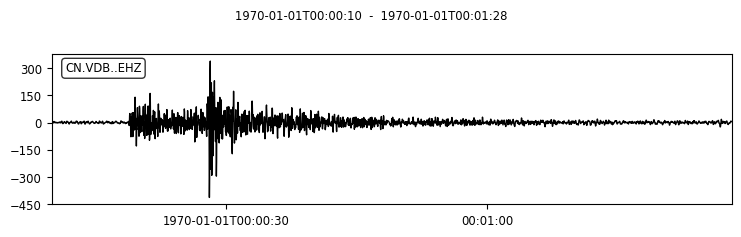

number of windows: 38
maximum amp window index: 9
Max Window:


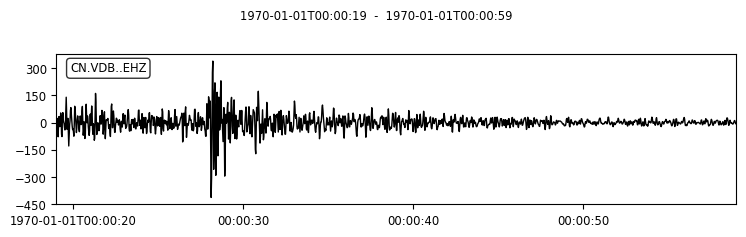

---
vdbehzrpba064 template original stream:


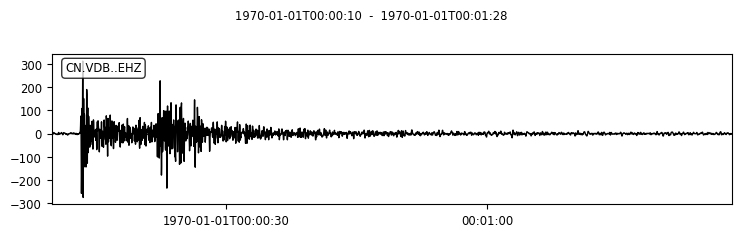

number of windows: 38
maximum amp window index: 3
Max Window:


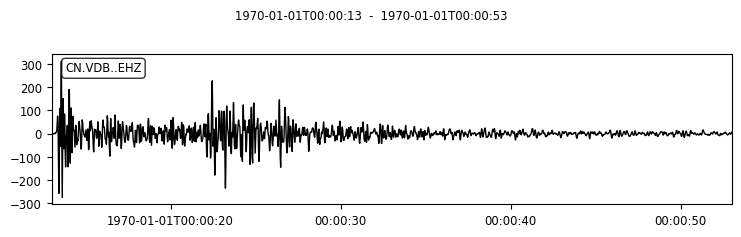

---
vdbehzrpba065 template original stream:


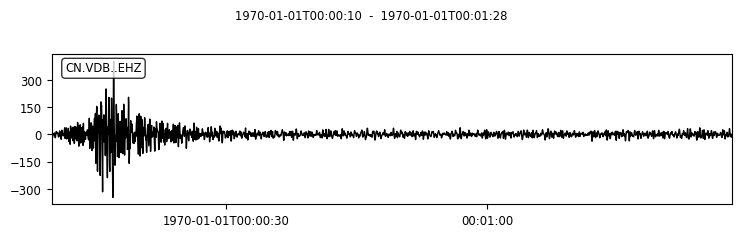

number of windows: 38
maximum amp window index: 0
Max Window:


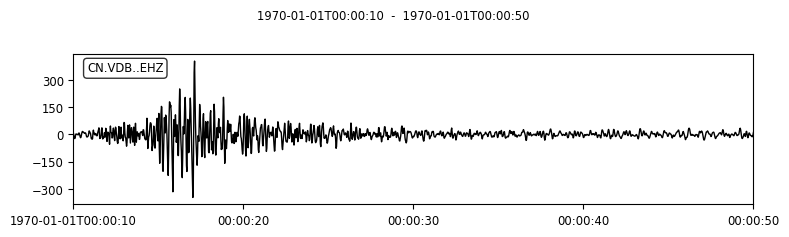

---
vdbehzrpba066 template original stream:


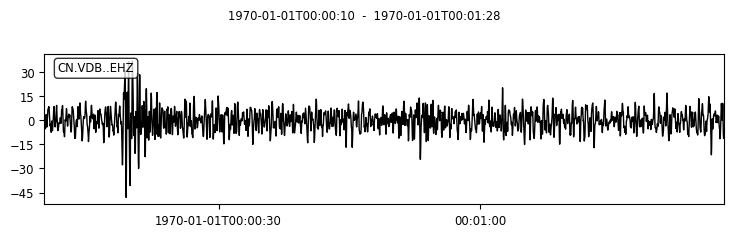

number of windows: 38
maximum amp window index: 4
Max Window:


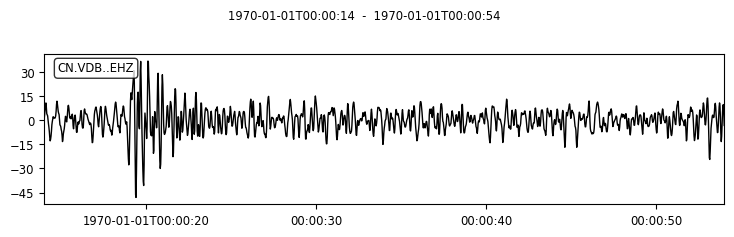

---
vdbehzrpba067 template original stream:


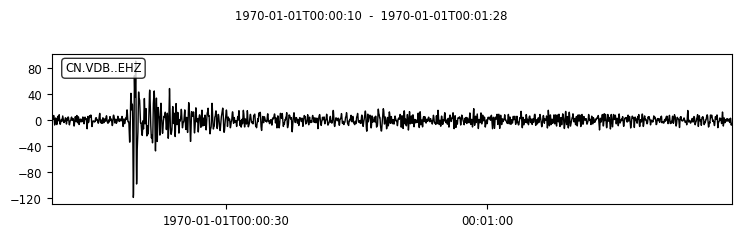

number of windows: 38
maximum amp window index: 8
Max Window:


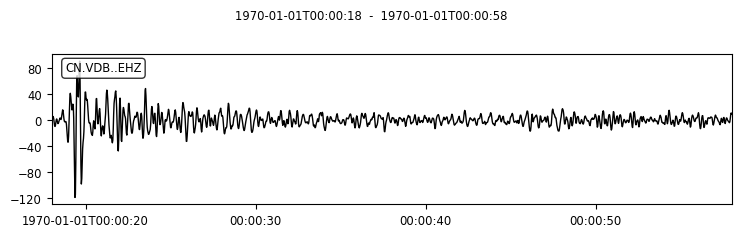

---
vdbehzrpba068 template original stream:


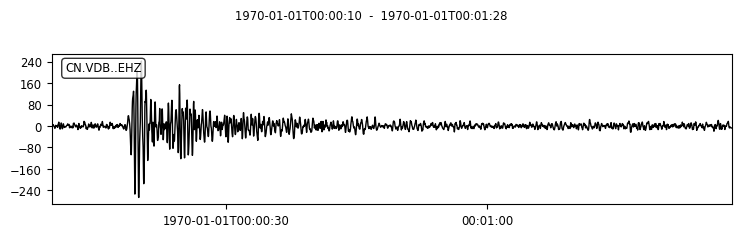

number of windows: 38
maximum amp window index: 8
Max Window:


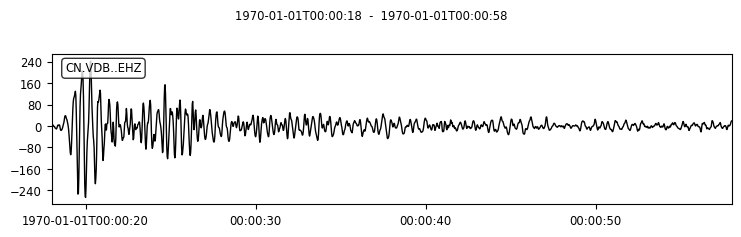

---
vdbehzrpba070 template original stream:


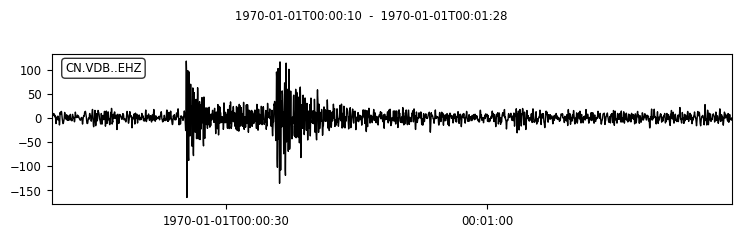

number of windows: 38
maximum amp window index: 15
Max Window:


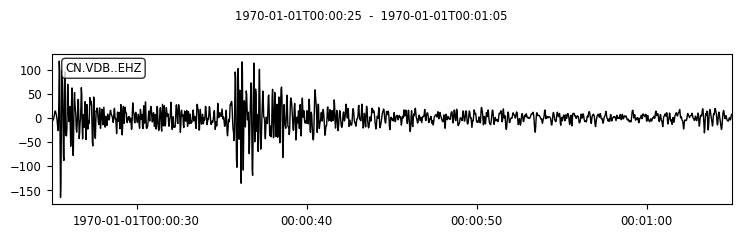

---
vdbehzrpba071 template original stream:


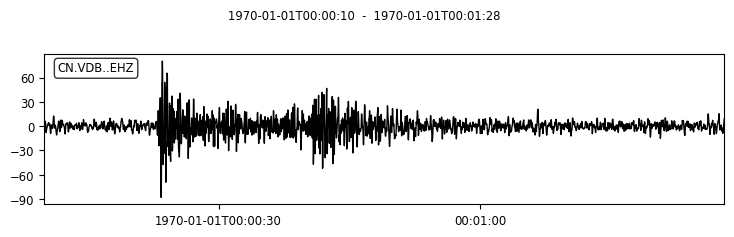

number of windows: 38
maximum amp window index: 12
Max Window:


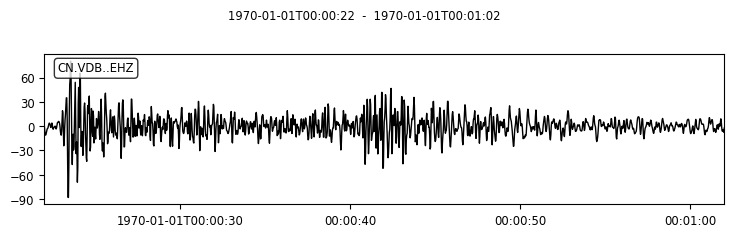

---
vdbehzrpba076 template original stream:


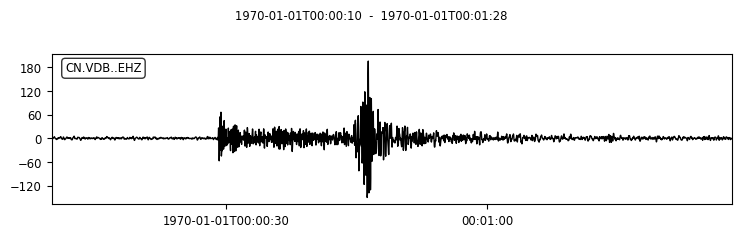

number of windows: 38
maximum amp window index: 19
Max Window:


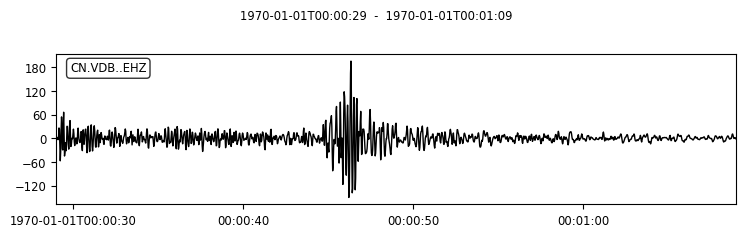

---
vdbehzrpba077 template original stream:


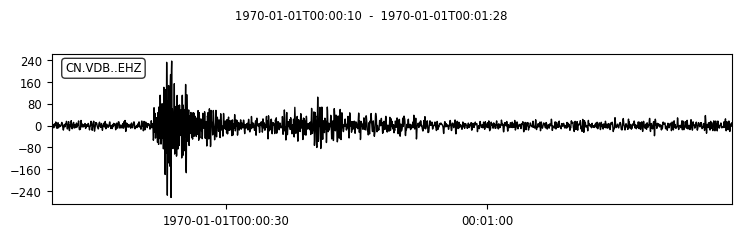

number of windows: 38
maximum amp window index: 7
Max Window:


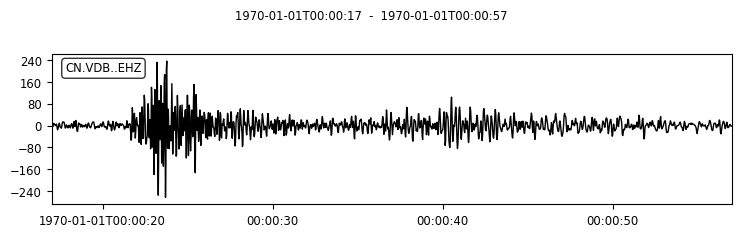

---
vdbehzrpba078 template original stream:


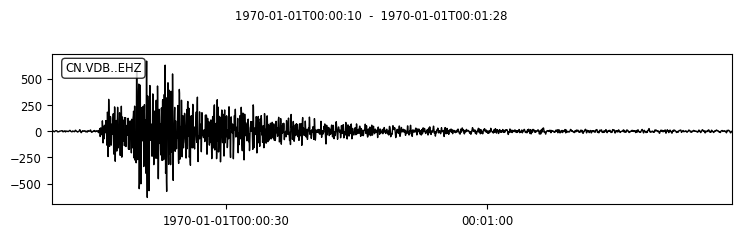

number of windows: 38
maximum amp window index: 5
Max Window:


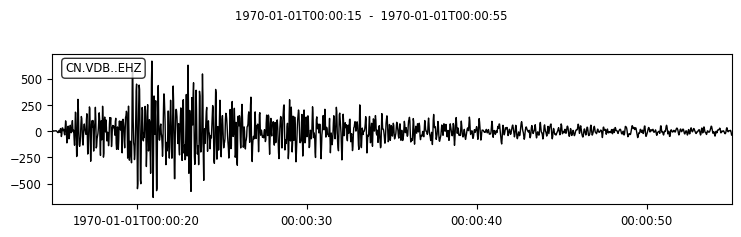

---
vdbehzrpba079 template original stream:


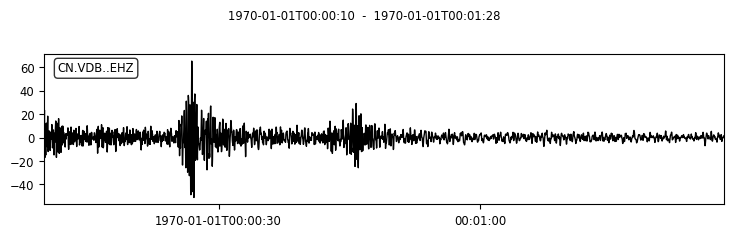

number of windows: 38
maximum amp window index: 0
Max Window:


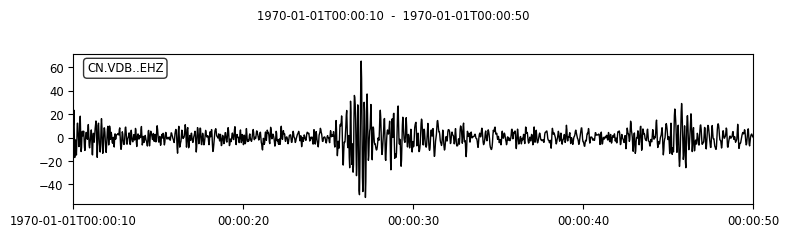

---
vdbehzrpba080 template original stream:


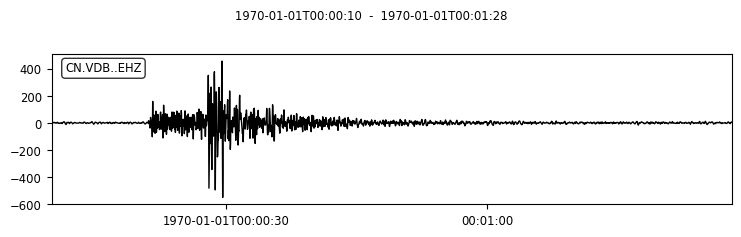

number of windows: 38
maximum amp window index: 11
Max Window:


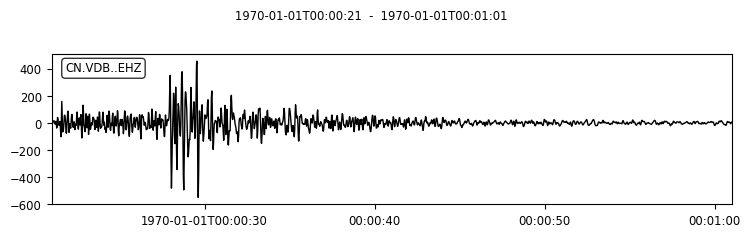

---
vdbehzrpba081 template original stream:


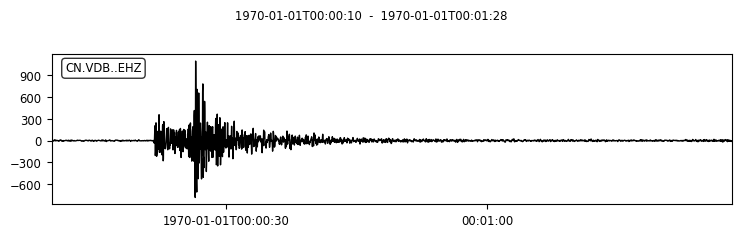

number of windows: 38
maximum amp window index: 11
Max Window:


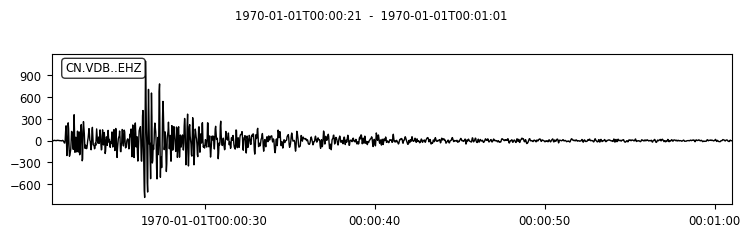

---
vdbehzrpba084 template original stream:


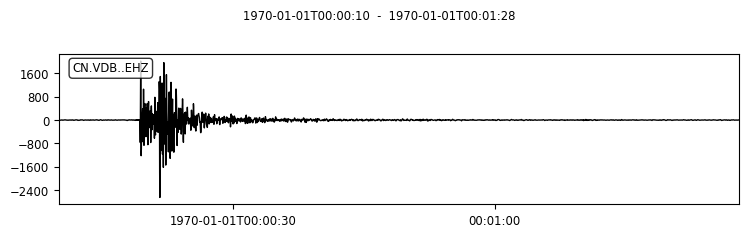

number of windows: 38
maximum amp window index: 9
Max Window:


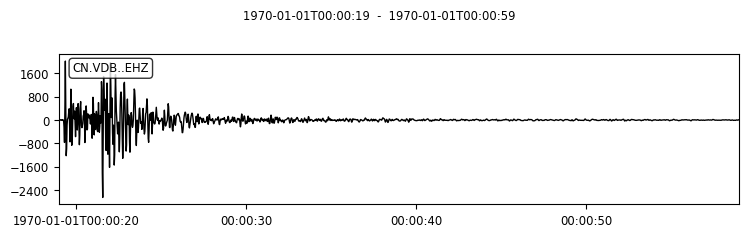

---
vdbehzrpba085 template original stream:


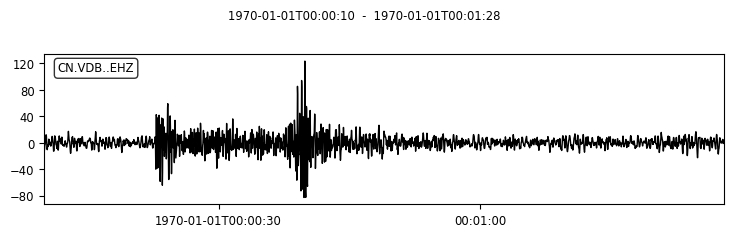

number of windows: 38
maximum amp window index: 11
Max Window:


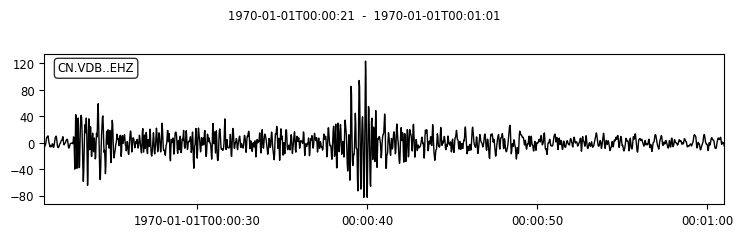

---
vdbehzrpba086 template original stream:


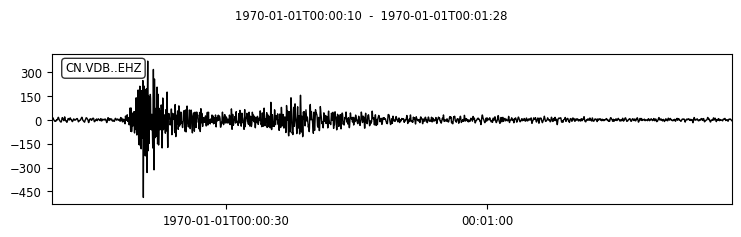

number of windows: 38
maximum amp window index: 8
Max Window:


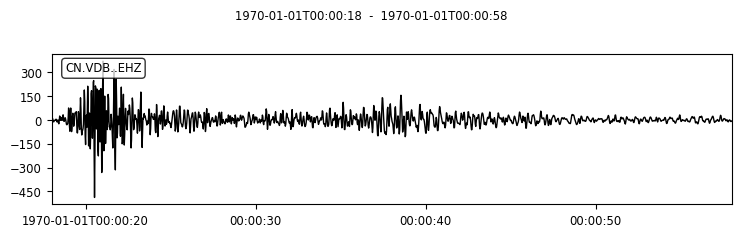

---
vdbehzrpba087 template original stream:


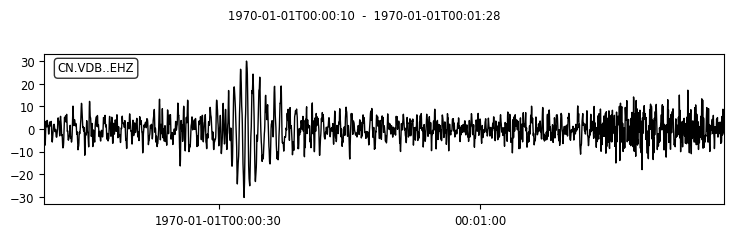

number of windows: 38
maximum amp window index: 2
Max Window:


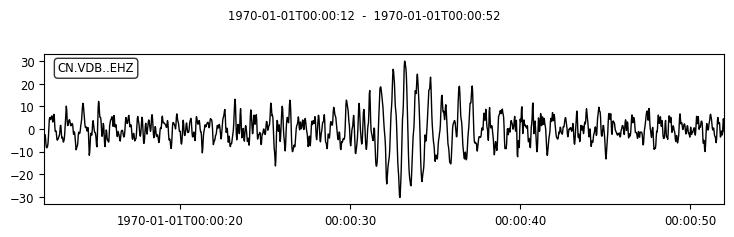

---
vdbehzrpba089 template original stream:


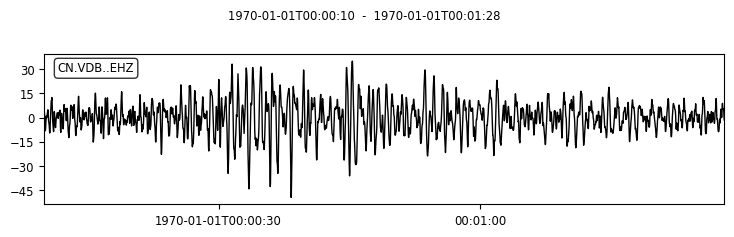

number of windows: 38
maximum amp window index: 13
Max Window:


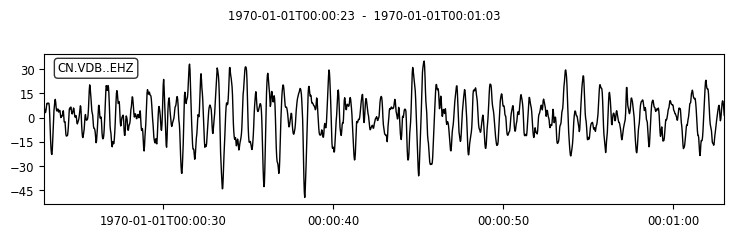

---
vdbehzrpba090 template original stream:


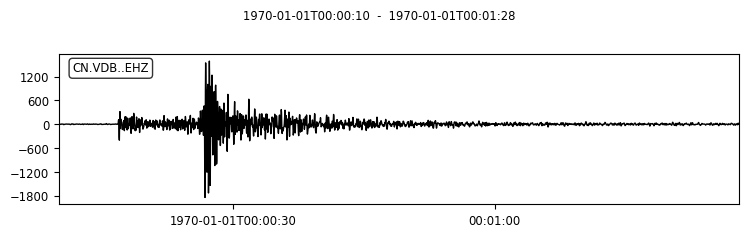

number of windows: 38
maximum amp window index: 6
Max Window:


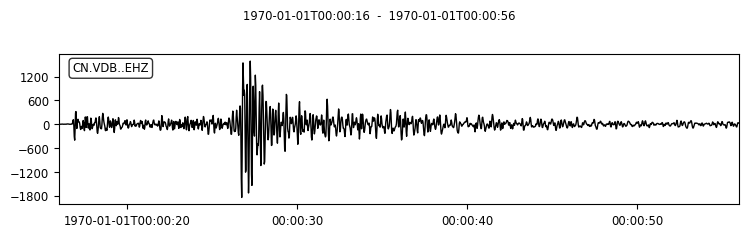

---
vdbehzrpba091 template original stream:


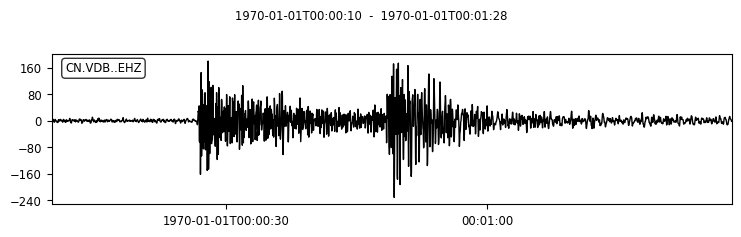

number of windows: 38
maximum amp window index: 16
Max Window:


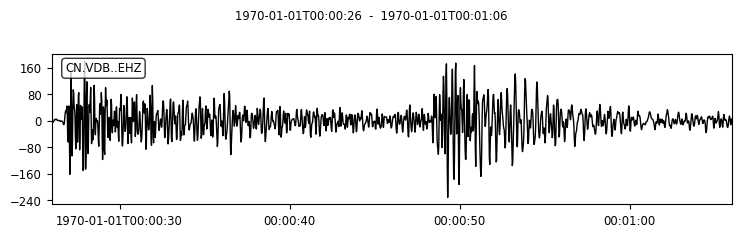

---
vdbehzrpba093 template original stream:


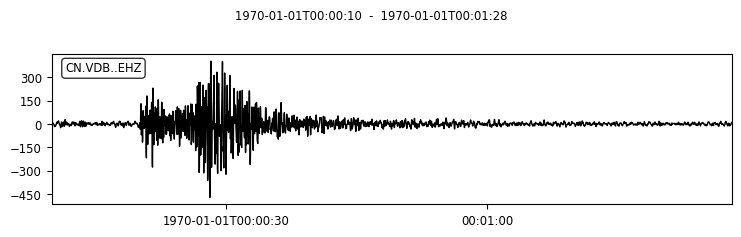

number of windows: 38
maximum amp window index: 9
Max Window:


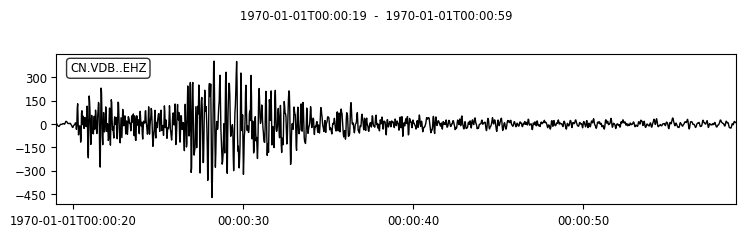

---
vdbehzrpba095 template original stream:


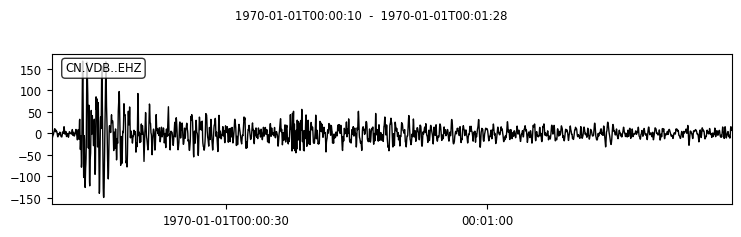

number of windows: 38
maximum amp window index: 3
Max Window:


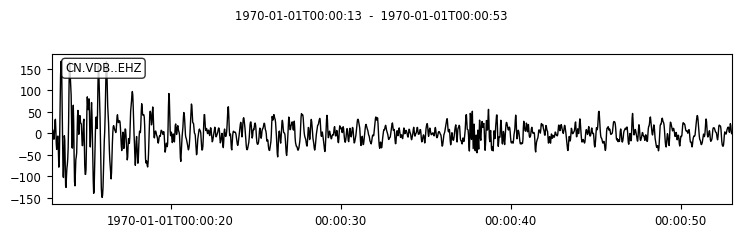

---
vdbehzrpba098 template original stream:


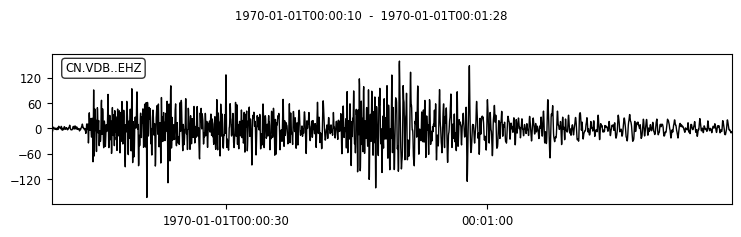

number of windows: 38
maximum amp window index: 8
Max Window:


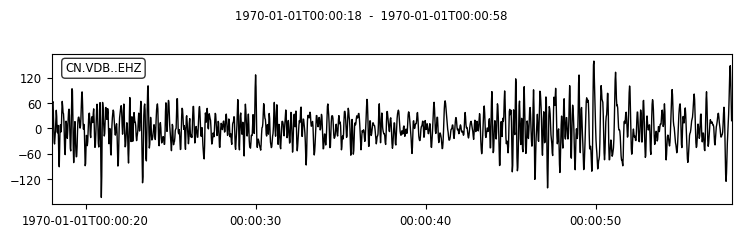

---
vdbehzrpba100 template original stream:


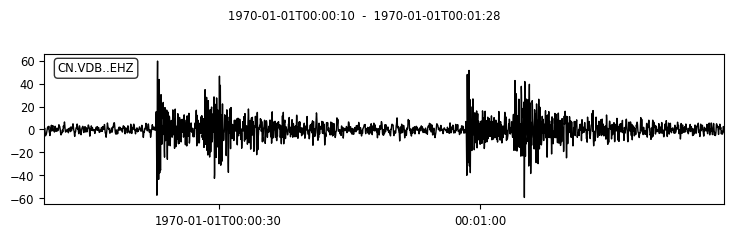

number of windows: 38
maximum amp window index: 18
Max Window:


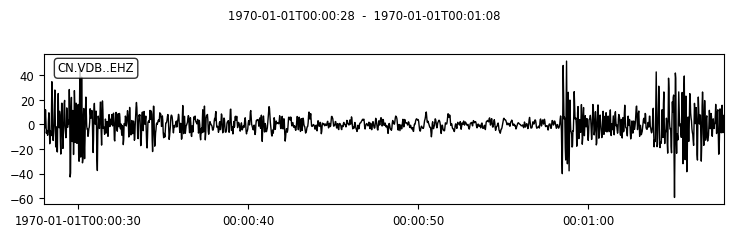

---
vdbehzrpba101 template original stream:


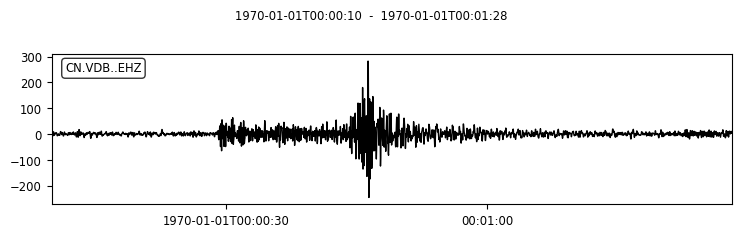

number of windows: 38
maximum amp window index: 19
Max Window:


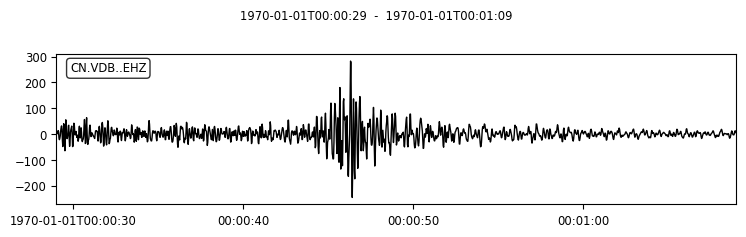

---
vdbehzrpba102 template original stream:


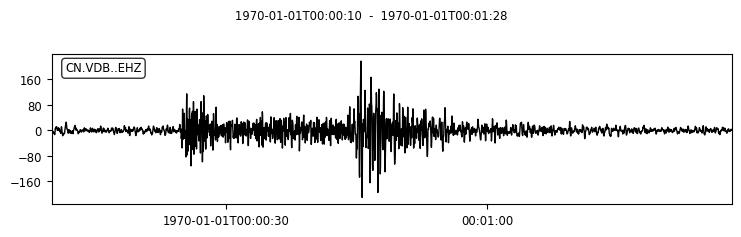

number of windows: 38
maximum amp window index: 15
Max Window:


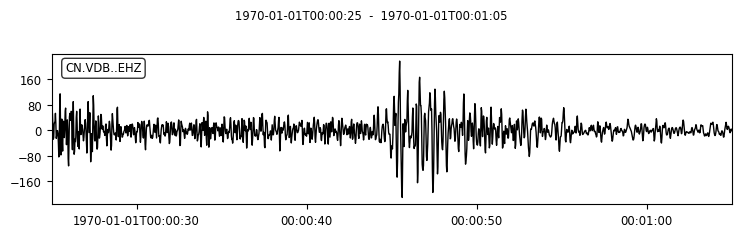

---
vdbehzrpba103 template original stream:


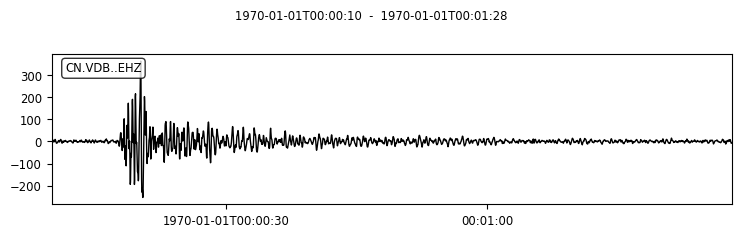

number of windows: 38
maximum amp window index: 8
Max Window:


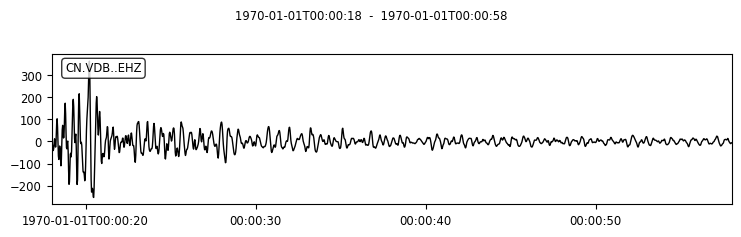

---
vdbehzrpba104 template original stream:


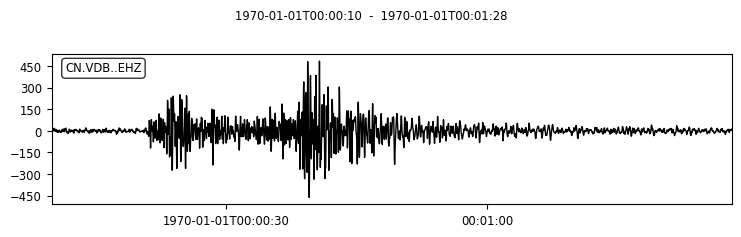

number of windows: 38
maximum amp window index: 11
Max Window:


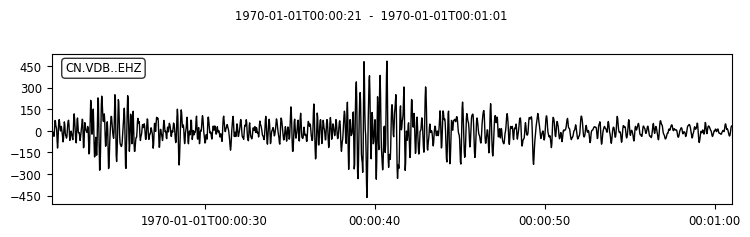

---
vdbehzrpba105 template original stream:


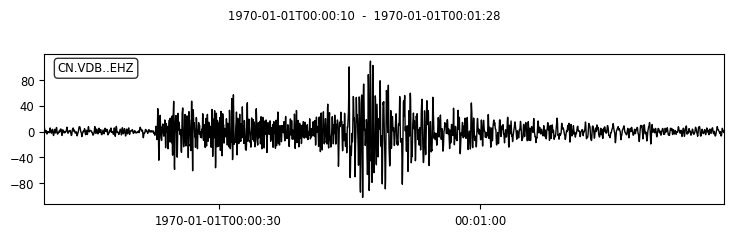

number of windows: 38
maximum amp window index: 13
Max Window:


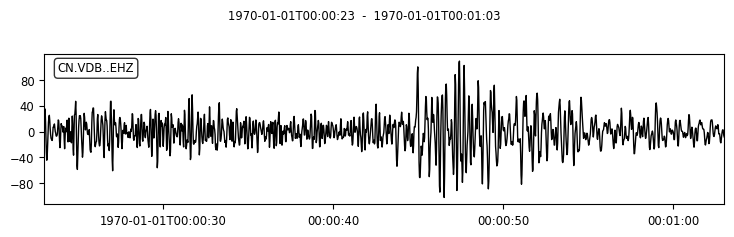

---
vdbehzrpba106 template original stream:


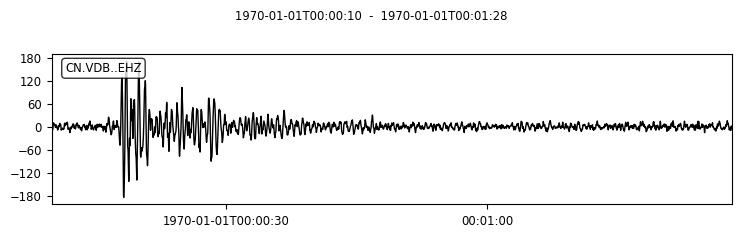

number of windows: 38
maximum amp window index: 0
Max Window:


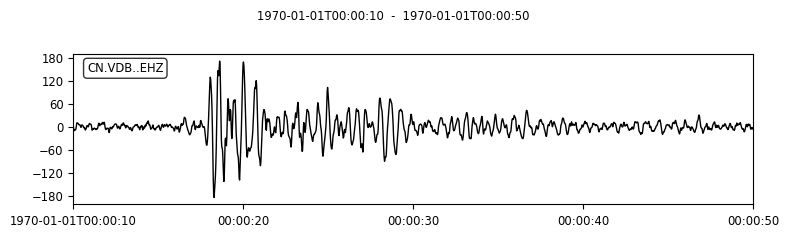

---
vdbehzrpba107 template original stream:


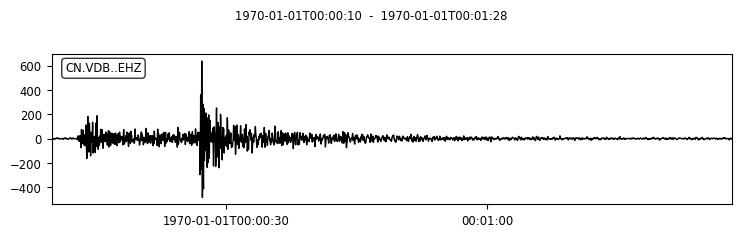

number of windows: 38
maximum amp window index: 3
Max Window:


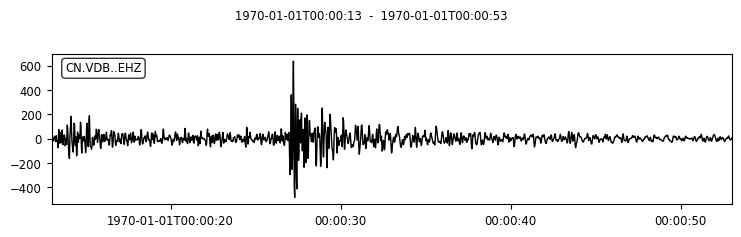

---
vdbehzrpba108 template original stream:


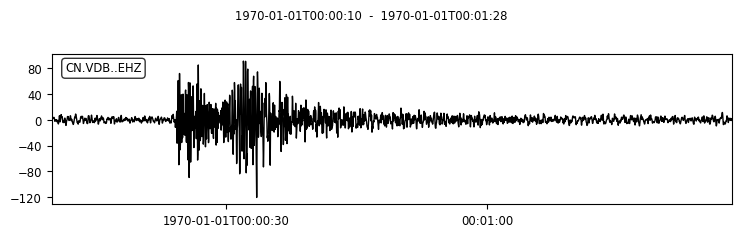

number of windows: 38
maximum amp window index: 13
Max Window:


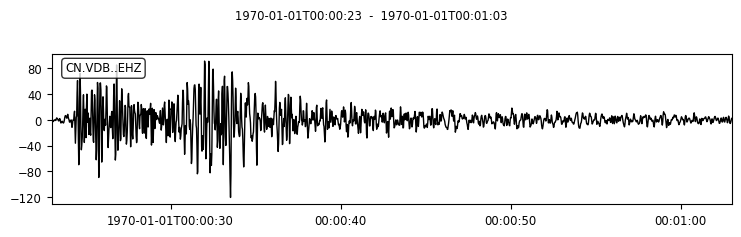

---
vdbehzrpba109 template original stream:


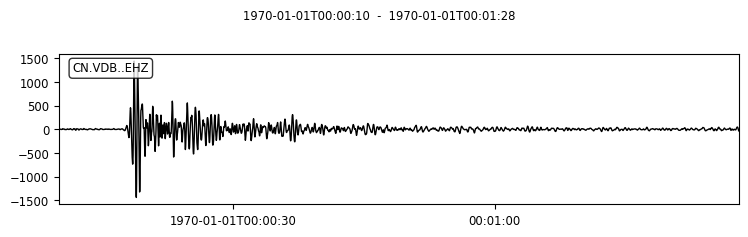

number of windows: 38
maximum amp window index: 8
Max Window:


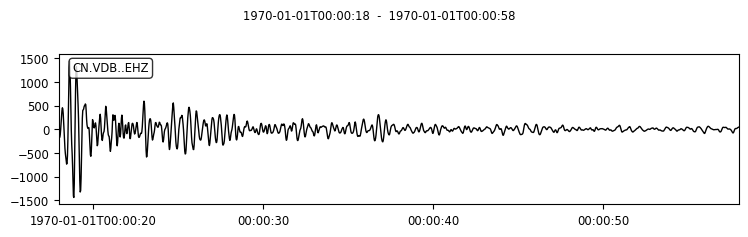

---
vdbehzrpba110 template original stream:


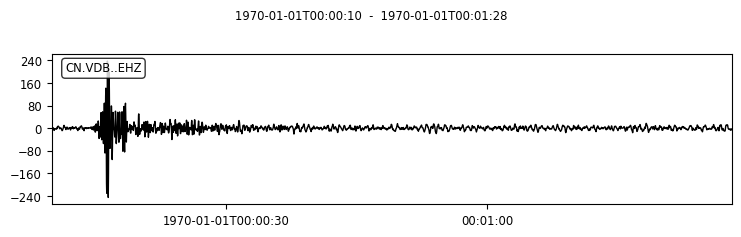

number of windows: 38
maximum amp window index: 5
Max Window:


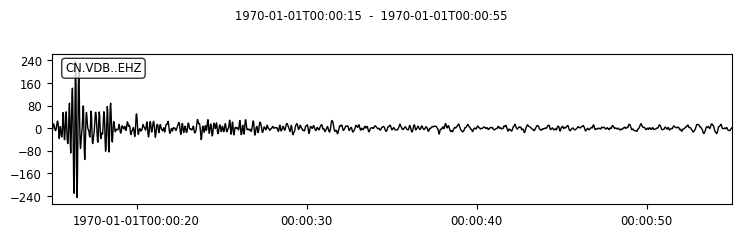

---
vdbehzrpba111 template original stream:


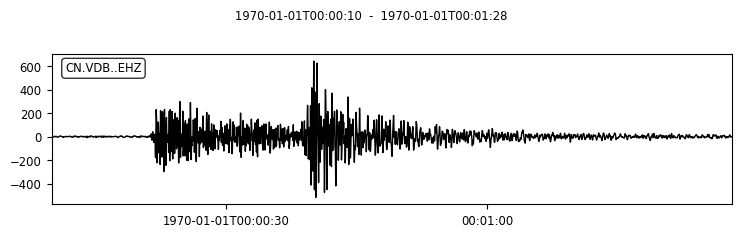

number of windows: 38
maximum amp window index: 11
Max Window:


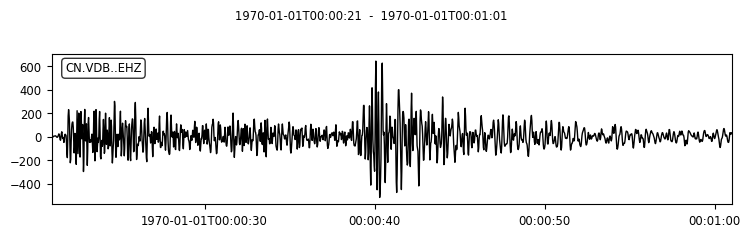

---
vdbehzrpba115 template original stream:


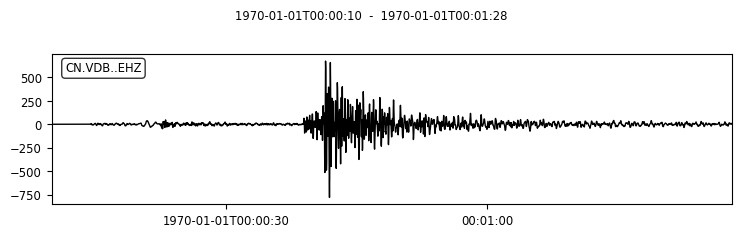

number of windows: 38
maximum amp window index: 29
Max Window:


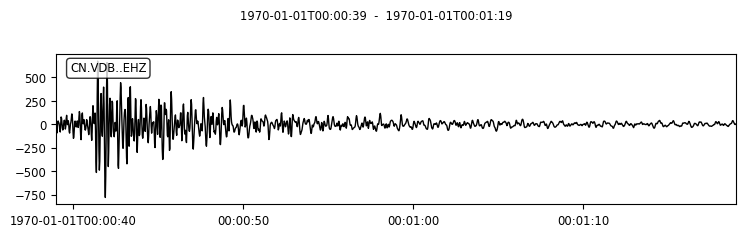

---
vdbehzrpba116 template original stream:


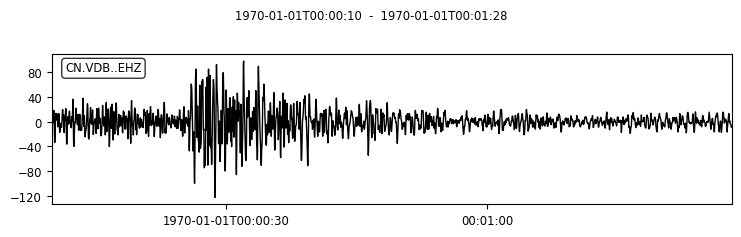

number of windows: 38
maximum amp window index: 0
Max Window:


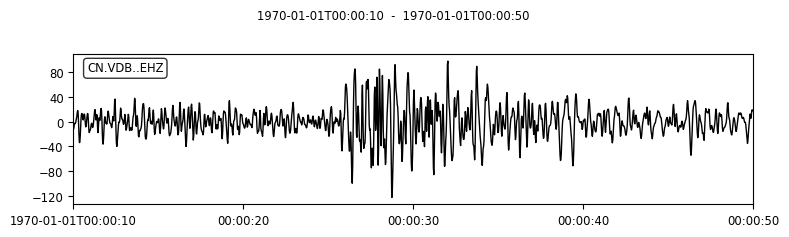

---
vdbehzrpba138 template original stream:


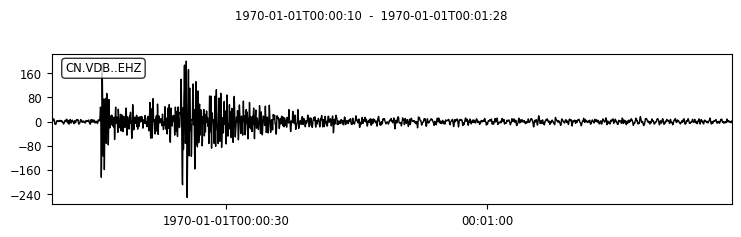

number of windows: 38
maximum amp window index: 5
Max Window:


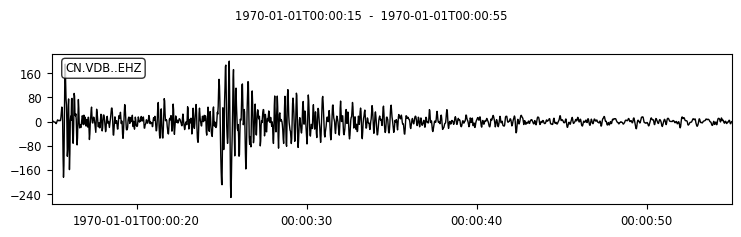

---
vdbehzrpba141 template original stream:


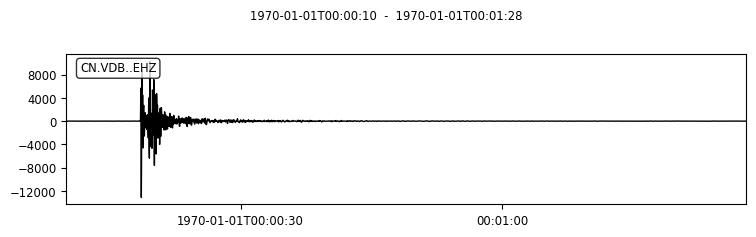

number of windows: 38
maximum amp window index: 8
Max Window:


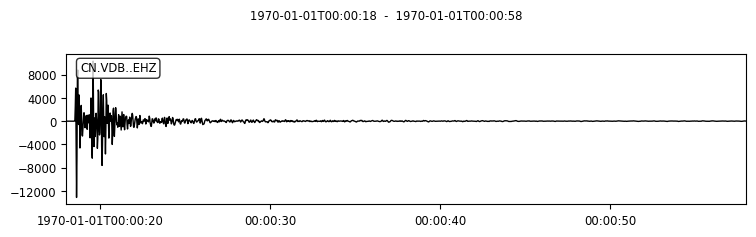

---
vdbehzrpba142 template original stream:


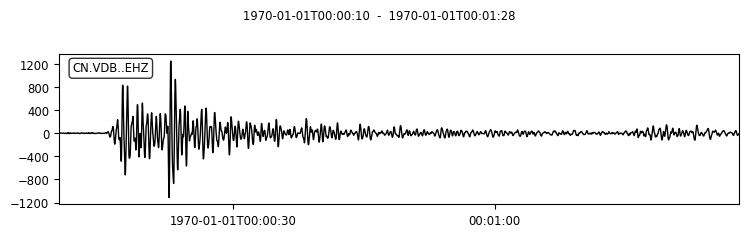

number of windows: 38
maximum amp window index: 6
Max Window:


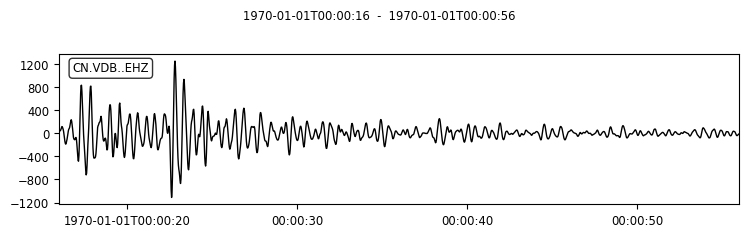

---
vdbehzrpba143 template original stream:


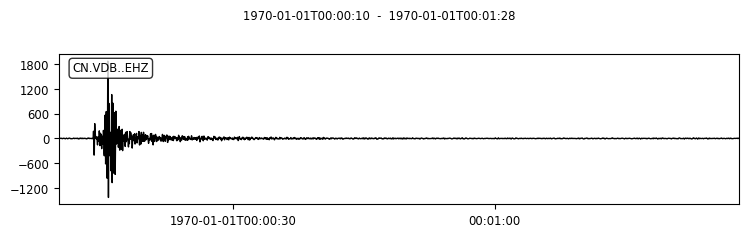

number of windows: 38
maximum amp window index: 3
Max Window:


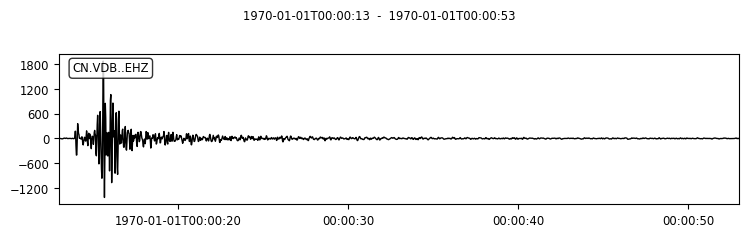

---
vdbehzrpba145 template original stream:


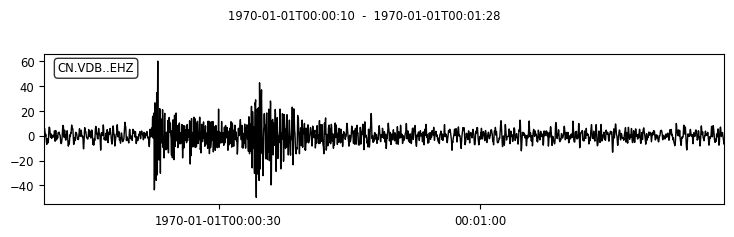

number of windows: 38
maximum amp window index: 3
Max Window:


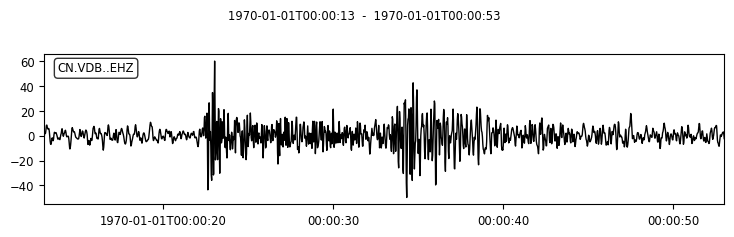

---
vdbehzrpba146 template original stream:


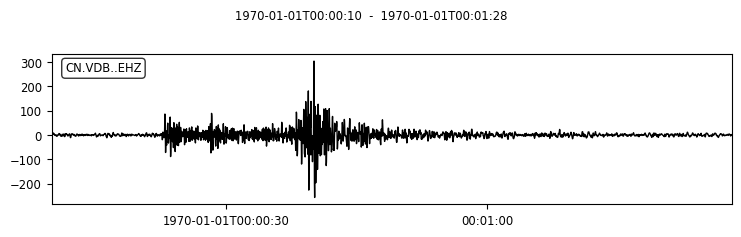

number of windows: 38
maximum amp window index: 13
Max Window:


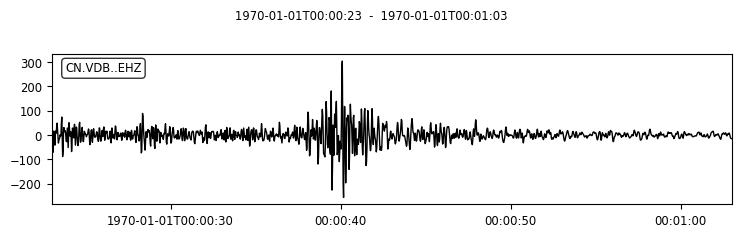

---
vdbehzrpba148 template original stream:


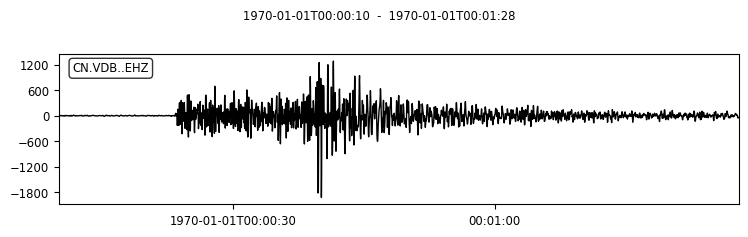

number of windows: 38
maximum amp window index: 14
Max Window:


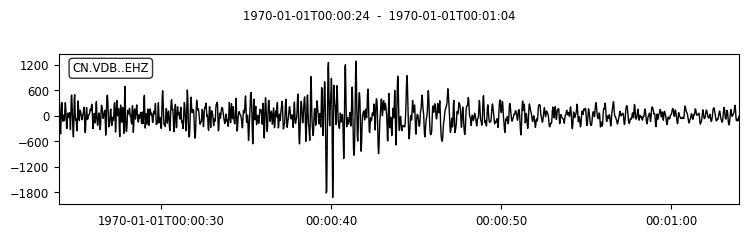

---
vdbehzrpba149 template original stream:


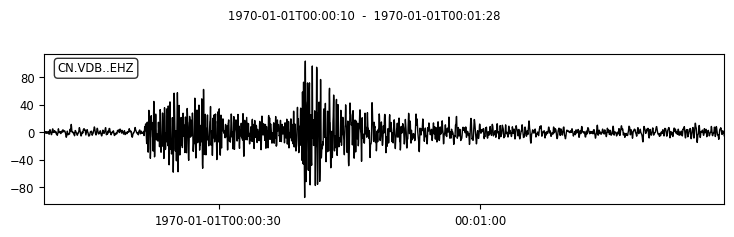

number of windows: 38
maximum amp window index: 11
Max Window:


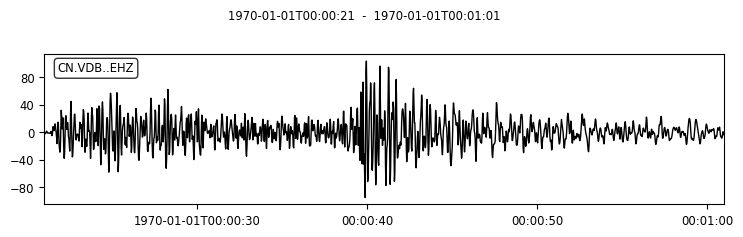

---
vdbehzrpba150 template original stream:


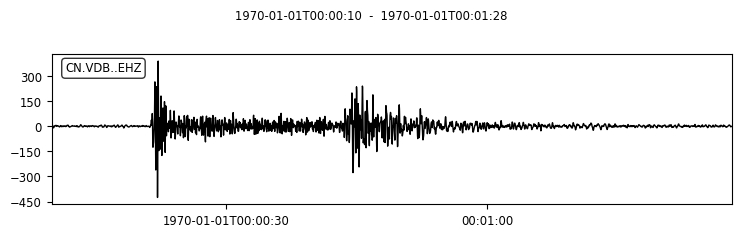

number of windows: 38
maximum amp window index: 11
Max Window:


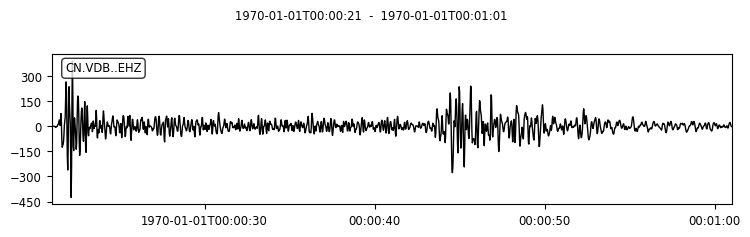

---
vdbehzrpba151 template original stream:


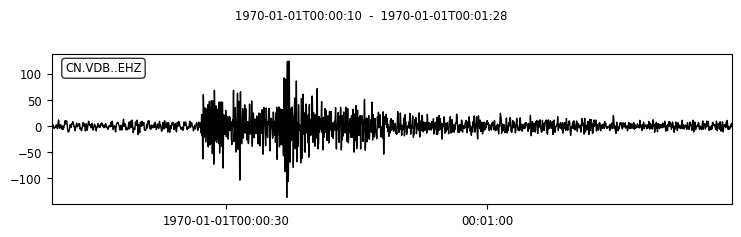

number of windows: 38
maximum amp window index: 17
Max Window:


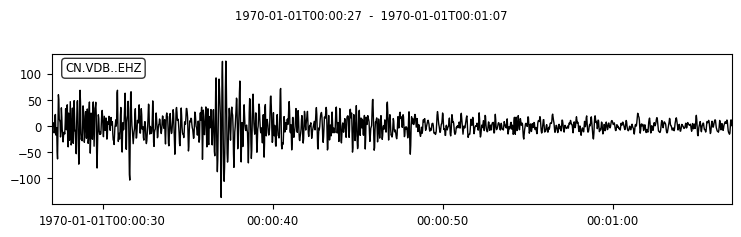

---
vdbehzrpba152 template original stream:


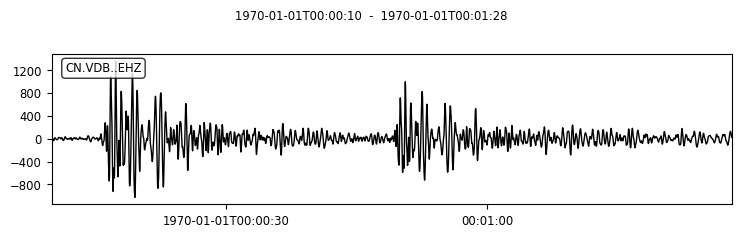

number of windows: 38
maximum amp window index: 6
Max Window:


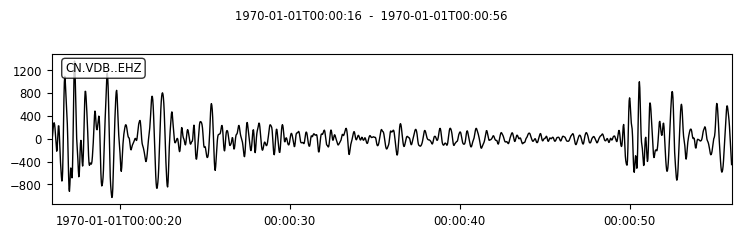

---
vdbehzrpba153 template original stream:


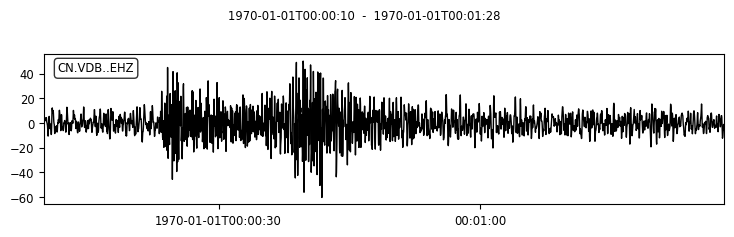

number of windows: 38
maximum amp window index: 13
Max Window:


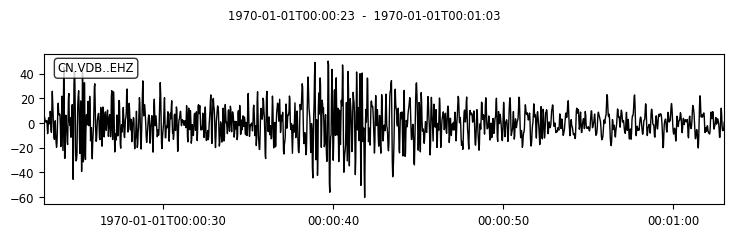

---
vdbehzrpba154 template original stream:


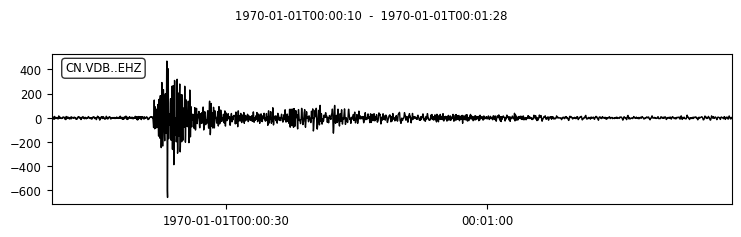

number of windows: 38
maximum amp window index: 11
Max Window:


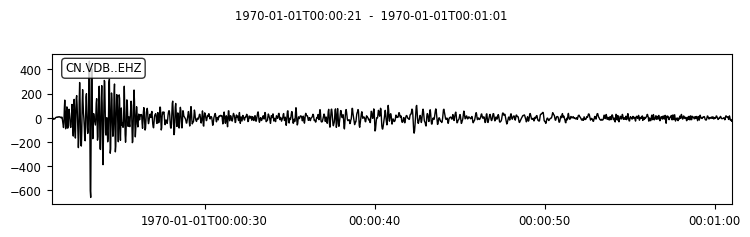

---
vdbehzrpba155 template original stream:


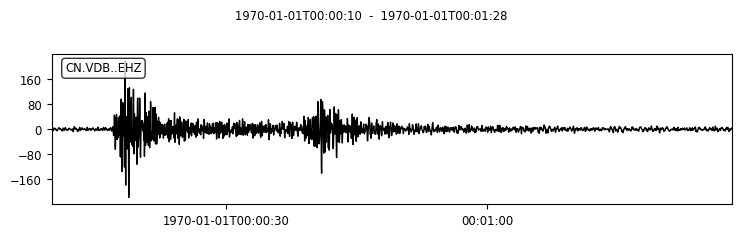

number of windows: 38
maximum amp window index: 7
Max Window:


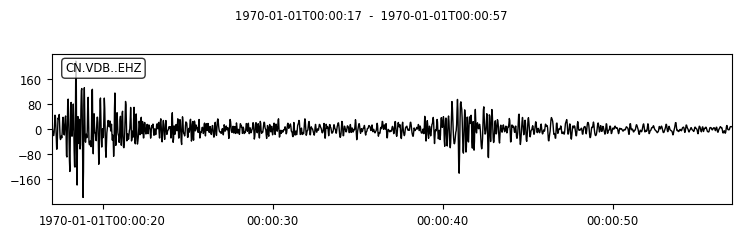

---
vdbehzrpba156 template original stream:


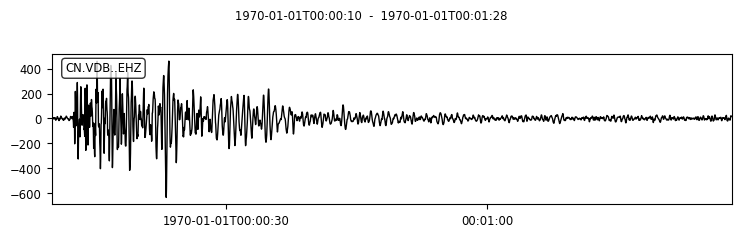

number of windows: 38
maximum amp window index: 2
Max Window:


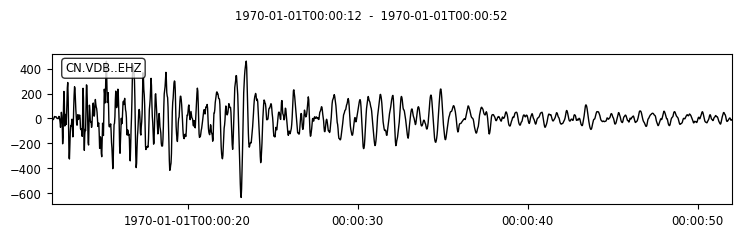

---
vdbehzrpba157 template original stream:


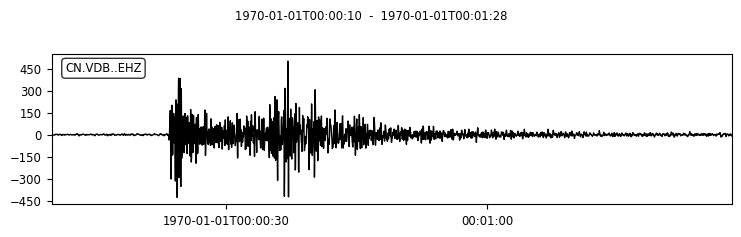

number of windows: 38
maximum amp window index: 13
Max Window:


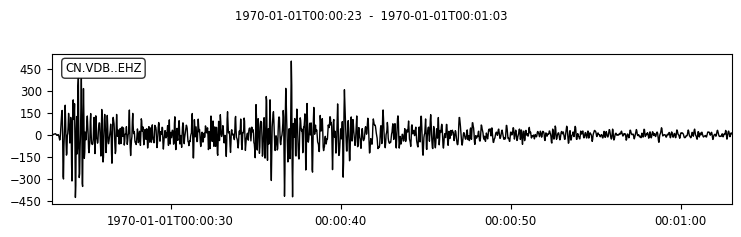

---
vdbehzrpba158 template original stream:


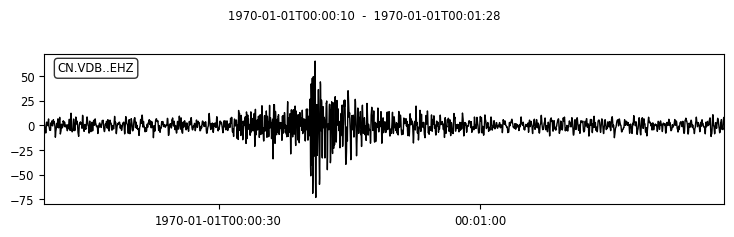

number of windows: 38
maximum amp window index: 11
Max Window:


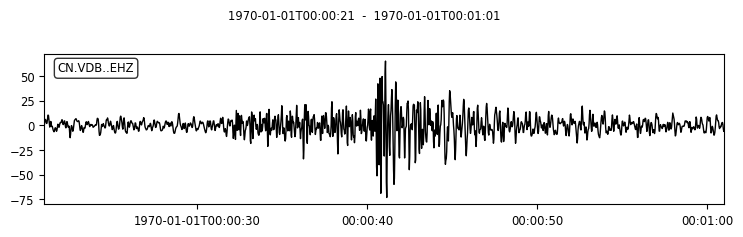

---
vdbehzrpba159 template original stream:


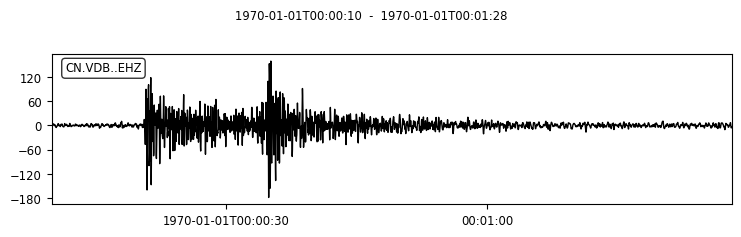

number of windows: 38
maximum amp window index: 10
Max Window:


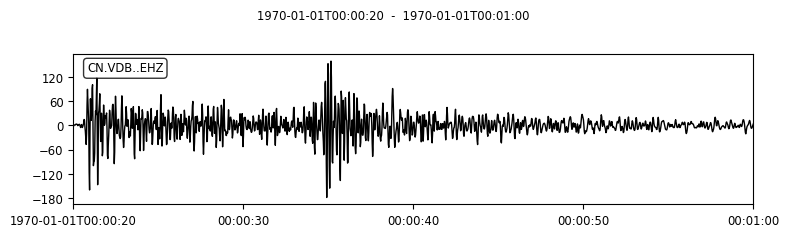

---
vdbehzrpba160 template original stream:


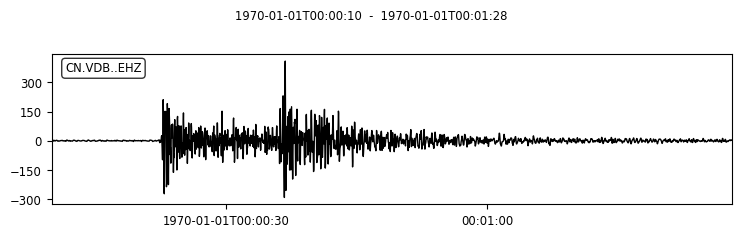

number of windows: 38
maximum amp window index: 12
Max Window:


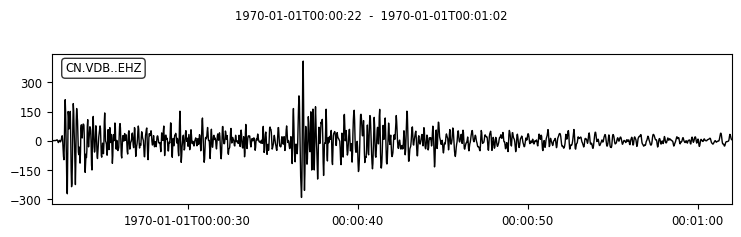

---
vdbehzrpba161 template original stream:


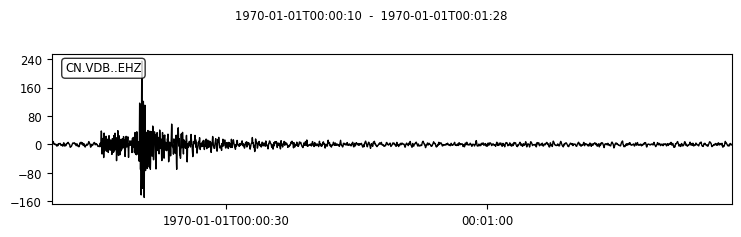

number of windows: 38
maximum amp window index: 3
Max Window:


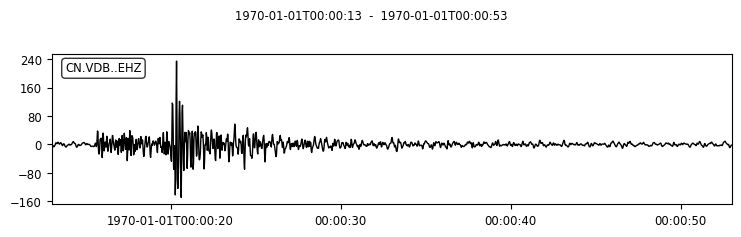

---
vdbehzrpba162 template original stream:


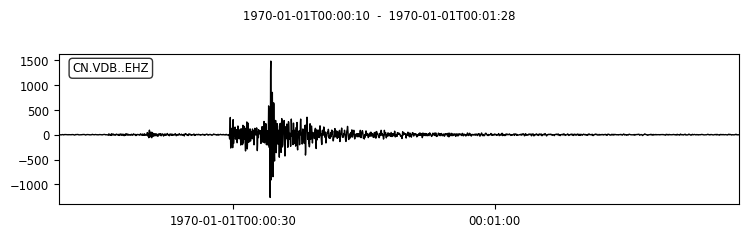

number of windows: 38
maximum amp window index: 10
Max Window:


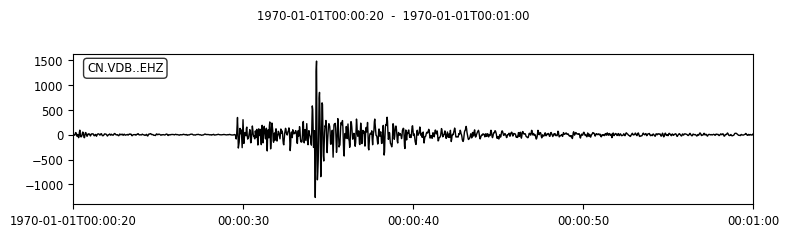

---
vdbehzrpba163 template original stream:


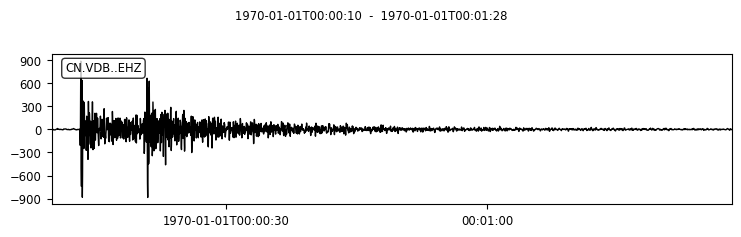

number of windows: 38
maximum amp window index: 3
Max Window:


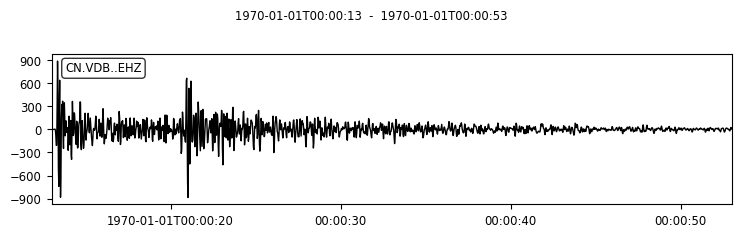

---
vdbehzrpba164 template original stream:


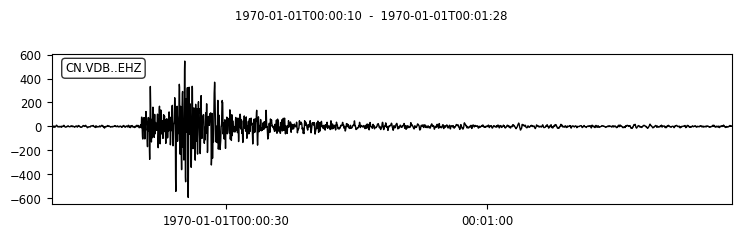

number of windows: 38
maximum amp window index: 9
Max Window:


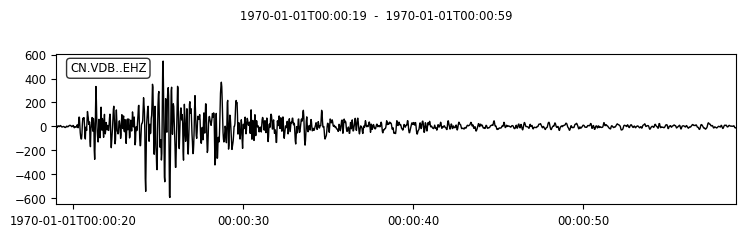

---
vdbehzrpba165 template original stream:


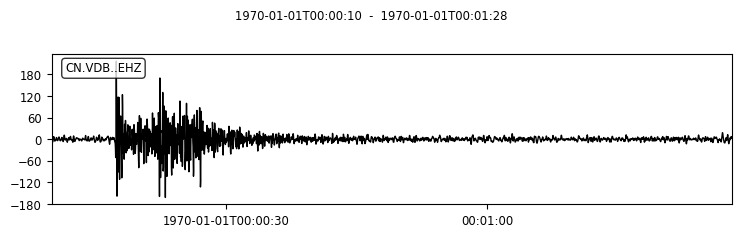

number of windows: 38
maximum amp window index: 4
Max Window:


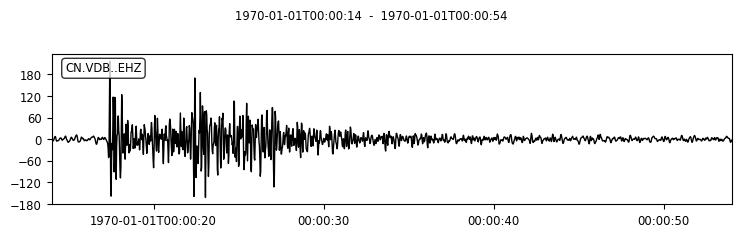

---
vdbehzrpba167 template original stream:


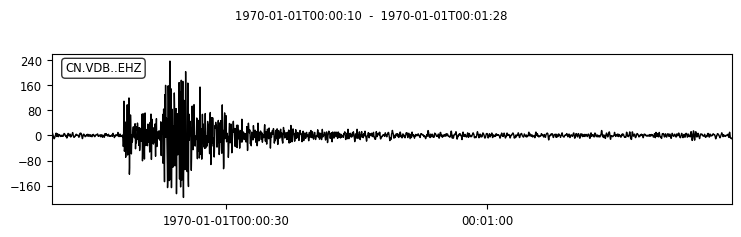

number of windows: 38
maximum amp window index: 8
Max Window:


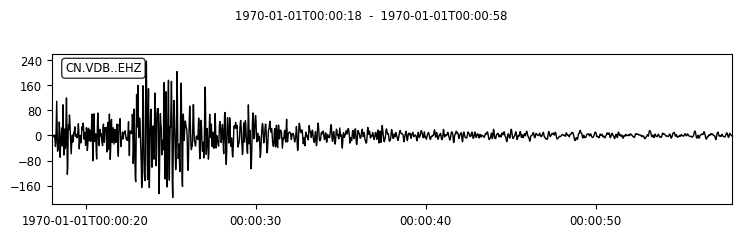

---
vdbehzrpba169 template original stream:


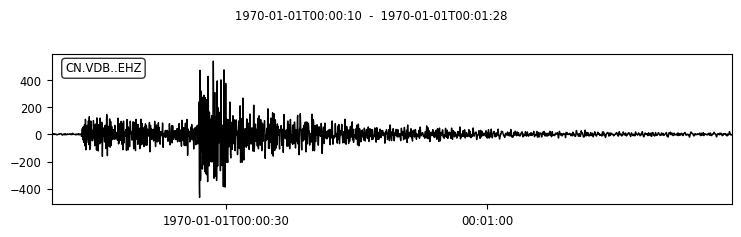

number of windows: 38
maximum amp window index: 3
Max Window:


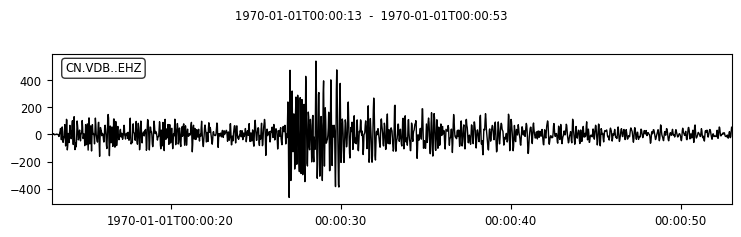

---
vdbehzrpba171 template original stream:


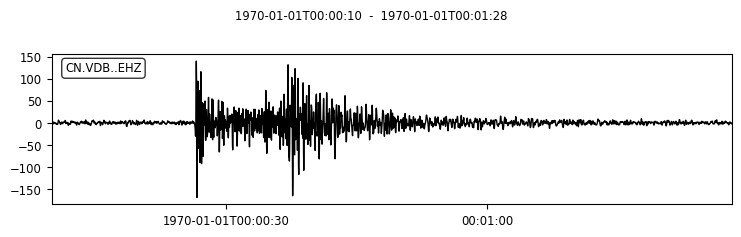

number of windows: 38
maximum amp window index: 16
Max Window:


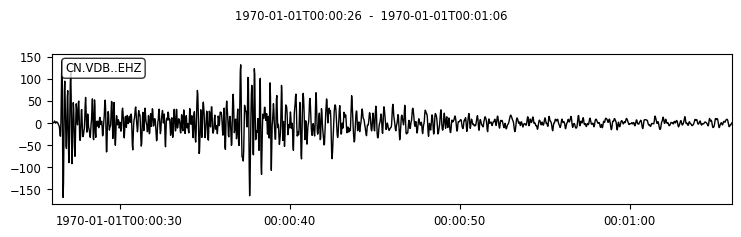

---
vdbehzrpba173 template original stream:


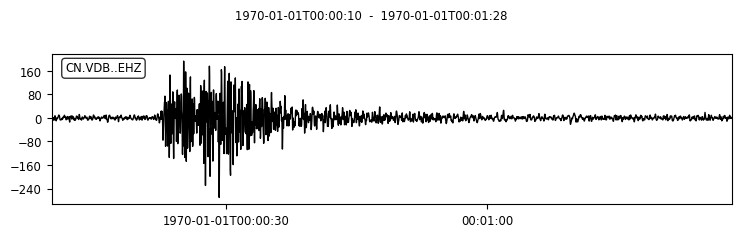

number of windows: 38
maximum amp window index: 12
Max Window:


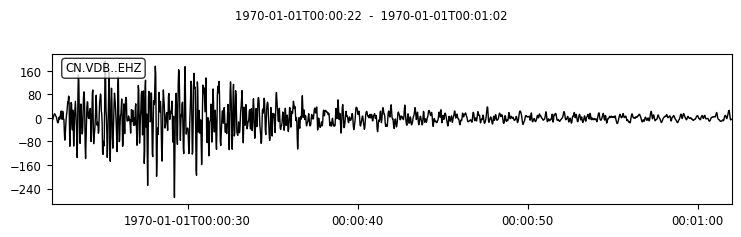

---
vdbehzrpba174 template original stream:


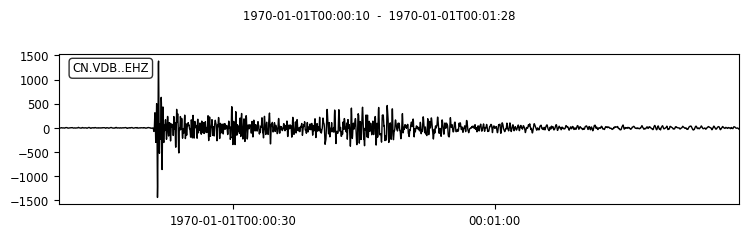

number of windows: 38
maximum amp window index: 11
Max Window:


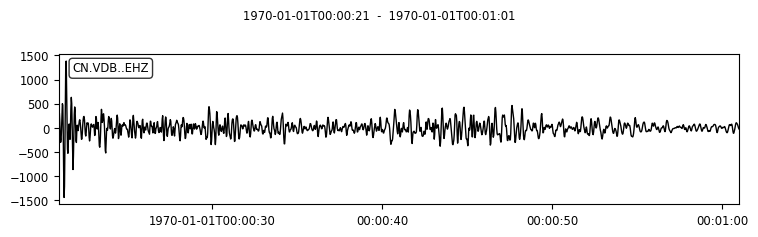

---
vdbehzrpba175 template original stream:


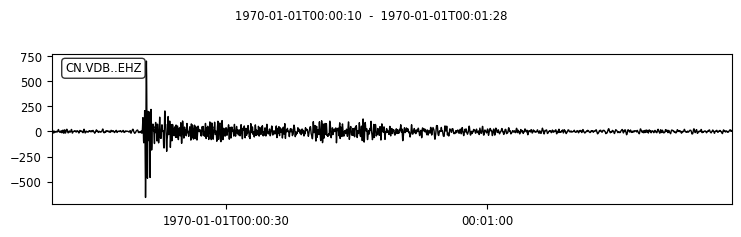

number of windows: 38
maximum amp window index: 10
Max Window:


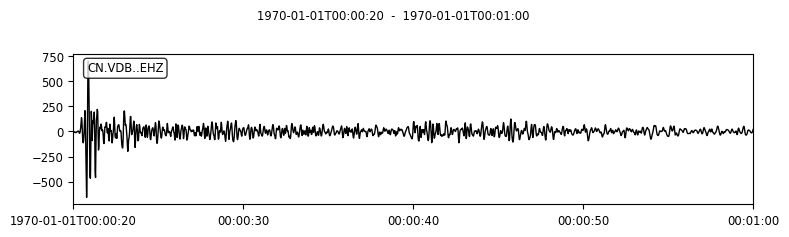

---
mbwehzrpba000 template original stream:


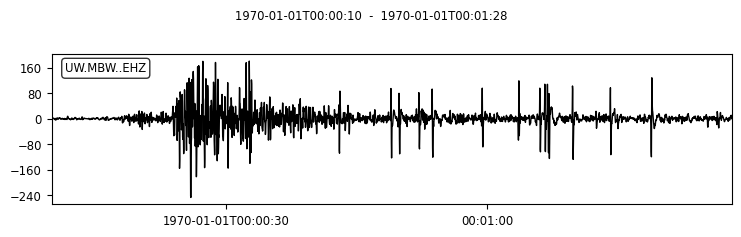

number of windows: 38
maximum amp window index: 10
Max Window:


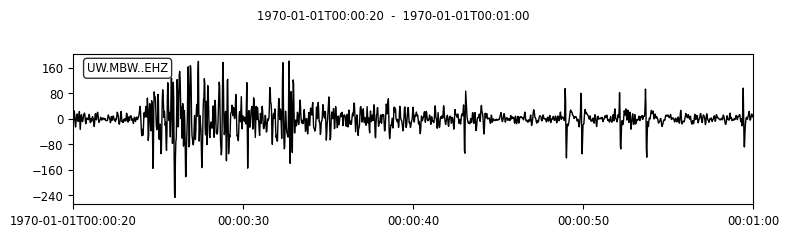

---
mbwehzrpba002 template original stream:


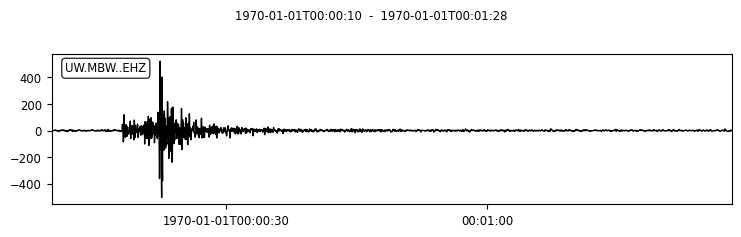

number of windows: 38
maximum amp window index: 8
Max Window:


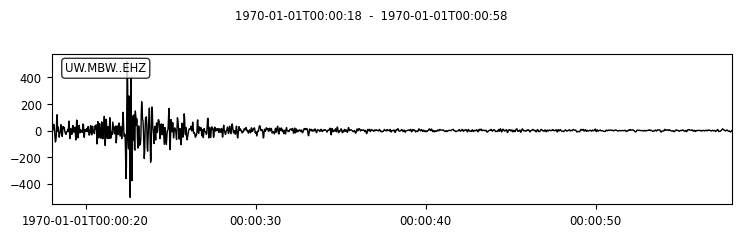

---
mbwehzrpba003 template original stream:


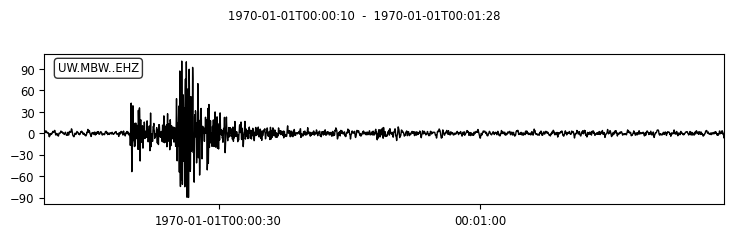

number of windows: 38
maximum amp window index: 9
Max Window:


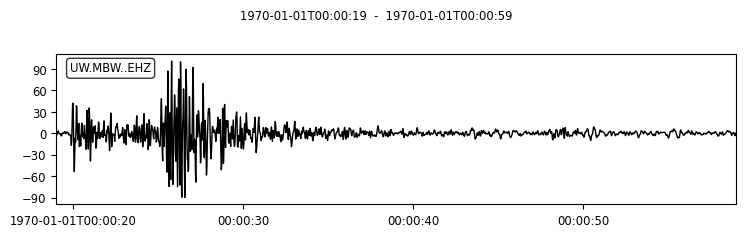

---
mbwehzrpba004 template original stream:


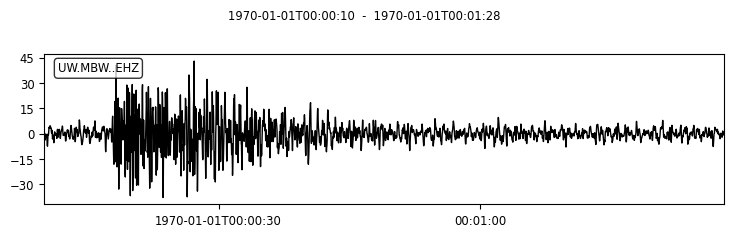

number of windows: 38
maximum amp window index: 7
Max Window:


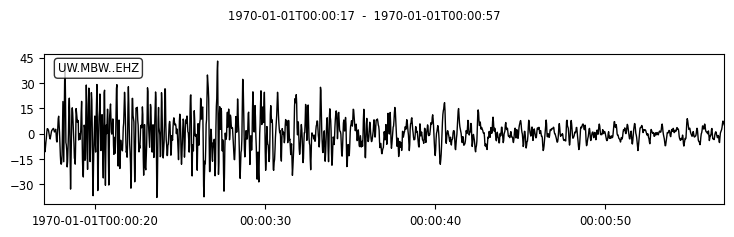

---
mbwehzrpba005 template original stream:


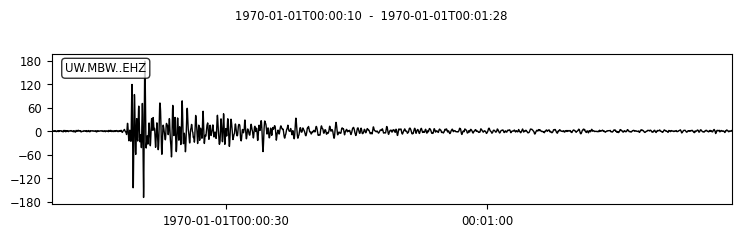

number of windows: 38
maximum amp window index: 8
Max Window:


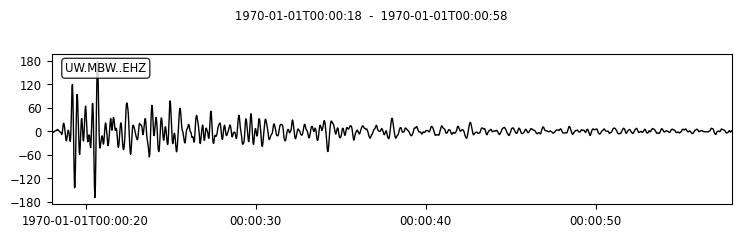

---
mbwehzrpba006 template original stream:


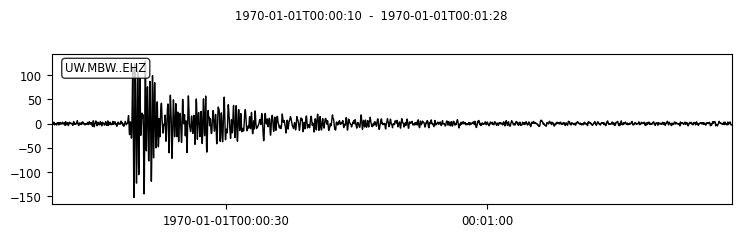

number of windows: 38
maximum amp window index: 7
Max Window:


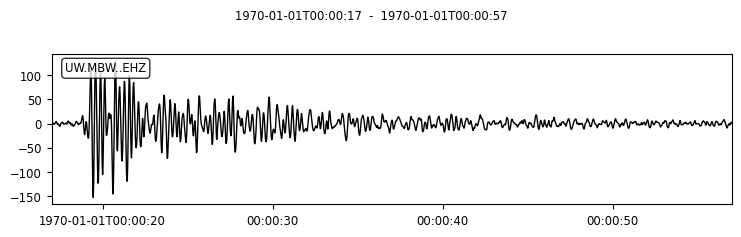

---
mbwehzrpba007 template original stream:


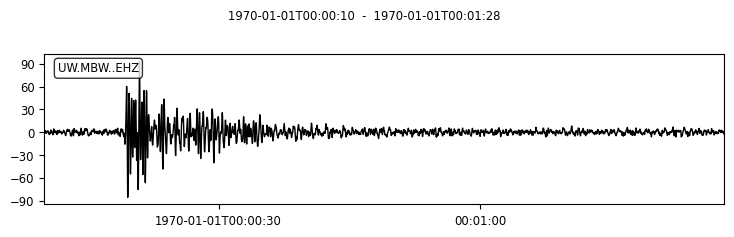

number of windows: 38
maximum amp window index: 8
Max Window:


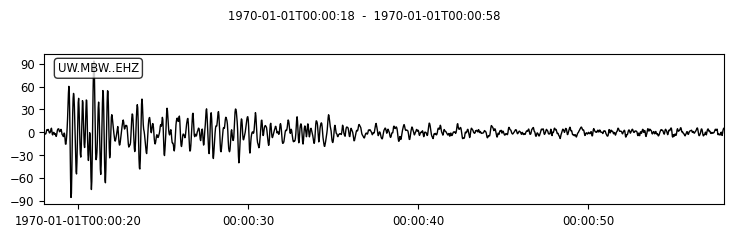

---
mbwehzrpba008 template original stream:


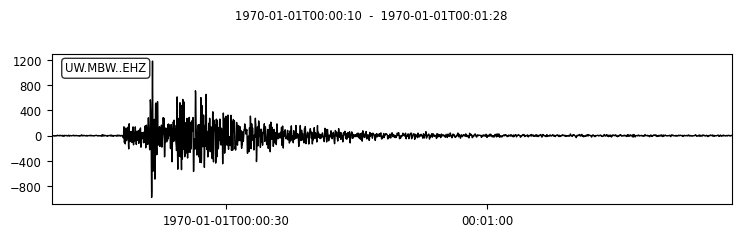

number of windows: 38
maximum amp window index: 8
Max Window:


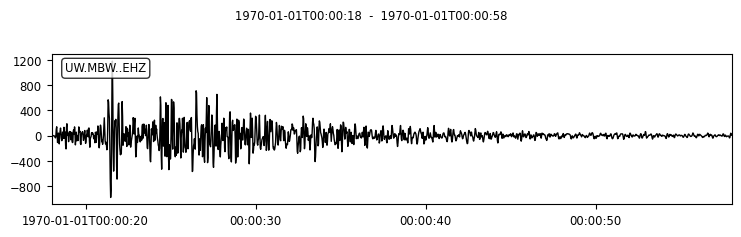

---
mbwehzrpba009 template original stream:


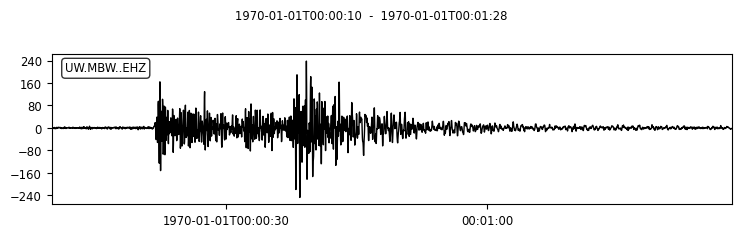

number of windows: 38
maximum amp window index: 12
Max Window:


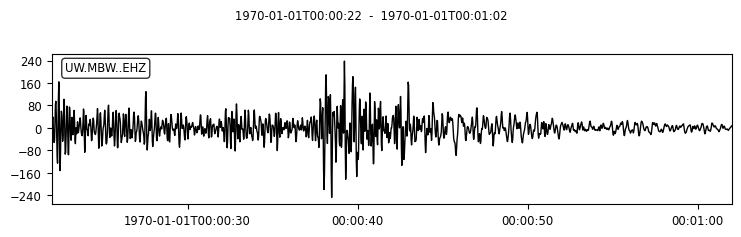

---
mbwehzrpba010 template original stream:


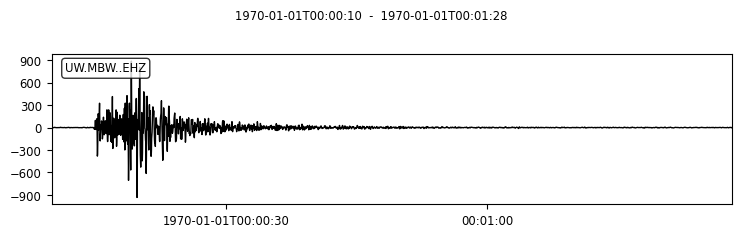

number of windows: 38
maximum amp window index: 5
Max Window:


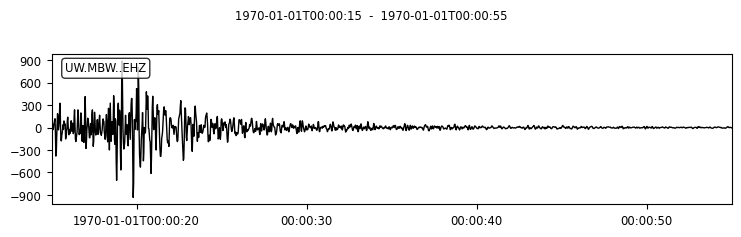

---
mbwehzrpba011 template original stream:


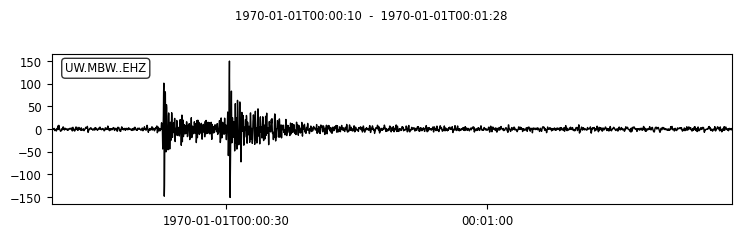

number of windows: 38
maximum amp window index: 12
Max Window:


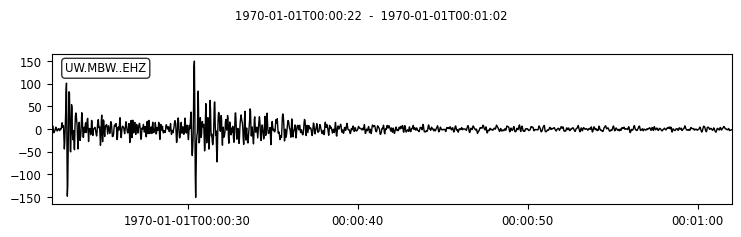

---
mbwehzrpba012 template original stream:


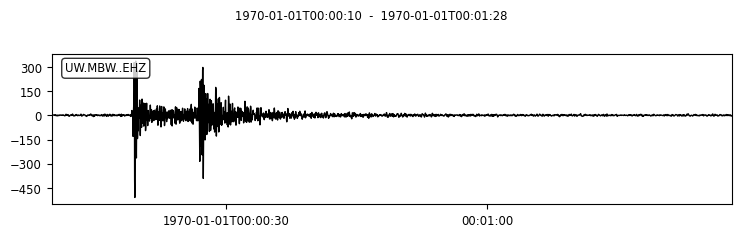

number of windows: 38
maximum amp window index: 9
Max Window:


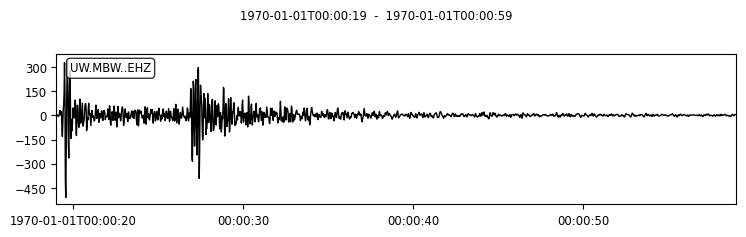

---
mbwehzrpba013 template original stream:


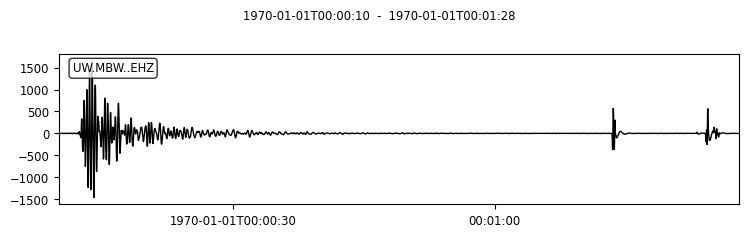

number of windows: 38
maximum amp window index: 1
Max Window:


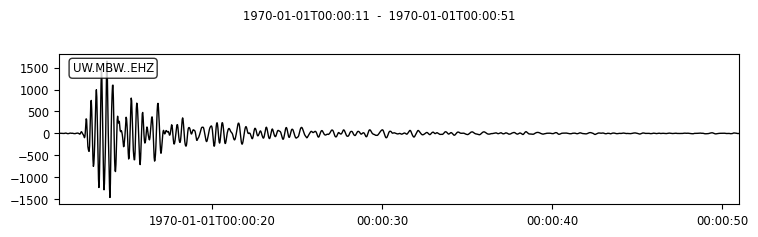

---
mbwehzrpba014 template original stream:


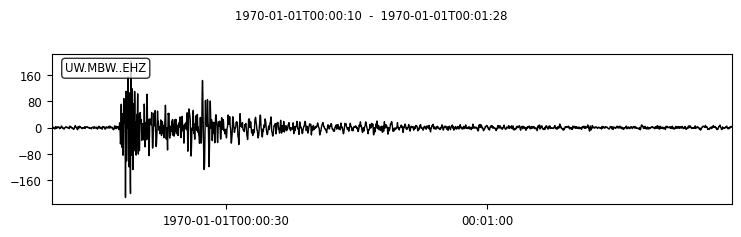

number of windows: 38
maximum amp window index: 7
Max Window:


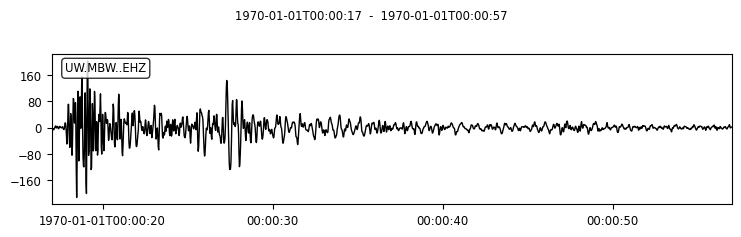

---
mbwehzrpba015 template original stream:


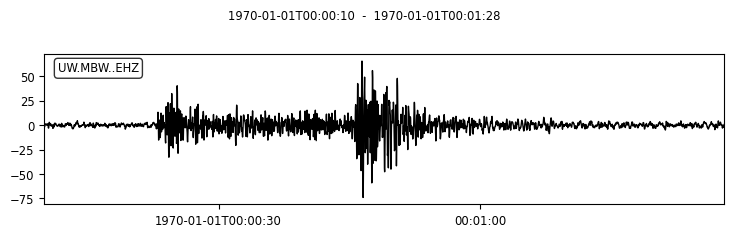

number of windows: 38
maximum amp window index: 13
Max Window:


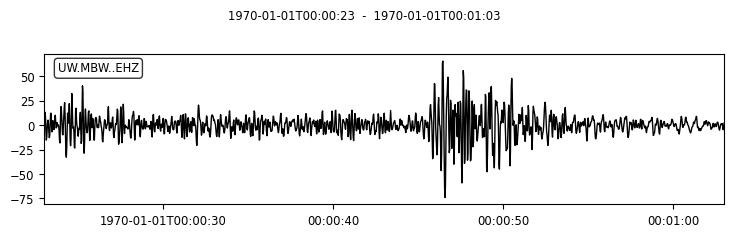

---
mbwehzrpba016 template original stream:


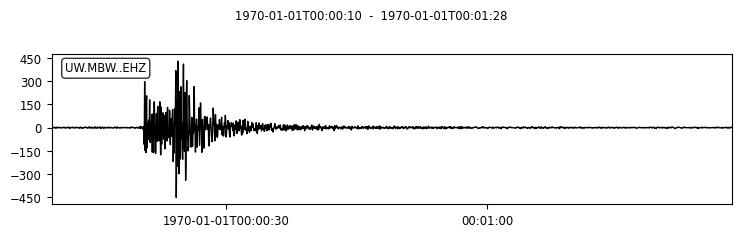

number of windows: 38
maximum amp window index: 10
Max Window:


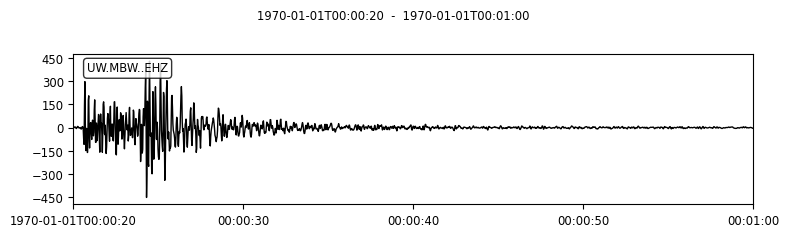

---
mbwehzrpba018 template original stream:


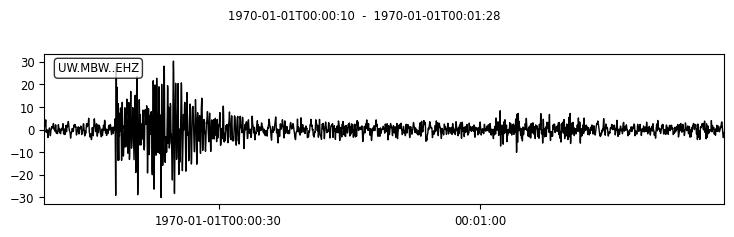

number of windows: 38
maximum amp window index: 5
Max Window:


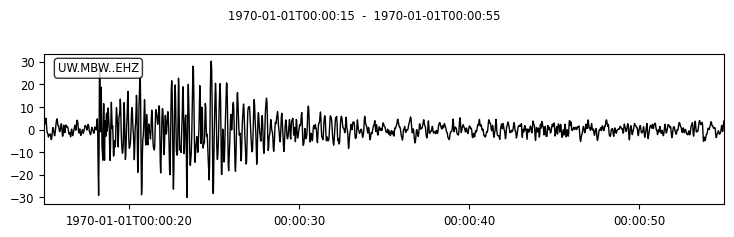

---
mbwehzrpba019 template original stream:


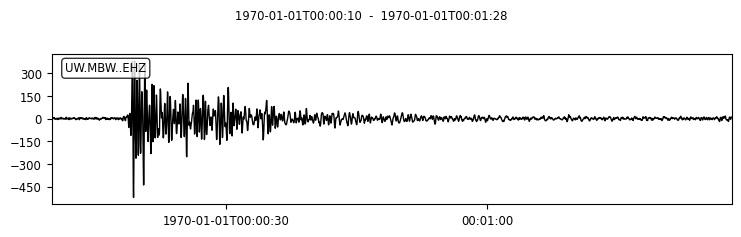

number of windows: 38
maximum amp window index: 8
Max Window:


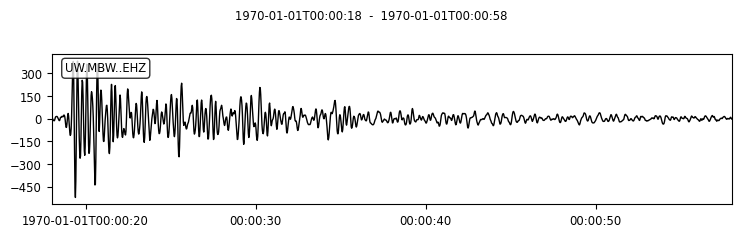

---
mbwehzrpba020 template original stream:


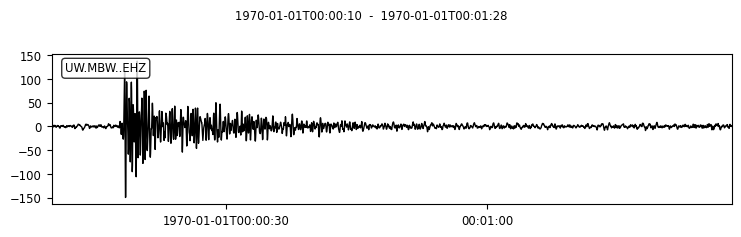

number of windows: 38
maximum amp window index: 8
Max Window:


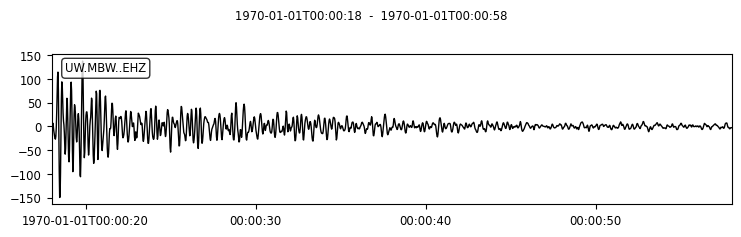

---
mbwehzrpba021 template original stream:


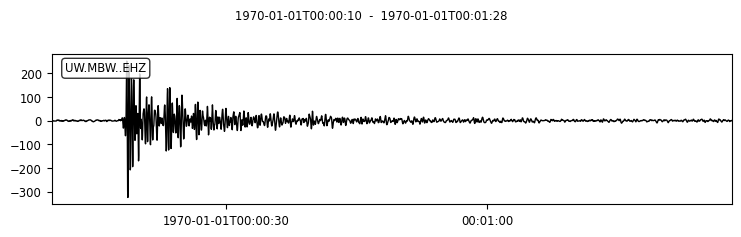

number of windows: 38
maximum amp window index: 8
Max Window:


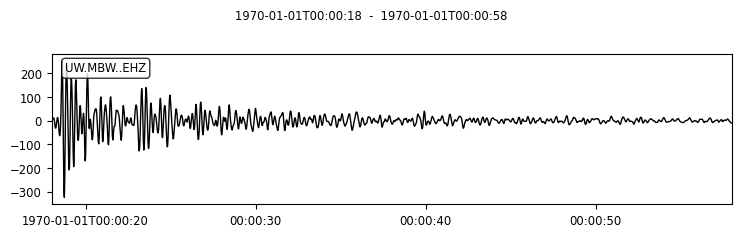

---
mbwehzrpba022 template original stream:


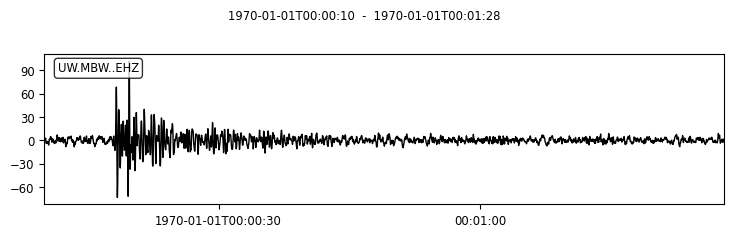

number of windows: 38
maximum amp window index: 2
Max Window:


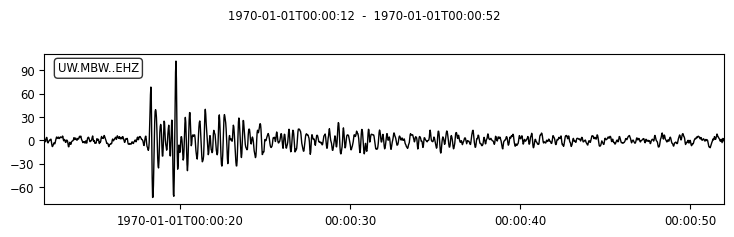

---
mbwehzrpba023 template original stream:


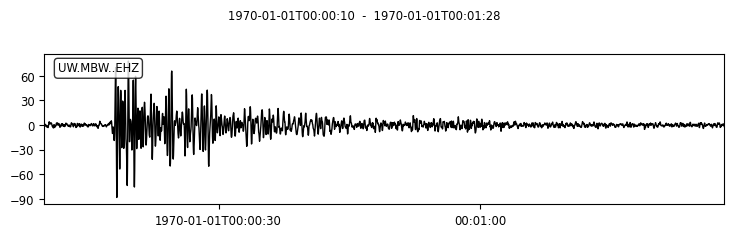

number of windows: 38
maximum amp window index: 8
Max Window:


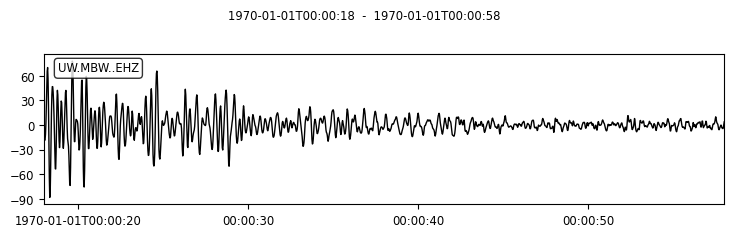

---
mbwehzrpba024 template original stream:


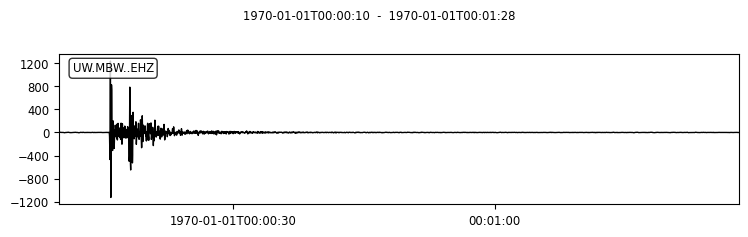

number of windows: 38
maximum amp window index: 5
Max Window:


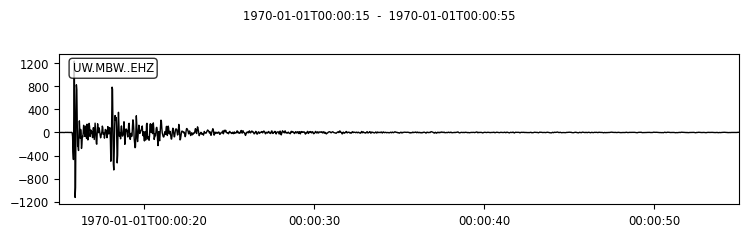

---
mbwehzrpba025 template original stream:


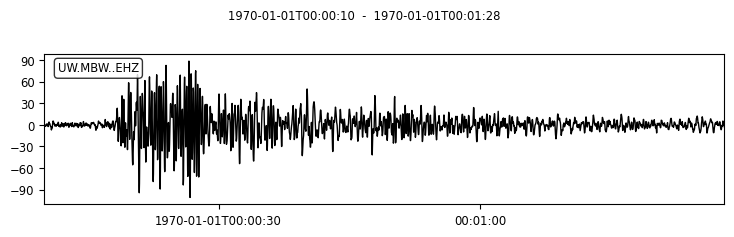

number of windows: 38
maximum amp window index: 8
Max Window:


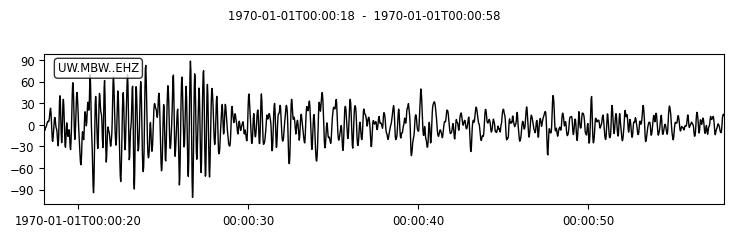

---
mbwehzrpba026 template original stream:


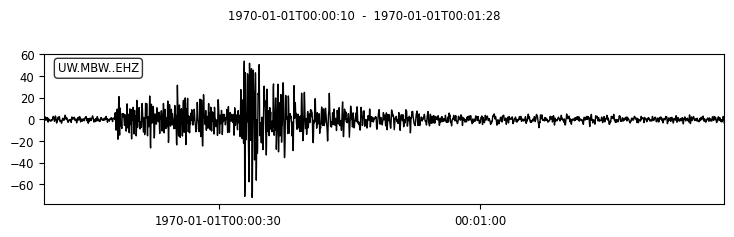

number of windows: 38
maximum amp window index: 8
Max Window:


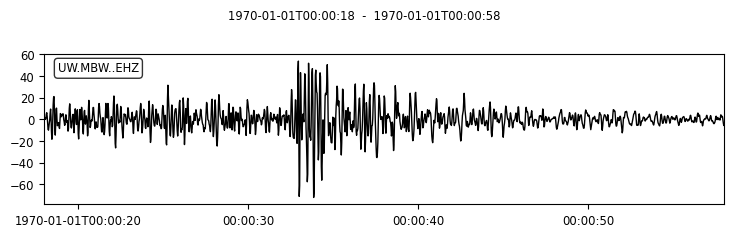

---
mbwehzrpba027 template original stream:


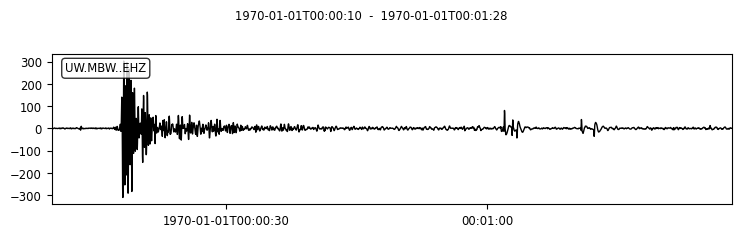

number of windows: 38
maximum amp window index: 7
Max Window:


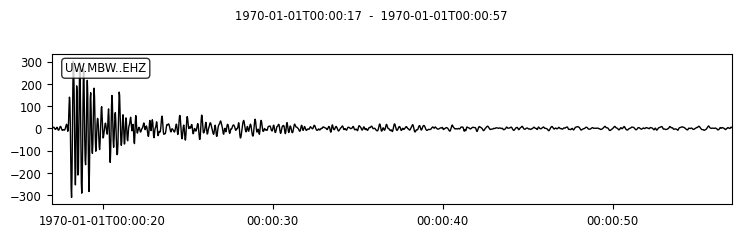

---
mbwehzrpba029 template original stream:


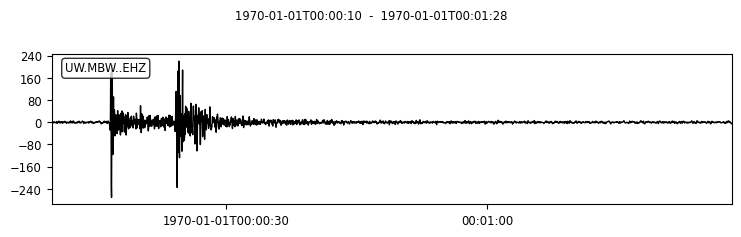

number of windows: 38
maximum amp window index: 3
Max Window:


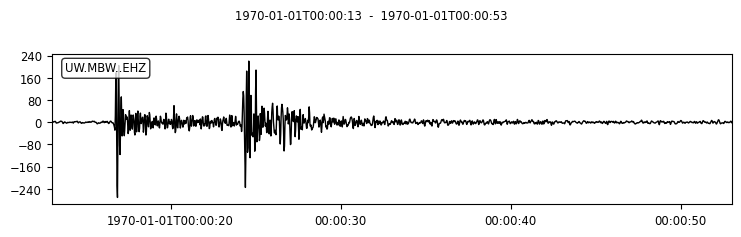

---
mbwehzrpba030 template original stream:


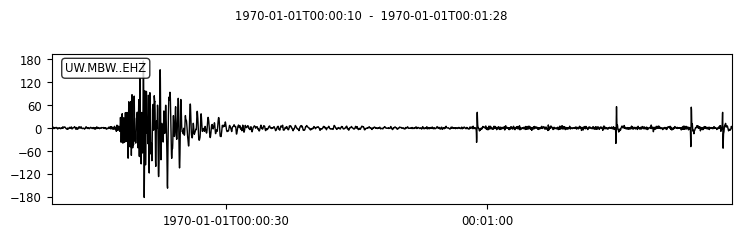

number of windows: 38
maximum amp window index: 1
Max Window:


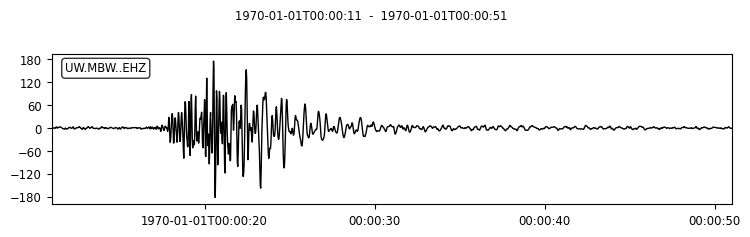

---
mbwehzrpba031 template original stream:


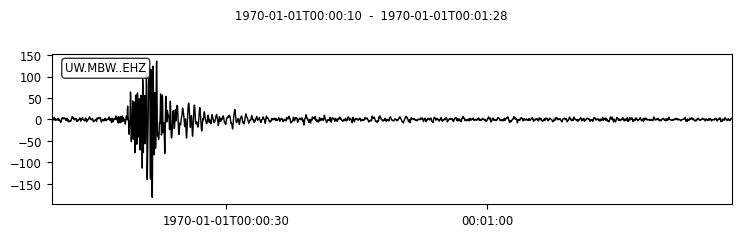

number of windows: 38
maximum amp window index: 1
Max Window:


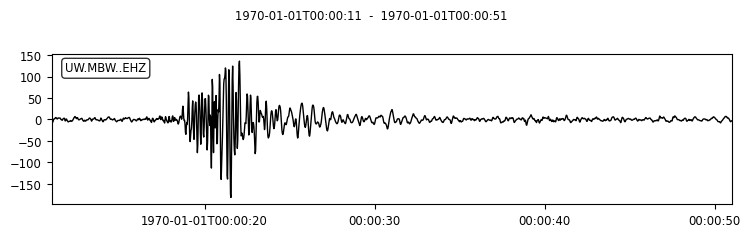

---
mbwehzrpba032 template original stream:


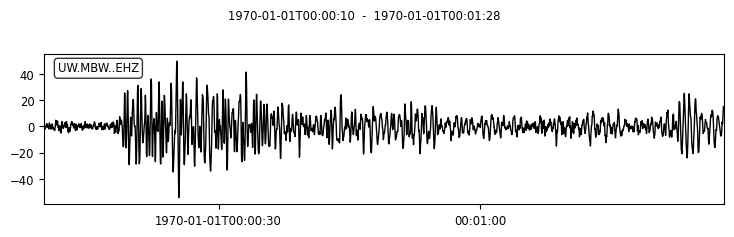

number of windows: 38
maximum amp window index: 9
Max Window:


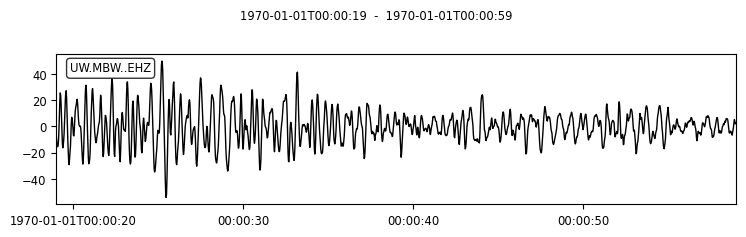

---
mbwehzrpba033 template original stream:


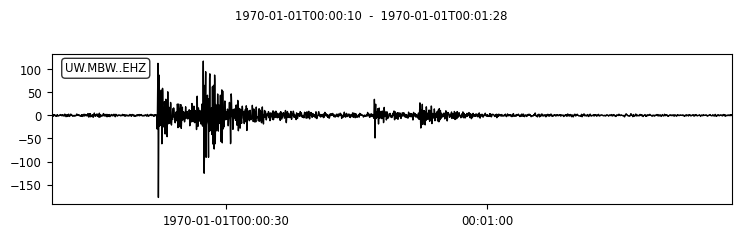

number of windows: 38
maximum amp window index: 12
Max Window:


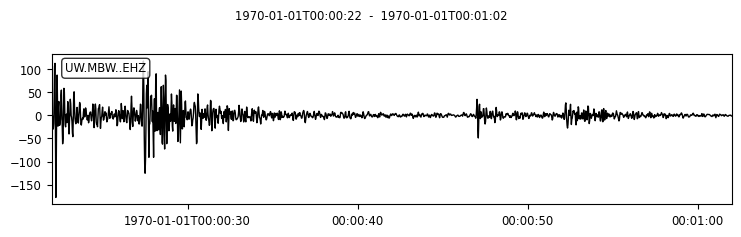

---
mbwehzrpba034 template original stream:


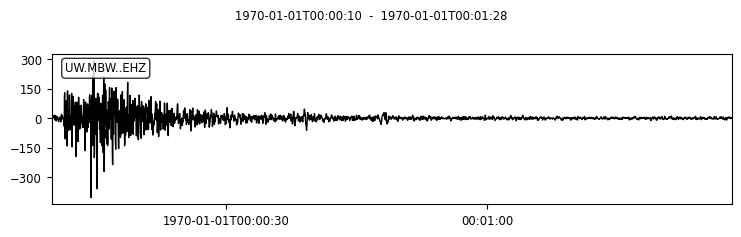

number of windows: 38
maximum amp window index: 0
Max Window:


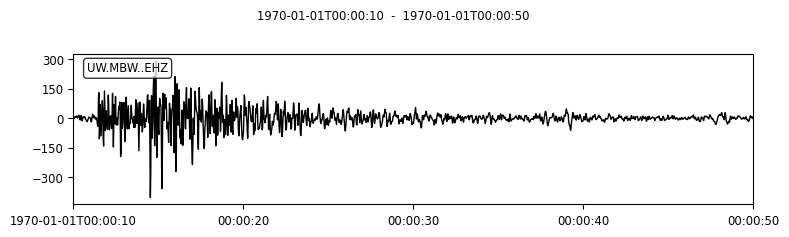

---
mbwehzrpba035 template original stream:


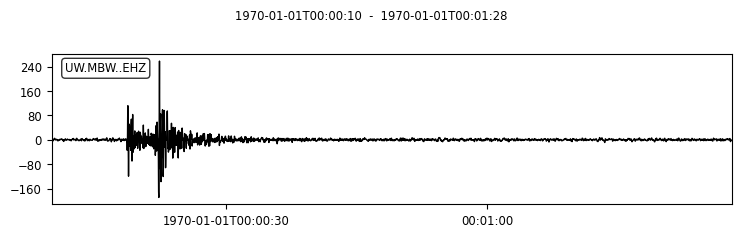

number of windows: 38
maximum amp window index: 6
Max Window:


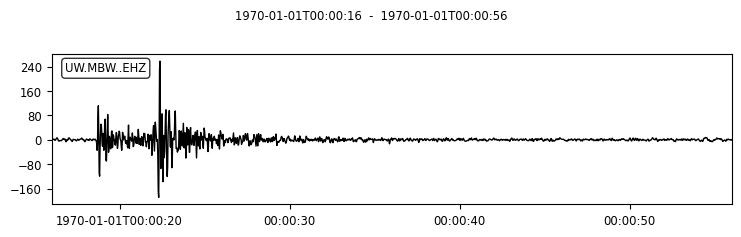

---
mbwehzrpba036 template original stream:


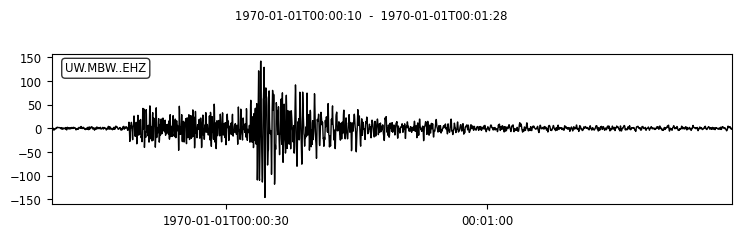

number of windows: 38
maximum amp window index: 8
Max Window:


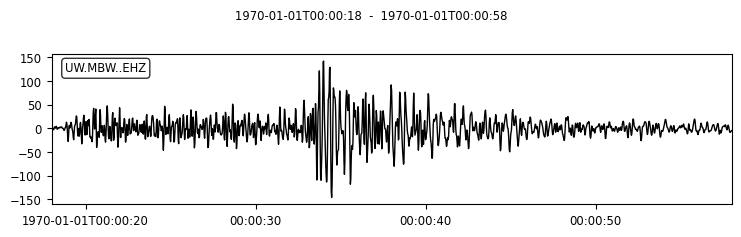

---
mbwehzrpba038 template original stream:


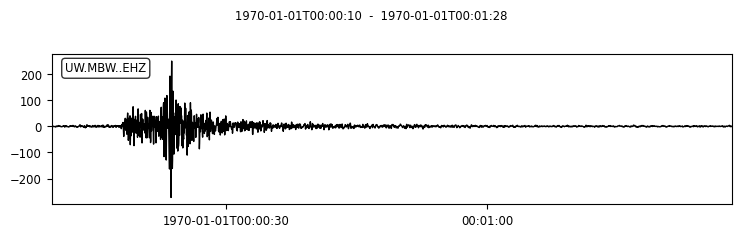

number of windows: 38
maximum amp window index: 8
Max Window:


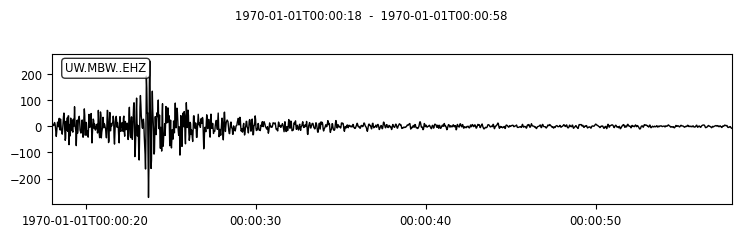

---
mbwehzrpba040 template original stream:


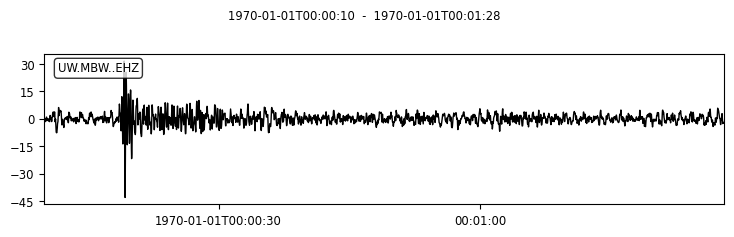

number of windows: 38
maximum amp window index: 8
Max Window:


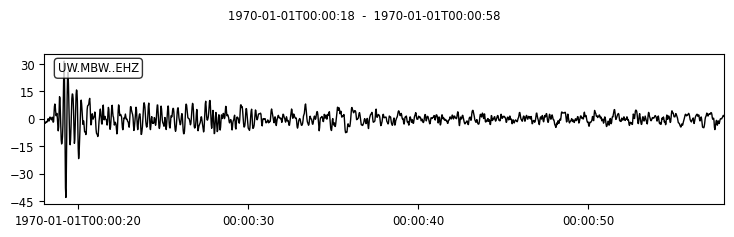

---
mbwehzrpba041 template original stream:


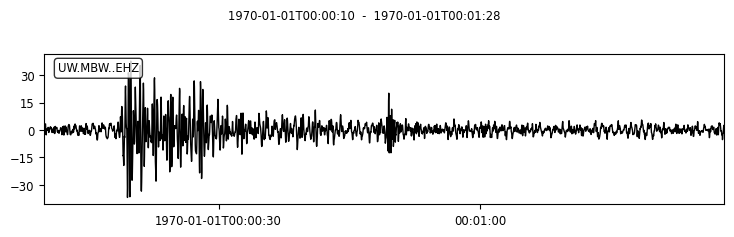

number of windows: 38
maximum amp window index: 3
Max Window:


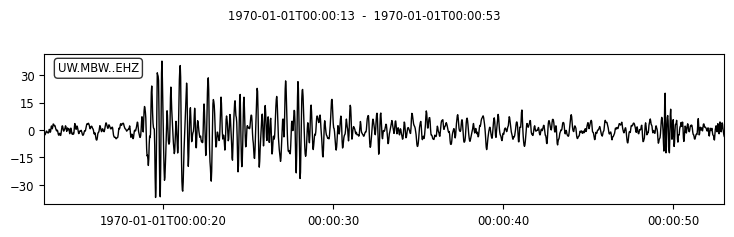

---
mbwehzrpba044 template original stream:


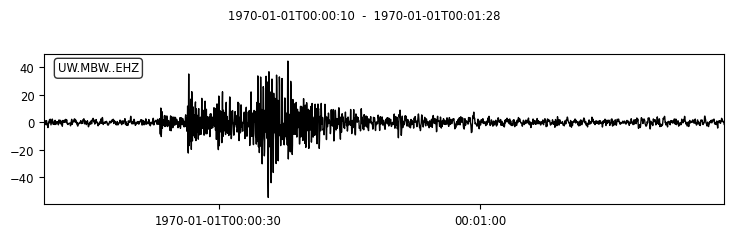

number of windows: 38
maximum amp window index: 13
Max Window:


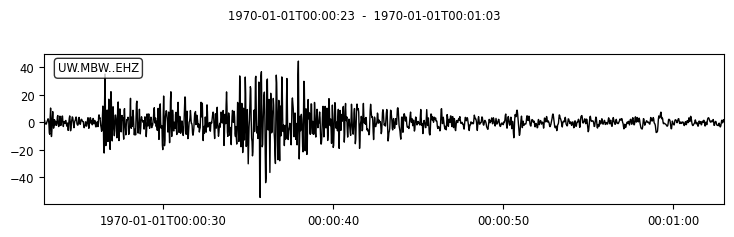

---
mbwehzrpba046 template original stream:


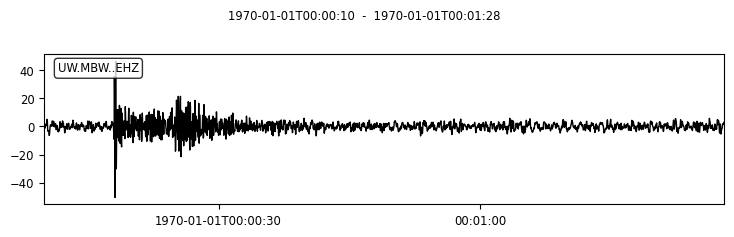

number of windows: 38
maximum amp window index: 8
Max Window:


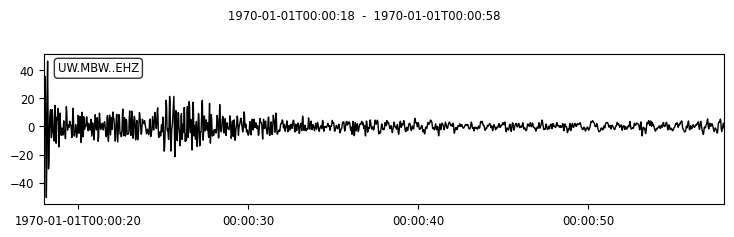

---
mbwehzrpba047 template original stream:


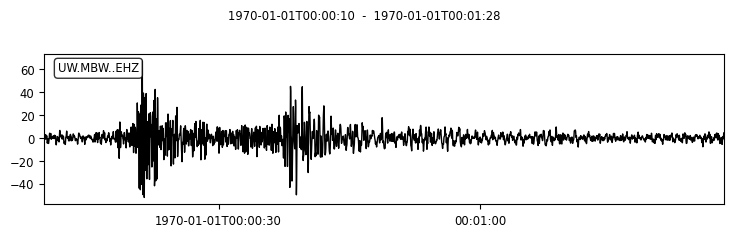

number of windows: 38
maximum amp window index: 8
Max Window:


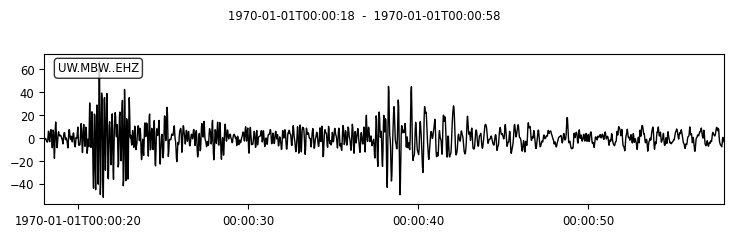

---
mbwehzrpba048 template original stream:


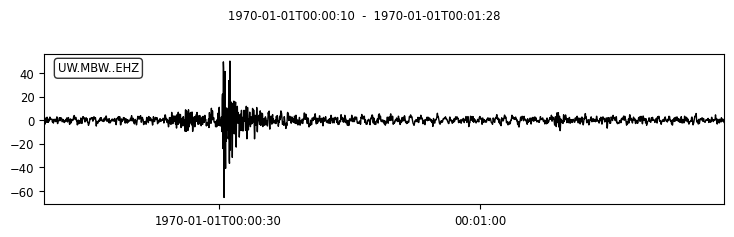

number of windows: 38
maximum amp window index: 14
Max Window:


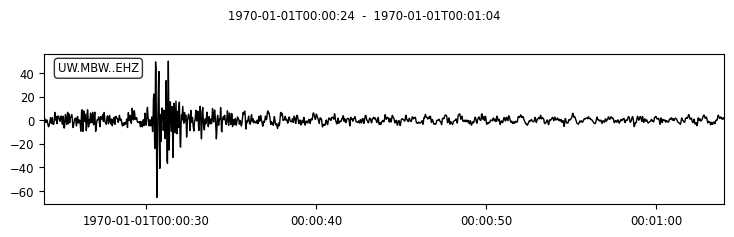

---
mbwehzrpba049 template original stream:


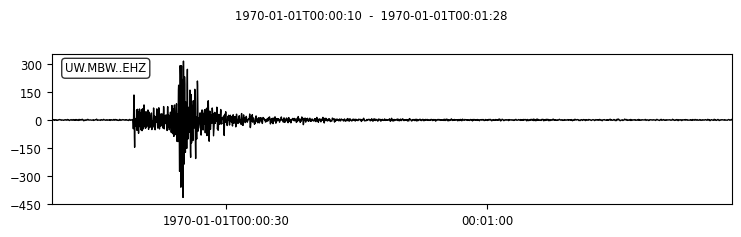

number of windows: 38
maximum amp window index: 9
Max Window:


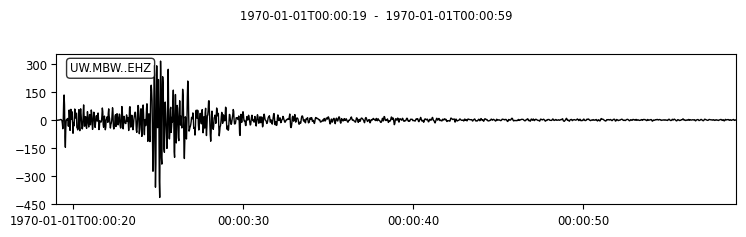

---
mbwehzrpba050 template original stream:


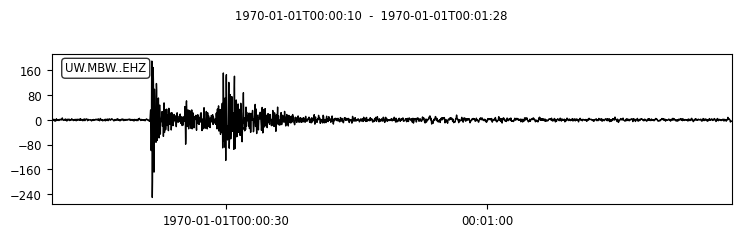

number of windows: 38
maximum amp window index: 11
Max Window:


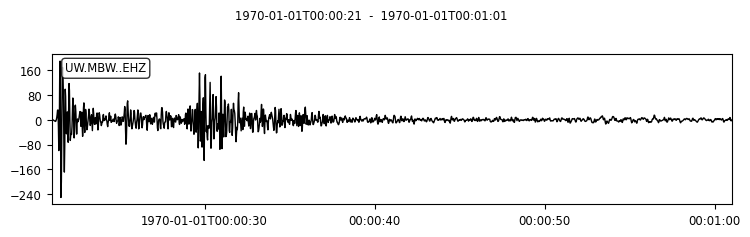

---
mbwehzrpba051 template original stream:


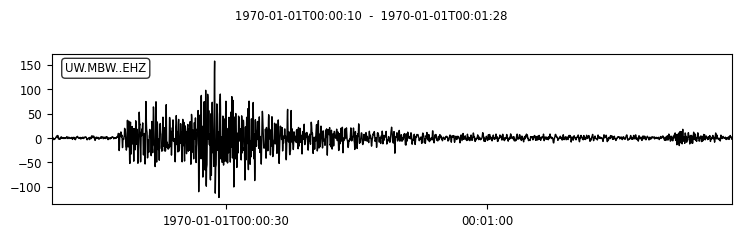

number of windows: 38
maximum amp window index: 7
Max Window:


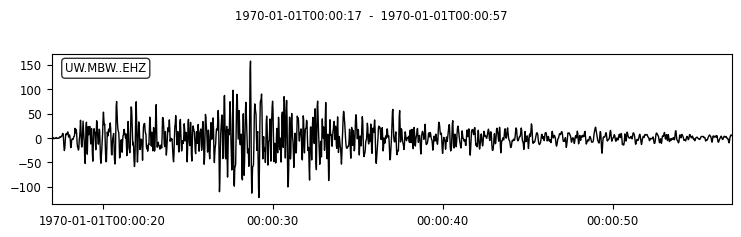

---
mbwehzrpba052 template original stream:


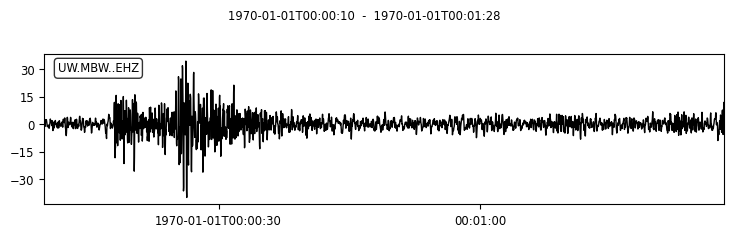

number of windows: 38
maximum amp window index: 8
Max Window:


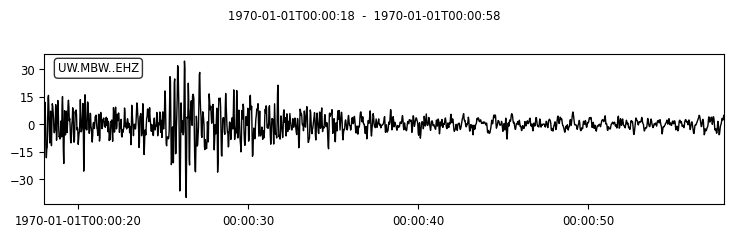

---
mbwehzrpba053 template original stream:


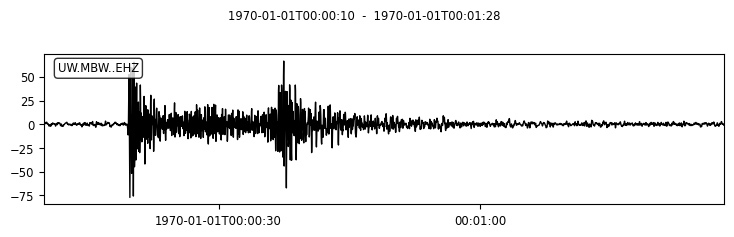

number of windows: 38
maximum amp window index: 9
Max Window:


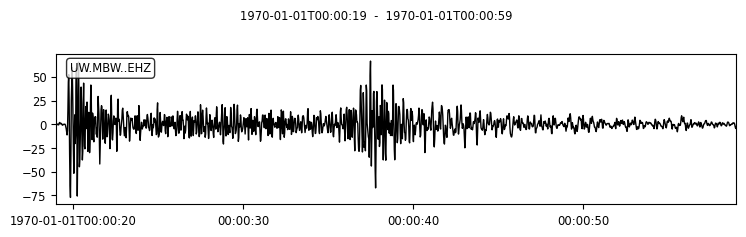

---
mbwehzrpba054 template original stream:


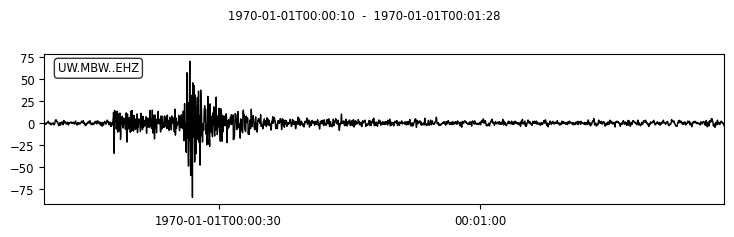

number of windows: 38
maximum amp window index: 6
Max Window:


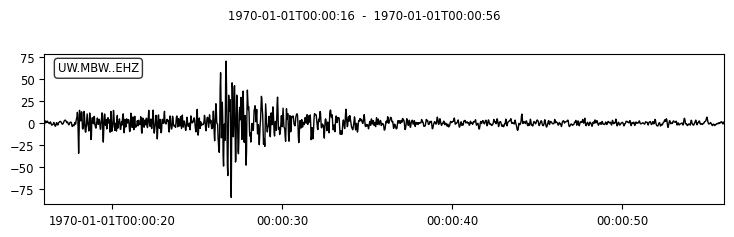

---
mbwehzrpba055 template original stream:


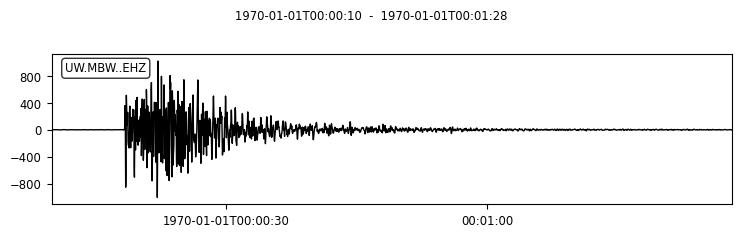

number of windows: 38
maximum amp window index: 8
Max Window:


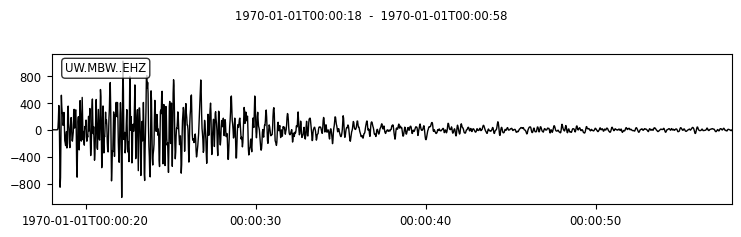

---
mbwehzrpba056 template original stream:


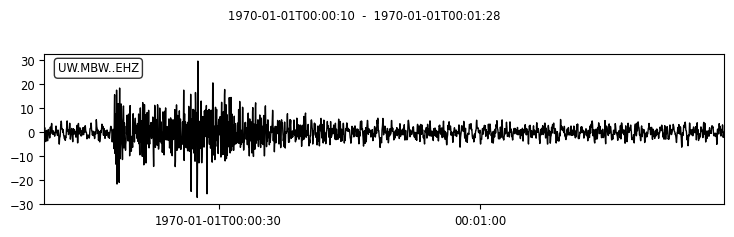

number of windows: 38
maximum amp window index: 8
Max Window:


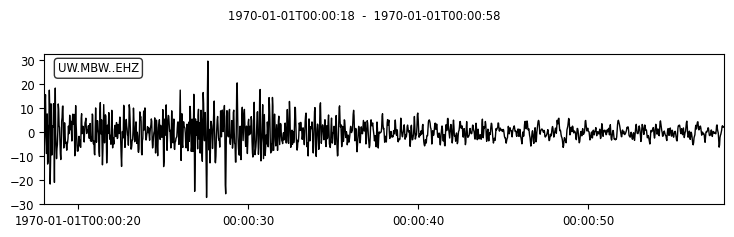

---
mbwehzrpba057 template original stream:


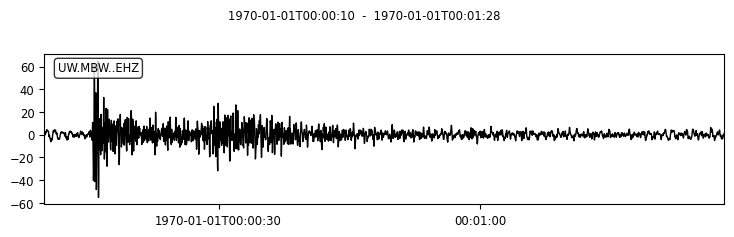

number of windows: 38
maximum amp window index: 5
Max Window:


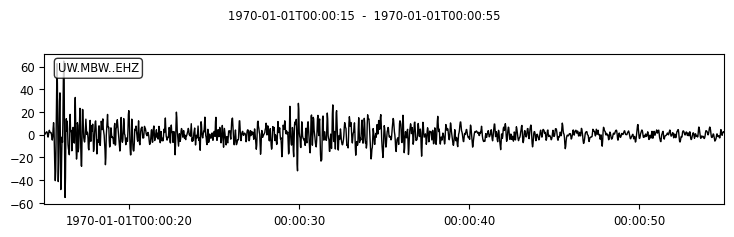

---
mbwehzrpba058 template original stream:


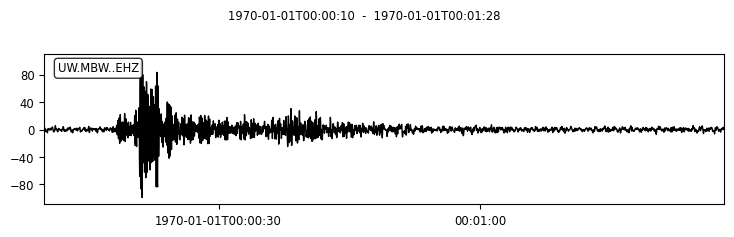

number of windows: 38
maximum amp window index: 8
Max Window:


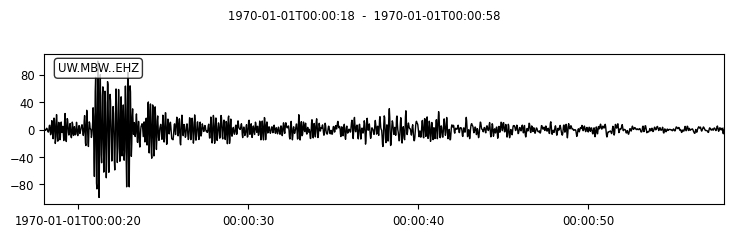

---
mbwehzrpba059 template original stream:


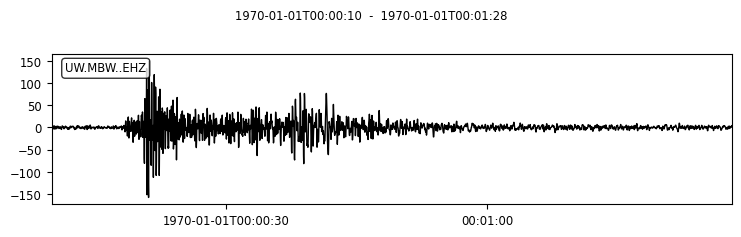

number of windows: 38
maximum amp window index: 8
Max Window:


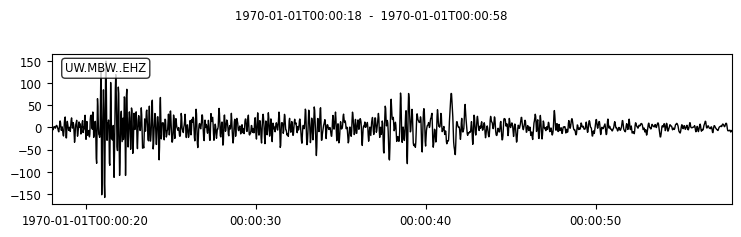

---
mbwehzrpba060 template original stream:


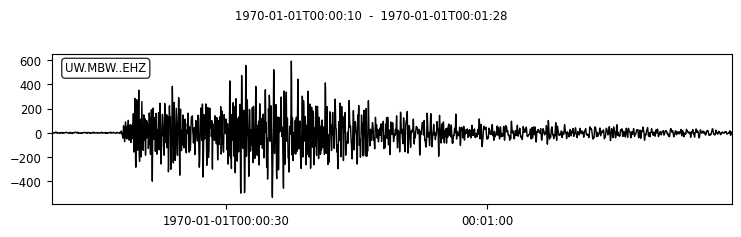

number of windows: 38
maximum amp window index: 8
Max Window:


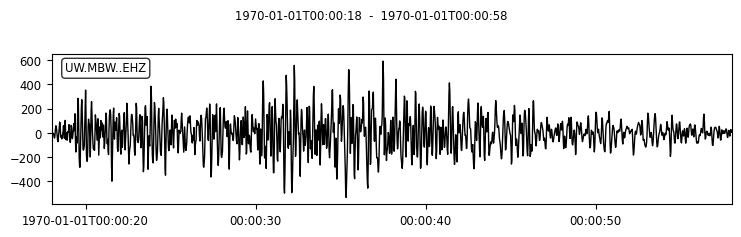

---
mbwehzrpba061 template original stream:


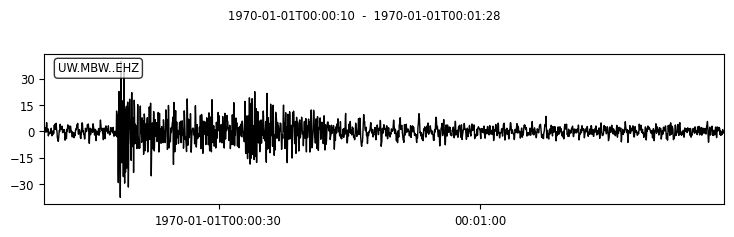

number of windows: 38
maximum amp window index: 8
Max Window:


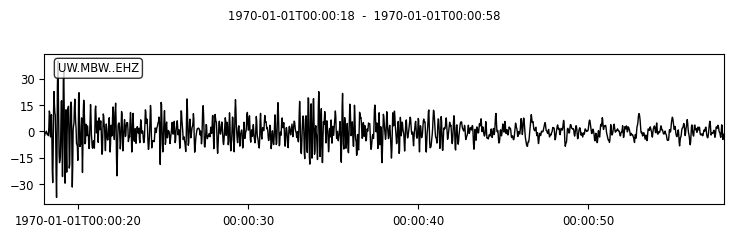

---
mbwehzrpba063 template original stream:


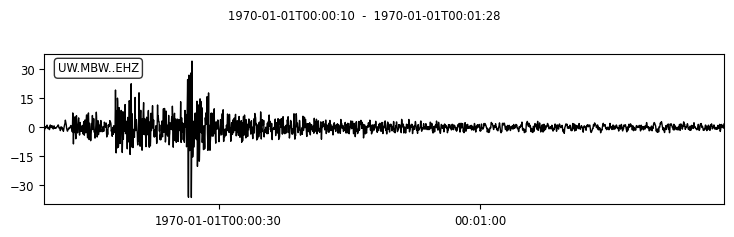

number of windows: 38
maximum amp window index: 2
Max Window:


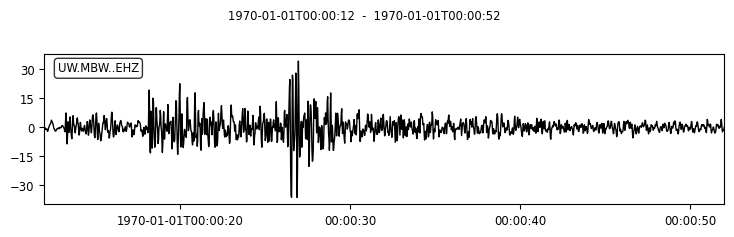

---
mbwehzrpba064 template original stream:


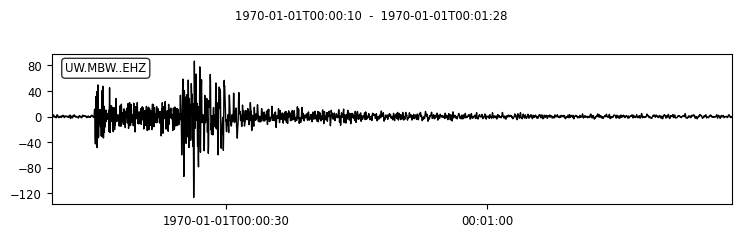

number of windows: 38
maximum amp window index: 5
Max Window:


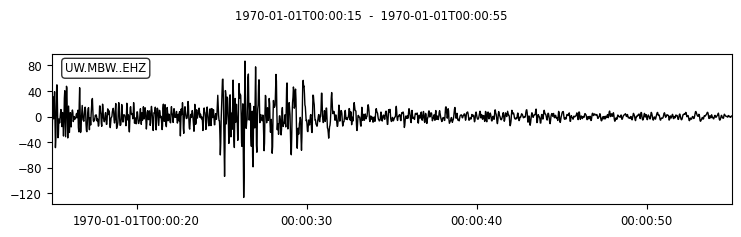

---
mbwehzrpba065 template original stream:


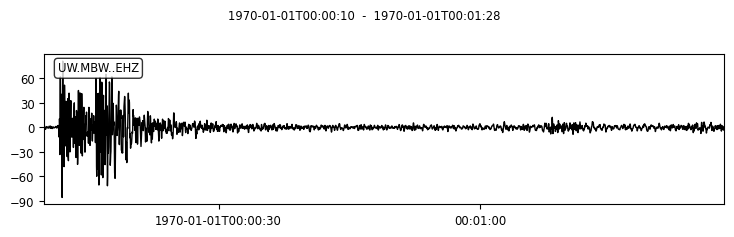

number of windows: 38
maximum amp window index: 1
Max Window:


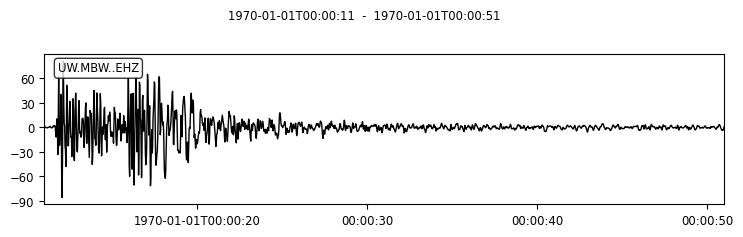

---
mbwehzrpba066 template original stream:


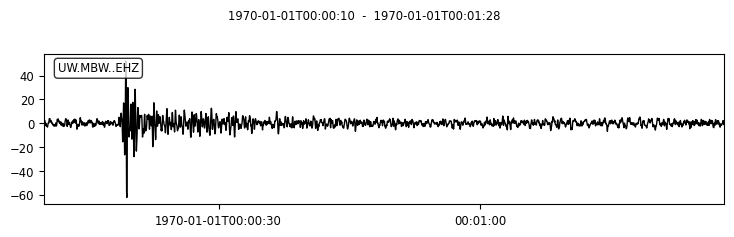

number of windows: 38
maximum amp window index: 1
Max Window:


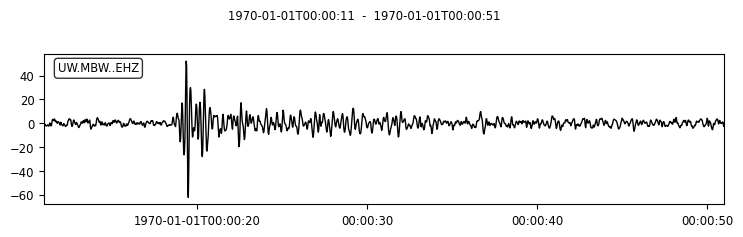

---
mbwehzrpba067 template original stream:


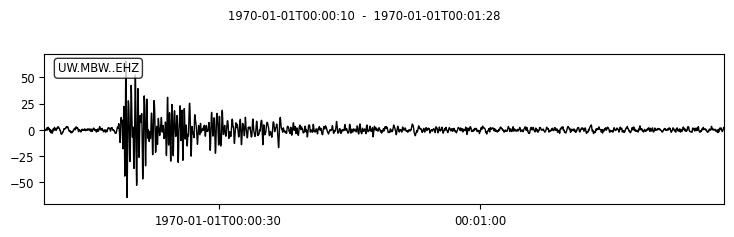

number of windows: 38
maximum amp window index: 7
Max Window:


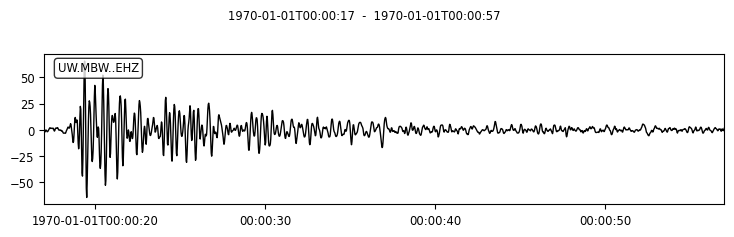

---
mbwehzrpba068 template original stream:


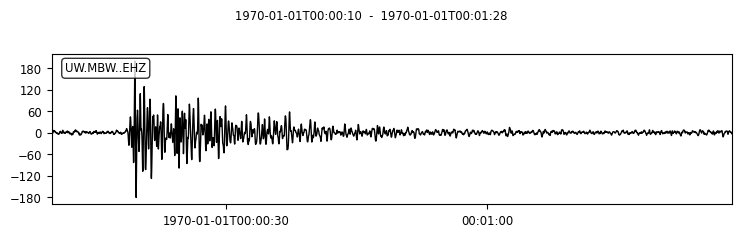

number of windows: 38
maximum amp window index: 8
Max Window:


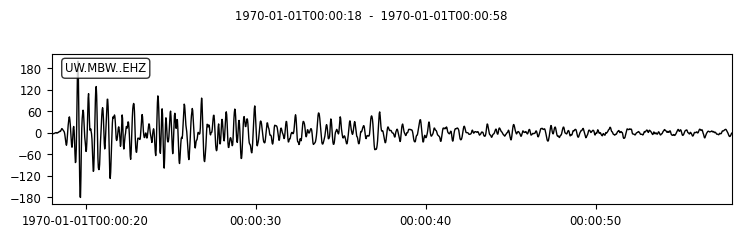

---
mbwehzrpba069 template original stream:


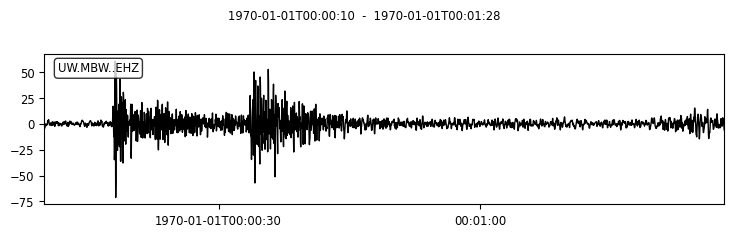

number of windows: 38
maximum amp window index: 8
Max Window:


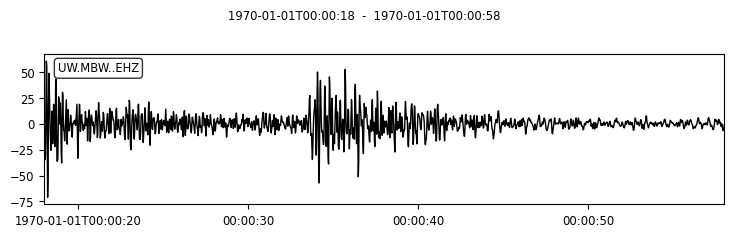

---
mbwehzrpba070 template original stream:


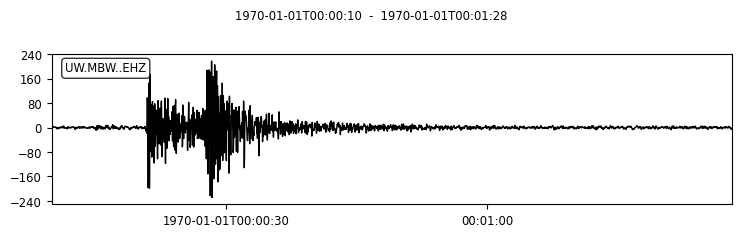

number of windows: 38
maximum amp window index: 8
Max Window:


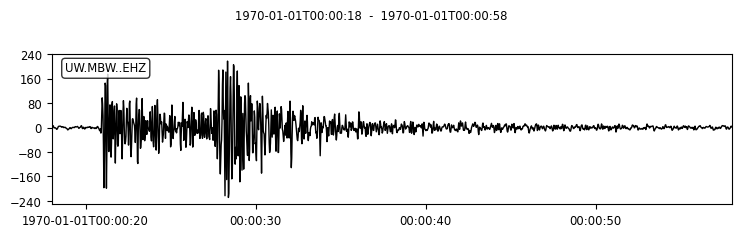

---
mbwehzrpba071 template original stream:


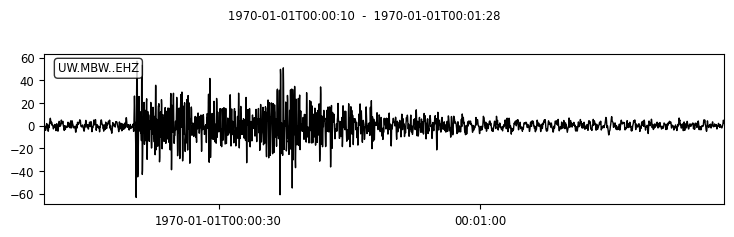

number of windows: 38
maximum amp window index: 10
Max Window:


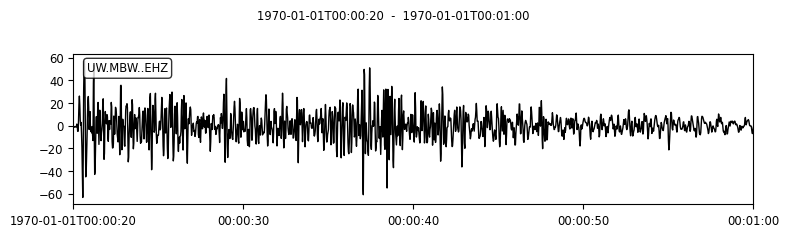

---
mbwehzrpba072 template original stream:


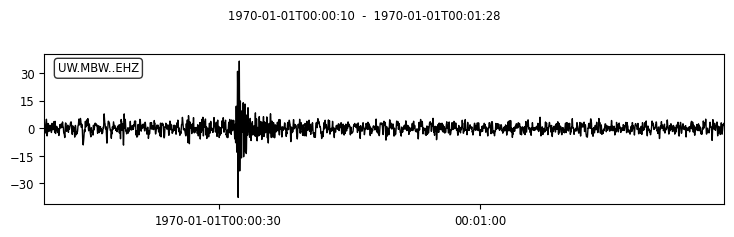

number of windows: 38
maximum amp window index: 1
Max Window:


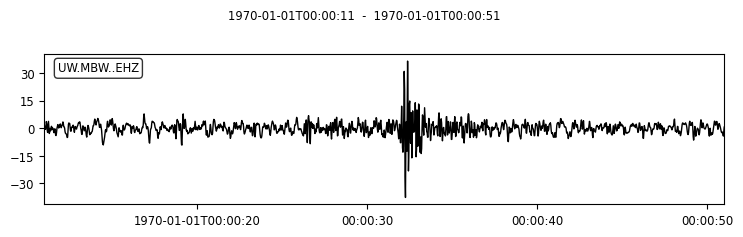

---
mbwehzrpba073 template original stream:


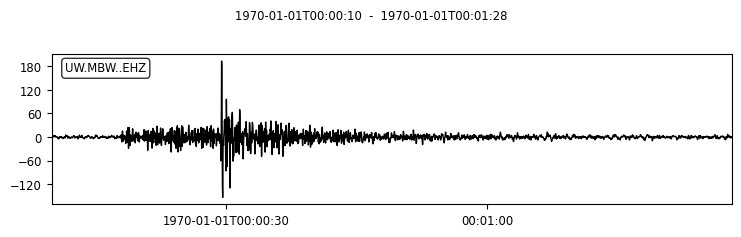

number of windows: 38
maximum amp window index: 8
Max Window:


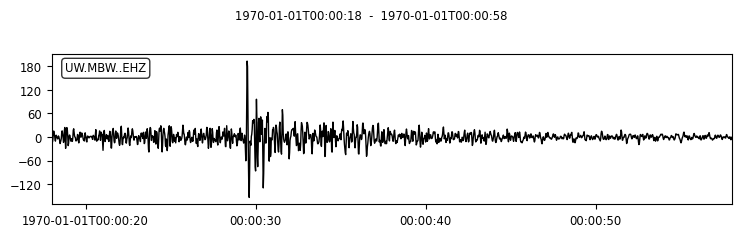

---
mbwehzrpba074 template original stream:


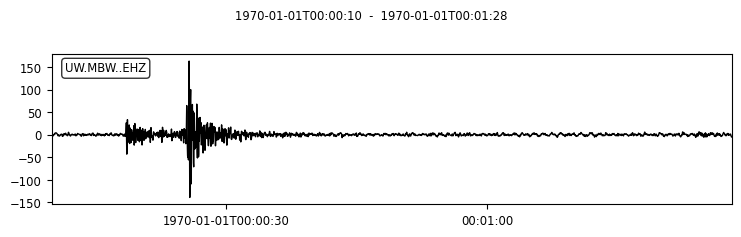

number of windows: 38
maximum amp window index: 8
Max Window:


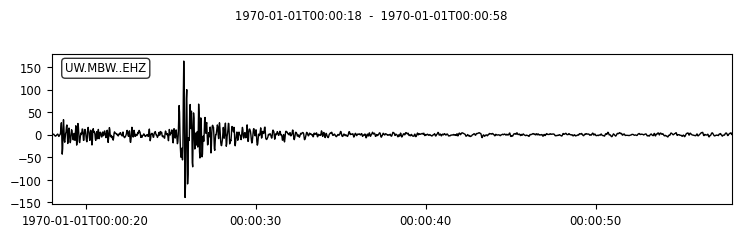

---
mbwehzrpba075 template original stream:


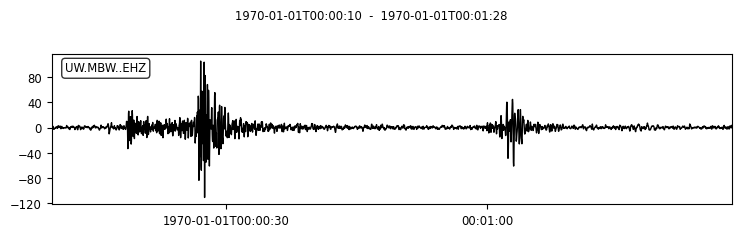

number of windows: 38
maximum amp window index: 15
Max Window:


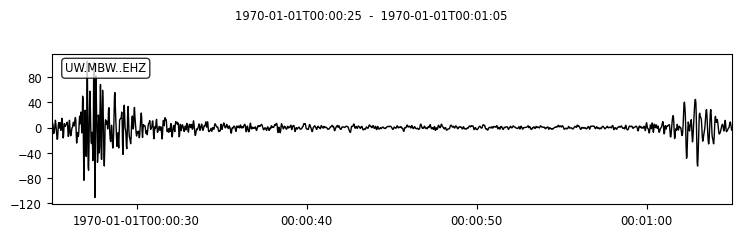

---
mbwehzrpba076 template original stream:


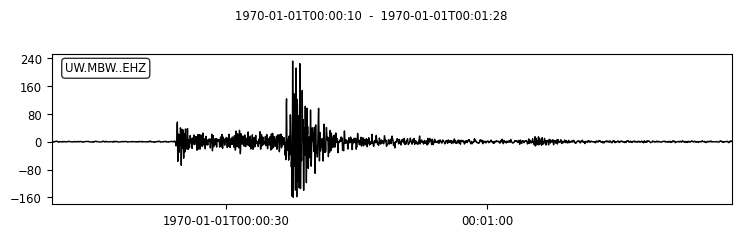

number of windows: 38
maximum amp window index: 14
Max Window:


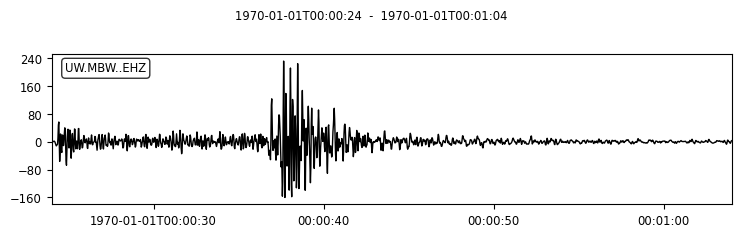

---
mbwehzrpba077 template original stream:


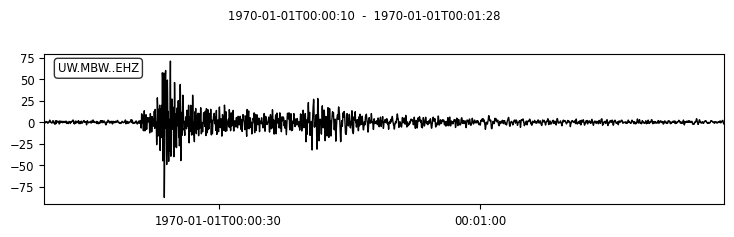

number of windows: 38
maximum amp window index: 11
Max Window:


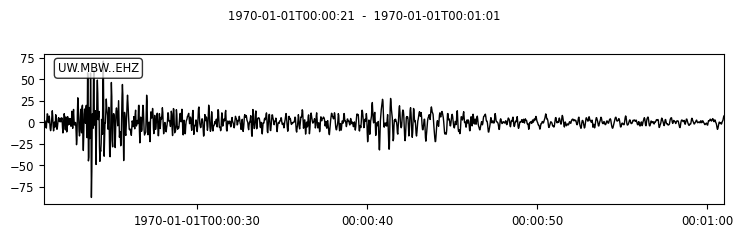

---
mbwehzrpba078 template original stream:


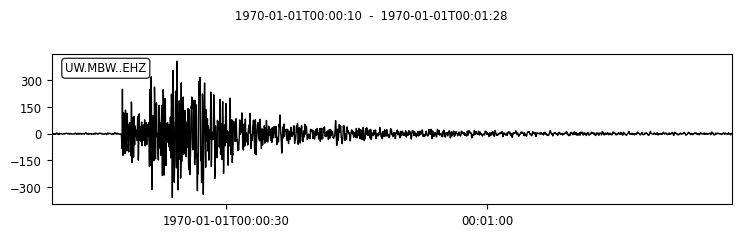

number of windows: 38
maximum amp window index: 8
Max Window:


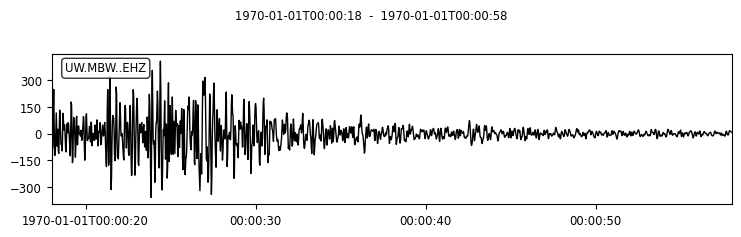

---
mbwehzrpba079 template original stream:


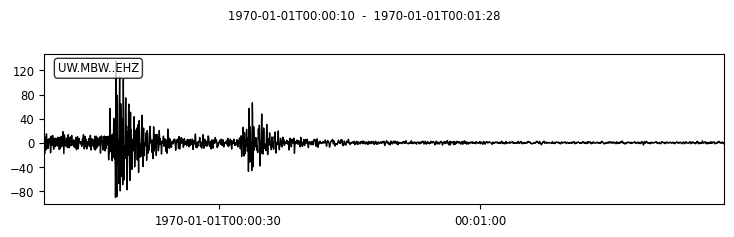

number of windows: 38
maximum amp window index: 0
Max Window:


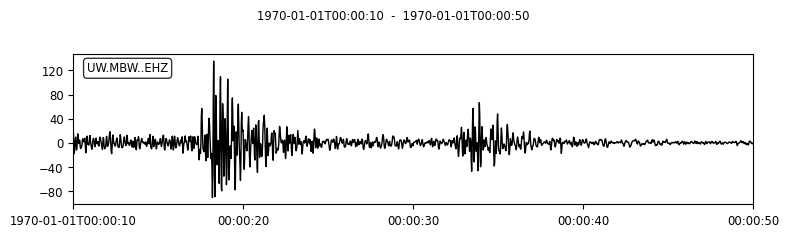

---
mbwehzrpba080 template original stream:


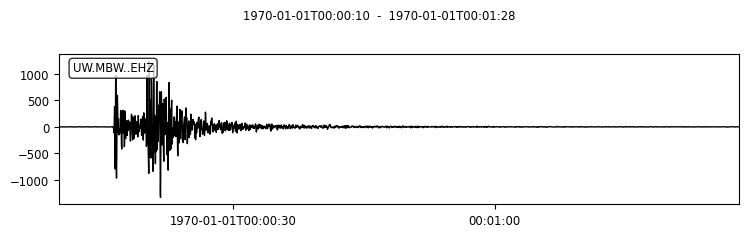

number of windows: 38
maximum amp window index: 6
Max Window:


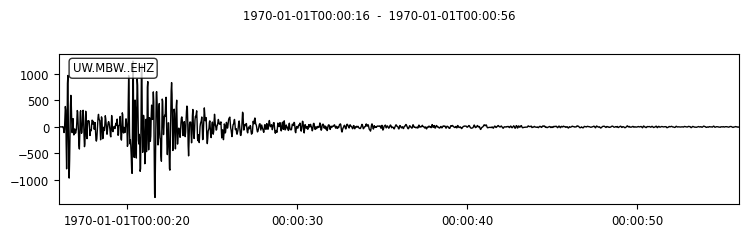

---
mbwehzrpba081 template original stream:


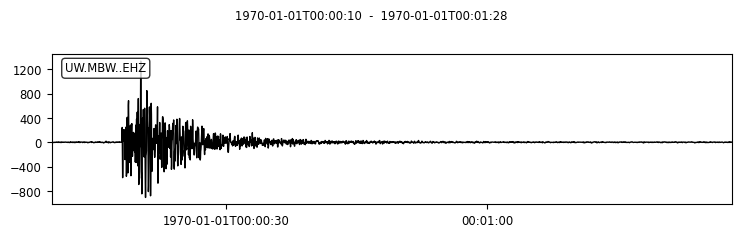

number of windows: 38
maximum amp window index: 8
Max Window:


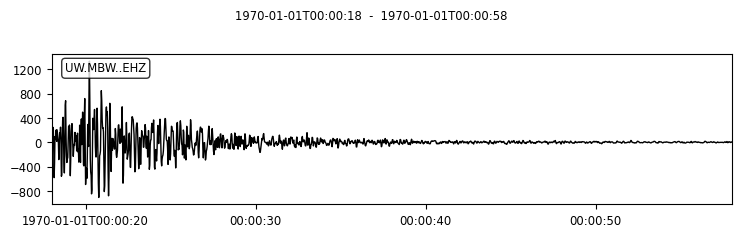

---
mbwehzrpba082 template original stream:


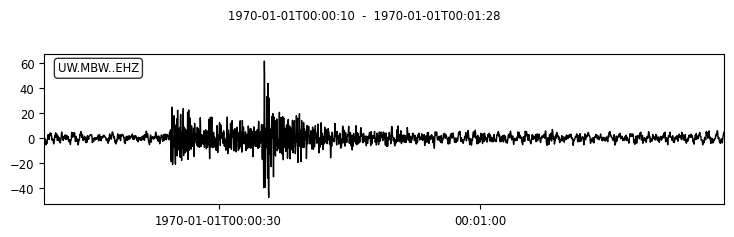

number of windows: 38
maximum amp window index: 14
Max Window:


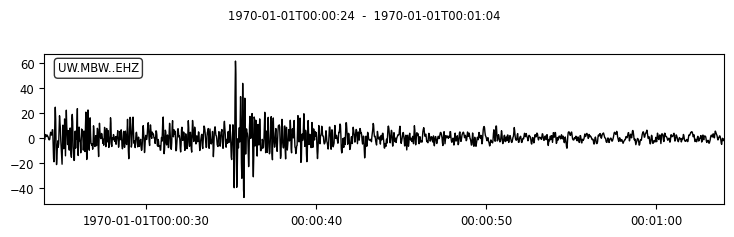

---
mbwehzrpba083 template original stream:


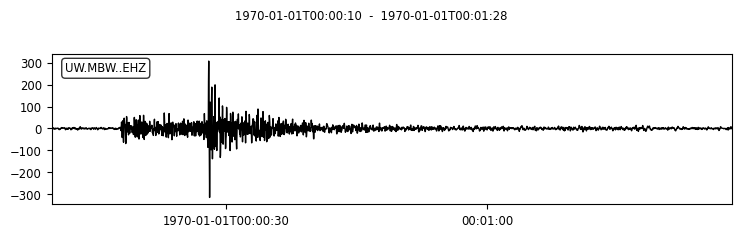

number of windows: 38
maximum amp window index: 8
Max Window:


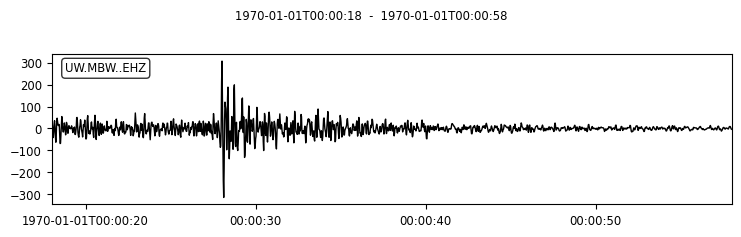

---
mbwehzrpba084 template original stream:


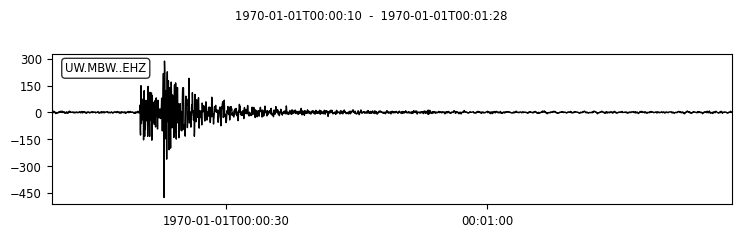

number of windows: 38
maximum amp window index: 9
Max Window:


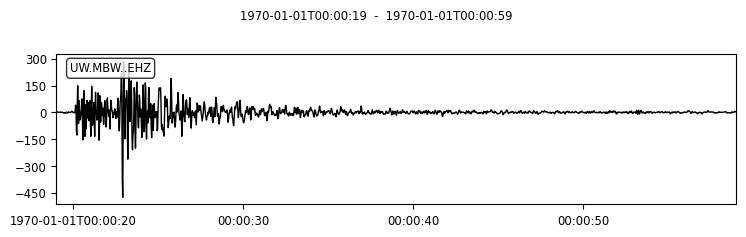

---
mbwehzrpba085 template original stream:


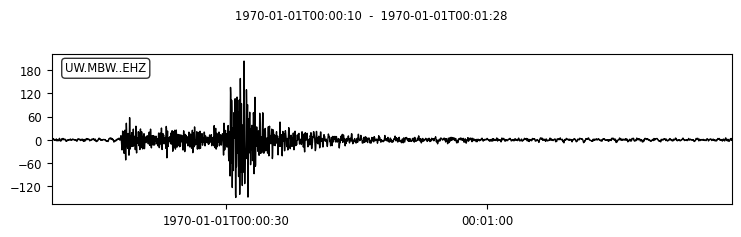

number of windows: 38
maximum amp window index: 8
Max Window:


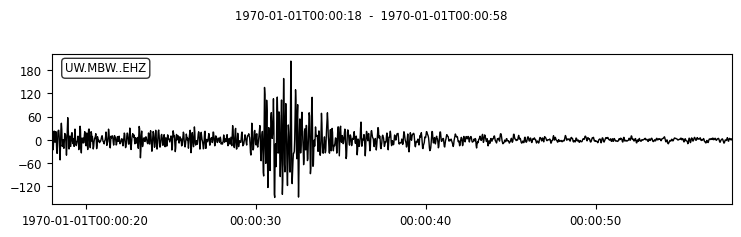

---
mbwehzrpba086 template original stream:


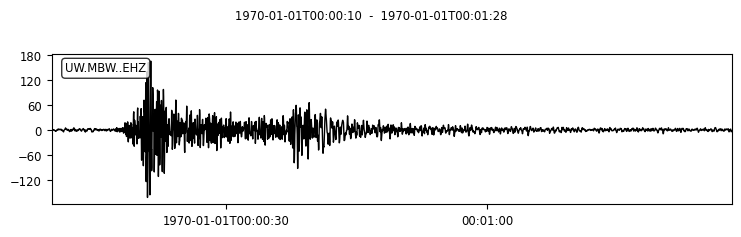

number of windows: 38
maximum amp window index: 8
Max Window:


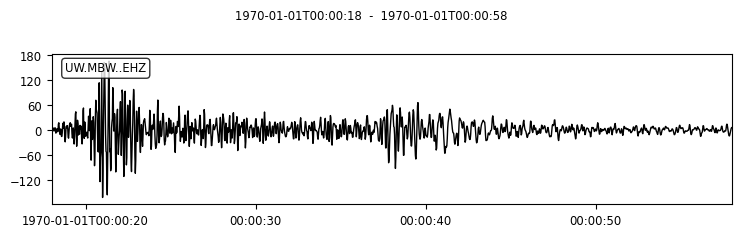

---
mbwehzrpba087 template original stream:


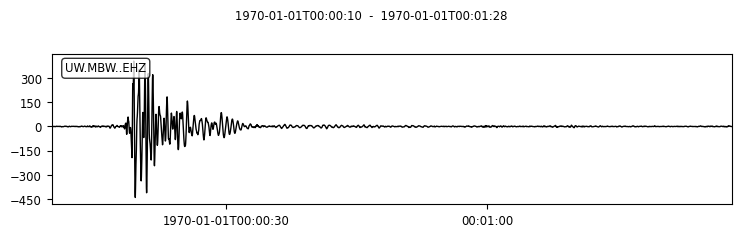

number of windows: 38
maximum amp window index: 4
Max Window:


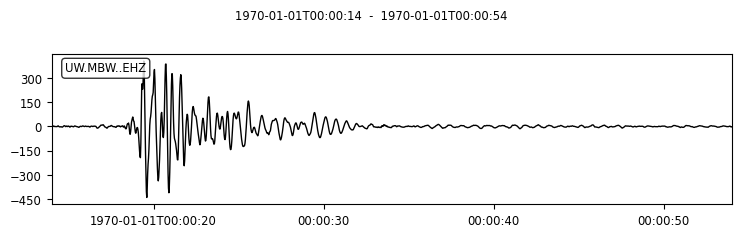

---
mbwehzrpba088 template original stream:


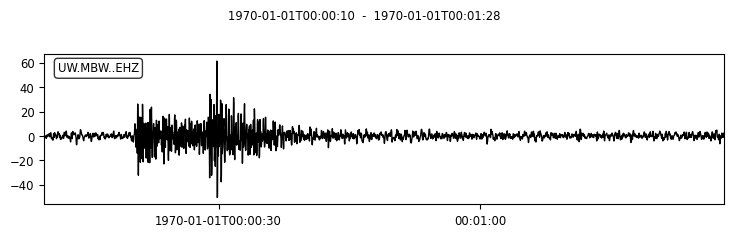

number of windows: 38
maximum amp window index: 9
Max Window:


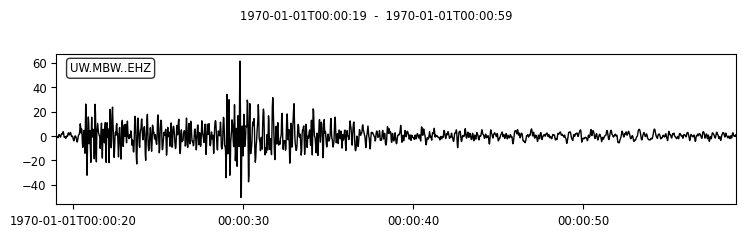

---
mbwehzrpba089 template original stream:


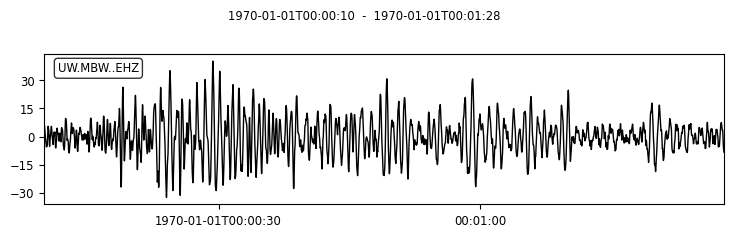

number of windows: 38
maximum amp window index: 12
Max Window:


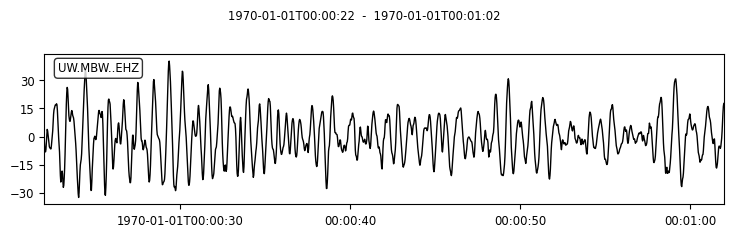

---
mbwehzrpba090 template original stream:


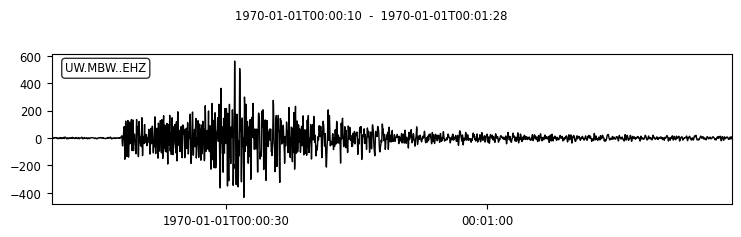

number of windows: 38
maximum amp window index: 8
Max Window:


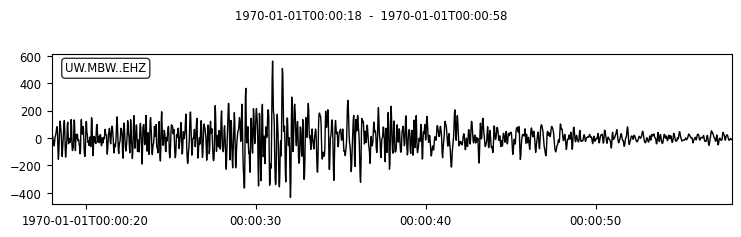

---
mbwehzrpba091 template original stream:


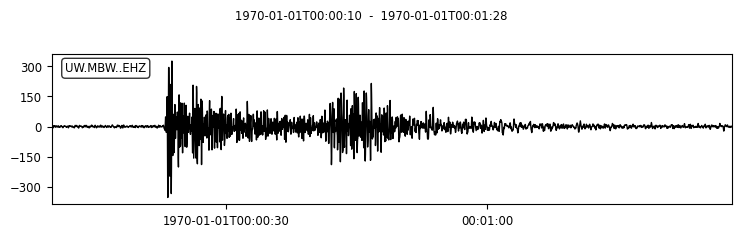

number of windows: 38
maximum amp window index: 13
Max Window:


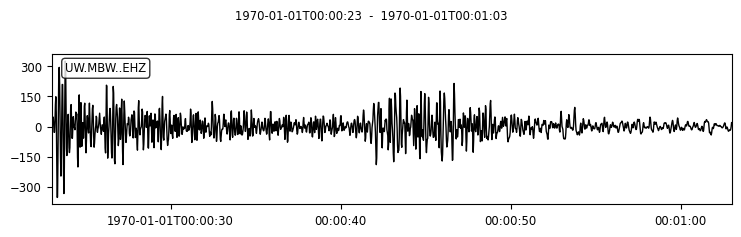

---
mbwehzrpba093 template original stream:


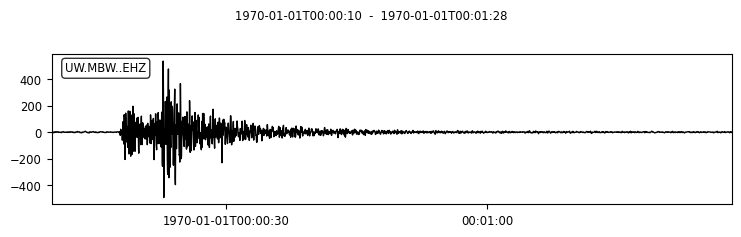

number of windows: 38
maximum amp window index: 8
Max Window:


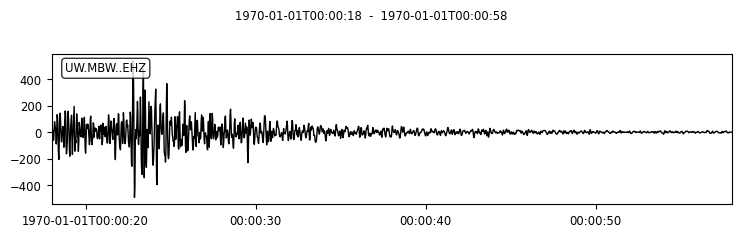

---
mbwehzrpba095 template original stream:


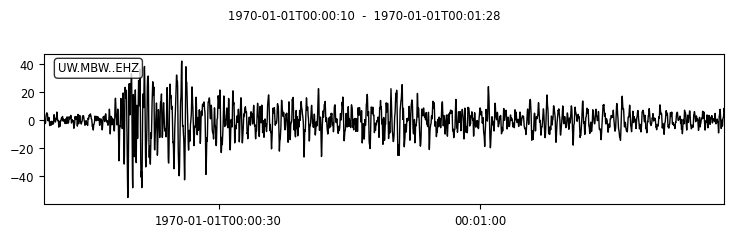

number of windows: 38
maximum amp window index: 8
Max Window:


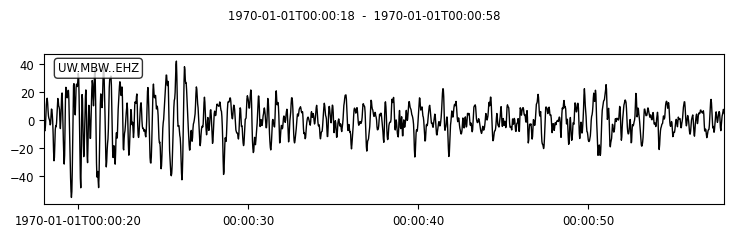

---
mbwehzrpba097 template original stream:


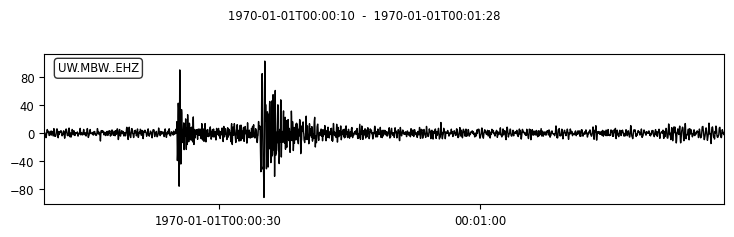

number of windows: 38
maximum amp window index: 15
Max Window:


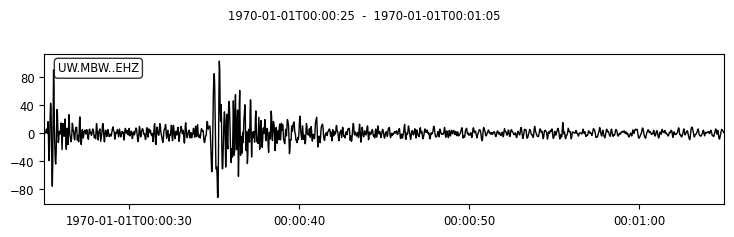

---
mbwehzrpba098 template original stream:


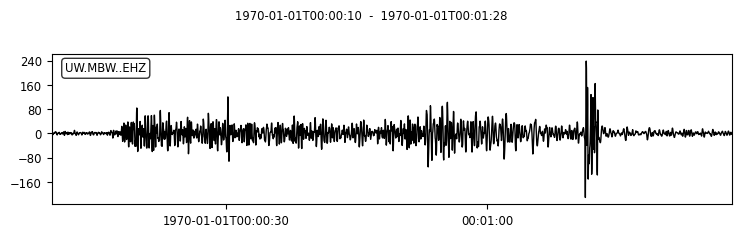

number of windows: 38
maximum amp window index: 23
Max Window:


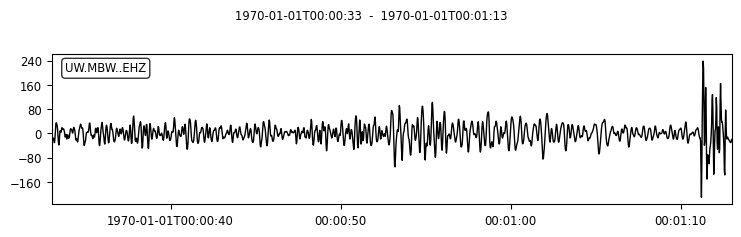

---
mbwehzrpba100 template original stream:


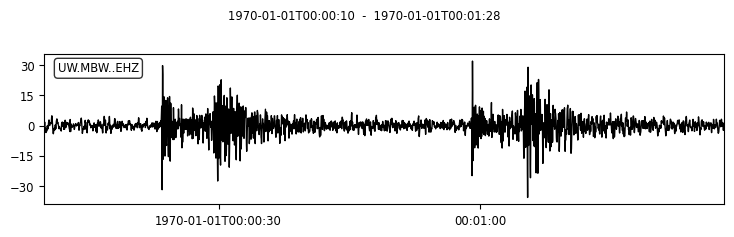

number of windows: 38
maximum amp window index: 19
Max Window:


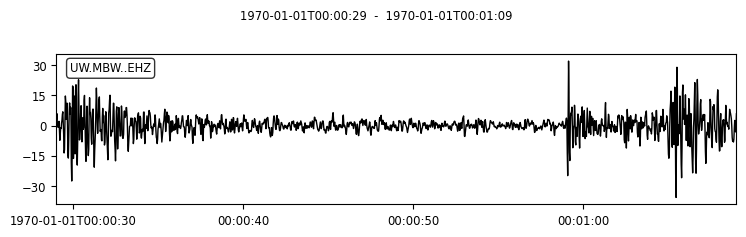

---
mbwehzrpba101 template original stream:


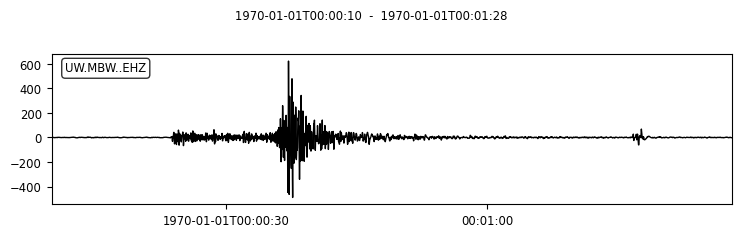

number of windows: 38
maximum amp window index: 13
Max Window:


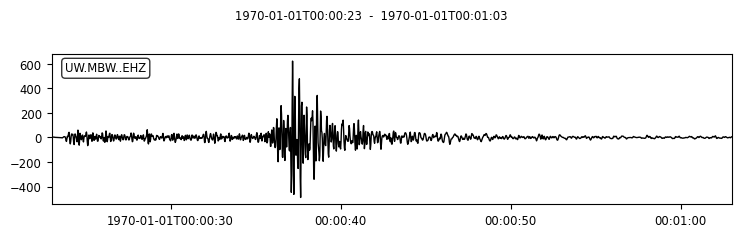

---
mbwehzrpba102 template original stream:


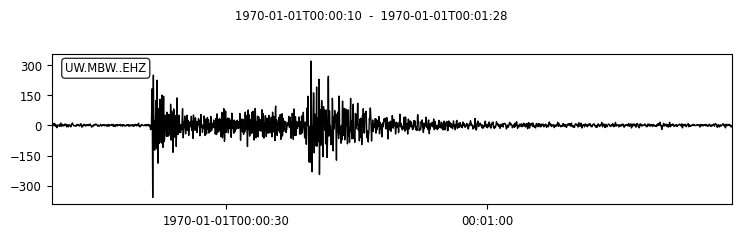

number of windows: 38
maximum amp window index: 11
Max Window:


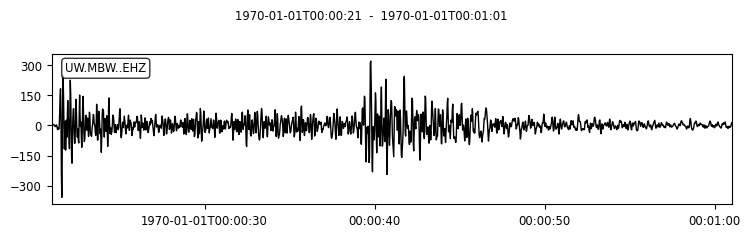

---
mbwehzrpba103 template original stream:


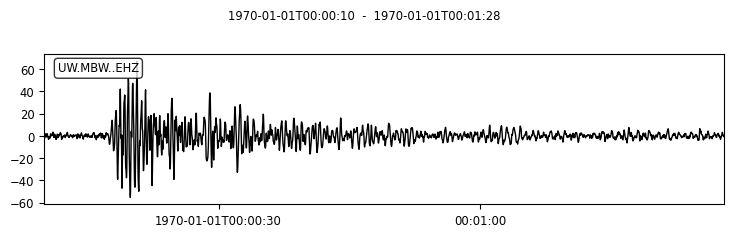

number of windows: 38
maximum amp window index: 7
Max Window:


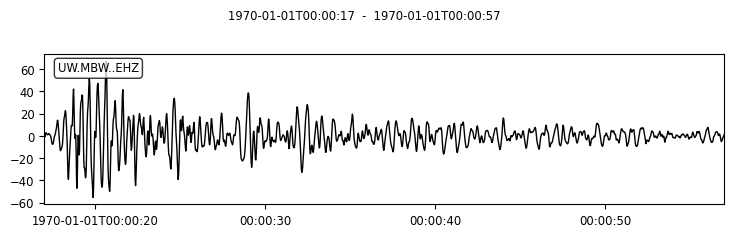

---
mbwehzrpba104 template original stream:


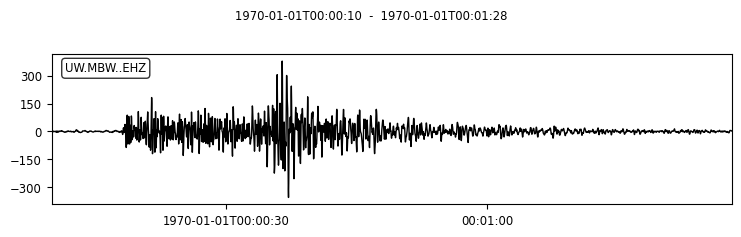

number of windows: 38
maximum amp window index: 8
Max Window:


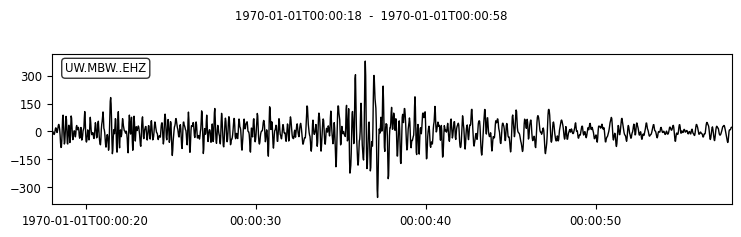

---
mbwehzrpba105 template original stream:


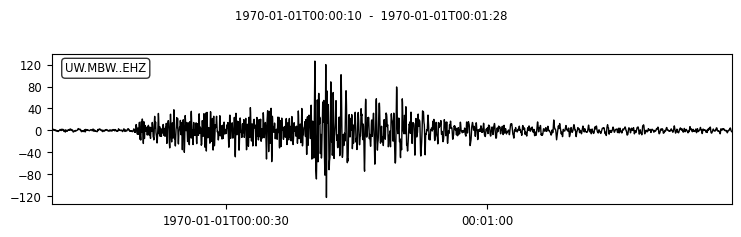

number of windows: 38
maximum amp window index: 10
Max Window:


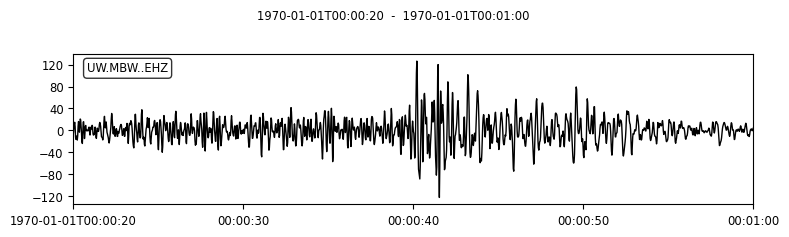

---
mbwehzrpba106 template original stream:


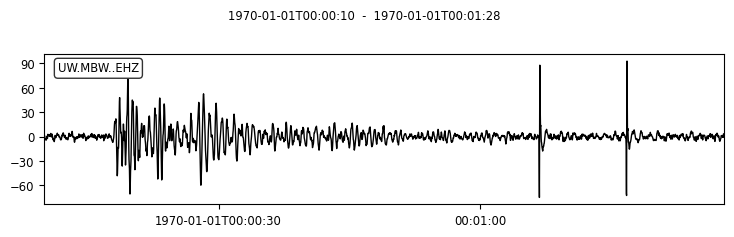

number of windows: 38
maximum amp window index: 7
Max Window:


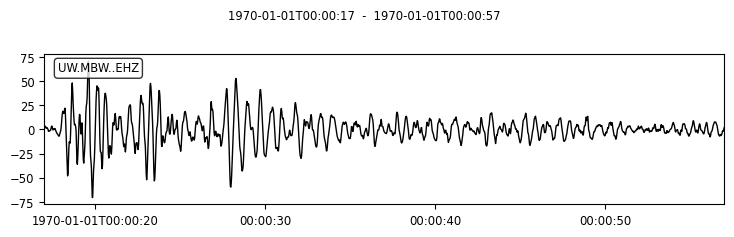

---
mbwehzrpba108 template original stream:


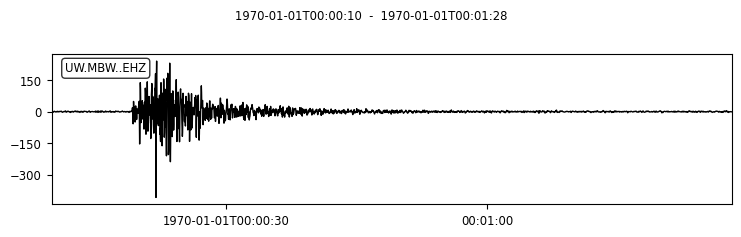

number of windows: 38
maximum amp window index: 9
Max Window:


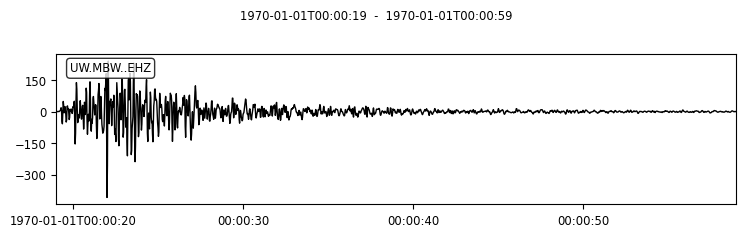

---
mbwehzrpba109 template original stream:


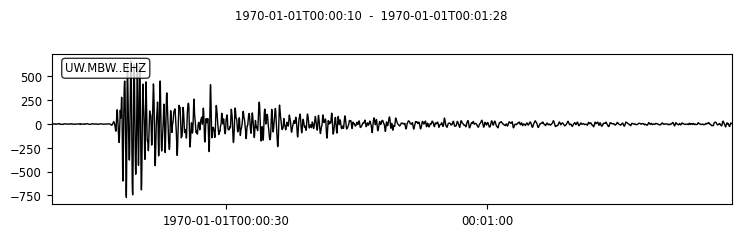

number of windows: 38
maximum amp window index: 7
Max Window:


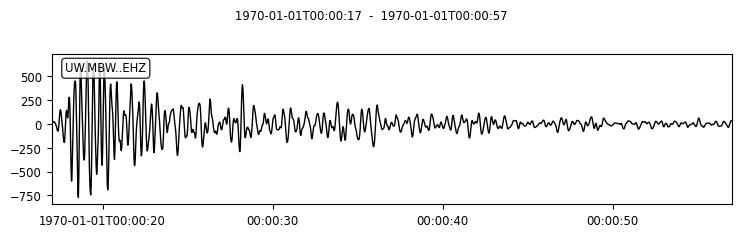

---
mbwehzrpba110 template original stream:


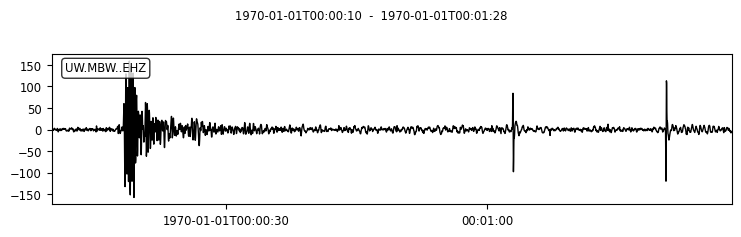

number of windows: 38
maximum amp window index: 8
Max Window:


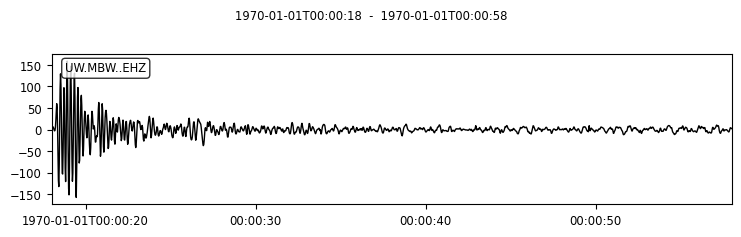

---
mbwehzrpba111 template original stream:


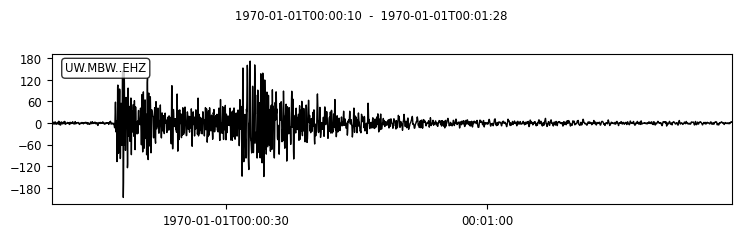

number of windows: 38
maximum amp window index: 7
Max Window:


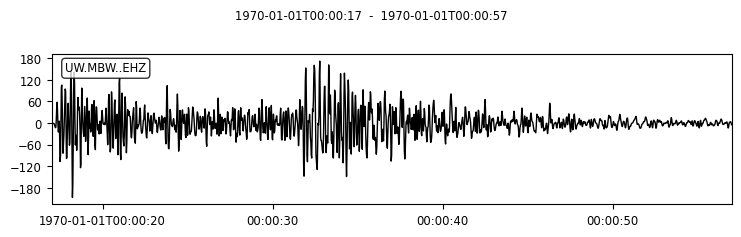

---
mbwehzrpba112 template original stream:


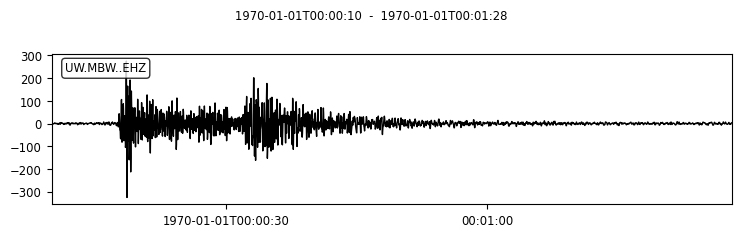

number of windows: 38
maximum amp window index: 7
Max Window:


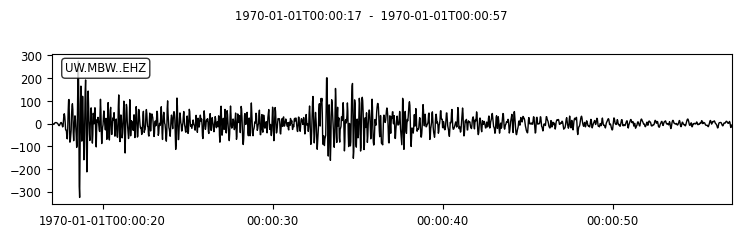

---
mbwehzrpba113 template original stream:


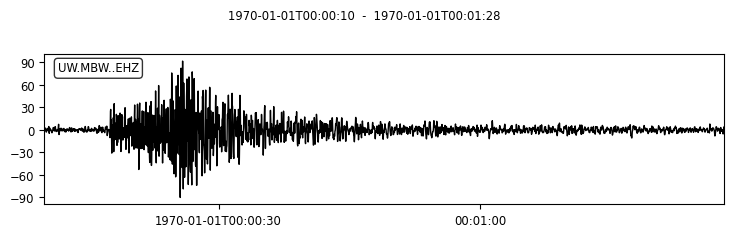

number of windows: 38
maximum amp window index: 6
Max Window:


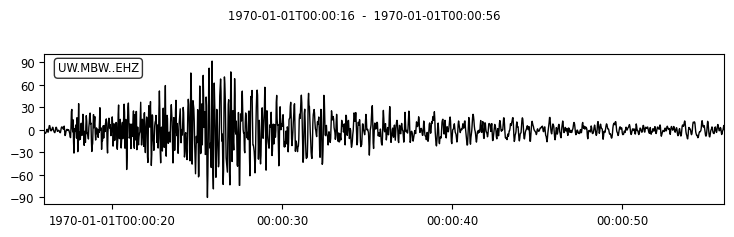

---
mbwehzrpba114 template original stream:


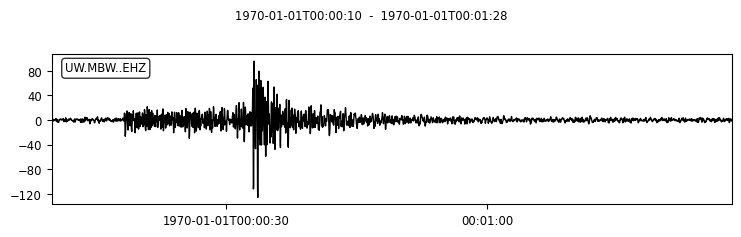

number of windows: 38
maximum amp window index: 8
Max Window:


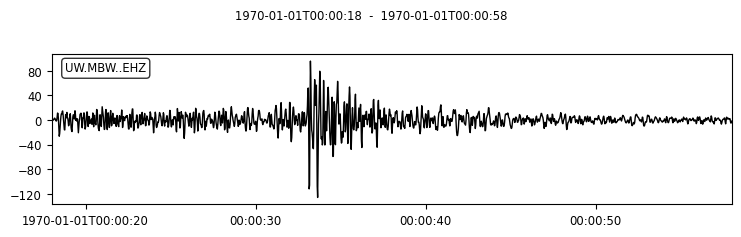

---
mbwehzrpba115 template original stream:


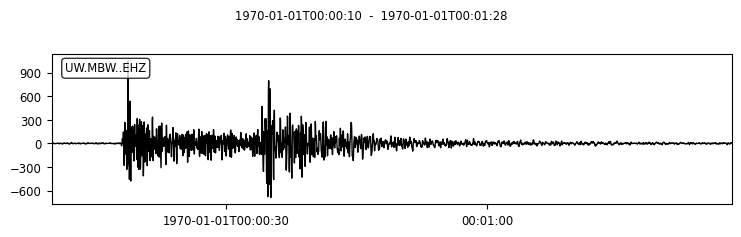

number of windows: 38
maximum amp window index: 8
Max Window:


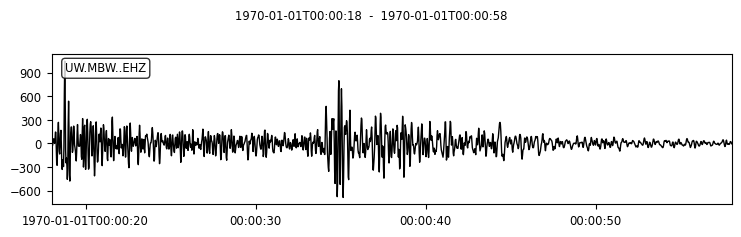

---
mbwehzrpba117 template original stream:


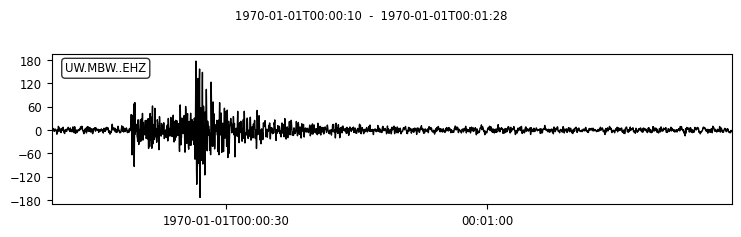

number of windows: 38
maximum amp window index: 6
Max Window:


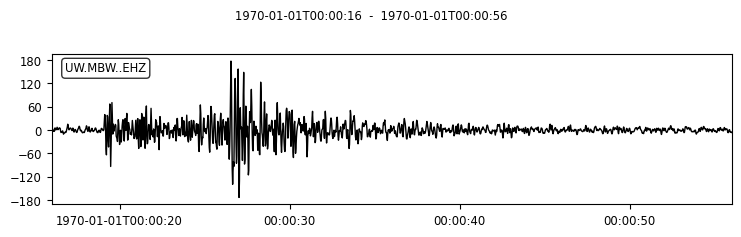

---
mbwehzrpba118 template original stream:


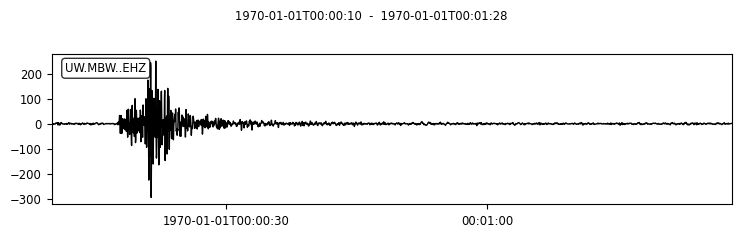

number of windows: 38
maximum amp window index: 7
Max Window:


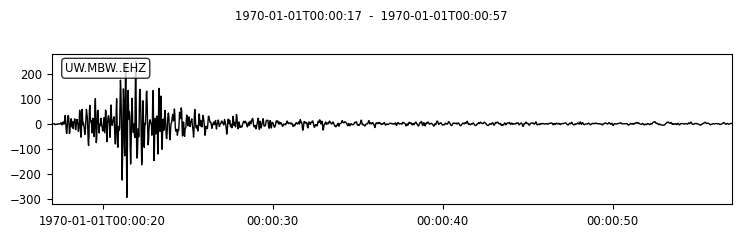

---
mbwehzrpba119 template original stream:


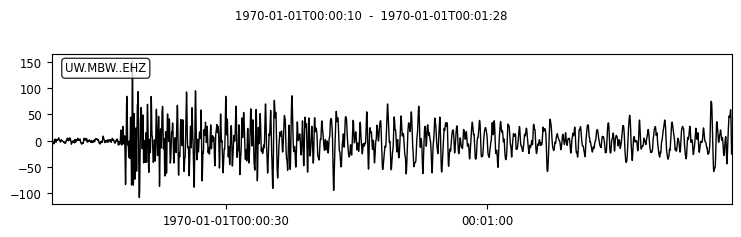

number of windows: 38
maximum amp window index: 8
Max Window:


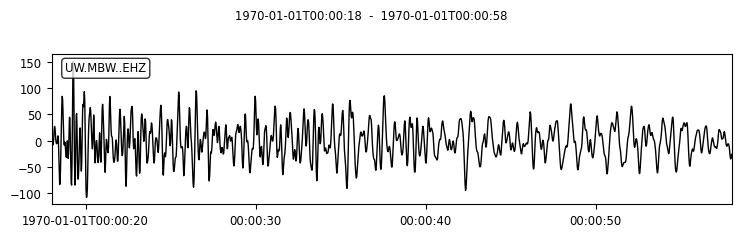

---
mbwehzrpba120 template original stream:


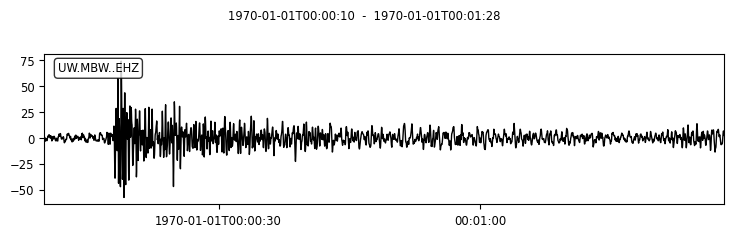

number of windows: 38
maximum amp window index: 8
Max Window:


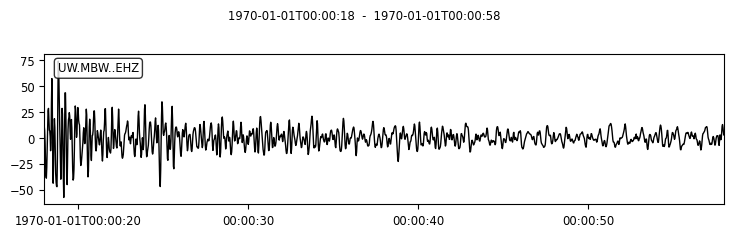

---
mbwehzrpba121 template original stream:


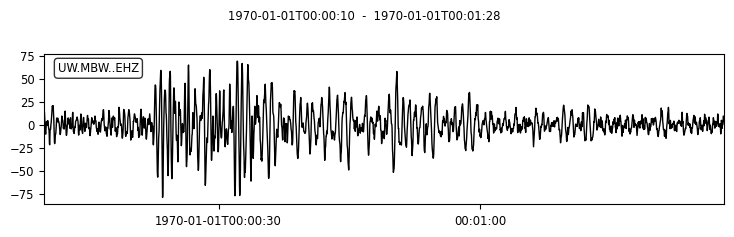

number of windows: 38
maximum amp window index: 10
Max Window:


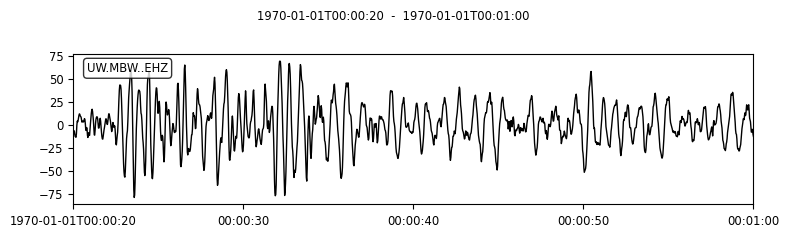

---
mbwehzrpba122 template original stream:


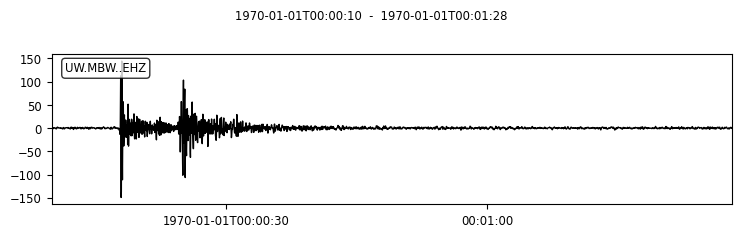

number of windows: 38
maximum amp window index: 7
Max Window:


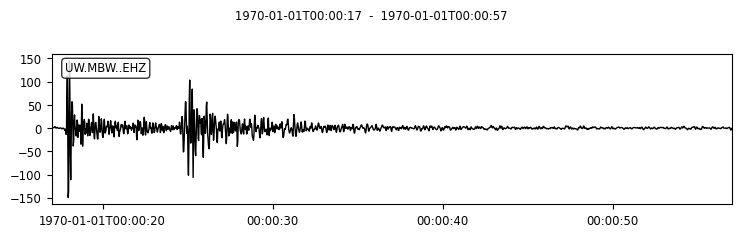

---
mbwehzrpba123 template original stream:


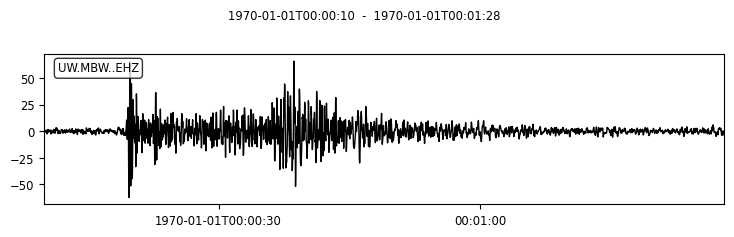

number of windows: 38
maximum amp window index: 9
Max Window:


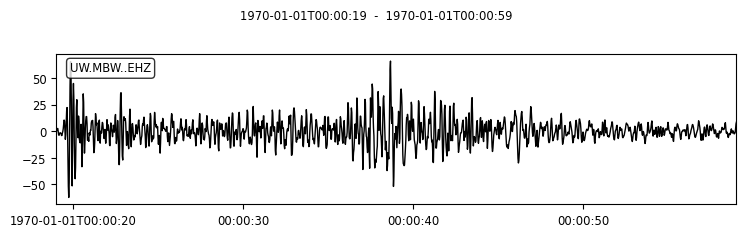

---
mbwehzrpba124 template original stream:


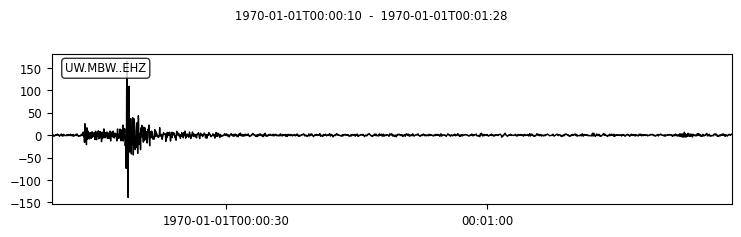

number of windows: 38
maximum amp window index: 3
Max Window:


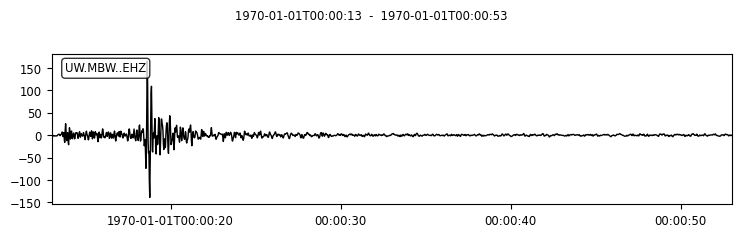

---
mbwehzrpba125 template original stream:


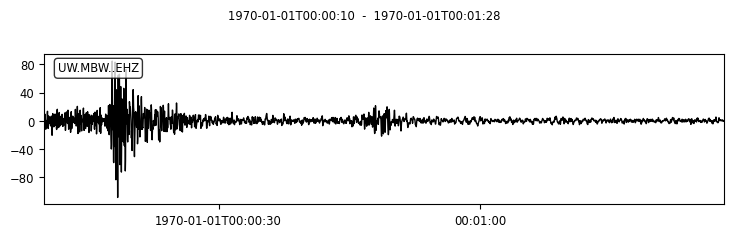

number of windows: 38
maximum amp window index: 0
Max Window:


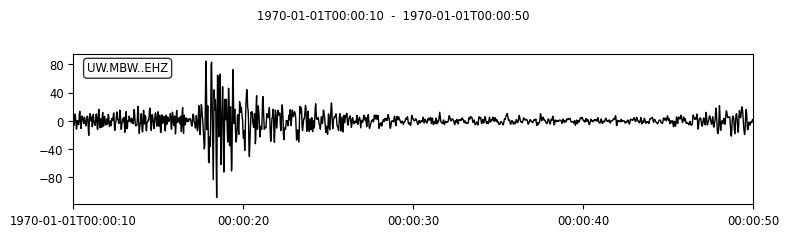

---
mbwehzrpba126 template original stream:


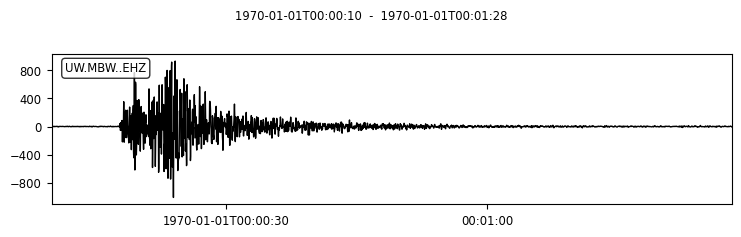

number of windows: 38
maximum amp window index: 8
Max Window:


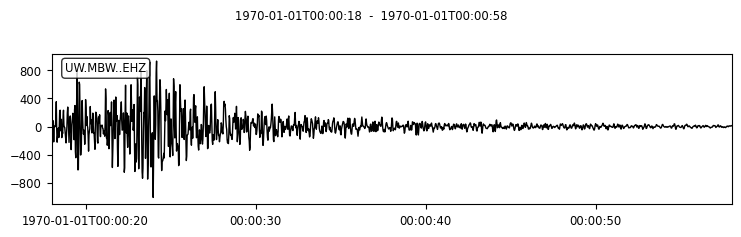

---
mbwehzrpba127 template original stream:


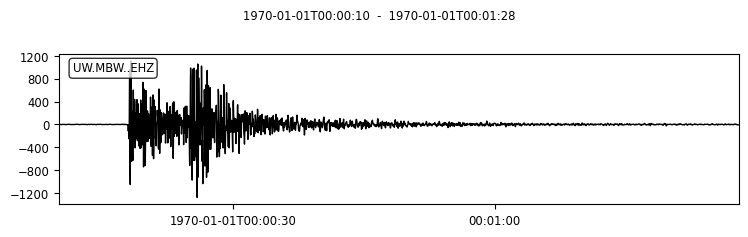

number of windows: 38
maximum amp window index: 8
Max Window:


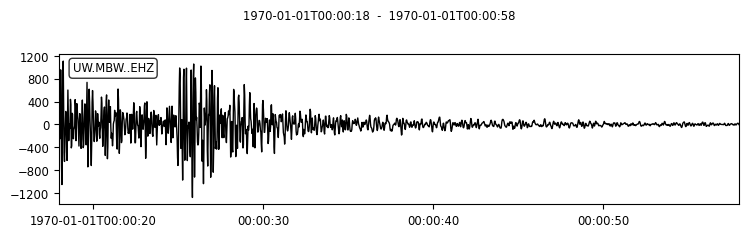

---
mbwehzrpba128 template original stream:


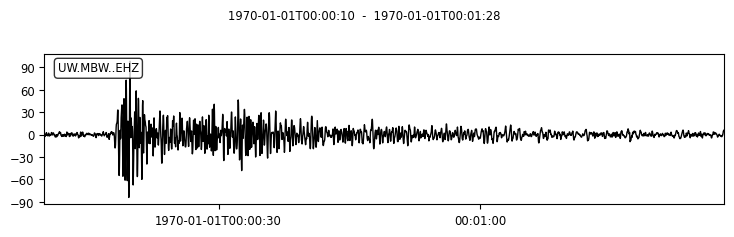

number of windows: 38
maximum amp window index: 8
Max Window:


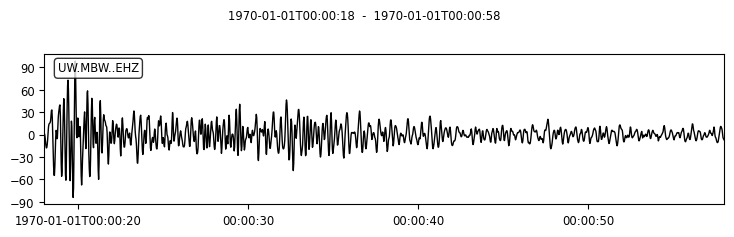

---
mbwehzrpba129 template original stream:


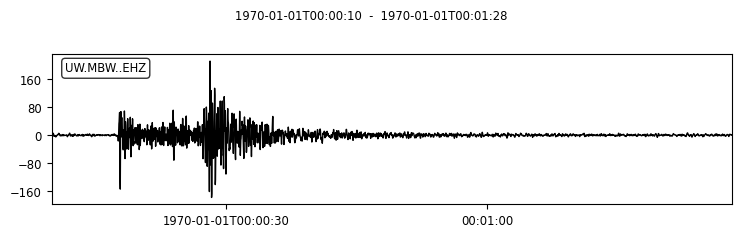

number of windows: 38
maximum amp window index: 7
Max Window:


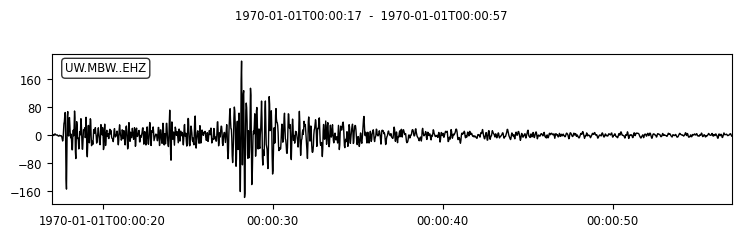

---
mbwehzrpba130 template original stream:


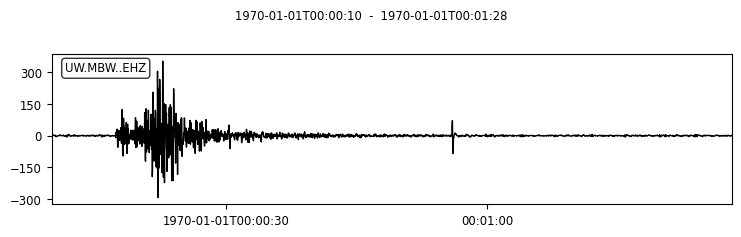

number of windows: 38
maximum amp window index: 7
Max Window:


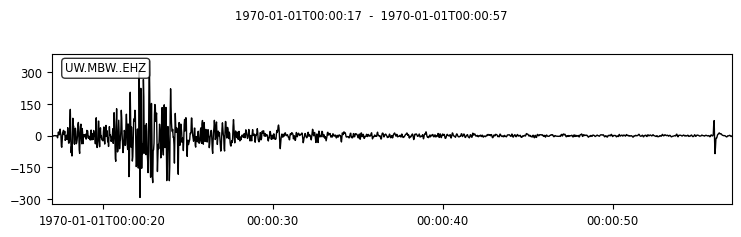

---
mbwehzrpba131 template original stream:


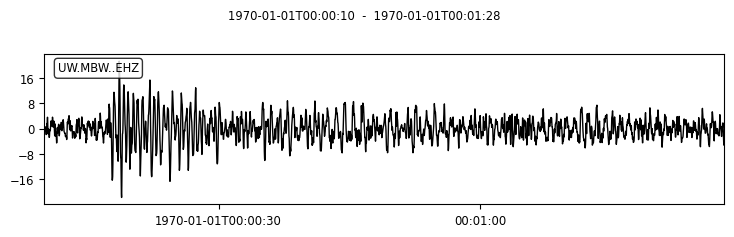

number of windows: 38
maximum amp window index: 7
Max Window:


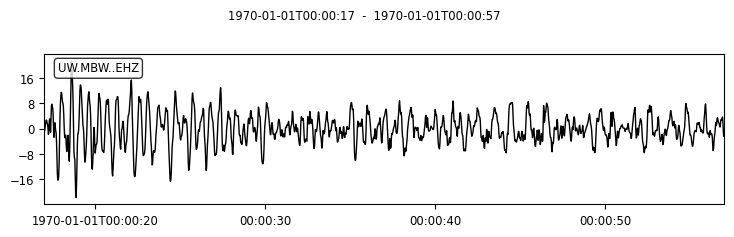

---
mbwehzrpba132 template original stream:


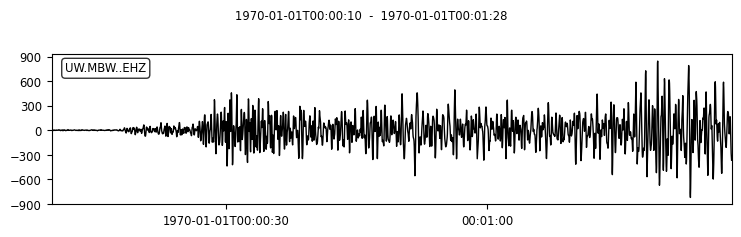

number of windows: 38
maximum amp window index: 38
Max Window:


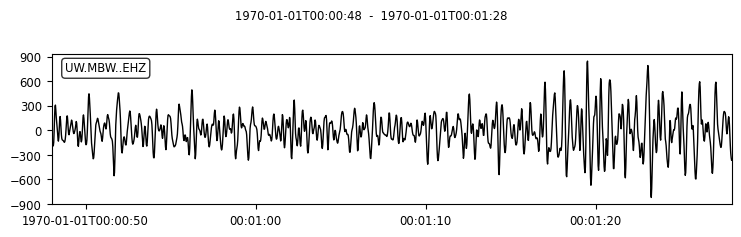

---
mbwehzrpba133 template original stream:


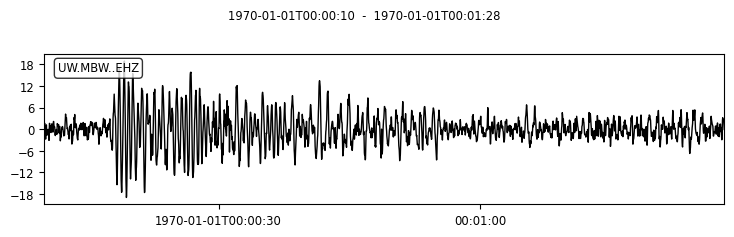

number of windows: 38
maximum amp window index: 6
Max Window:


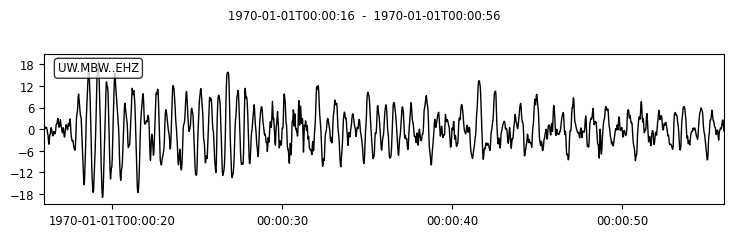

---
mbwehzrpba134 template original stream:


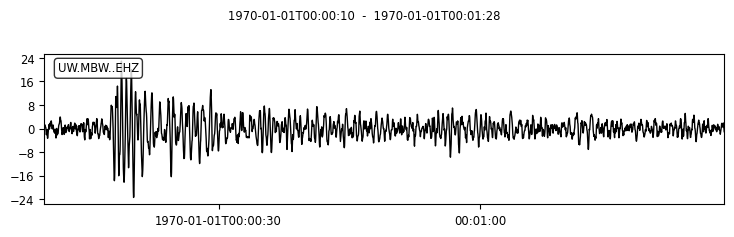

number of windows: 38
maximum amp window index: 7
Max Window:


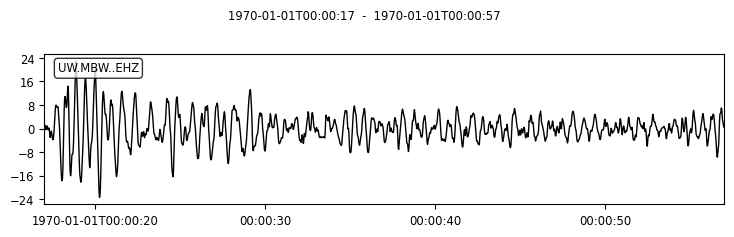

---
mbwehzrpba135 template original stream:


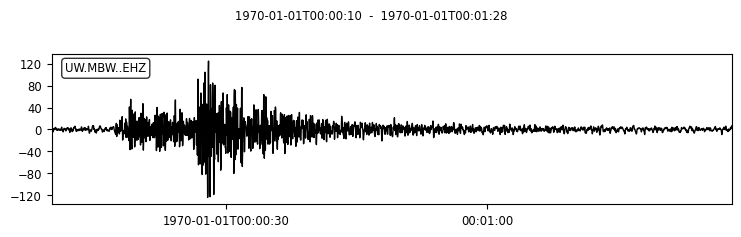

number of windows: 38
maximum amp window index: 7
Max Window:


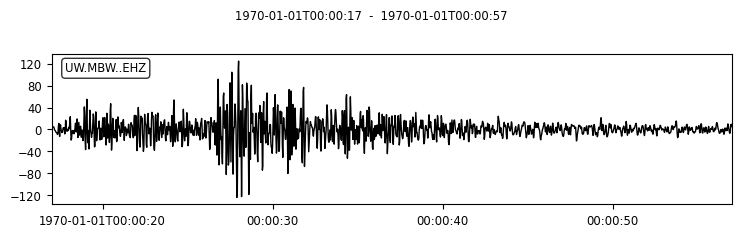

---
mbwehzrpba136 template original stream:


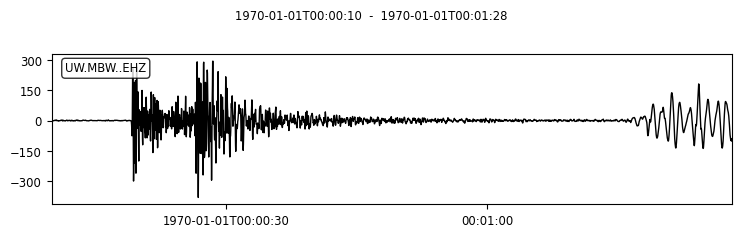

number of windows: 38
maximum amp window index: 9
Max Window:


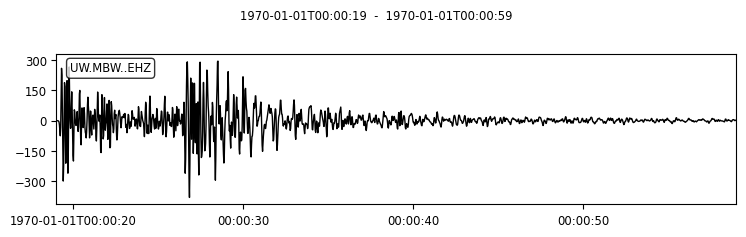

---
mbwehzrpba137 template original stream:


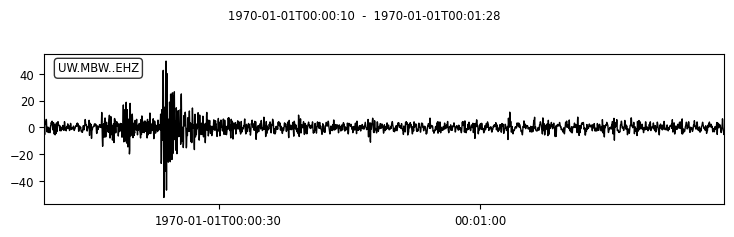

number of windows: 38
maximum amp window index: 6
Max Window:


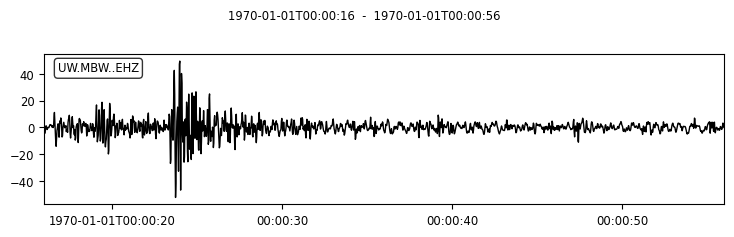

---
mbwehzrpba138 template original stream:


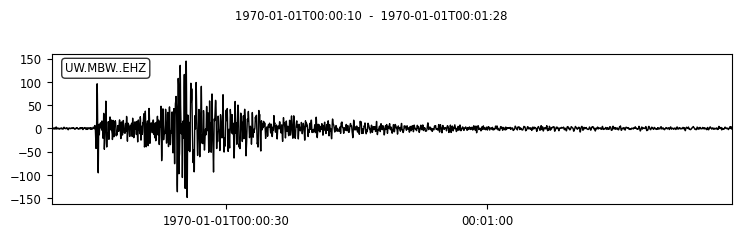

number of windows: 38
maximum amp window index: 5
Max Window:


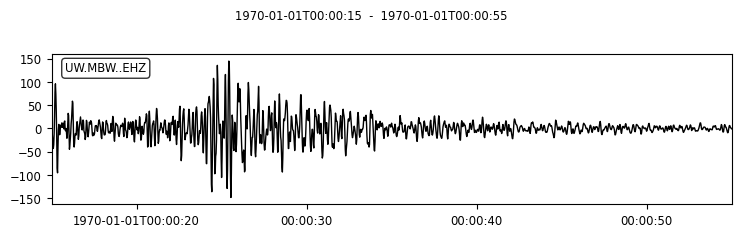

---
mbwehzrpba139 template original stream:


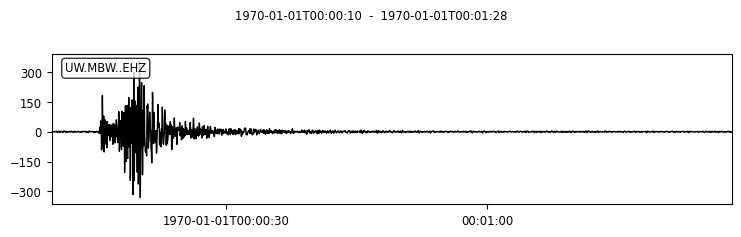

number of windows: 38
maximum amp window index: 4
Max Window:


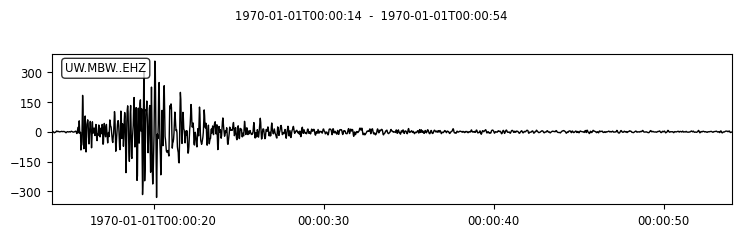

---
mbwehzrpba140 template original stream:


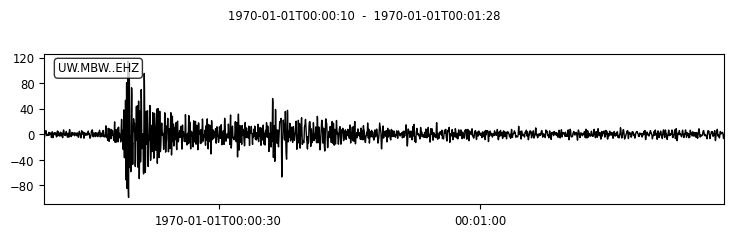

number of windows: 38
maximum amp window index: 7
Max Window:


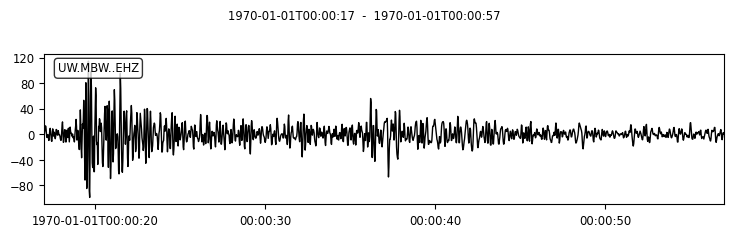

---
mbwehzrpba141 template original stream:


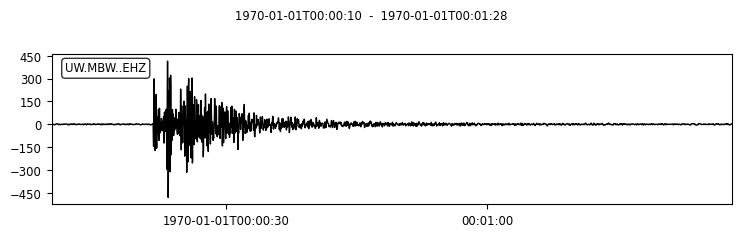

number of windows: 38
maximum amp window index: 11
Max Window:


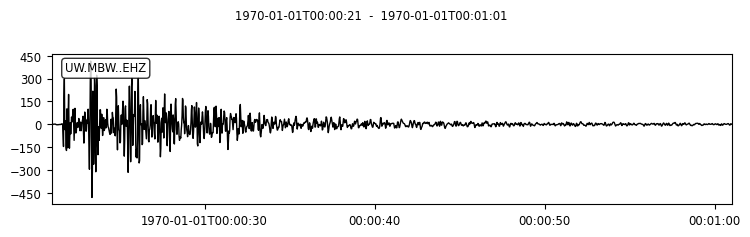

---
mbwehzrpba142 template original stream:


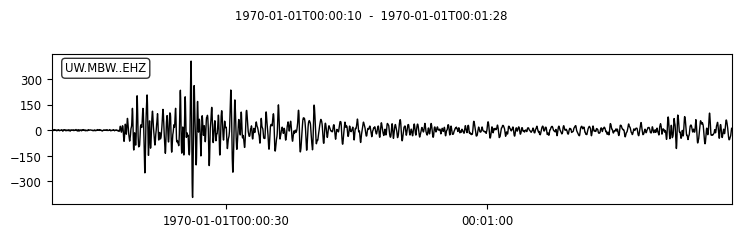

number of windows: 38
maximum amp window index: 8
Max Window:


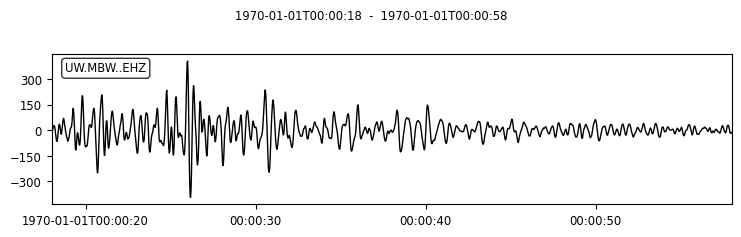

---
mbwehzrpba143 template original stream:


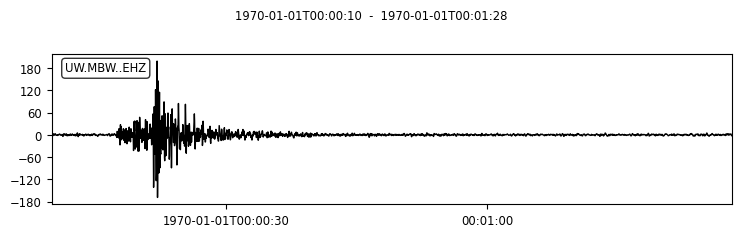

number of windows: 38
maximum amp window index: 7
Max Window:


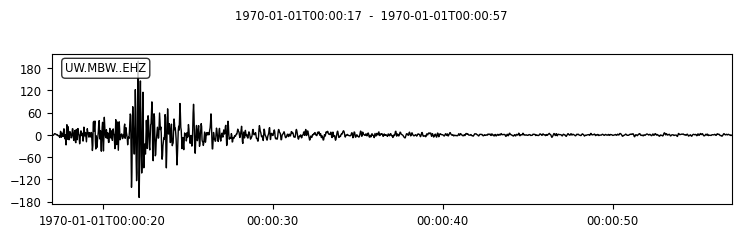

---
mbwehzrpba144 template original stream:


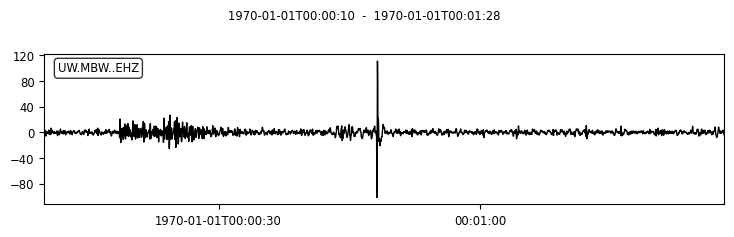

number of windows: 38
maximum amp window index: 6
Max Window:


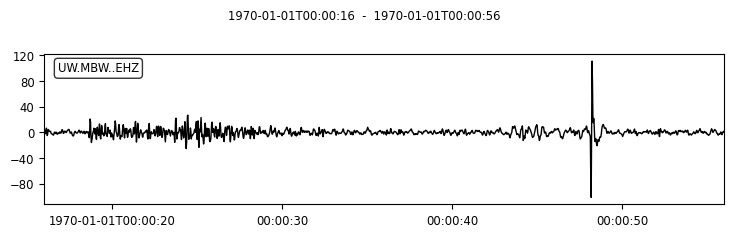

---
mbwehzrpba145 template original stream:


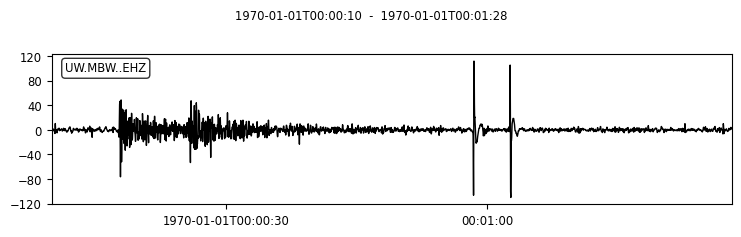

number of windows: 38
maximum amp window index: 2
Max Window:


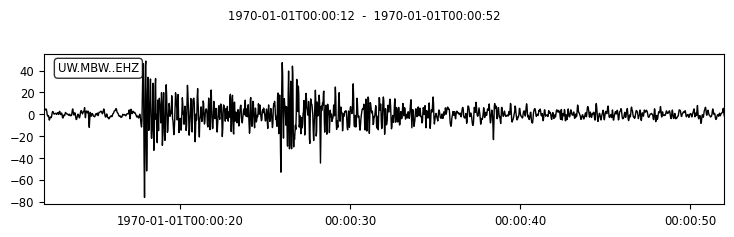

---
mbwehzrpba146 template original stream:


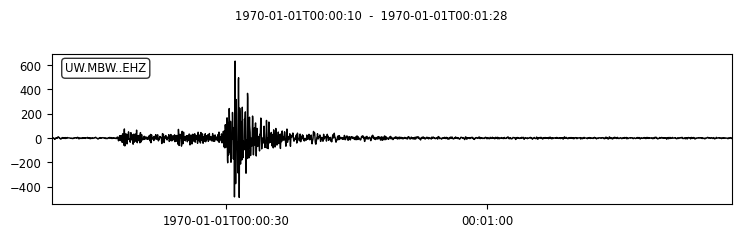

number of windows: 38
maximum amp window index: 7
Max Window:


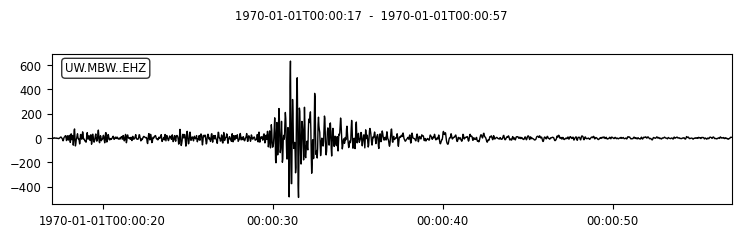

---
mbwehzrpba147 template original stream:


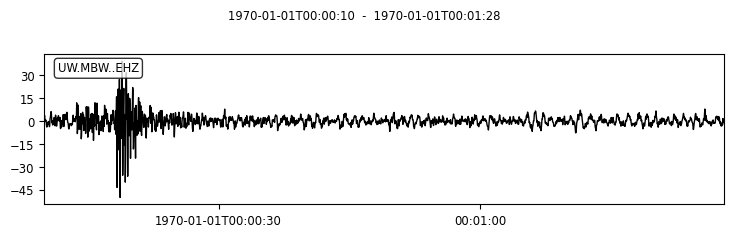

number of windows: 38
maximum amp window index: 0
Max Window:


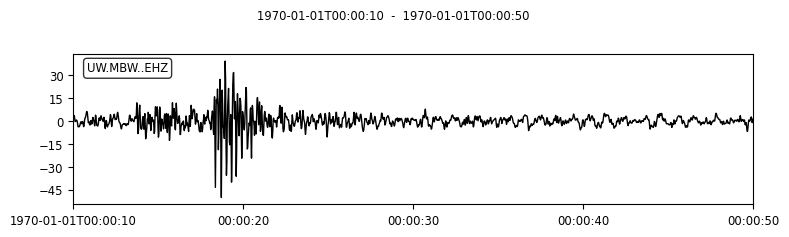

---
mbwehzrpba148 template original stream:


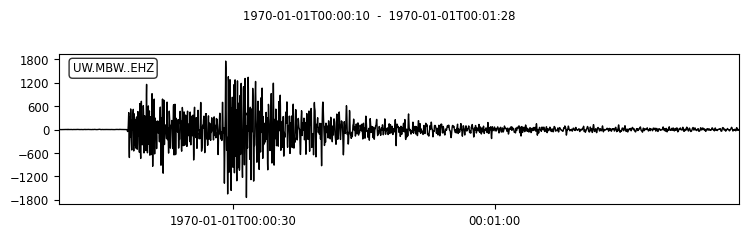

number of windows: 38
maximum amp window index: 8
Max Window:


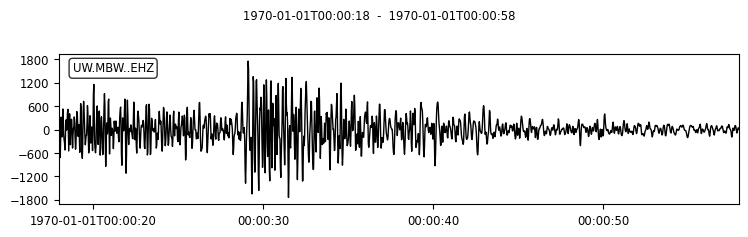

---
mbwehzrpba149 template original stream:


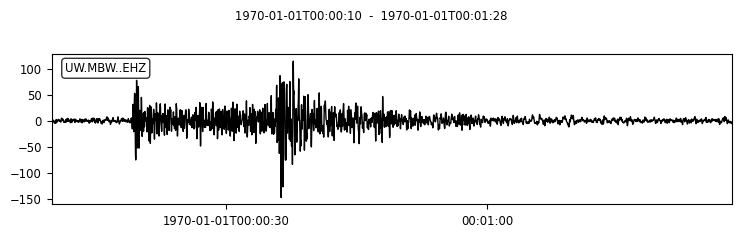

number of windows: 38
maximum amp window index: 9
Max Window:


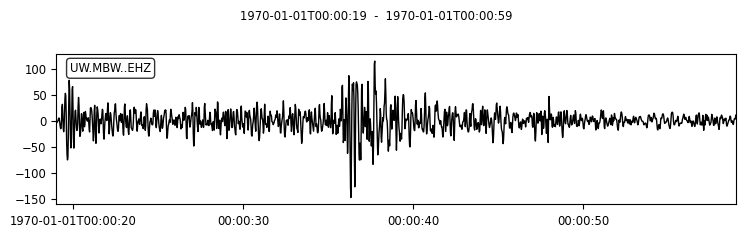

---
mbwehzrpba150 template original stream:


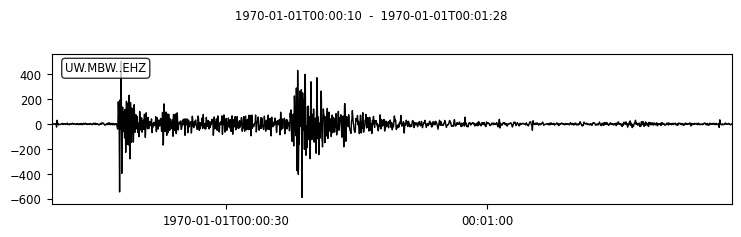

number of windows: 38
maximum amp window index: 7
Max Window:


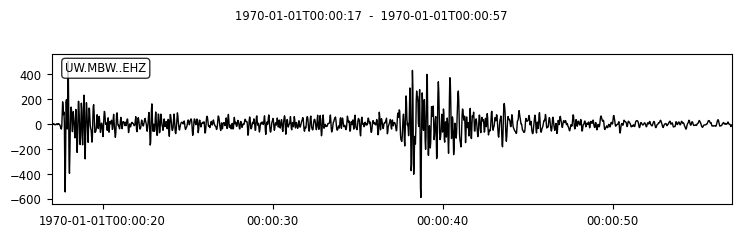

---
mbwehzrpba151 template original stream:


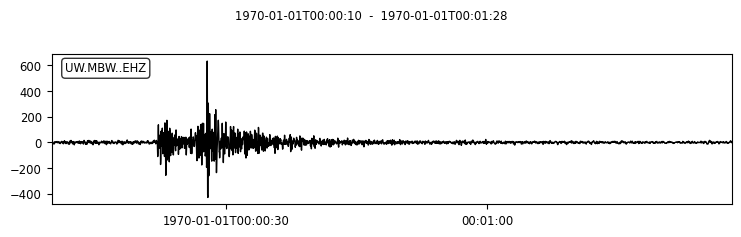

number of windows: 38
maximum amp window index: 9
Max Window:


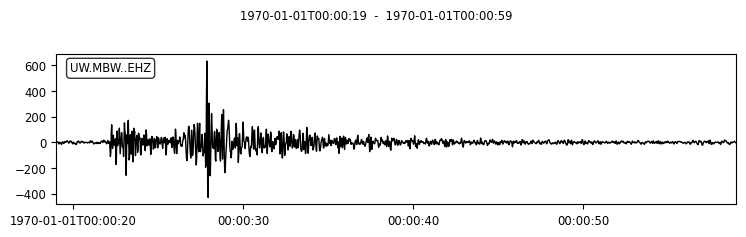

---
mbwehzrpba152 template original stream:


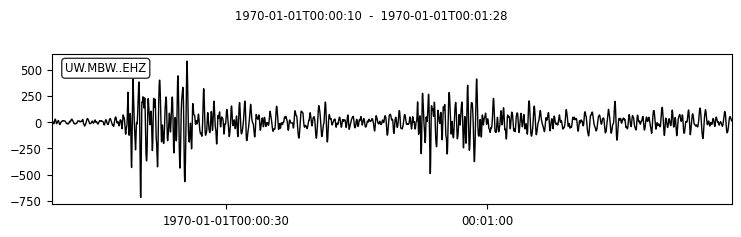

number of windows: 38
maximum amp window index: 9
Max Window:


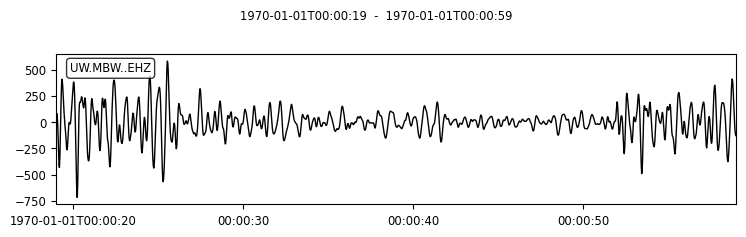

---
mbwehzrpba153 template original stream:


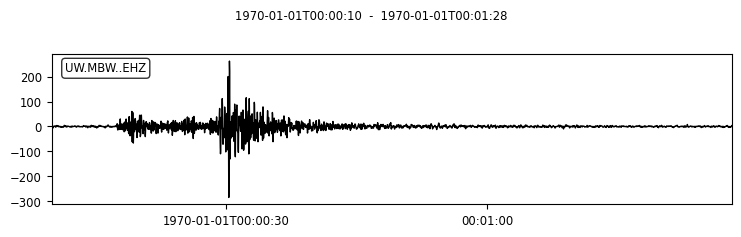

number of windows: 38
maximum amp window index: 7
Max Window:


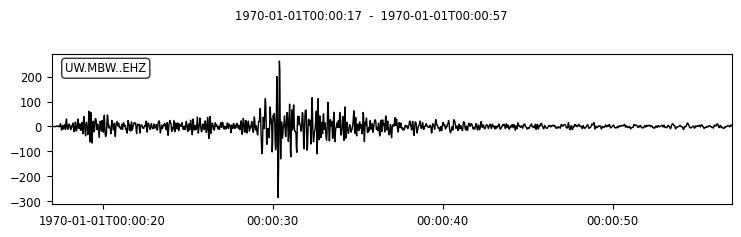

---
mbwehzrpba154 template original stream:


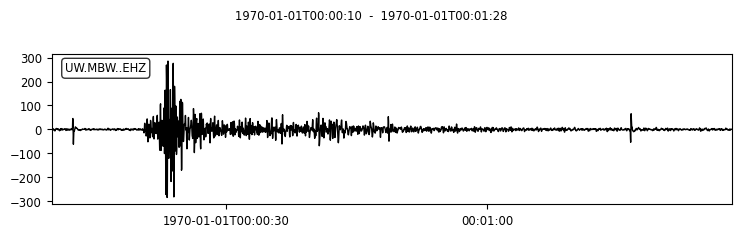

number of windows: 38
maximum amp window index: 10
Max Window:


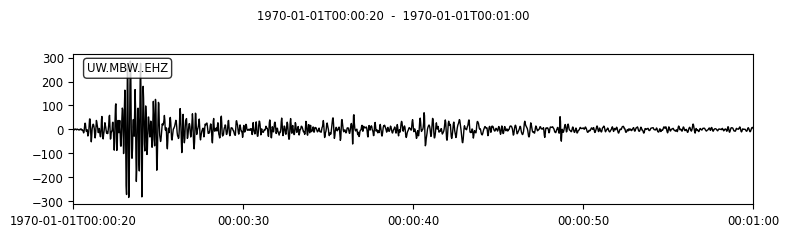

---
mbwehzrpba155 template original stream:


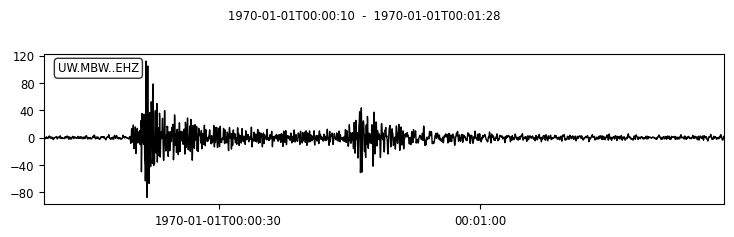

number of windows: 38
maximum amp window index: 10
Max Window:


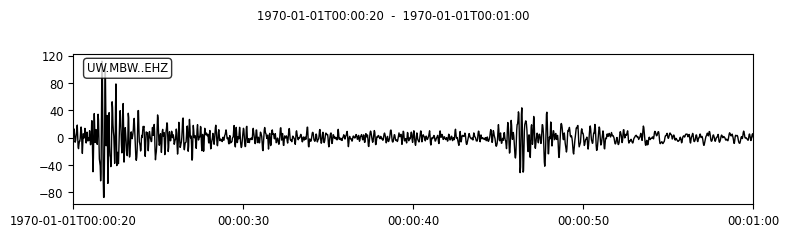

---
mbwehzrpba156 template original stream:


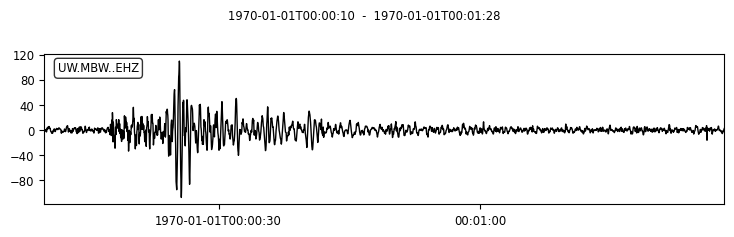

number of windows: 38
maximum amp window index: 7
Max Window:


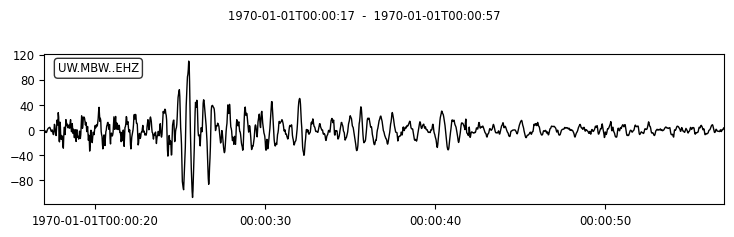

---
mbwehzrpba157 template original stream:


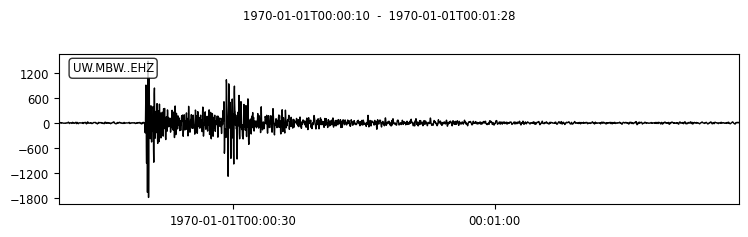

number of windows: 38
maximum amp window index: 9
Max Window:


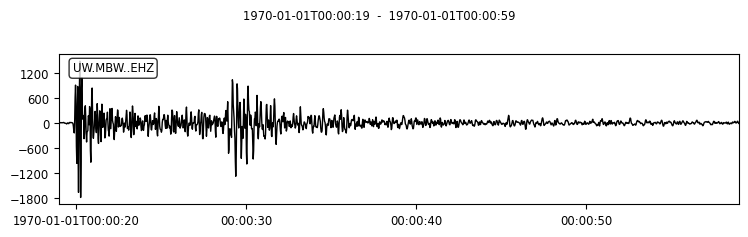

---
mbwehzrpba158 template original stream:


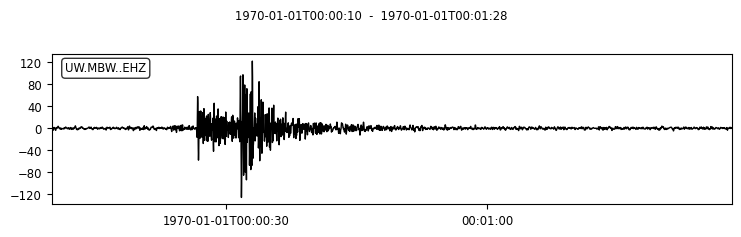

number of windows: 38
maximum amp window index: 9
Max Window:


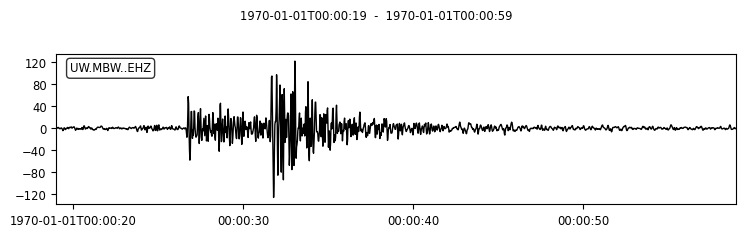

---
mbwehzrpba159 template original stream:


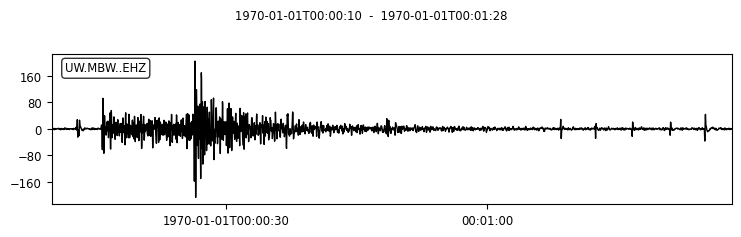

number of windows: 38
maximum amp window index: 3
Max Window:


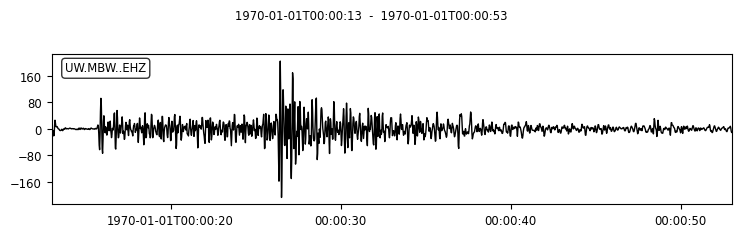

---
mbwehzrpba160 template original stream:


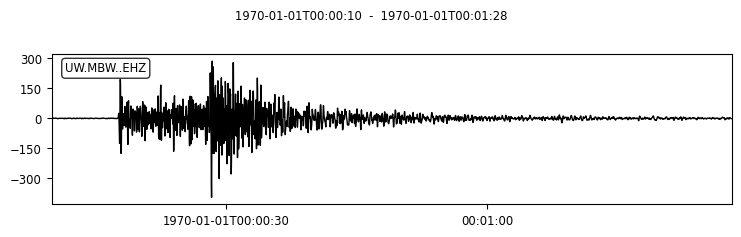

number of windows: 38
maximum amp window index: 7
Max Window:


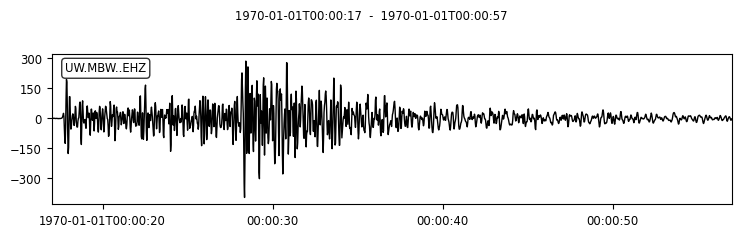

---
mbwehzrpba161 template original stream:


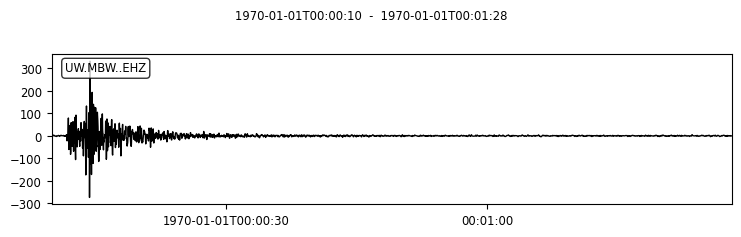

number of windows: 38
maximum amp window index: 1
Max Window:


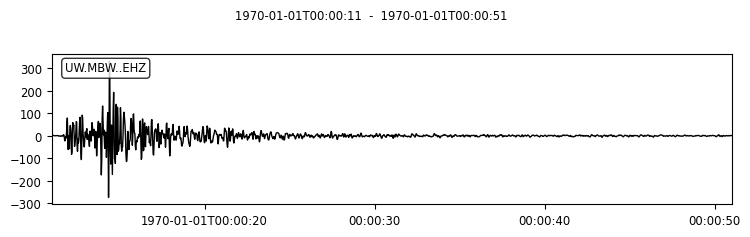

---
mbwehzrpba162 template original stream:


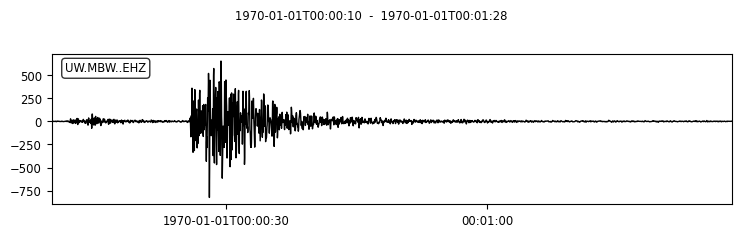

number of windows: 38
maximum amp window index: 2
Max Window:


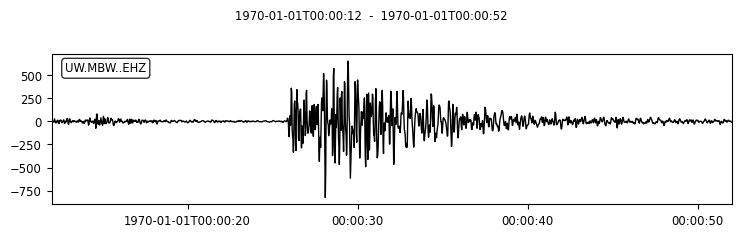

---
mbwehzrpba163 template original stream:


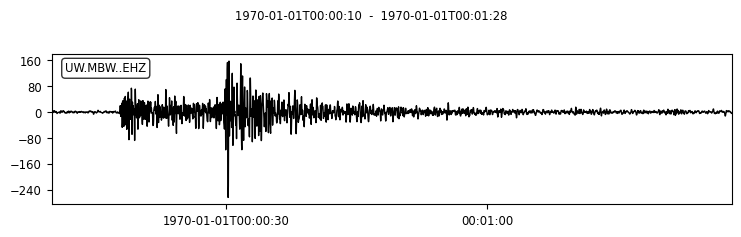

number of windows: 38
maximum amp window index: 8
Max Window:


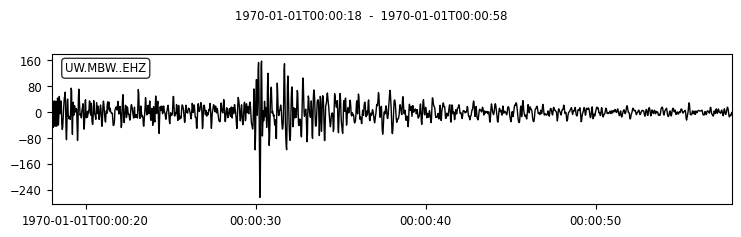

---
mbwehzrpba164 template original stream:


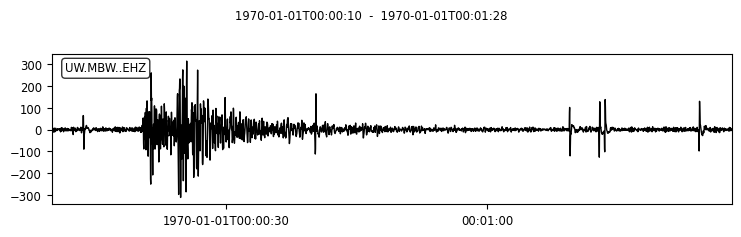

number of windows: 38
maximum amp window index: 3
Max Window:


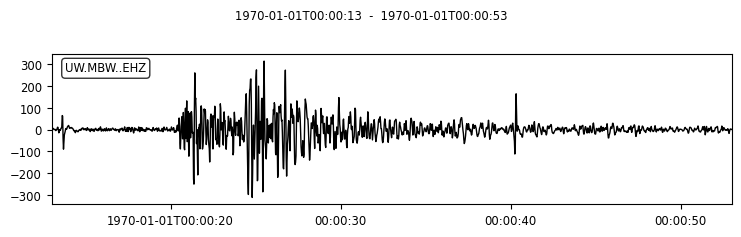

---
mbwehzrpba165 template original stream:


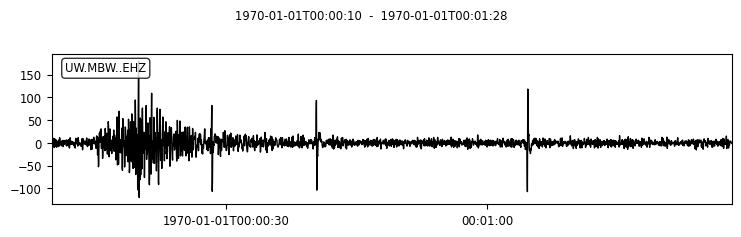

number of windows: 38
maximum amp window index: 0
Max Window:


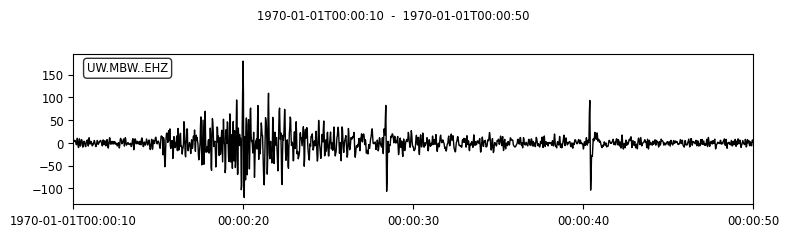

---
mbwehzrpba166 template original stream:


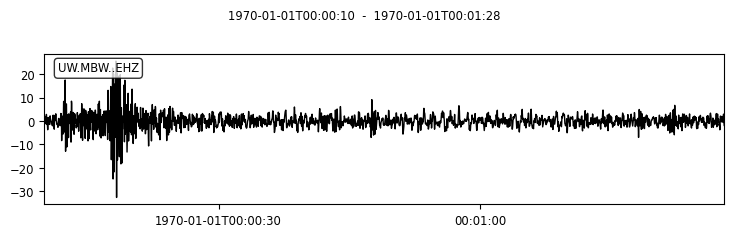

number of windows: 38
maximum amp window index: 2
Max Window:


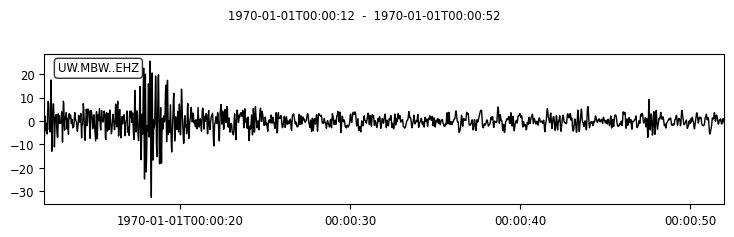

---
mbwehzrpba167 template original stream:


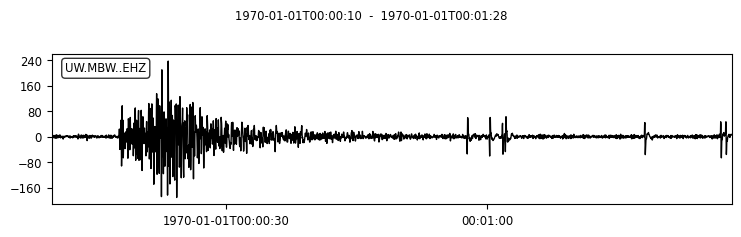

number of windows: 38
maximum amp window index: 8
Max Window:


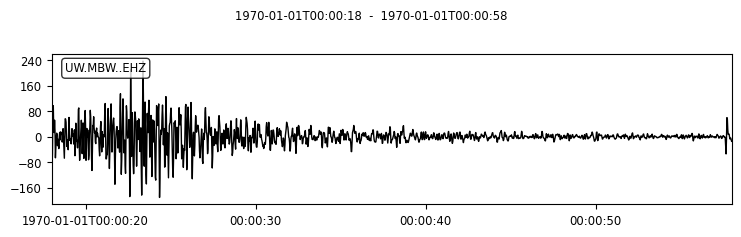

---
mbwehzrpba168 template original stream:


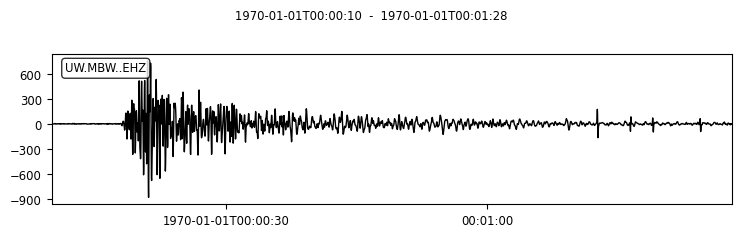

number of windows: 38
maximum amp window index: 8
Max Window:


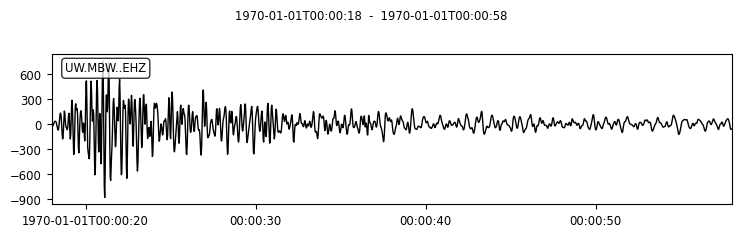

---
mbwehzrpba169 template original stream:


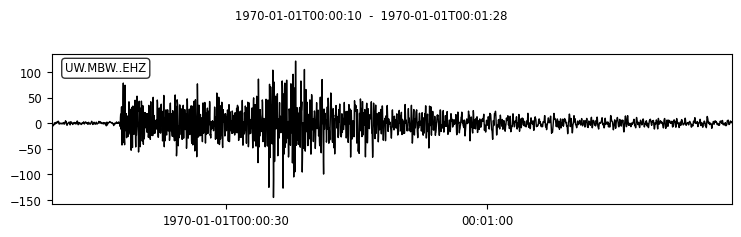

number of windows: 38
maximum amp window index: 8
Max Window:


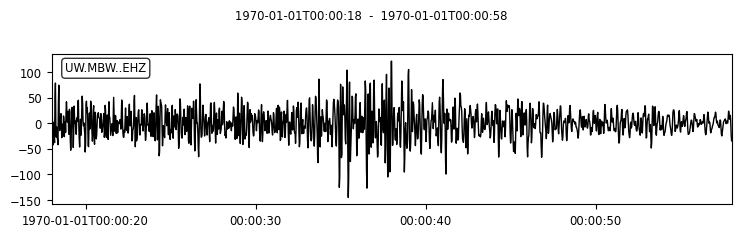

---
mbwehzrpba170 template original stream:


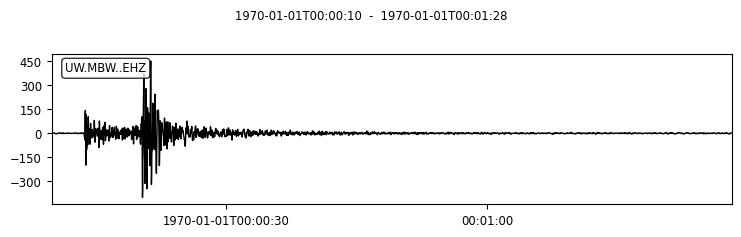

number of windows: 38
maximum amp window index: 3
Max Window:


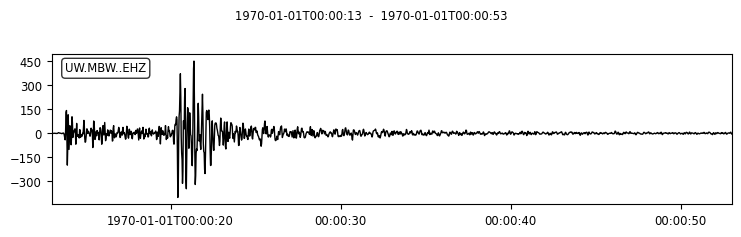

---
mbwehzrpba171 template original stream:


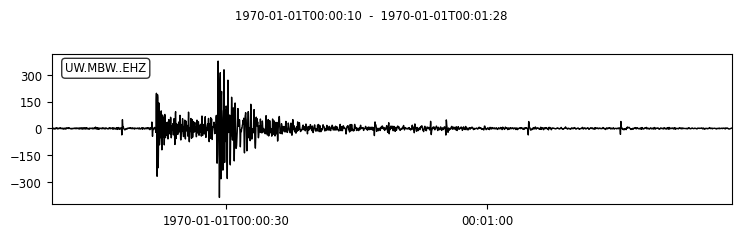

number of windows: 38
maximum amp window index: 8
Max Window:


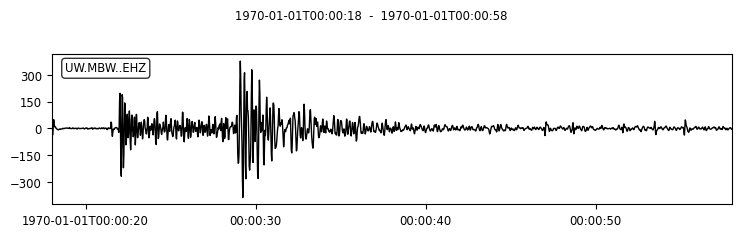

---
mbwehzrpba173 template original stream:


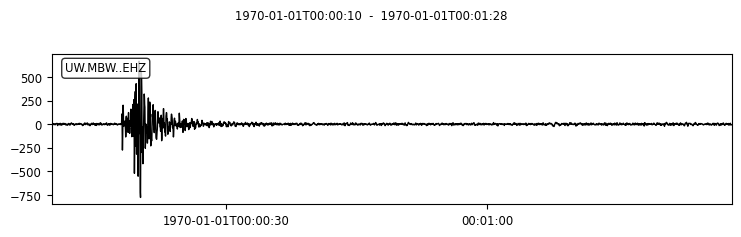

number of windows: 38
maximum amp window index: 1
Max Window:


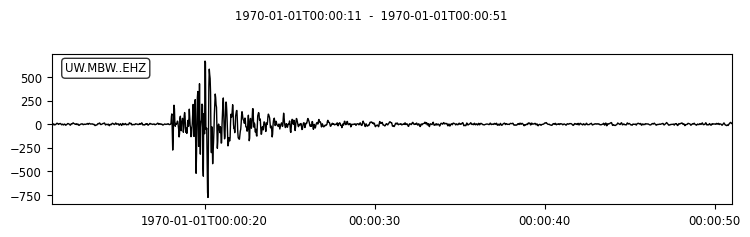

---
mbwehzrpba174 template original stream:


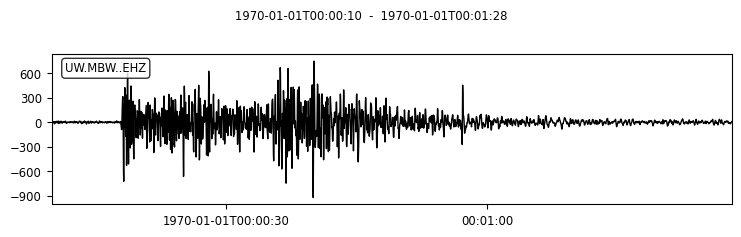

number of windows: 38
maximum amp window index: 8
Max Window:


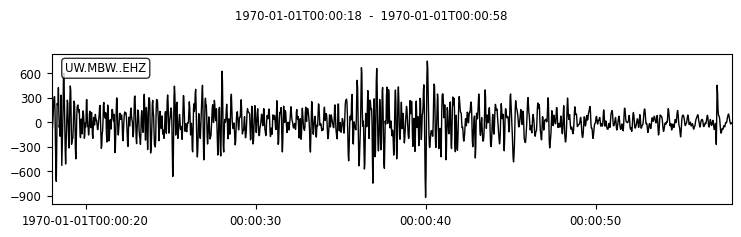

---
mbwehzrpba175 template original stream:


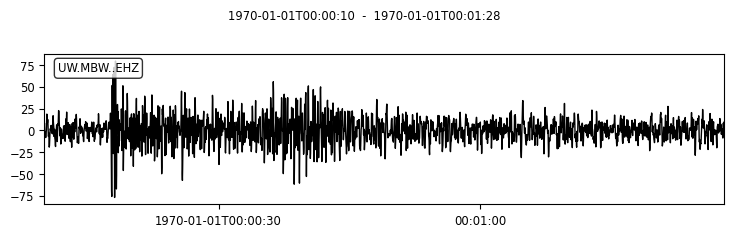

number of windows: 38
maximum amp window index: 7
Max Window:


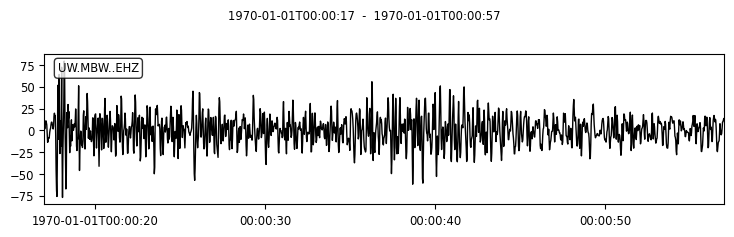

---
mbwehzrpba176 template original stream:


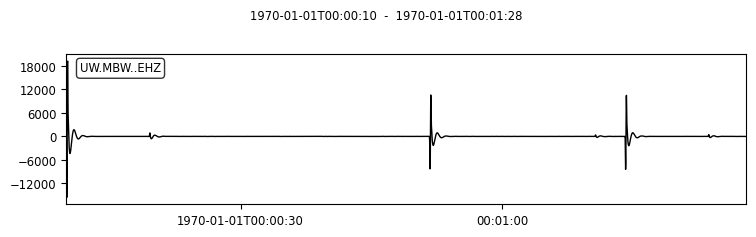

number of windows: 38
maximum amp window index: 37
Max Window:


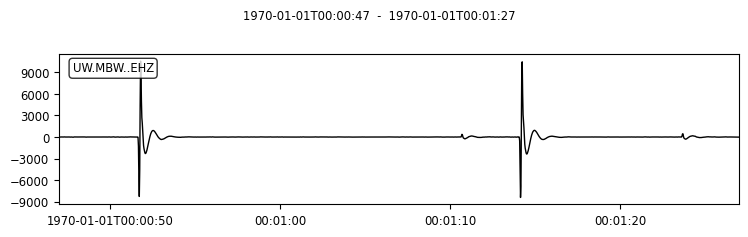

---
mbwehzrpba177 template original stream:


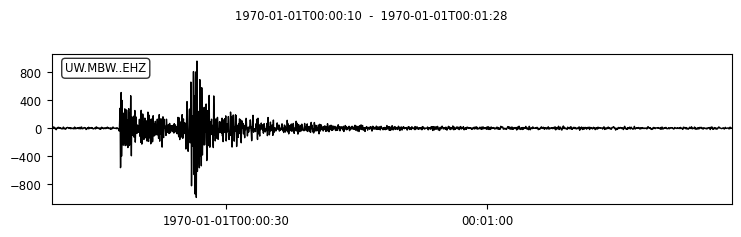

number of windows: 38
maximum amp window index: 7
Max Window:


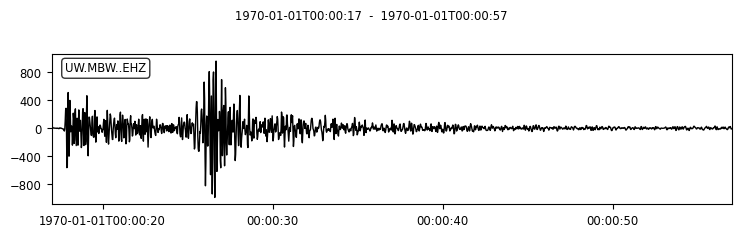

---
mbwehzrpba178 template original stream:


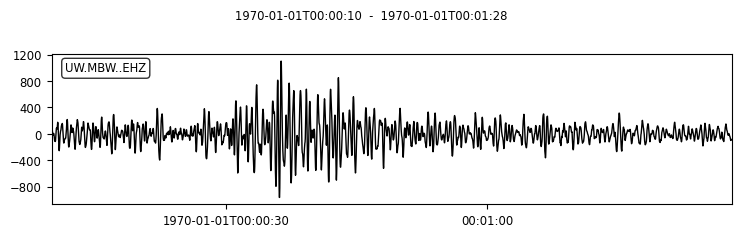

number of windows: 38
maximum amp window index: 17
Max Window:


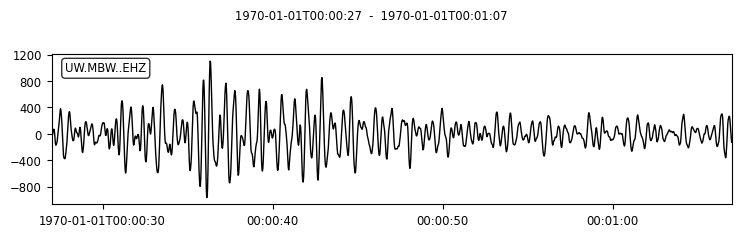

---
mbwehzrpba179 template original stream:


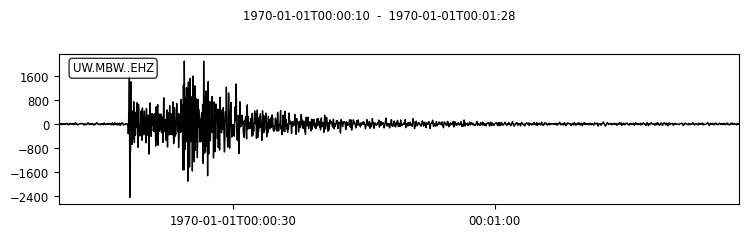

number of windows: 38
maximum amp window index: 7
Max Window:


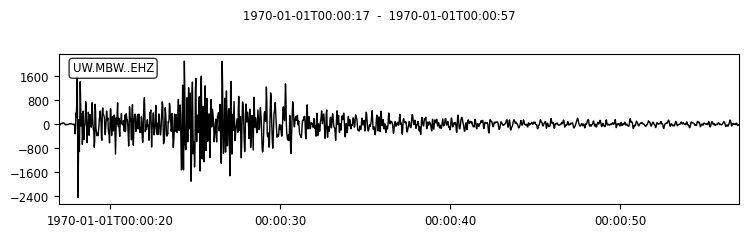

---
mbwehzrpba180 template original stream:


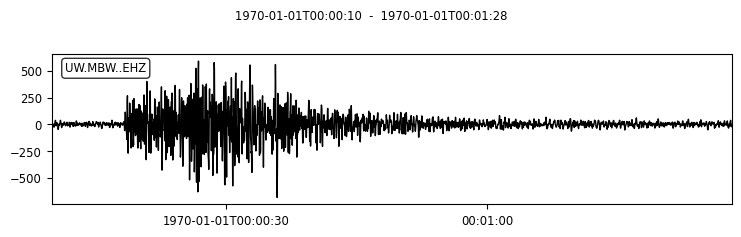

number of windows: 38
maximum amp window index: 8
Max Window:


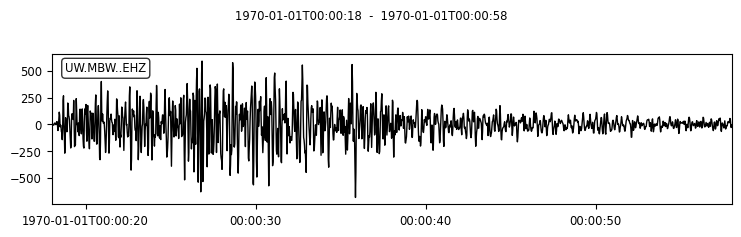

---
mbwehzrpba181 template original stream:


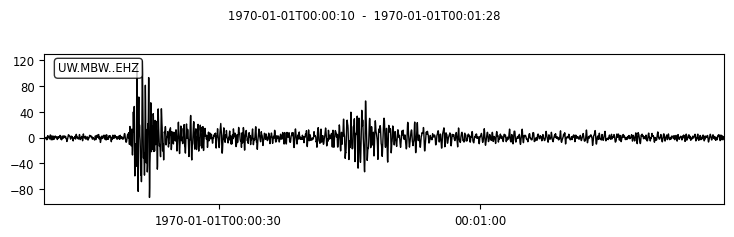

number of windows: 38
maximum amp window index: 9
Max Window:


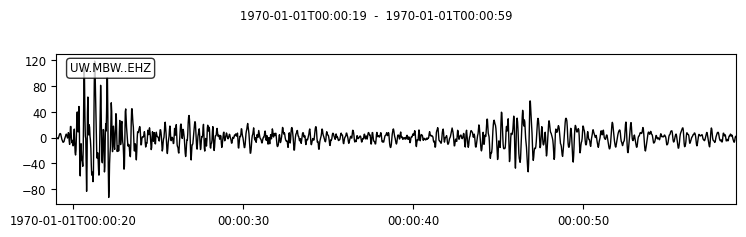

---
mbwehzrpba182 template original stream:


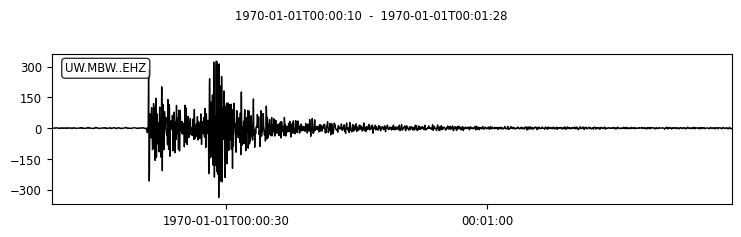

number of windows: 38
maximum amp window index: 11
Max Window:


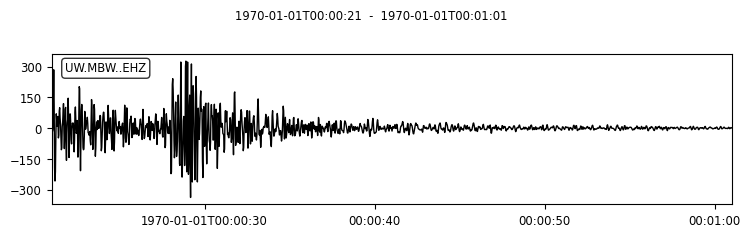

---
mbwehzrpba183 template original stream:


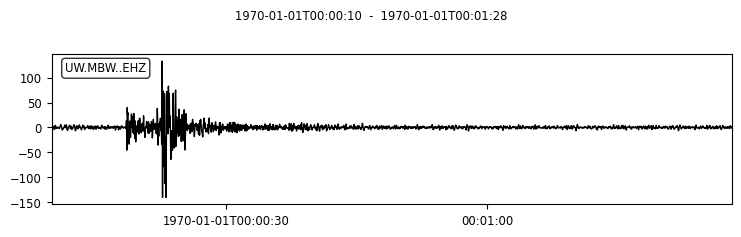

number of windows: 38
maximum amp window index: 1
Max Window:


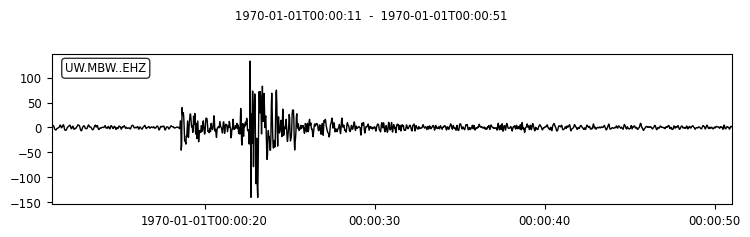

---
mbwehzrpba184 template original stream:


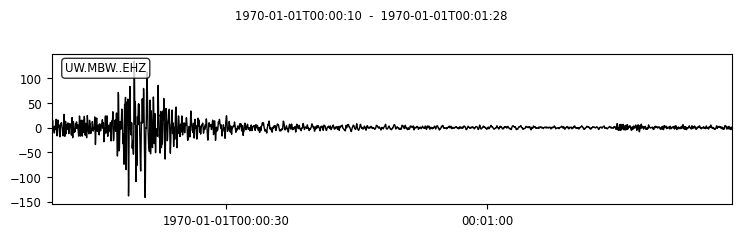

number of windows: 38
maximum amp window index: 0
Max Window:


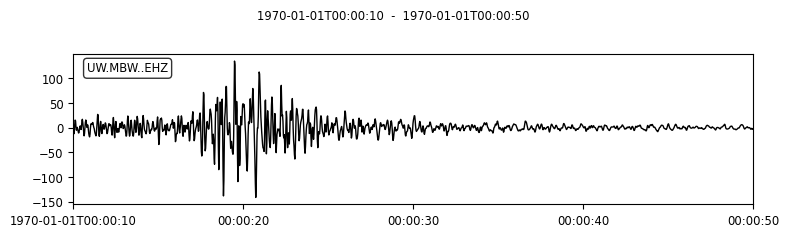

---
mbwehzrpba185 template original stream:


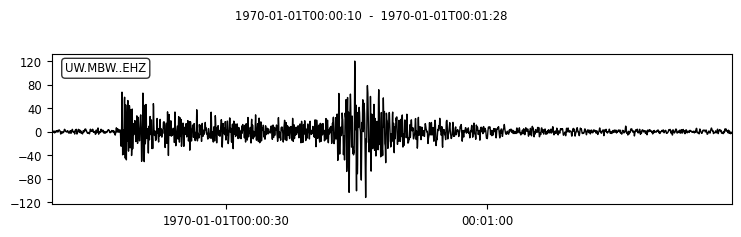

number of windows: 38
maximum amp window index: 8
Max Window:


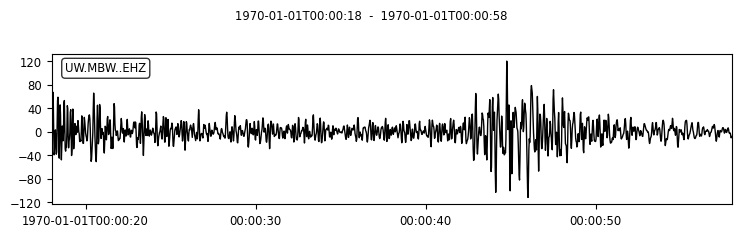

---
mbwehzrpba186 template original stream:


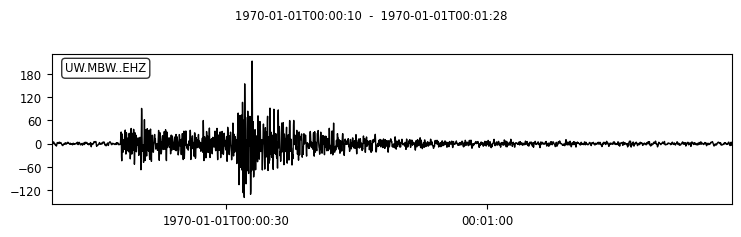

number of windows: 38
maximum amp window index: 8
Max Window:


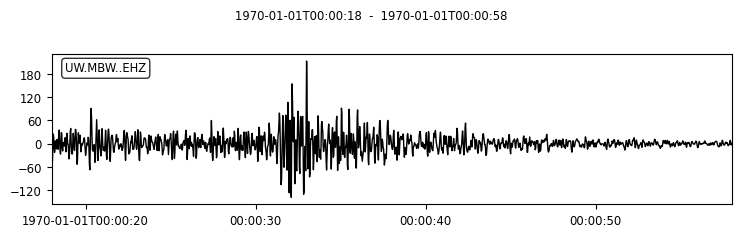

---
mbwehzrpba187 template original stream:


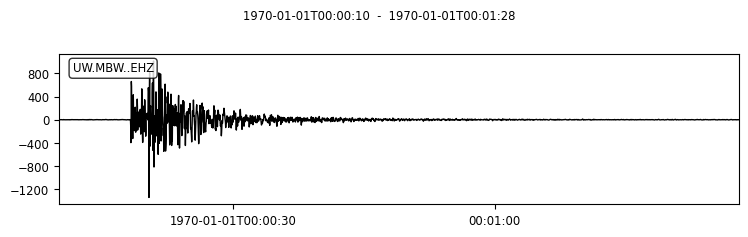

number of windows: 38
maximum amp window index: 8
Max Window:


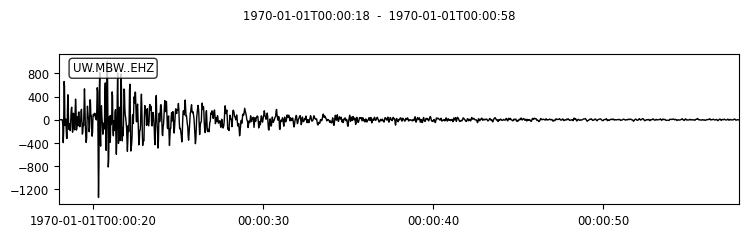

---
mbwehzrpba189 template original stream:


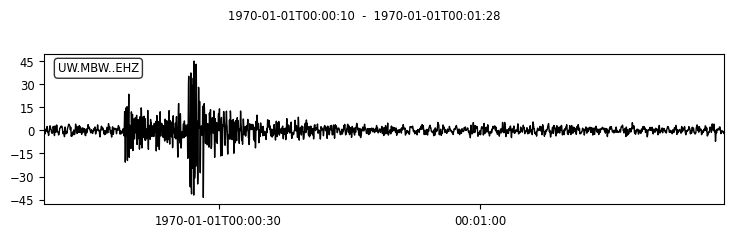

number of windows: 38
maximum amp window index: 0
Max Window:


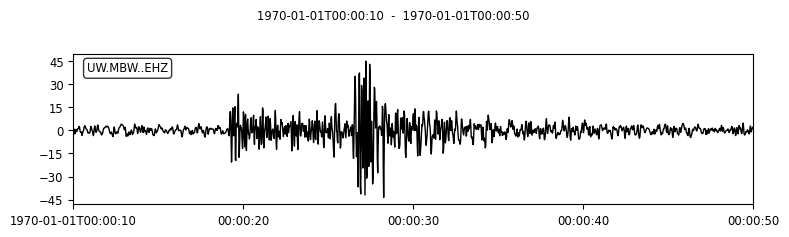

---
mbwehzrpba190 template original stream:


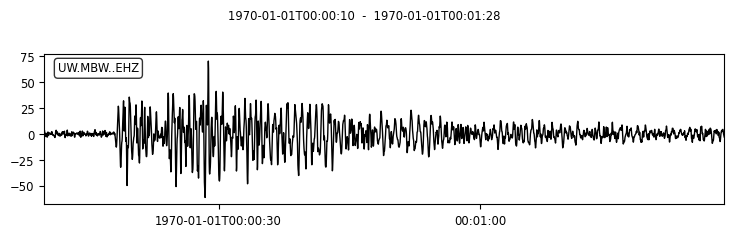

number of windows: 38
maximum amp window index: 8
Max Window:


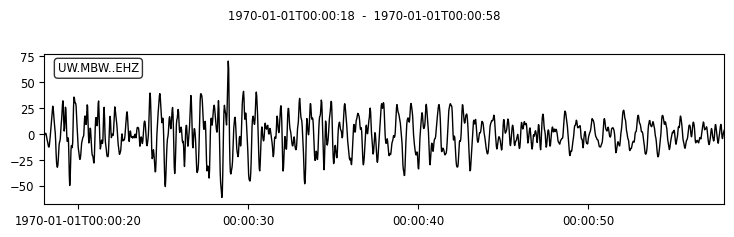

---
mbwehzrpba191 template original stream:


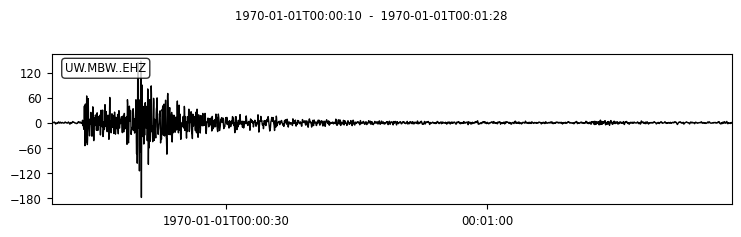

number of windows: 38
maximum amp window index: 3
Max Window:


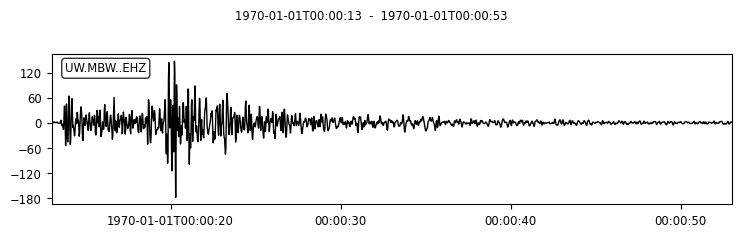

---
mbwehzrpba192 template original stream:


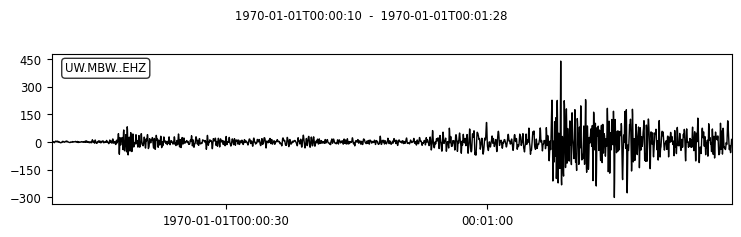

number of windows: 38
maximum amp window index: 38
Max Window:


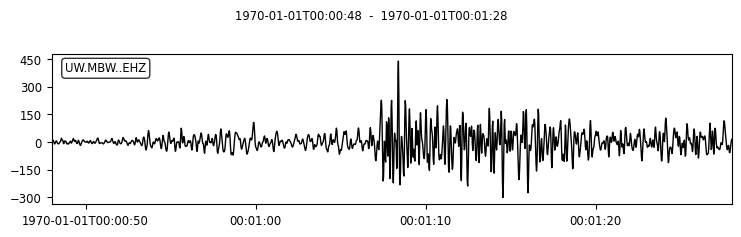

---
mbwehzrpba193 template original stream:


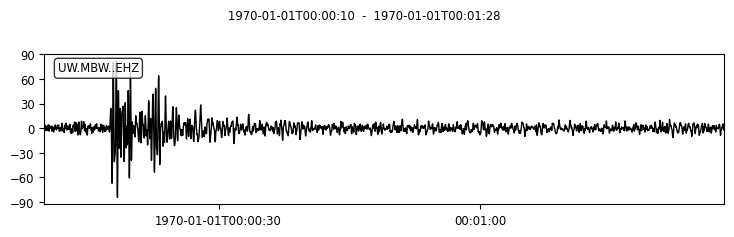

number of windows: 38
maximum amp window index: 3
Max Window:


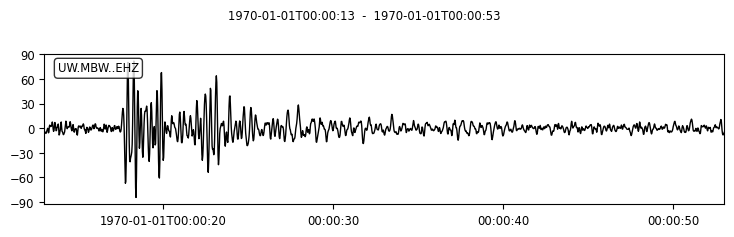

---
mbwehzrpba194 template original stream:


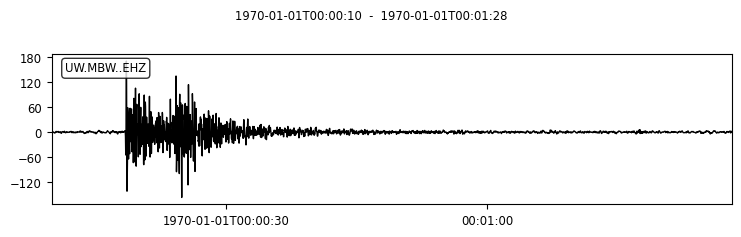

number of windows: 38
maximum amp window index: 8
Max Window:


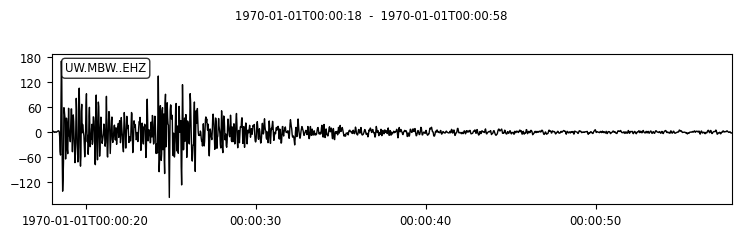

---
mbwehzrpba195 template original stream:


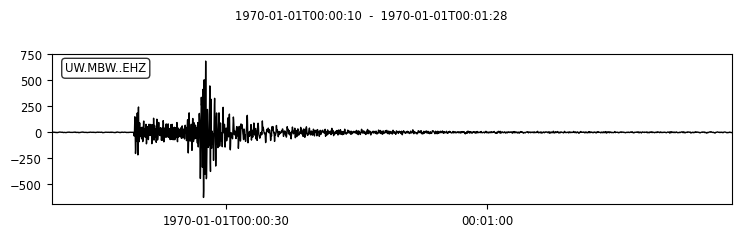

number of windows: 38
maximum amp window index: 9
Max Window:


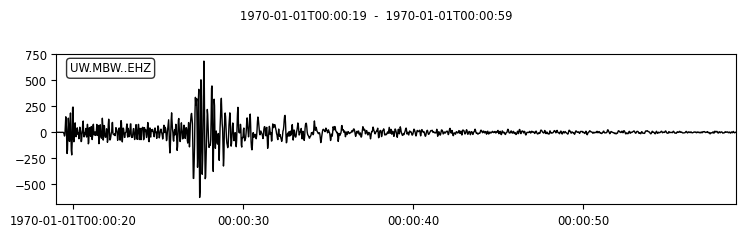

---
mbwehzrpba196 template original stream:


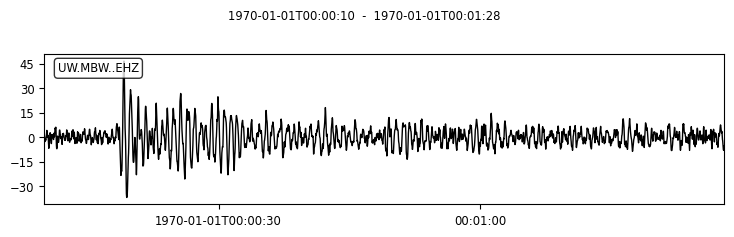

number of windows: 38
maximum amp window index: 8
Max Window:


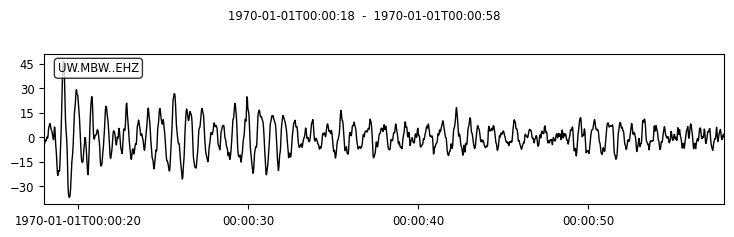

---
mbwehzrpba197 template original stream:


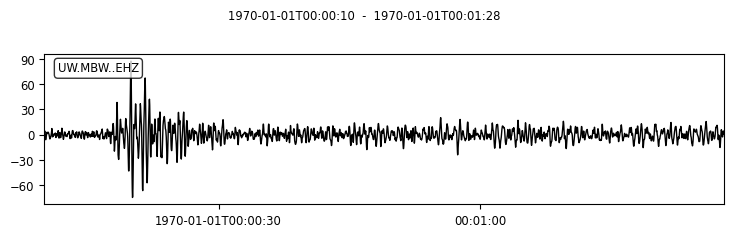

number of windows: 38
maximum amp window index: 8
Max Window:


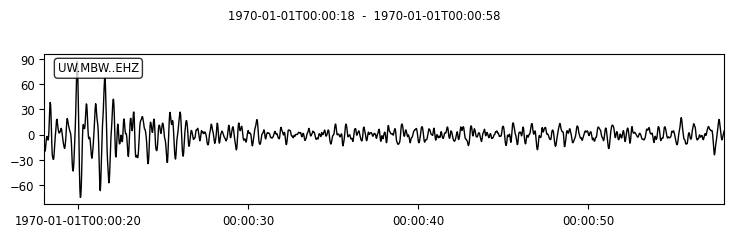

---
mbwehzrpba198 template original stream:


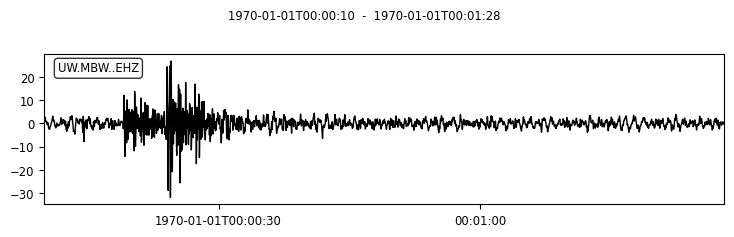

number of windows: 38
maximum amp window index: 0
Max Window:


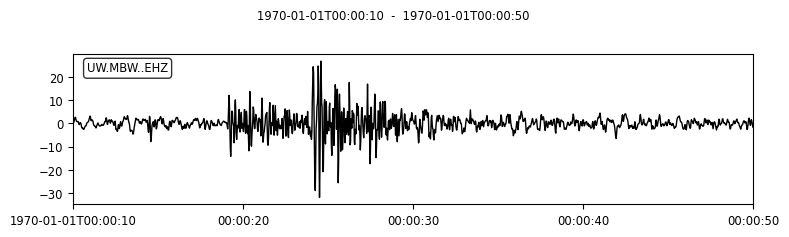

---
mbwehzrpba199 template original stream:


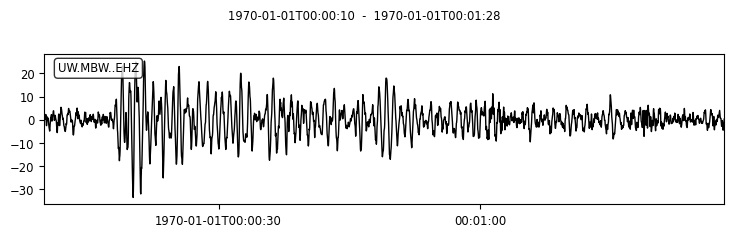

number of windows: 38
maximum amp window index: 8
Max Window:


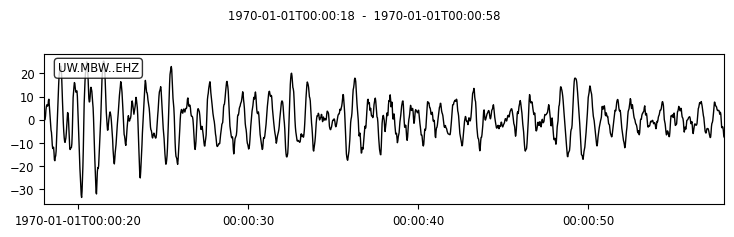

---
mbwehzrpba200 template original stream:


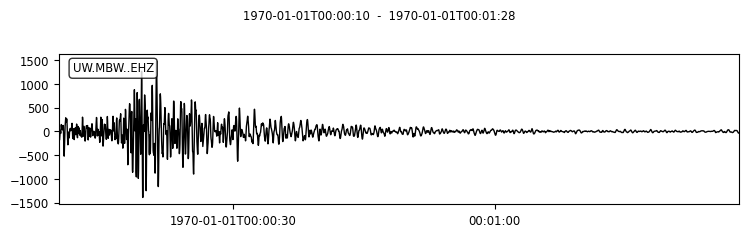

number of windows: 38
maximum amp window index: 0
Max Window:


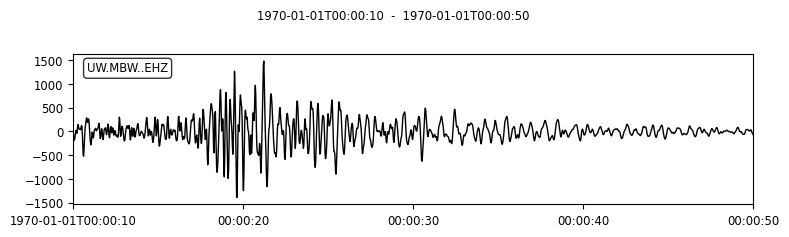

---
mbwehzrpba201 template original stream:


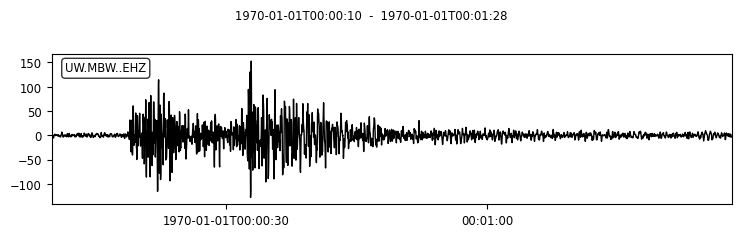

number of windows: 38
maximum amp window index: 9
Max Window:


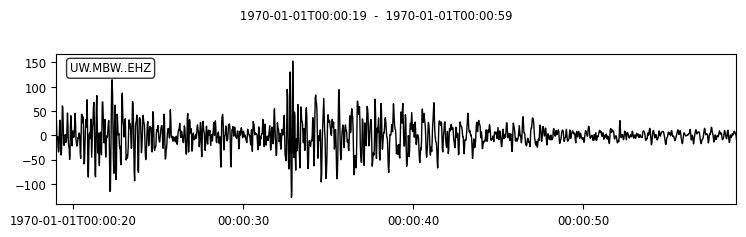

---
mbwehzrpba202 template original stream:


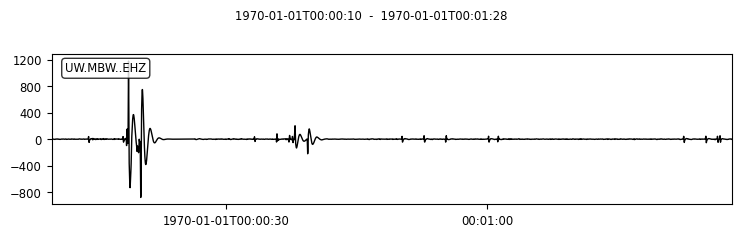

number of windows: 38
maximum amp window index: 4
Max Window:


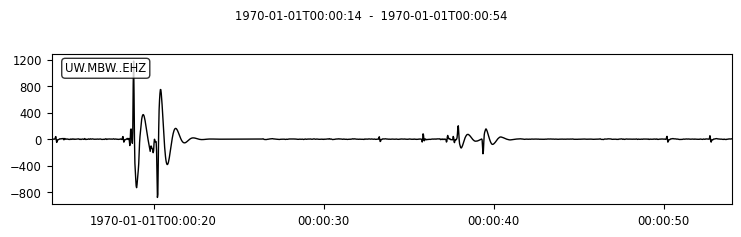

---
mbwehzrpba203 template original stream:


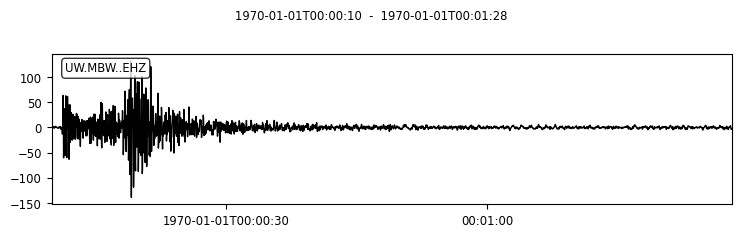

number of windows: 38
maximum amp window index: 1
Max Window:


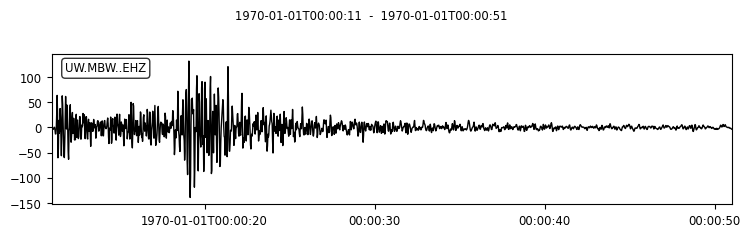

---
mbwehzrpba204 template original stream:


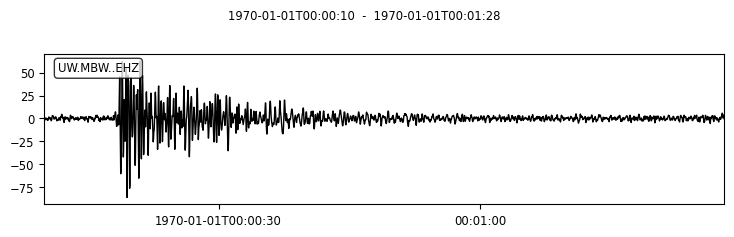

number of windows: 38
maximum amp window index: 8
Max Window:


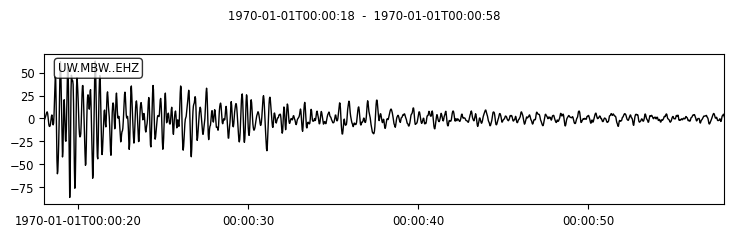

---
mbwehzrpba205 template original stream:


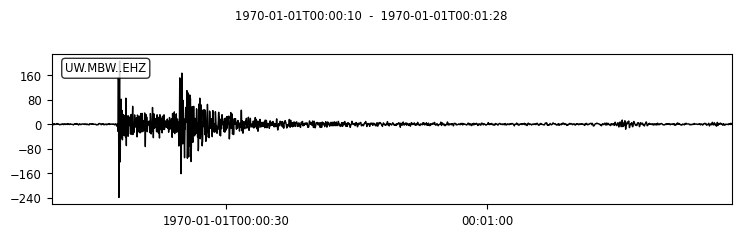

number of windows: 38
maximum amp window index: 7
Max Window:


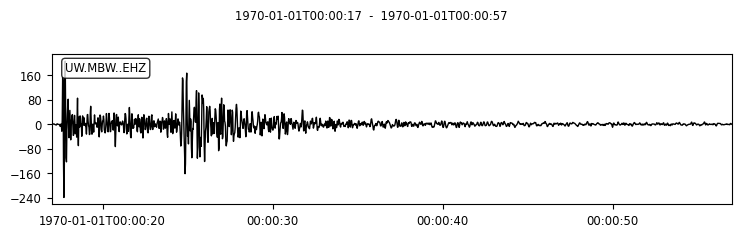

---
mbwehzrpba206 template original stream:


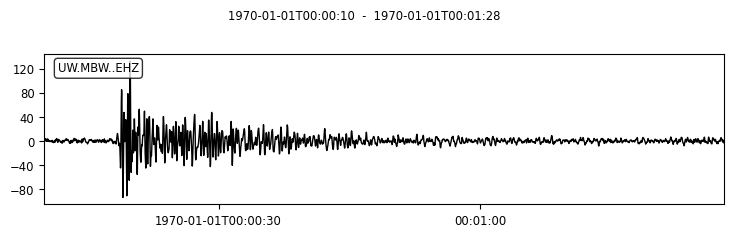

number of windows: 38
maximum amp window index: 8
Max Window:


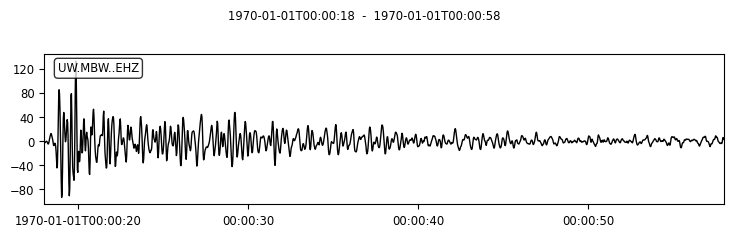

---
mbwehzrpba207 template original stream:


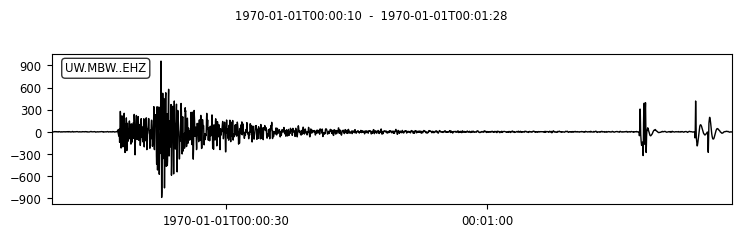

number of windows: 38
maximum amp window index: 7
Max Window:


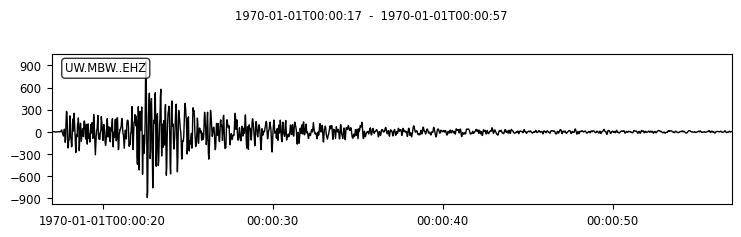

---
mbwehzrpba208 template original stream:


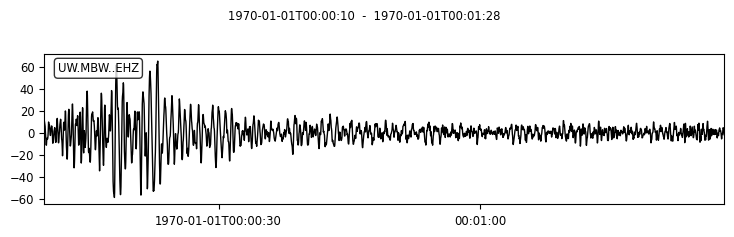

number of windows: 38
maximum amp window index: 0
Max Window:


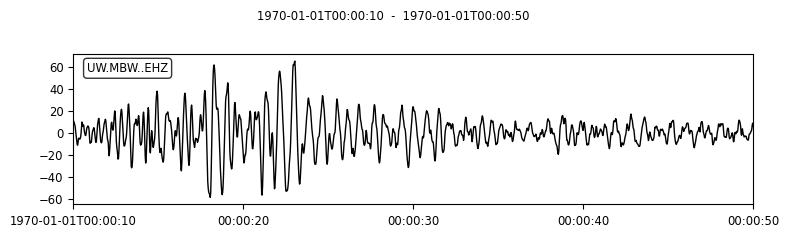

---
mbwehzrpba209 template original stream:


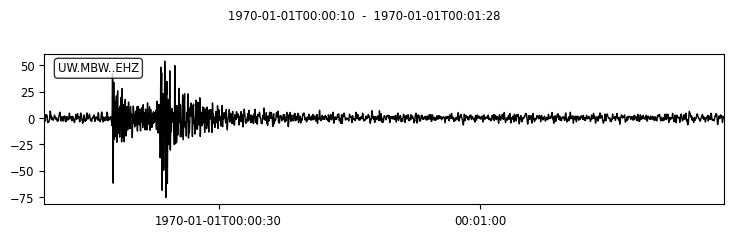

number of windows: 38
maximum amp window index: 0
Max Window:


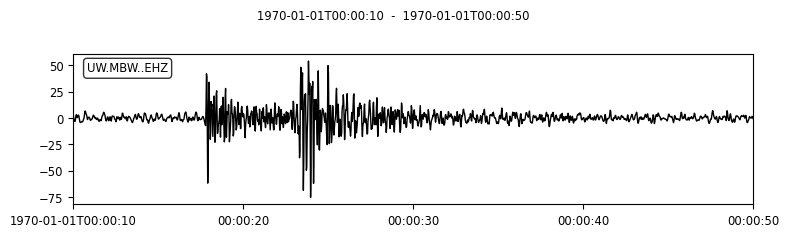

---
mbwehzrpba210 template original stream:


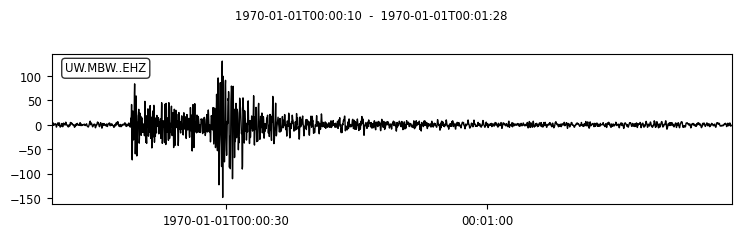

number of windows: 38
maximum amp window index: 9
Max Window:


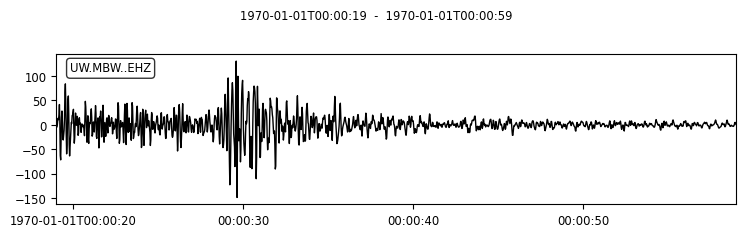

---
mbwehzrpba211 template original stream:


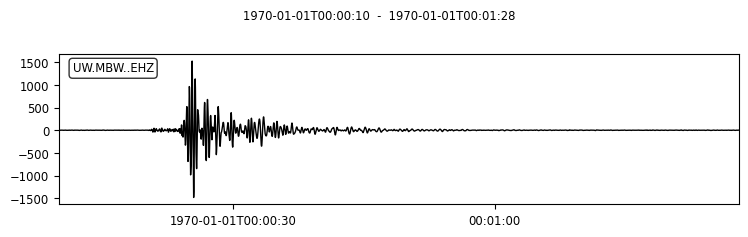

number of windows: 38
maximum amp window index: 10
Max Window:


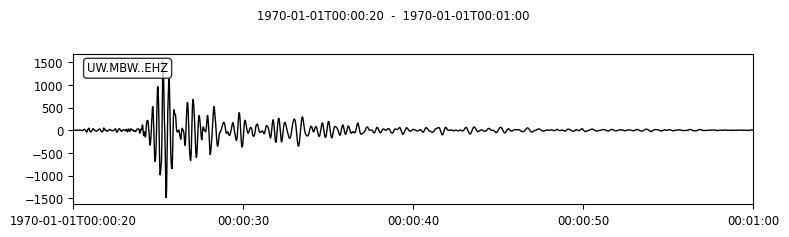

---
mbwehzrpba212 template original stream:


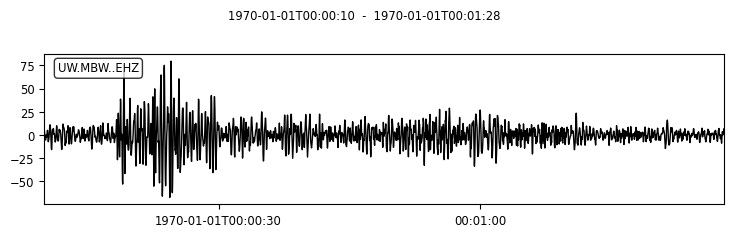

number of windows: 38
maximum amp window index: 8
Max Window:


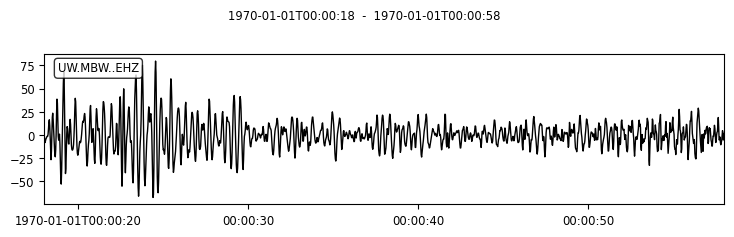

---
mbwehzrpba214 template original stream:


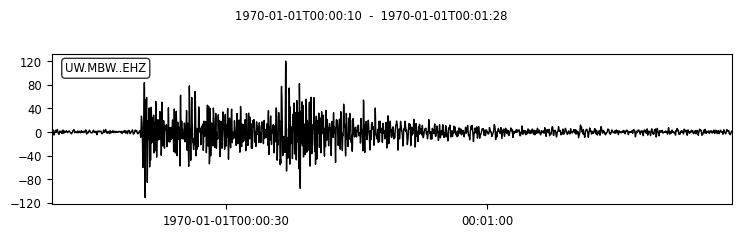

number of windows: 38
maximum amp window index: 10
Max Window:


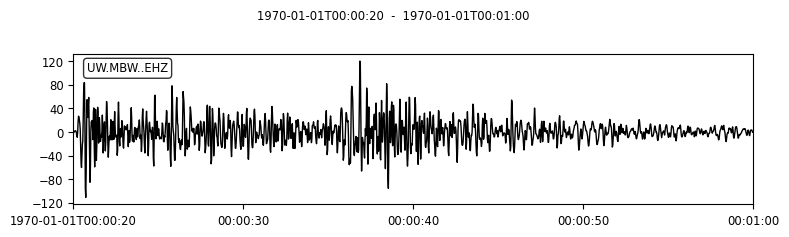

---
mbwehzrpba215 template original stream:


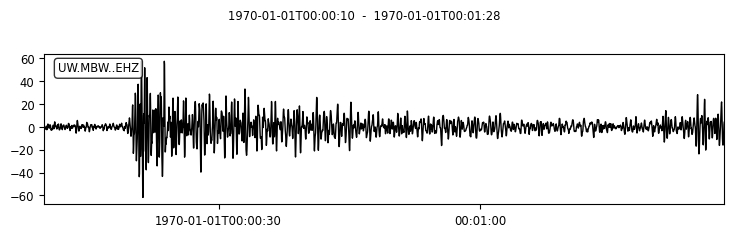

number of windows: 38
maximum amp window index: 10
Max Window:


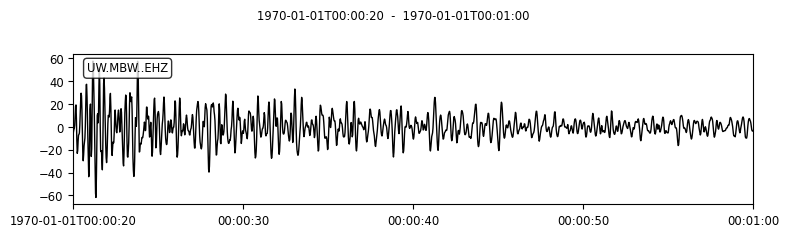

---
mbwehzrpba216 template original stream:


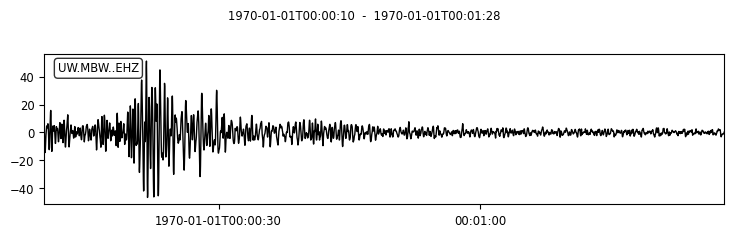

number of windows: 38
maximum amp window index: 0
Max Window:


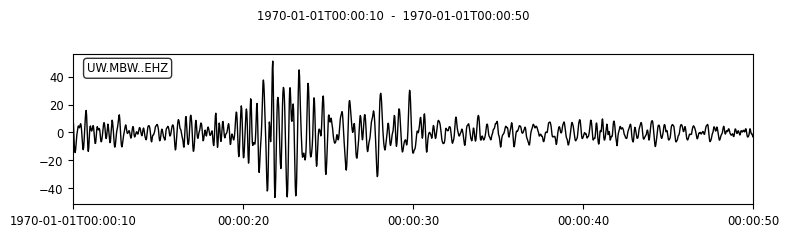

---
mbwehzrpba217 template original stream:


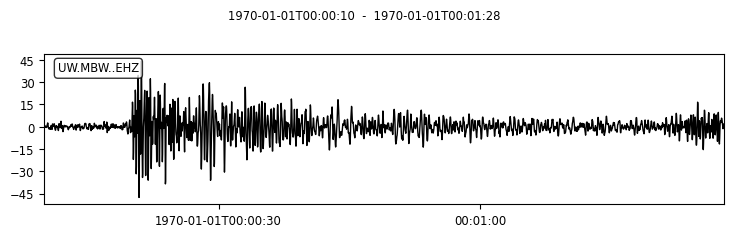

number of windows: 38
maximum amp window index: 10
Max Window:


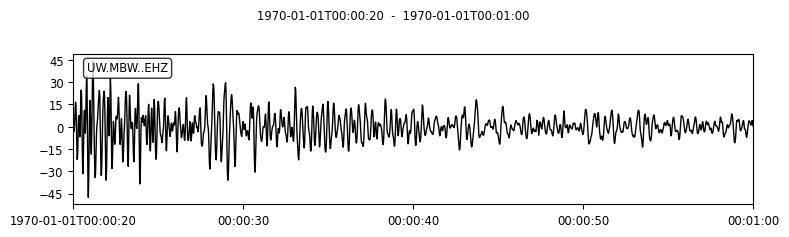

---
mbwehzrpba218 template original stream:


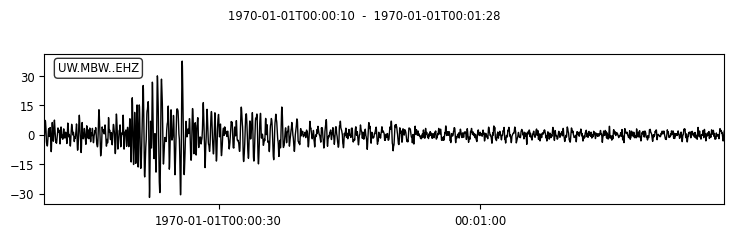

number of windows: 38
maximum amp window index: 0
Max Window:


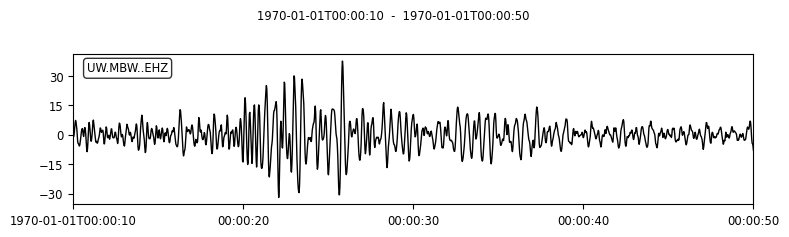

---
mbwehzrpba219 template original stream:


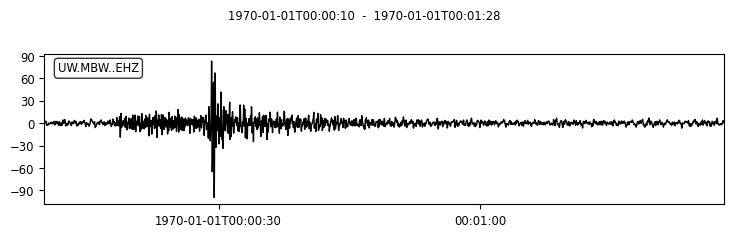

number of windows: 38
maximum amp window index: 8
Max Window:


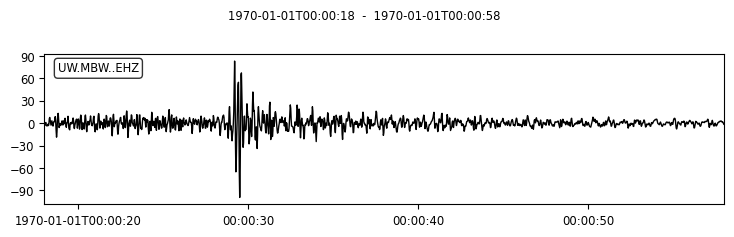

---
mbwehzrpba220 template original stream:


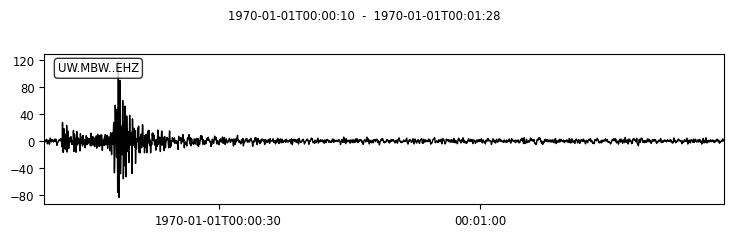

number of windows: 38
maximum amp window index: 0
Max Window:


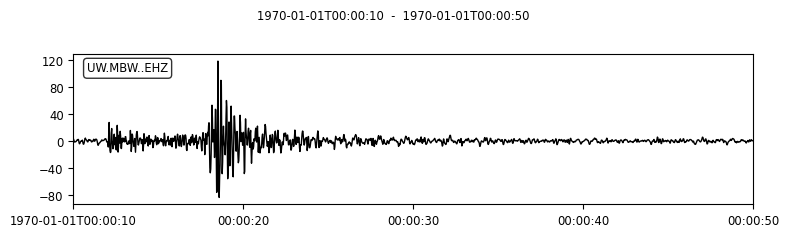

---
mbwehzrpba221 template original stream:


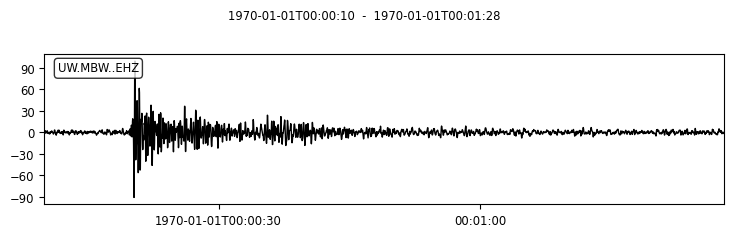

number of windows: 38
maximum amp window index: 9
Max Window:


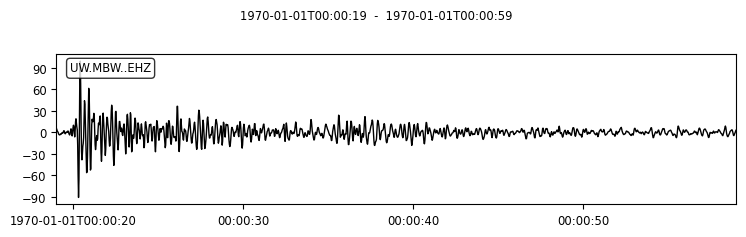

---
mbwehzrpba222 template original stream:


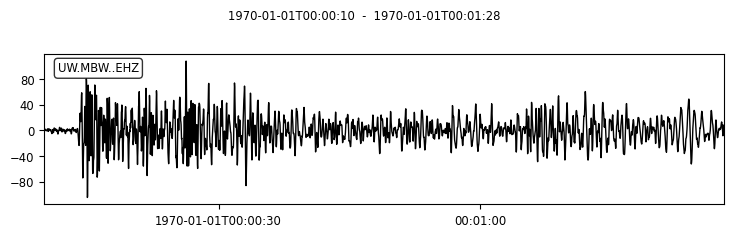

number of windows: 38
maximum amp window index: 4
Max Window:


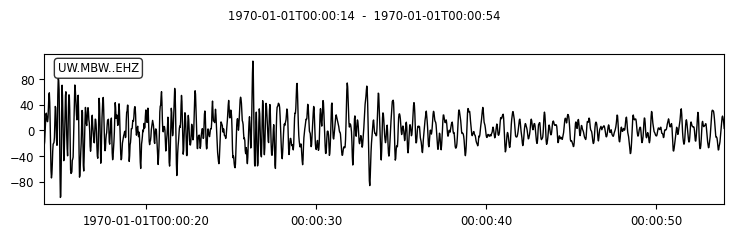

---
mbwehzrpba223 template original stream:


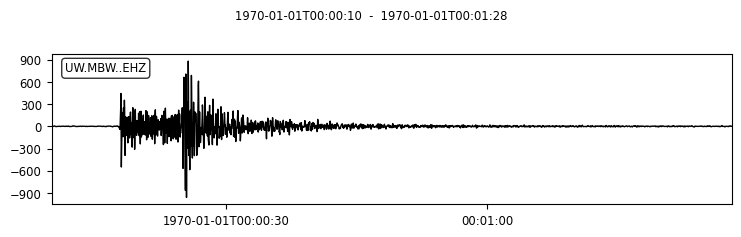

number of windows: 38
maximum amp window index: 7
Max Window:


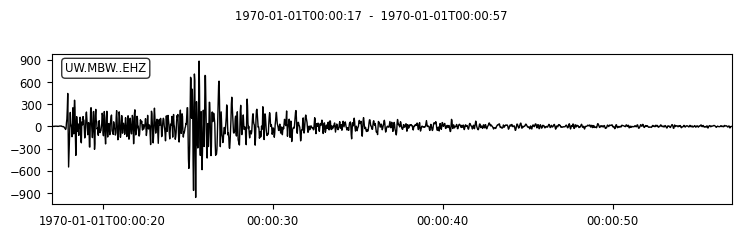

---
mbwehzrpba224 template original stream:


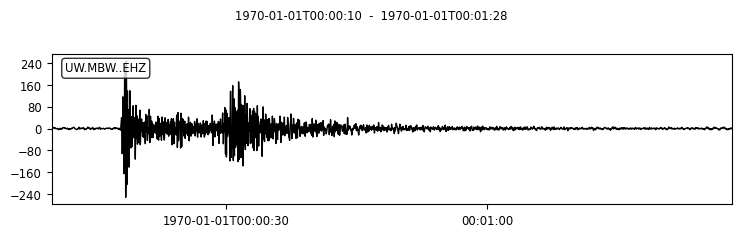

number of windows: 38
maximum amp window index: 8
Max Window:


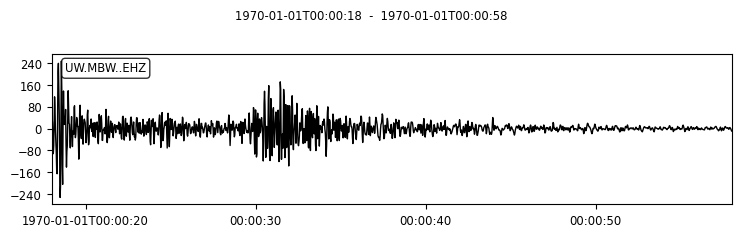

---
mbwehzrpba225 template original stream:


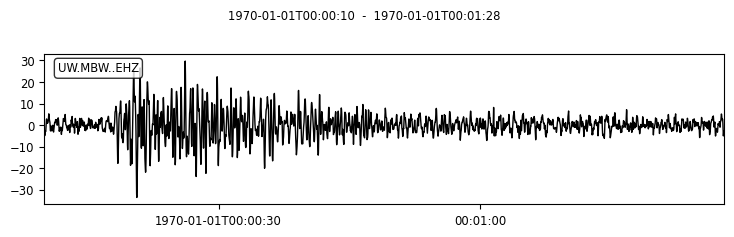

number of windows: 38
maximum amp window index: 8
Max Window:


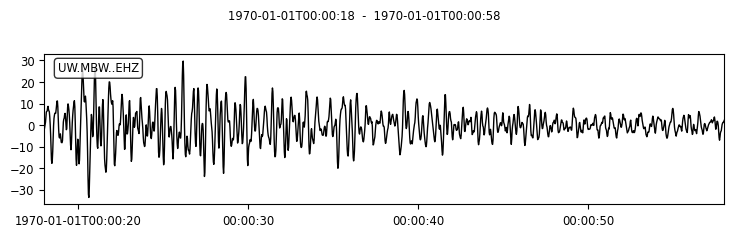

---
mbwehzrpba226 template original stream:


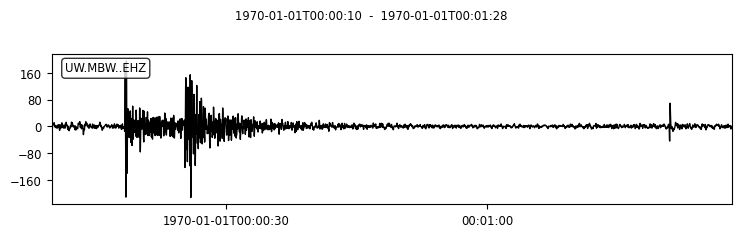

number of windows: 38
maximum amp window index: 0
Max Window:


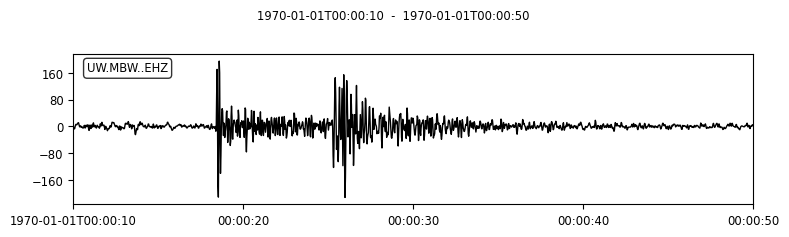

---
mbwehzrpba227 template original stream:


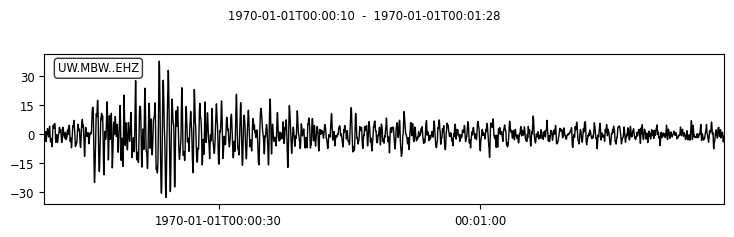

number of windows: 38
maximum amp window index: 3
Max Window:


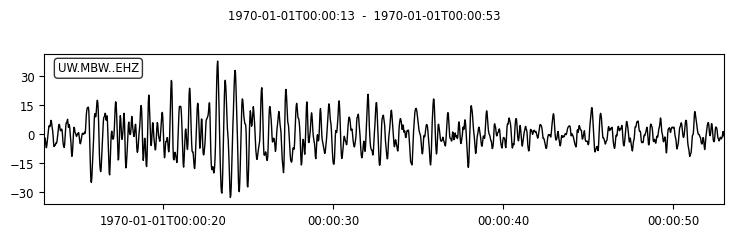

---
mbwehzrpba229 template original stream:


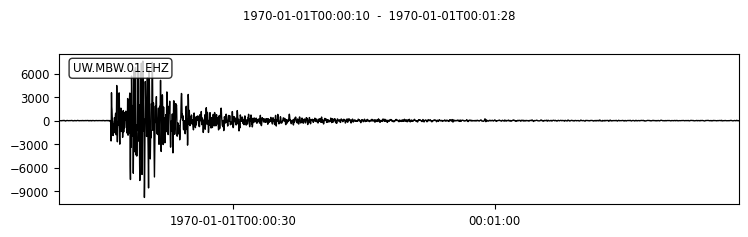

number of windows: 38
maximum amp window index: 5
Max Window:


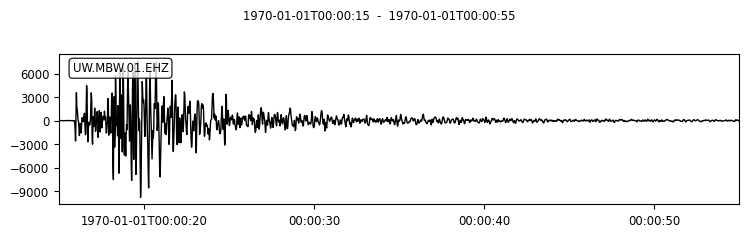

---
mbwehzrpba230 template original stream:


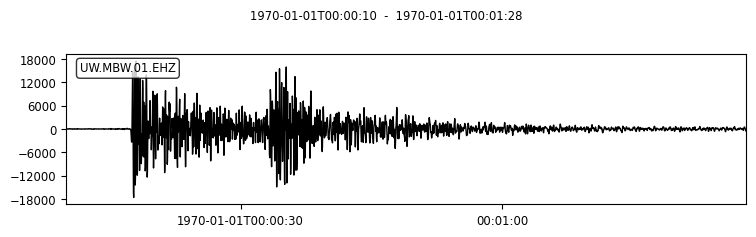

number of windows: 38
maximum amp window index: 7
Max Window:


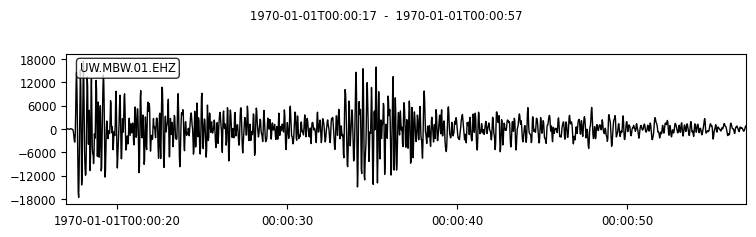

---
mbwehzrpba231 template original stream:


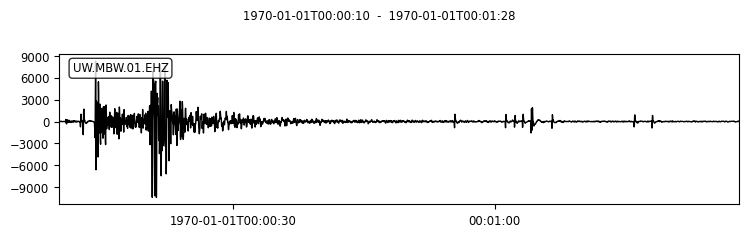

number of windows: 38
maximum amp window index: 1
Max Window:


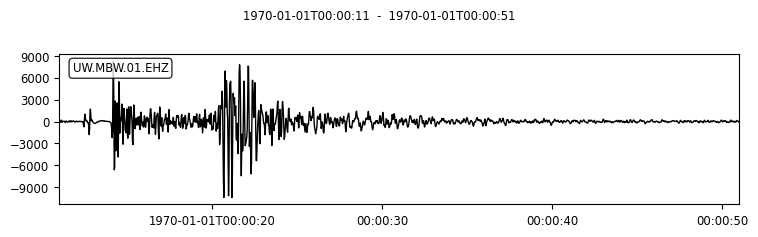

---
passhhzrpba009 template original stream:


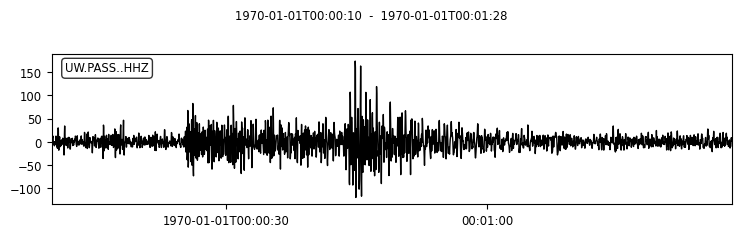

number of windows: 38
maximum amp window index: 15
Max Window:


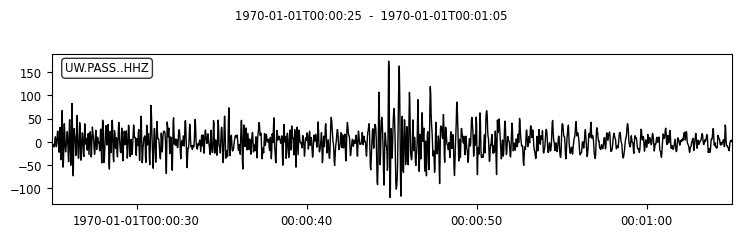

---
passhhzrpba013 template original stream:


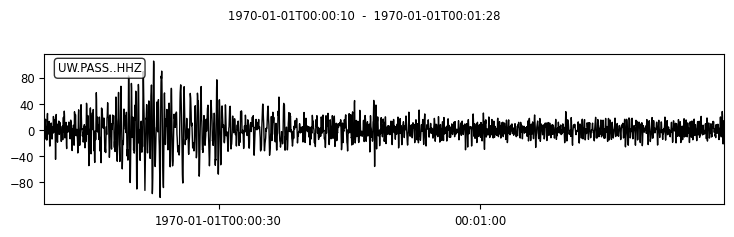

number of windows: 38
maximum amp window index: 0
Max Window:


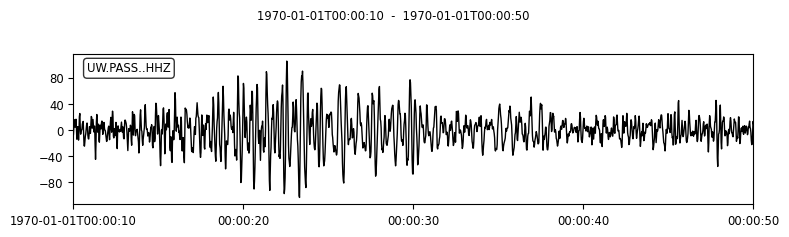

---
passhhzrpba049 template original stream:


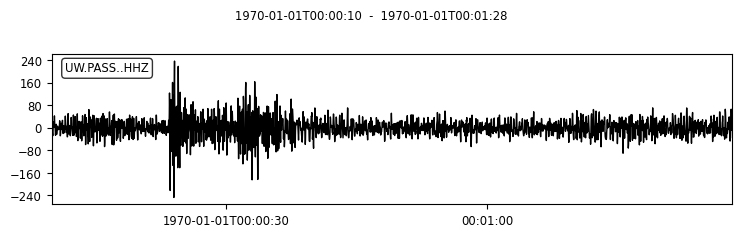

number of windows: 38
maximum amp window index: 2
Max Window:


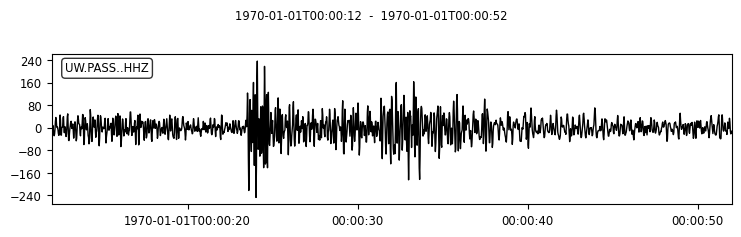

---
passhhzrpba103 template original stream:


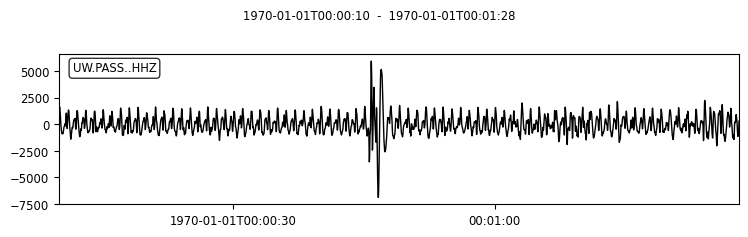

number of windows: 38
maximum amp window index: 35
Max Window:


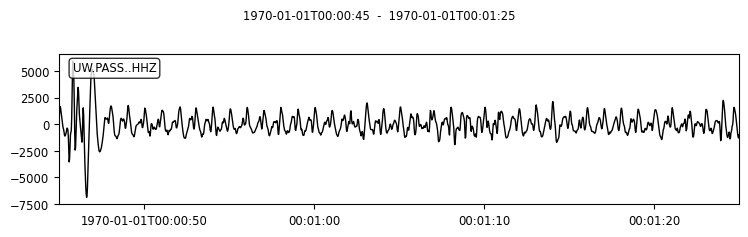

---
passhhzrpba116 template original stream:


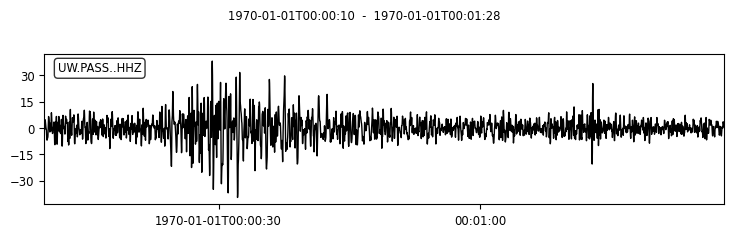

number of windows: 38
maximum amp window index: 2
Max Window:


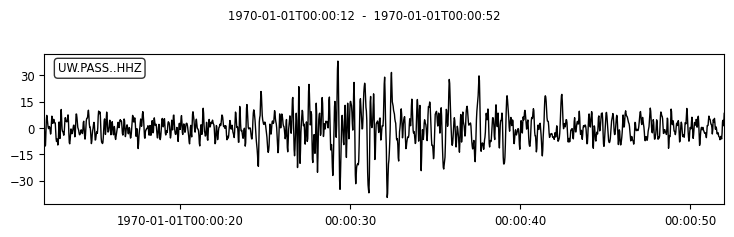

---
passhhzrpba118 template original stream:


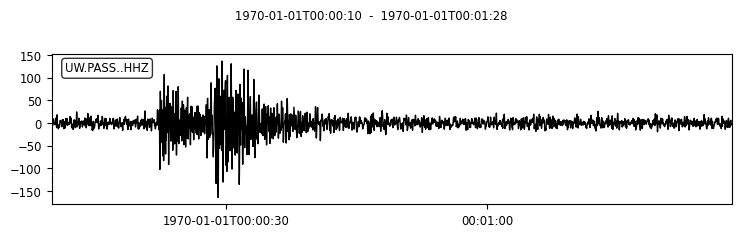

number of windows: 38
maximum amp window index: 4
Max Window:


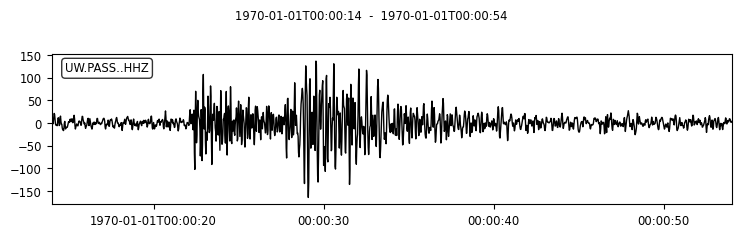

---
passhhzrpba119 template original stream:


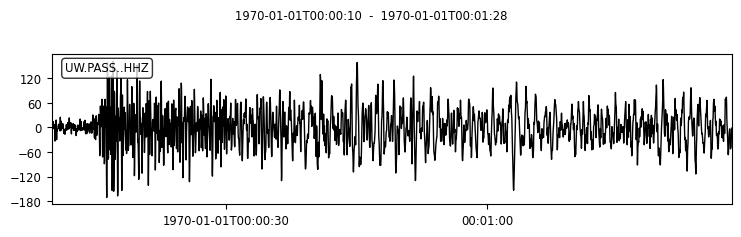

number of windows: 38
maximum amp window index: 5
Max Window:


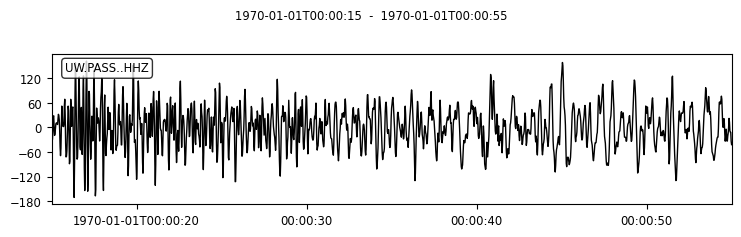

---
passhhzrpba120 template original stream:


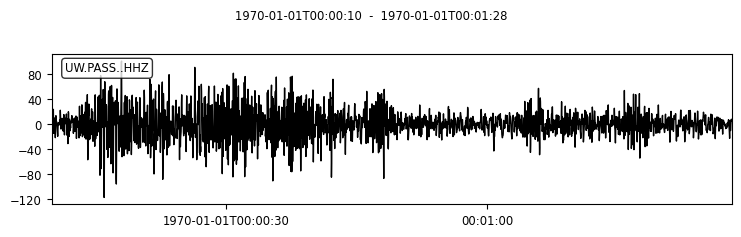

number of windows: 38
maximum amp window index: 1
Max Window:


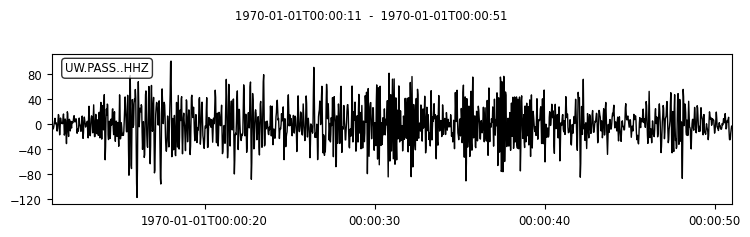

---
passhhzrpba121 template original stream:


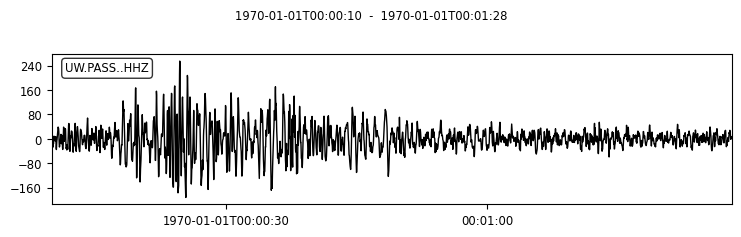

number of windows: 38
maximum amp window index: 2
Max Window:


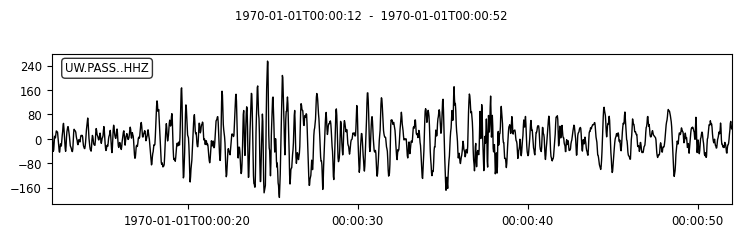

---
passhhzrpba126 template original stream:


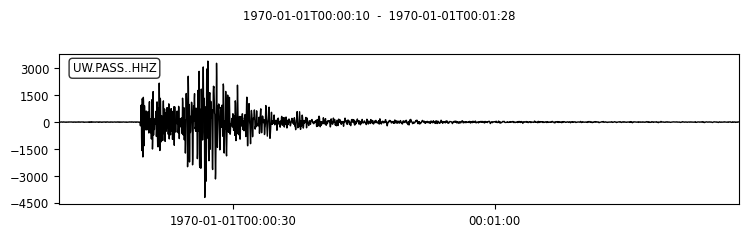

number of windows: 38
maximum amp window index: 9
Max Window:


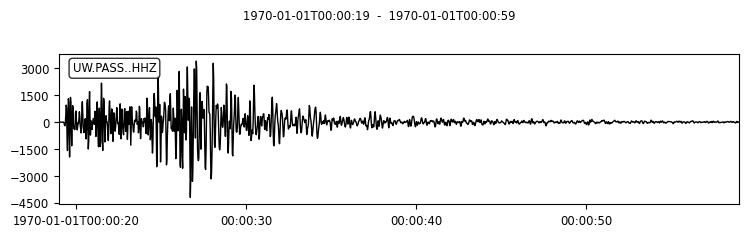

---
passhhzrpba127 template original stream:


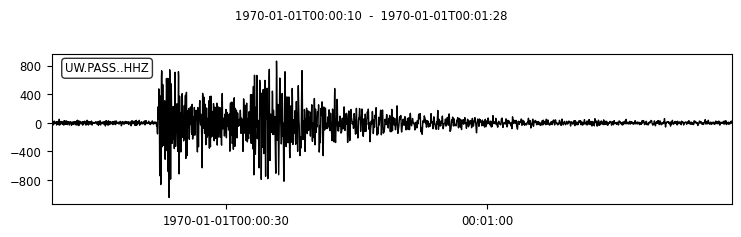

number of windows: 38
maximum amp window index: 12
Max Window:


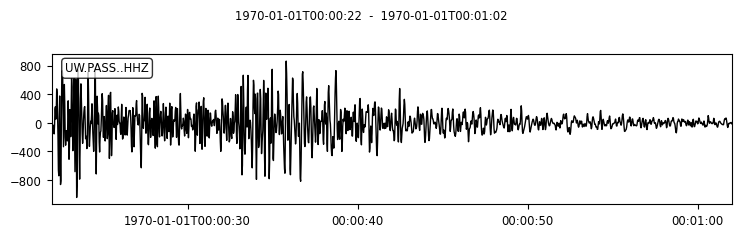

---
passhhzrpba128 template original stream:


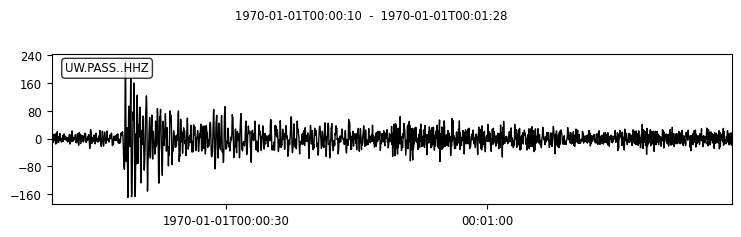

number of windows: 38
maximum amp window index: 8
Max Window:


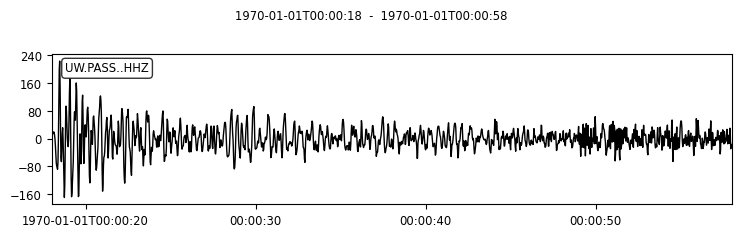

---
passhhzrpba129 template original stream:


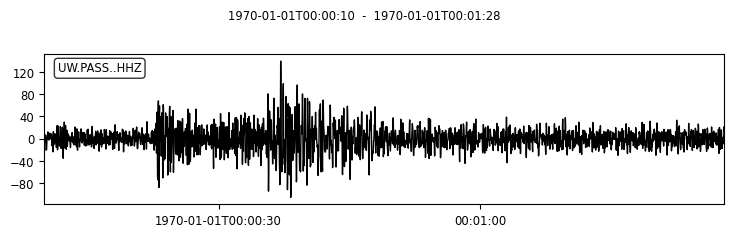

number of windows: 38
maximum amp window index: 13
Max Window:


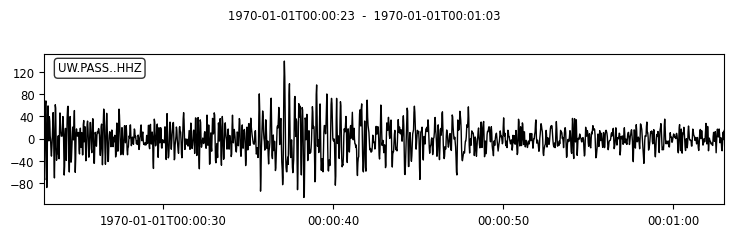

---
passhhzrpba130 template original stream:


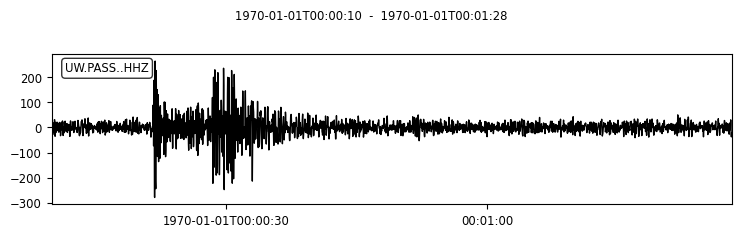

number of windows: 38
maximum amp window index: 6
Max Window:


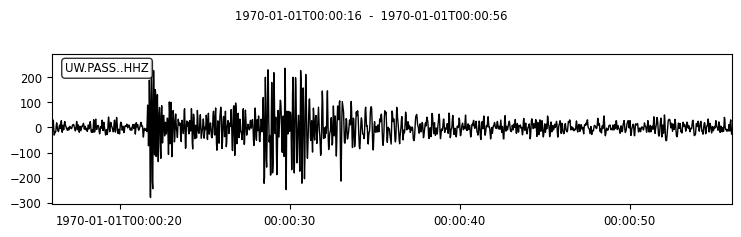

---
passhhzrpba132 template original stream:


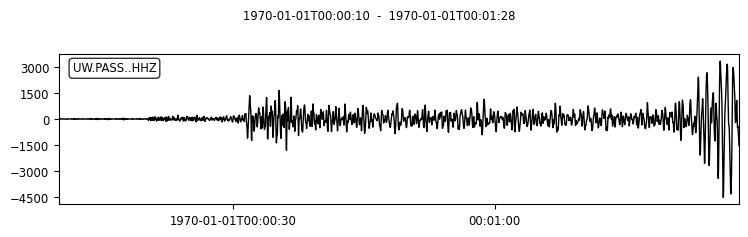

number of windows: 38
maximum amp window index: 38
Max Window:


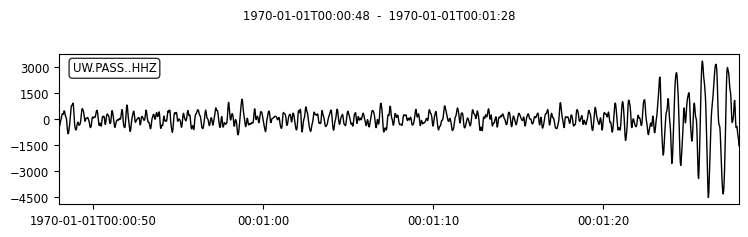

---
passhhzrpba136 template original stream:


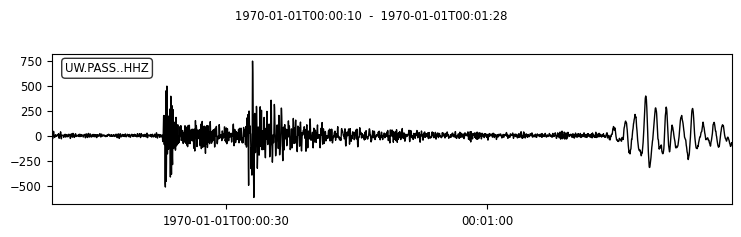

number of windows: 38
maximum amp window index: 12
Max Window:


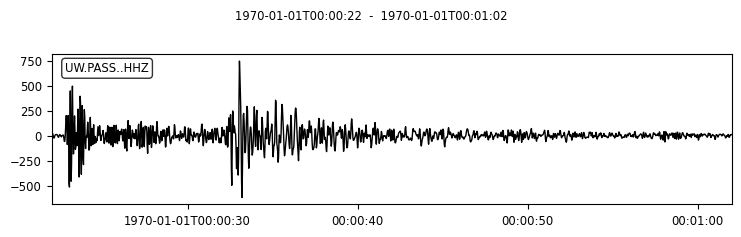

---
passhhzrpba138 template original stream:


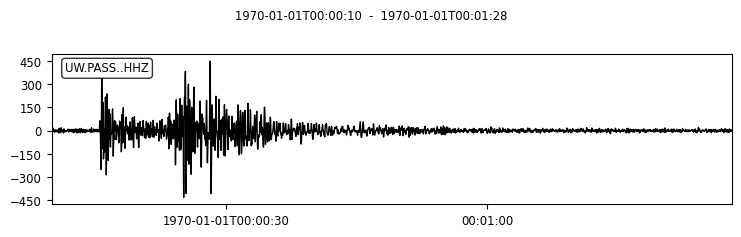

number of windows: 38
maximum amp window index: 5
Max Window:


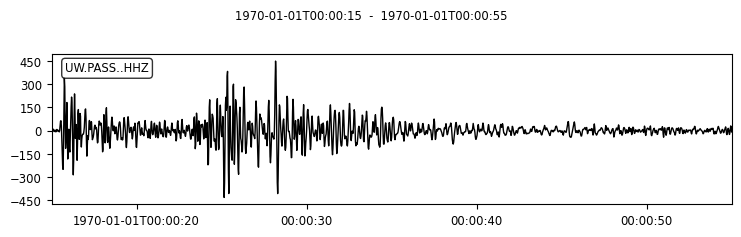

---
passhhzrpba139 template original stream:


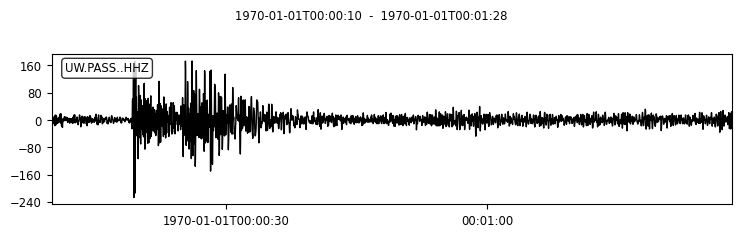

number of windows: 38
maximum amp window index: 9
Max Window:


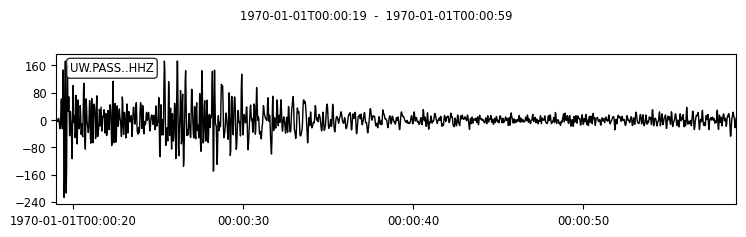

---
passhhzrpba140 template original stream:


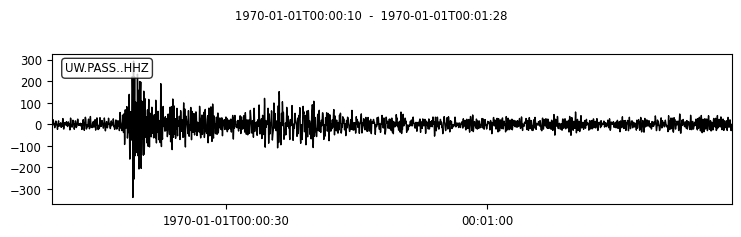

number of windows: 38
maximum amp window index: 6
Max Window:


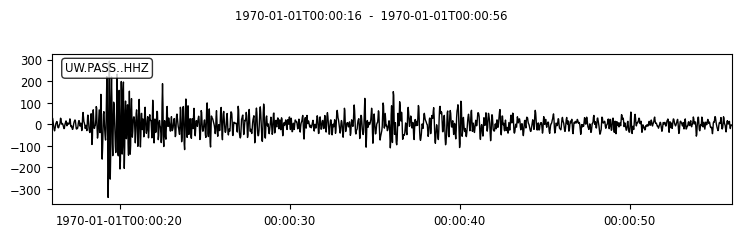

---
passhhzrpba143 template original stream:


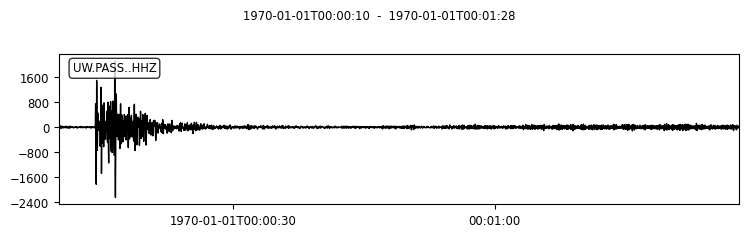

number of windows: 38
maximum amp window index: 4
Max Window:


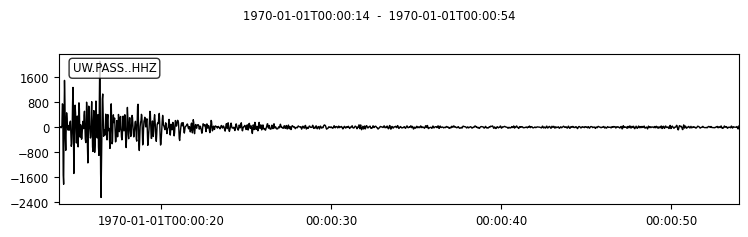

---
passhhzrpba146 template original stream:


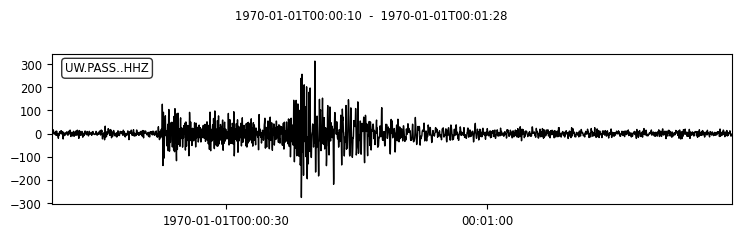

number of windows: 38
maximum amp window index: 12
Max Window:


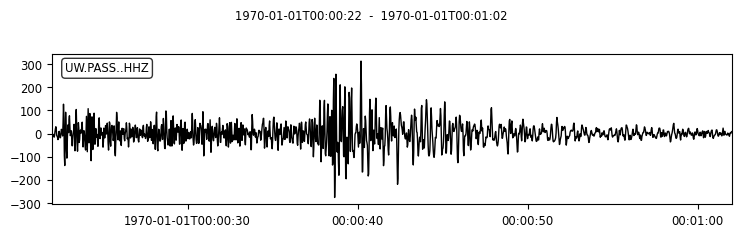

---
passhhzrpba148 template original stream:


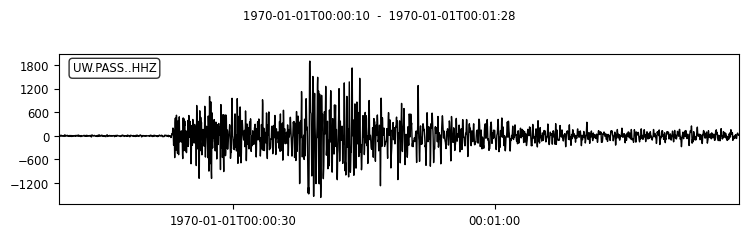

number of windows: 38
maximum amp window index: 13
Max Window:


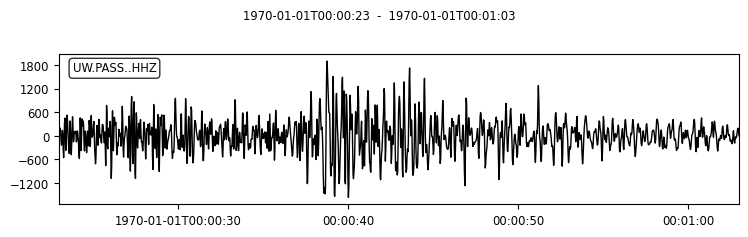

---
passhhzrpba149 template original stream:


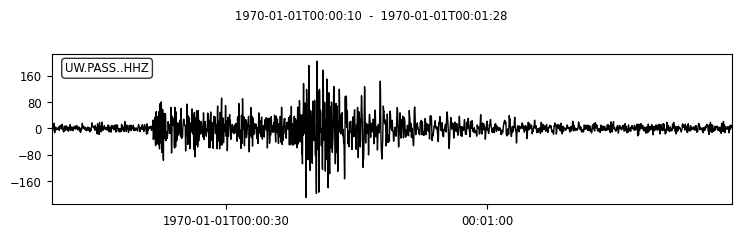

number of windows: 38
maximum amp window index: 11
Max Window:


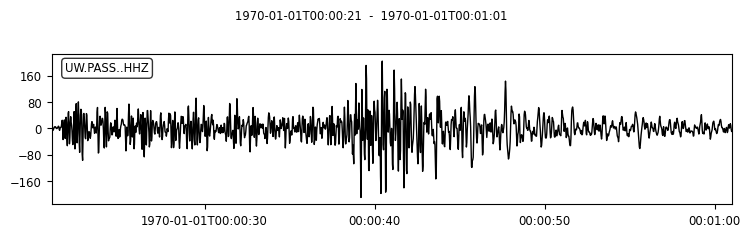

---
passhhzrpba150 template original stream:


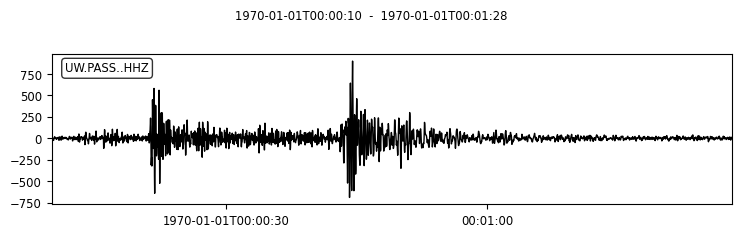

number of windows: 38
maximum amp window index: 11
Max Window:


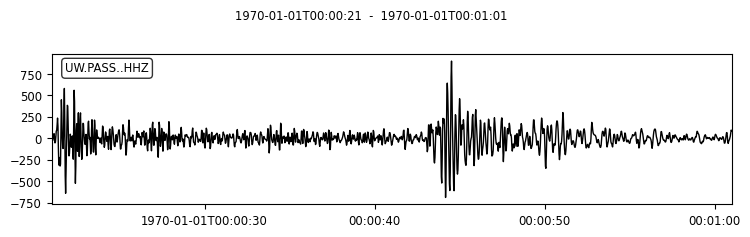

---
passhhzrpba151 template original stream:


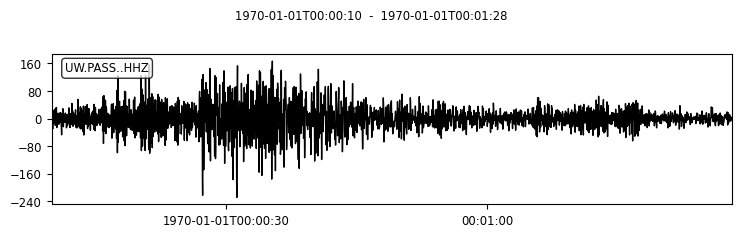

number of windows: 38
maximum amp window index: 5
Max Window:


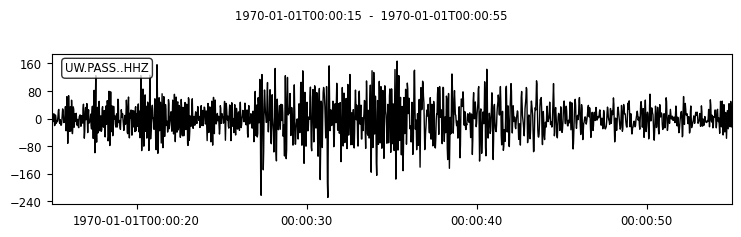

---
passhhzrpba152 template original stream:


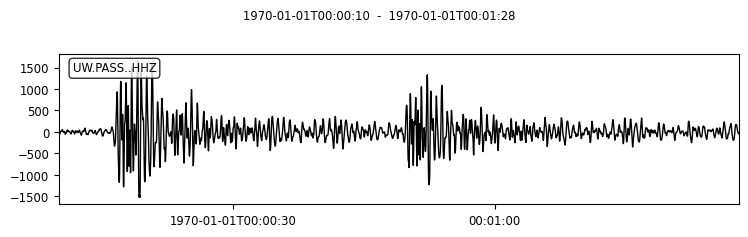

number of windows: 38
maximum amp window index: 6
Max Window:


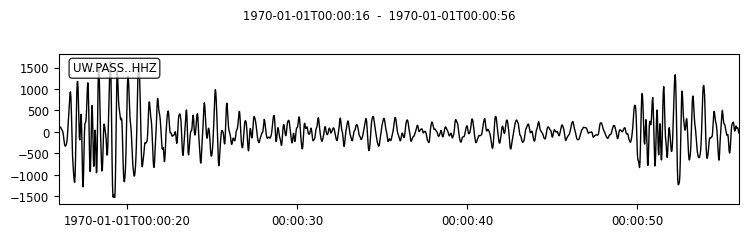

---
passhhzrpba154 template original stream:


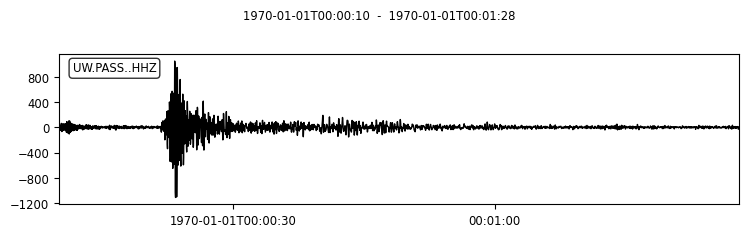

number of windows: 38
maximum amp window index: 11
Max Window:


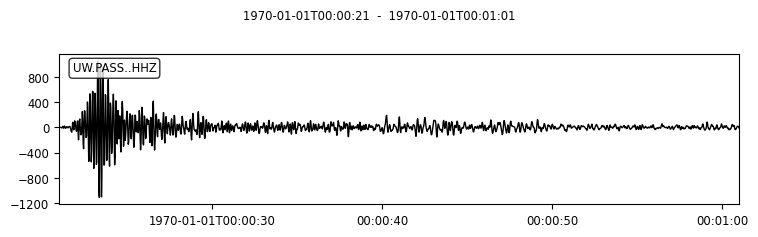

---
passhhzrpba155 template original stream:


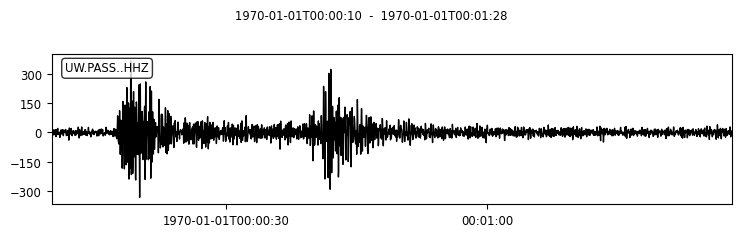

number of windows: 38
maximum amp window index: 7
Max Window:


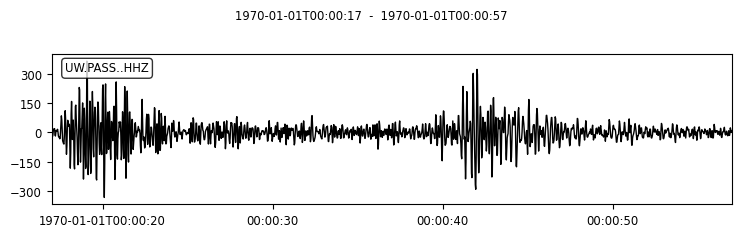

---
passhhzrpba156 template original stream:


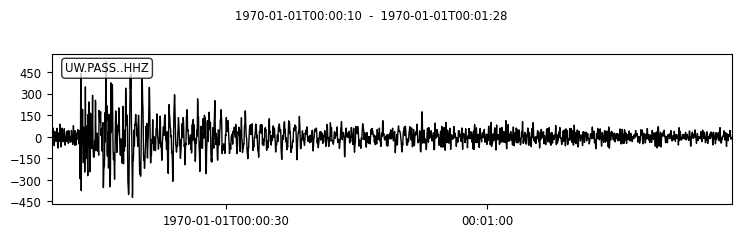

number of windows: 38
maximum amp window index: 3
Max Window:


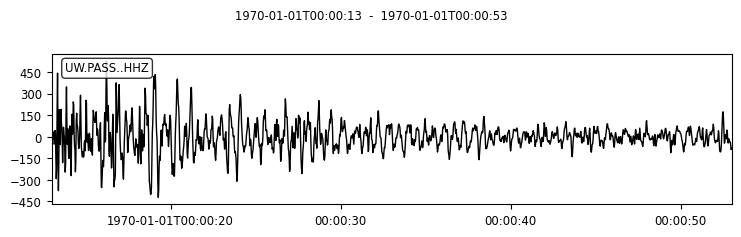

---
passhhzrpba157 template original stream:


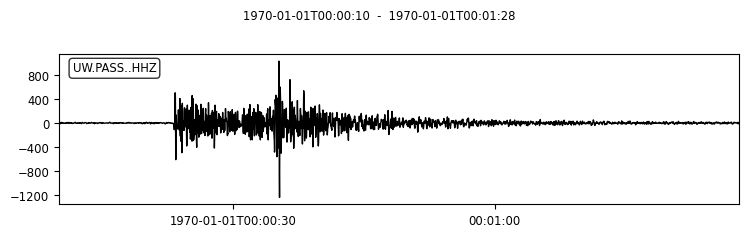

number of windows: 38
maximum amp window index: 13
Max Window:


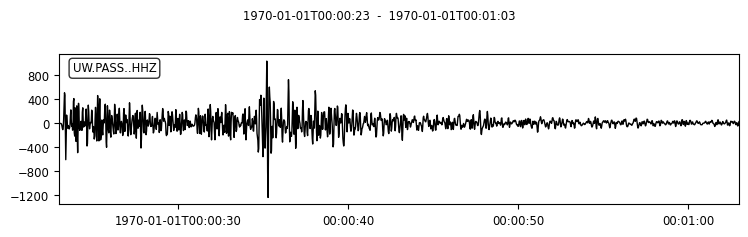

---
passhhzrpba159 template original stream:


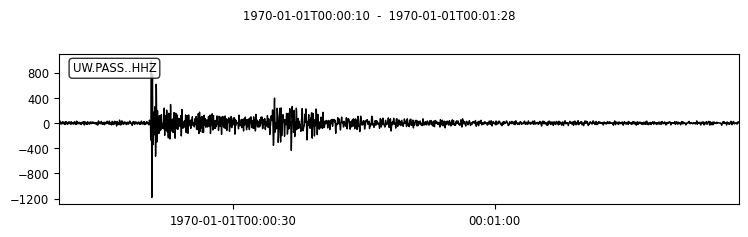

number of windows: 38
maximum amp window index: 10
Max Window:


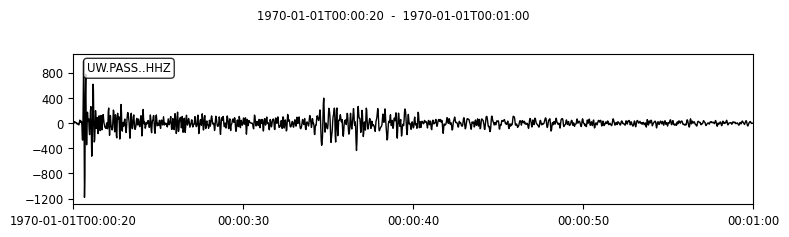

---
passhhzrpba160 template original stream:


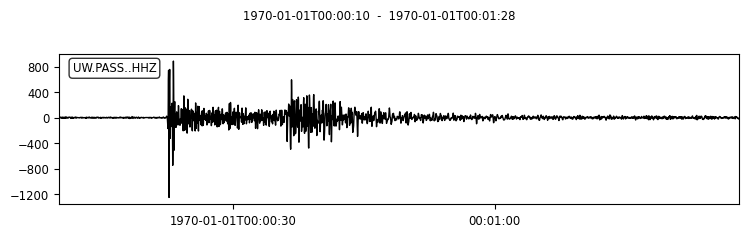

number of windows: 38
maximum amp window index: 12
Max Window:


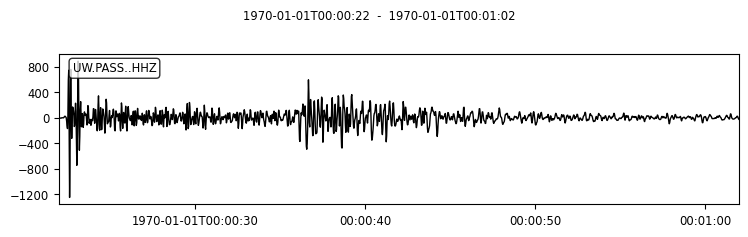

---
passhhzrpba161 template original stream:


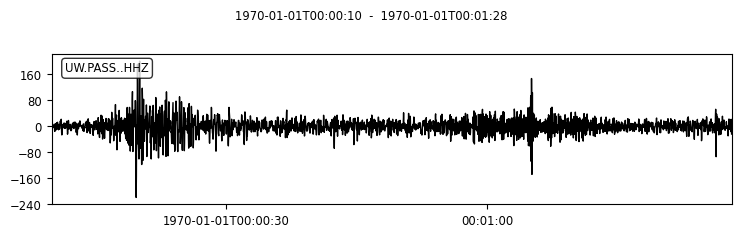

number of windows: 38
maximum amp window index: 6
Max Window:


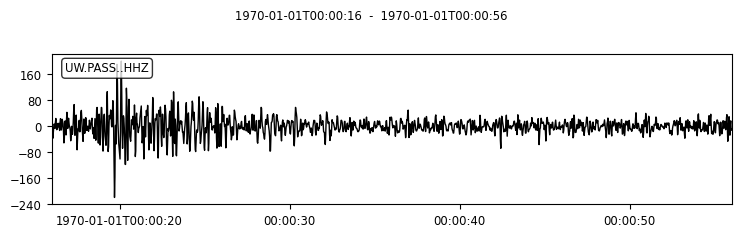

---
passhhzrpba162 template original stream:


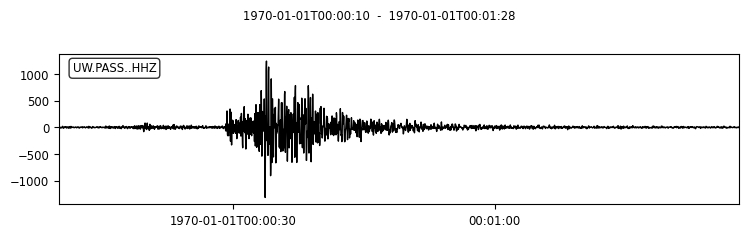

number of windows: 38
maximum amp window index: 9
Max Window:


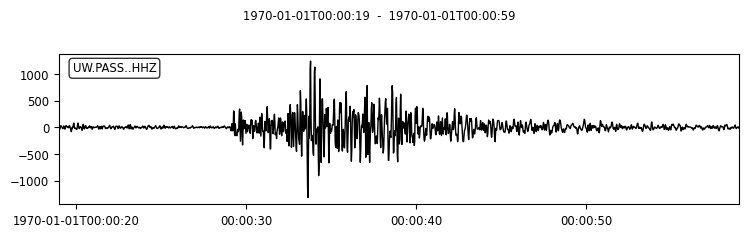

---
passhhzrpba163 template original stream:


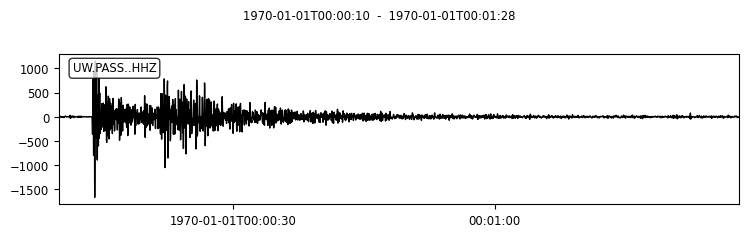

number of windows: 38
maximum amp window index: 3
Max Window:


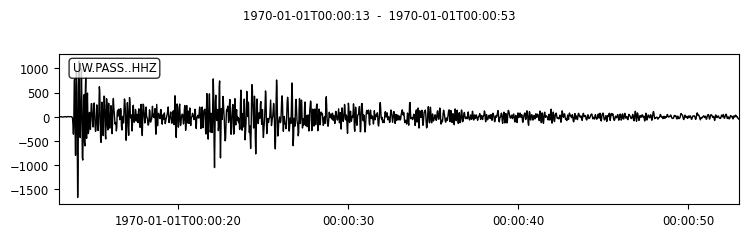

---
passhhzrpba164 template original stream:


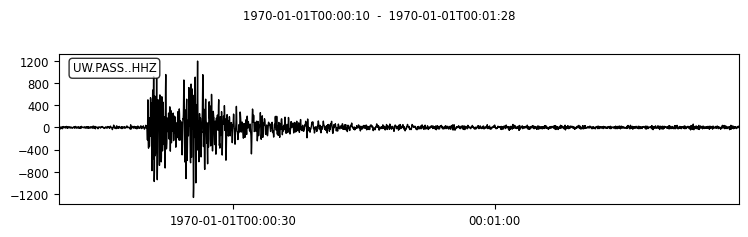

number of windows: 38
maximum amp window index: 10
Max Window:


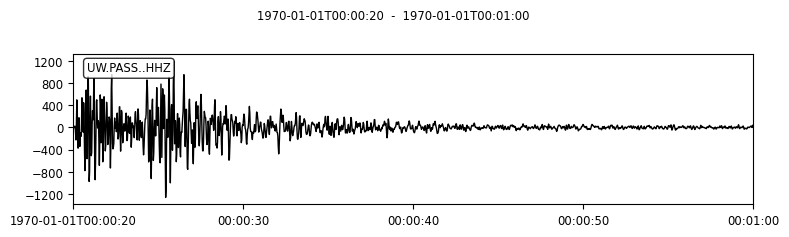

---
passhhzrpba165 template original stream:


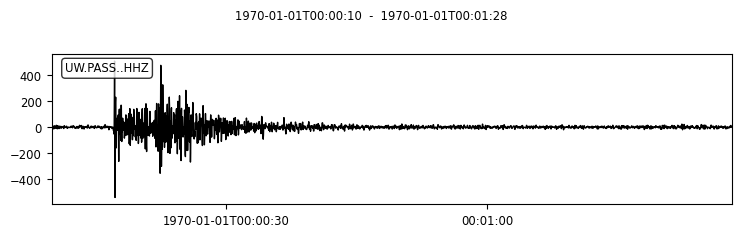

number of windows: 38
maximum amp window index: 7
Max Window:


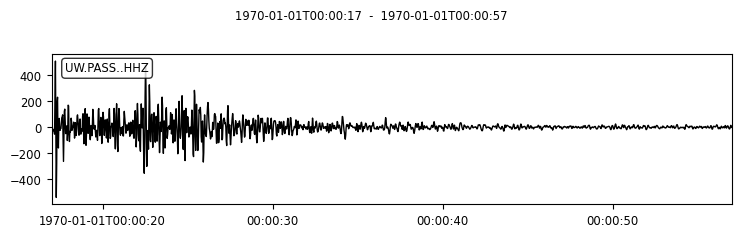

---
passhhzrpba166 template original stream:


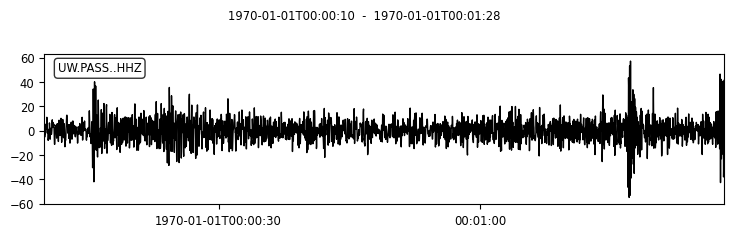

number of windows: 38
maximum amp window index: 5
Max Window:


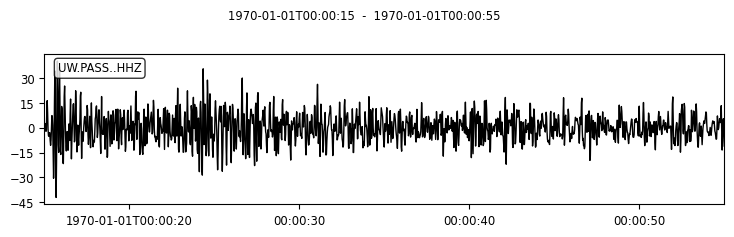

---
passhhzrpba167 template original stream:


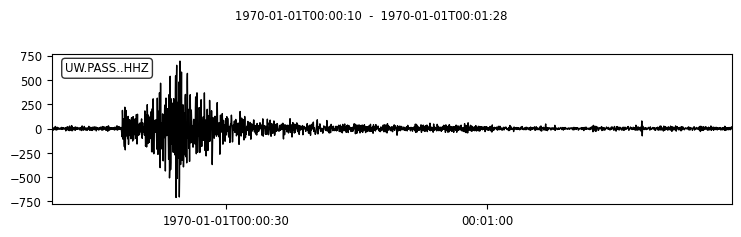

number of windows: 38
maximum amp window index: 8
Max Window:


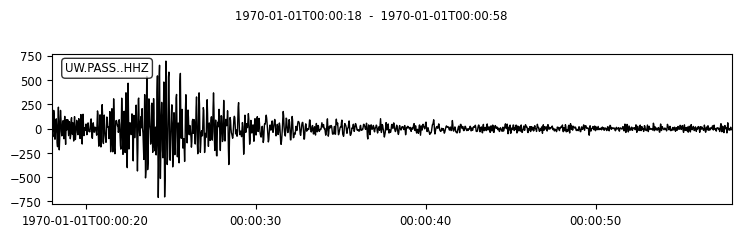

---
passhhzrpba168 template original stream:


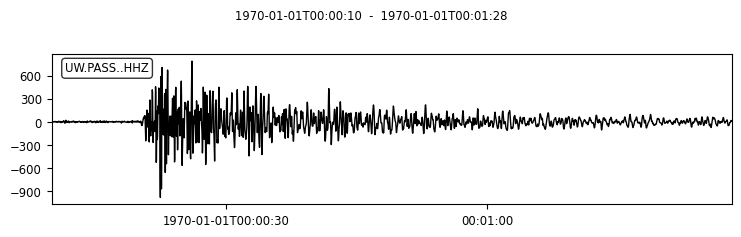

number of windows: 38
maximum amp window index: 10
Max Window:


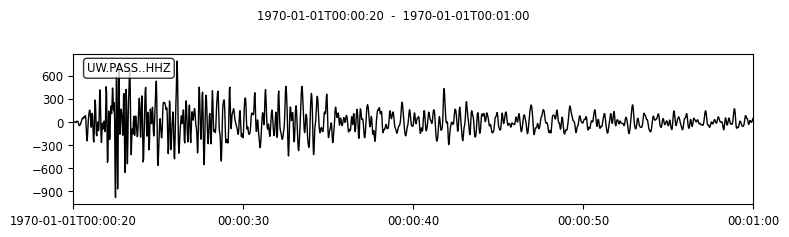

---
passhhzrpba169 template original stream:


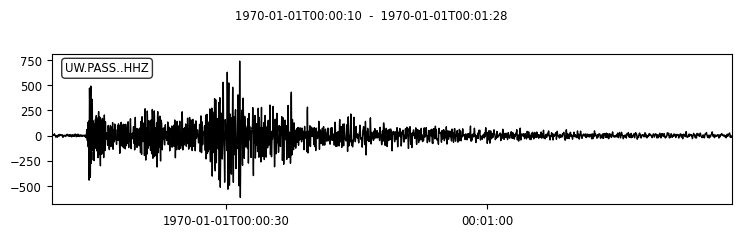

number of windows: 38
maximum amp window index: 4
Max Window:


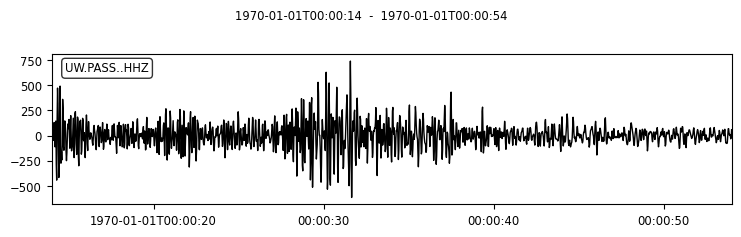

---
passhhzrpba170 template original stream:


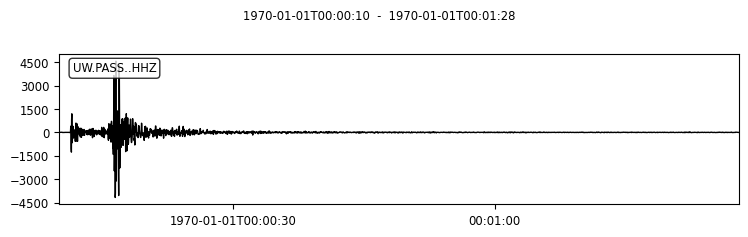

number of windows: 38
maximum amp window index: 1
Max Window:


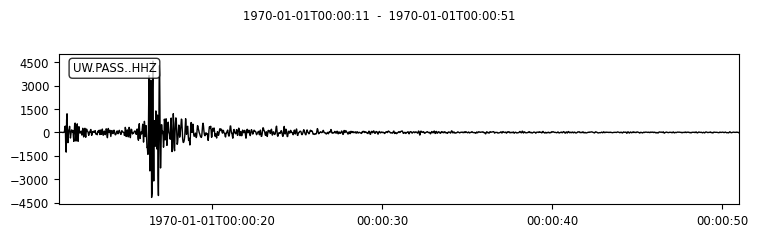

---
shukbhzrpba009 template original stream:


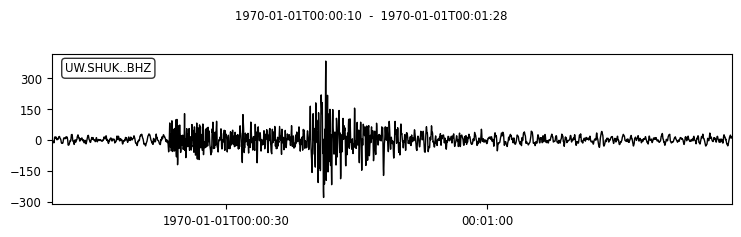

number of windows: 38
maximum amp window index: 13
Max Window:


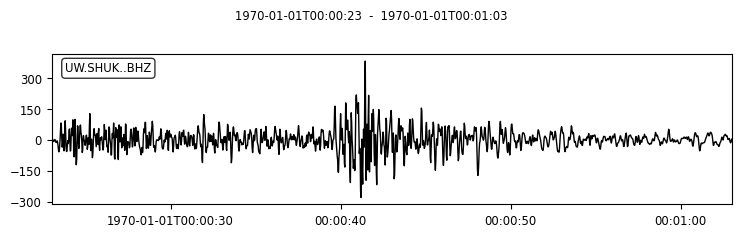

---
shukbhzrpba013 template original stream:


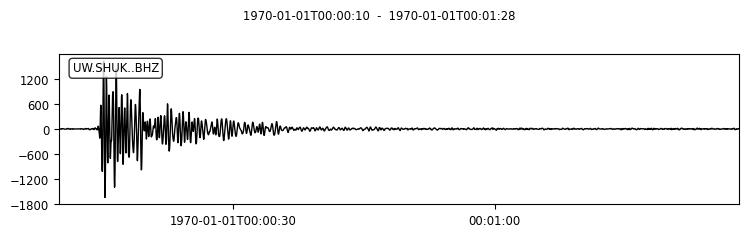

number of windows: 38
maximum amp window index: 4
Max Window:


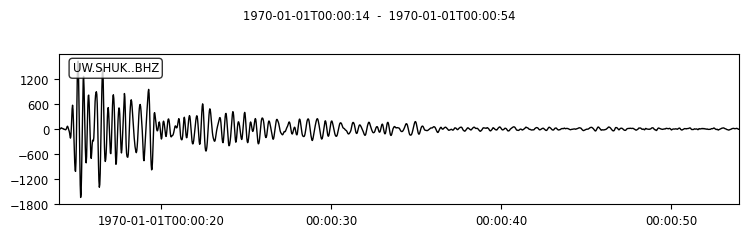

---
shukbhzrpba014 template original stream:


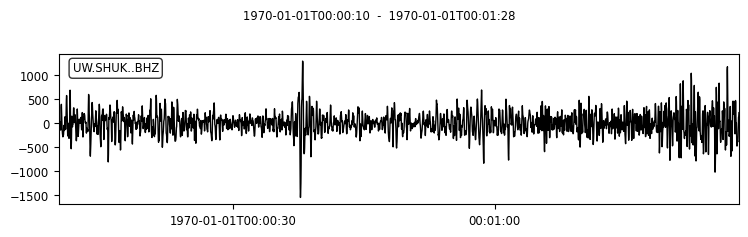

number of windows: 38
maximum amp window index: 38
Max Window:


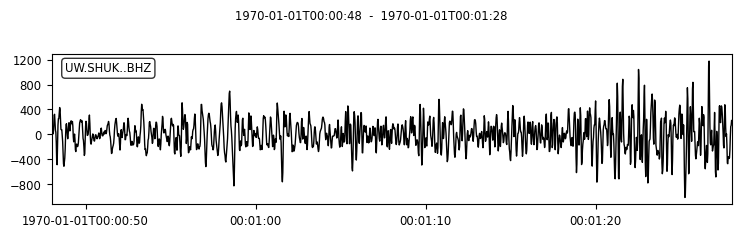

---
shukbhzrpba015 template original stream:


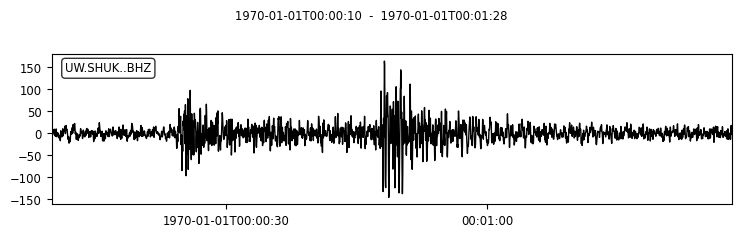

number of windows: 38
maximum amp window index: 14
Max Window:


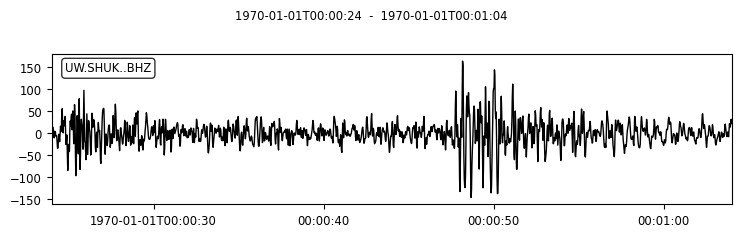

---
shukbhzrpba016 template original stream:


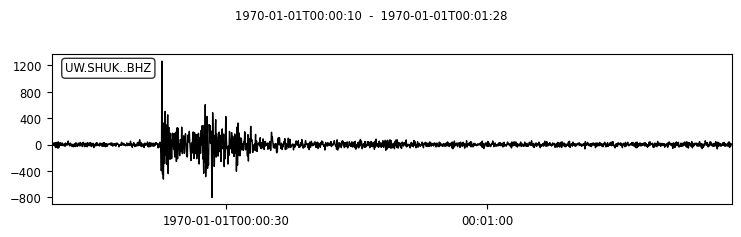

number of windows: 38
maximum amp window index: 11
Max Window:


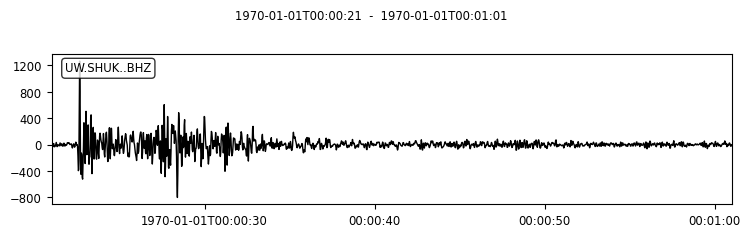

---
shukbhzrpba018 template original stream:


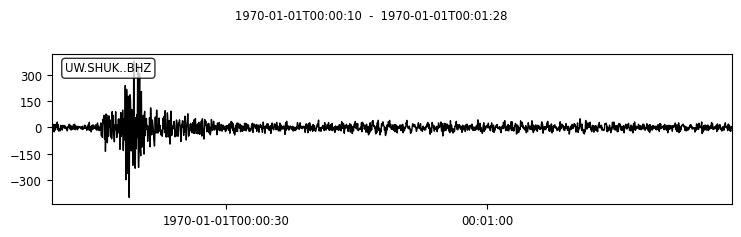

number of windows: 38
maximum amp window index: 5
Max Window:


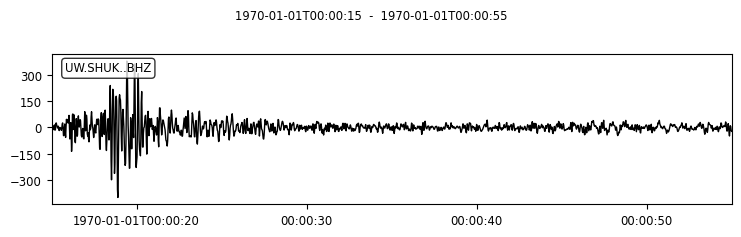

---
shukbhzrpba019 template original stream:


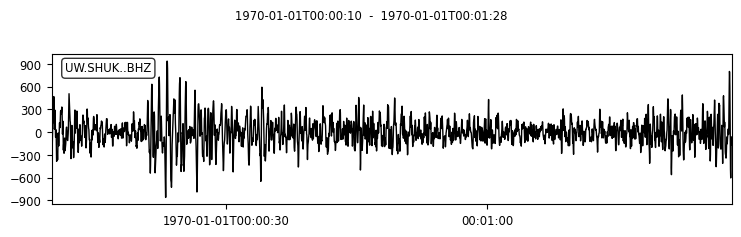

number of windows: 38
maximum amp window index: 0
Max Window:


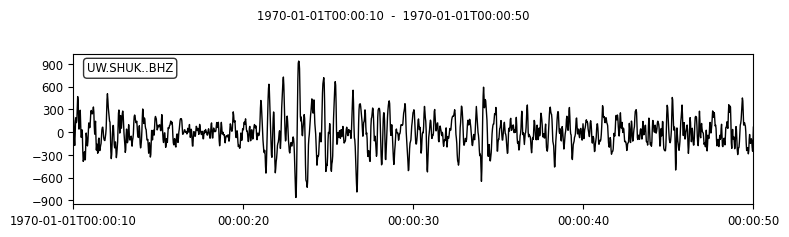

---
shukbhzrpba020 template original stream:


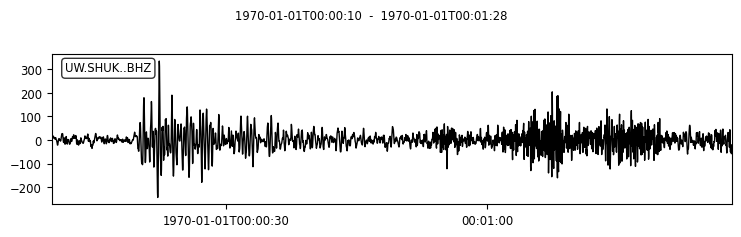

number of windows: 38
maximum amp window index: 9
Max Window:


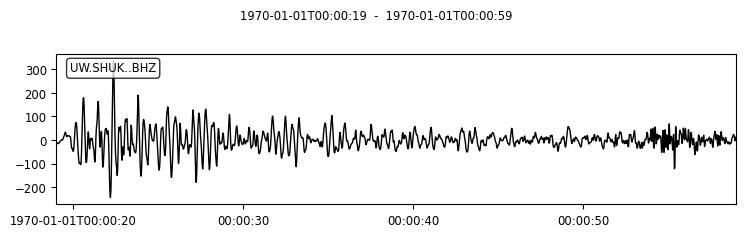

---
shukbhzrpba021 template original stream:


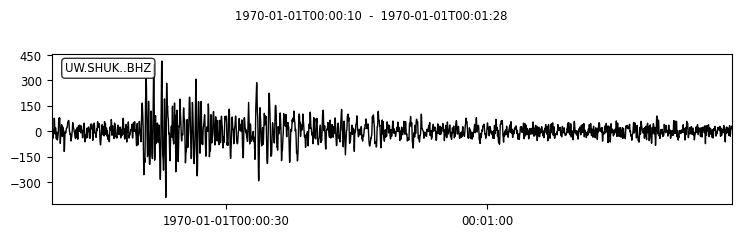

number of windows: 38
maximum amp window index: 3
Max Window:


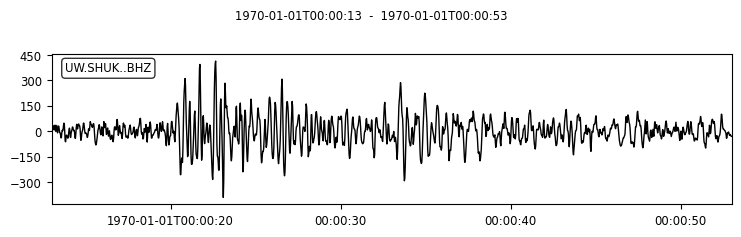

---
shukbhzrpba023 template original stream:


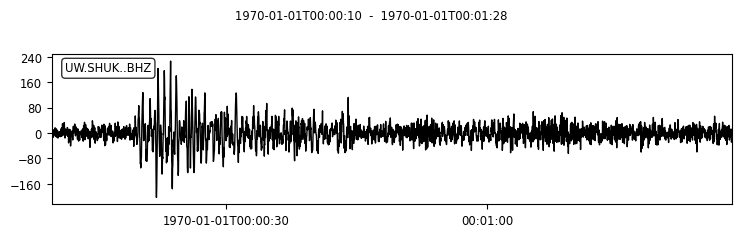

number of windows: 38
maximum amp window index: 9
Max Window:


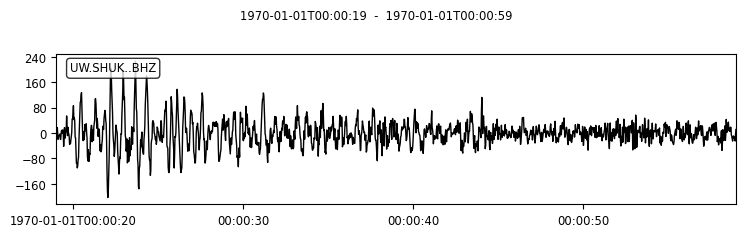

---
shukbhzrpba024 template original stream:


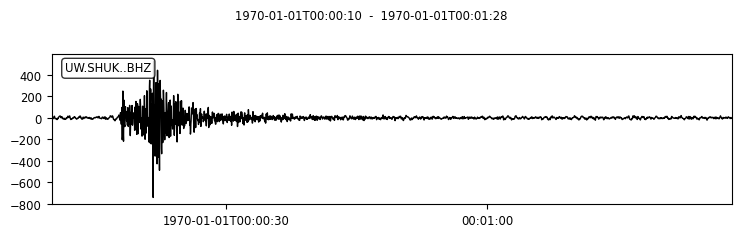

number of windows: 38
maximum amp window index: 2
Max Window:


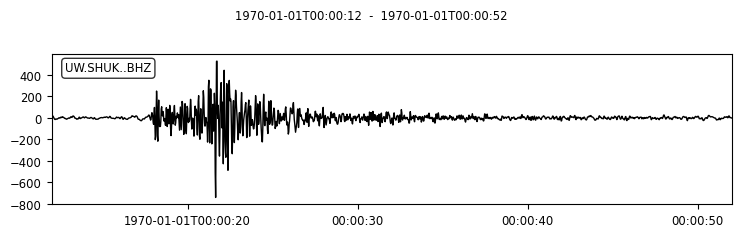

---
shukbhzrpba025 template original stream:


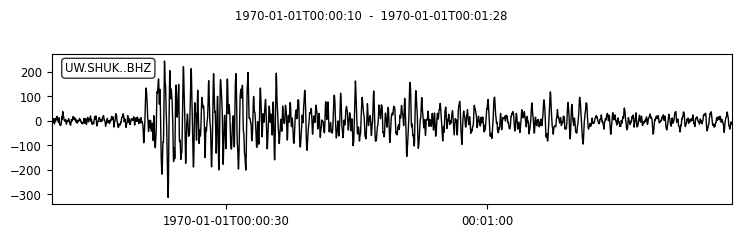

number of windows: 38
maximum amp window index: 11
Max Window:


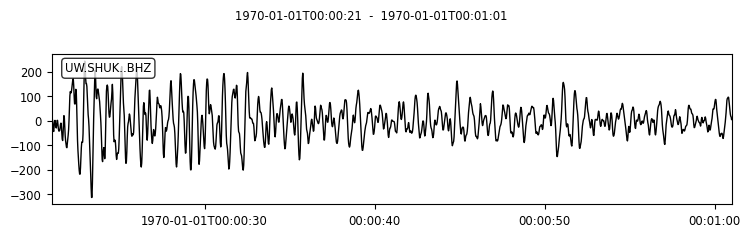

---
shukbhzrpba027 template original stream:


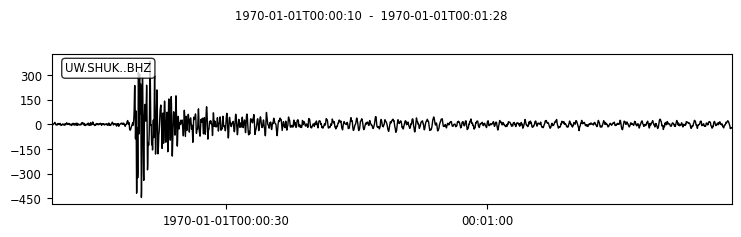

number of windows: 38
maximum amp window index: 9
Max Window:


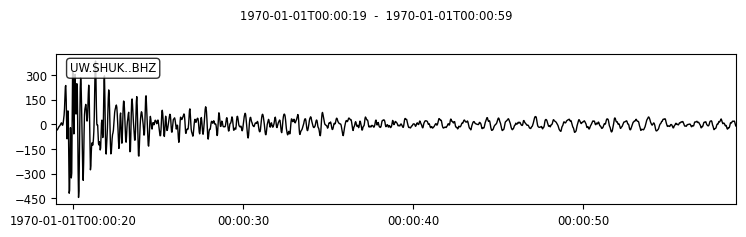

---
shukbhzrpba029 template original stream:


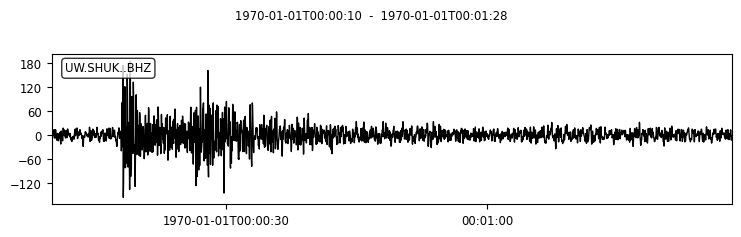

number of windows: 38
maximum amp window index: 7
Max Window:


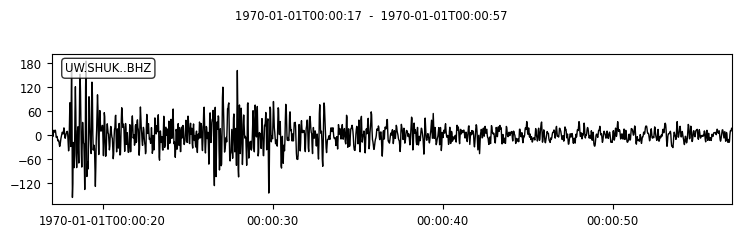

---
shukbhzrpba030 template original stream:


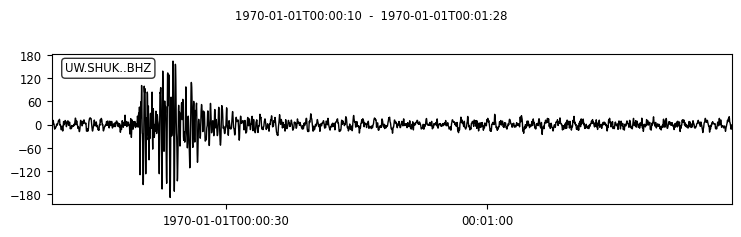

number of windows: 38
maximum amp window index: 0
Max Window:


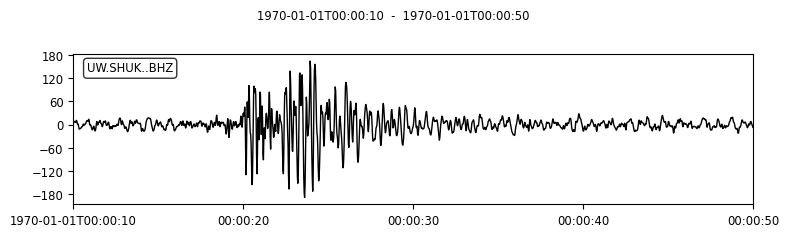

---
shukbhzrpba031 template original stream:


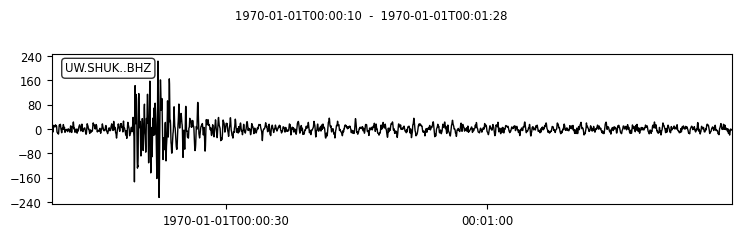

number of windows: 38
maximum amp window index: 7
Max Window:


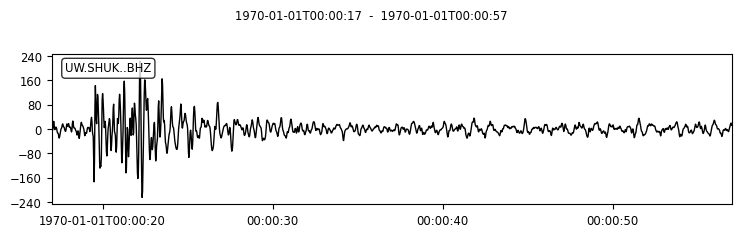

---
shukbhzrpba032 template original stream:


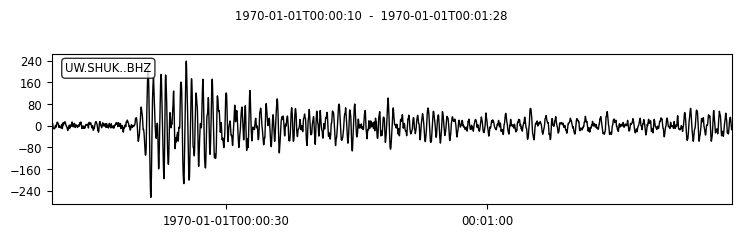

number of windows: 38
maximum amp window index: 10
Max Window:


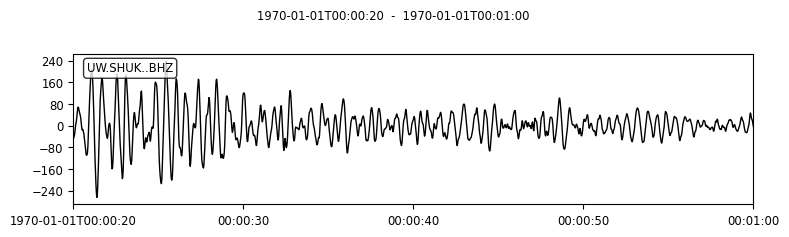

---
shukbhzrpba043 template original stream:


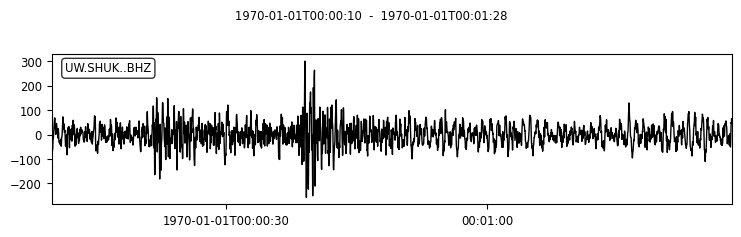

number of windows: 38
maximum amp window index: 11
Max Window:


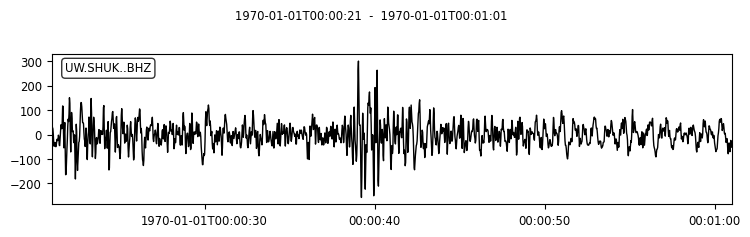

---
shukbhzrpba044 template original stream:


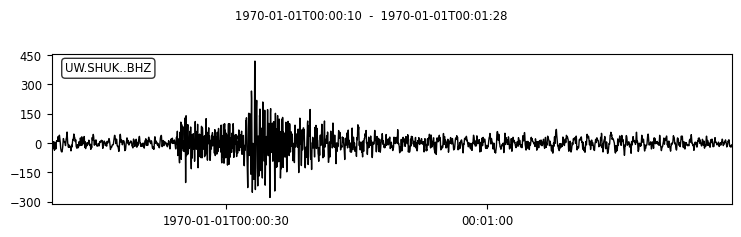

number of windows: 38
maximum amp window index: 14
Max Window:


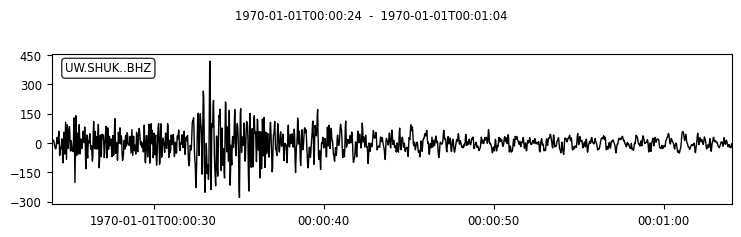

---
shukbhzrpba045 template original stream:


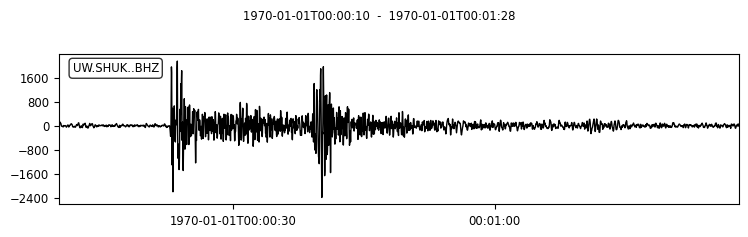

number of windows: 38
maximum amp window index: 12
Max Window:


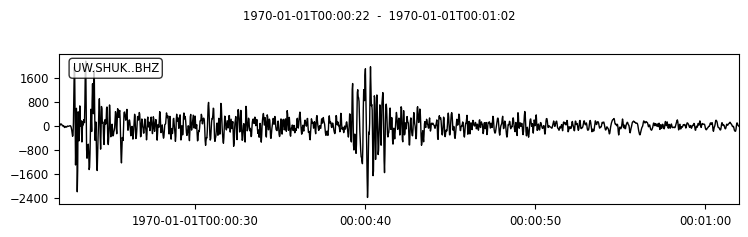

---
shukbhzrpba049 template original stream:


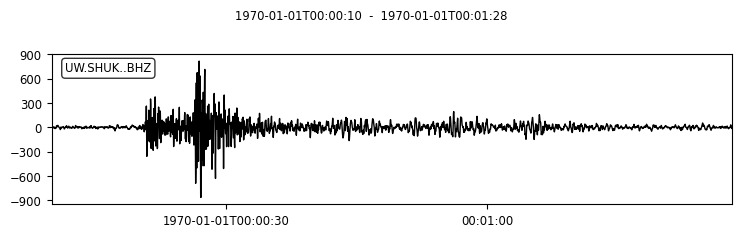

number of windows: 38
maximum amp window index: 10
Max Window:


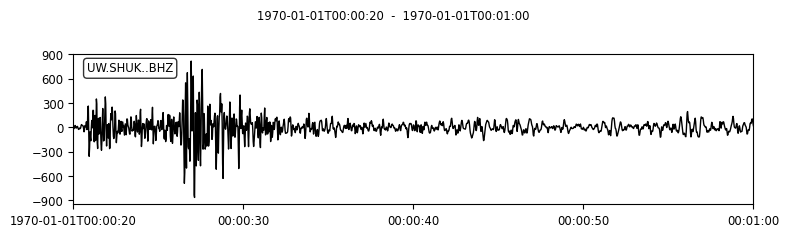

---
shukbhzrpba051 template original stream:


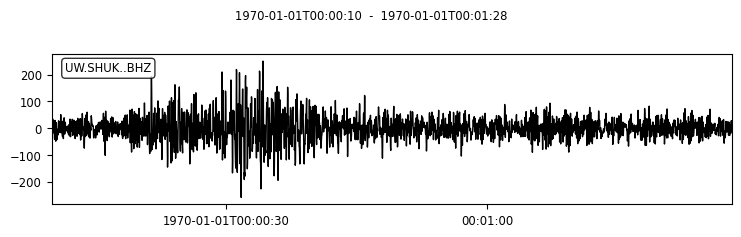

number of windows: 38
maximum amp window index: 8
Max Window:


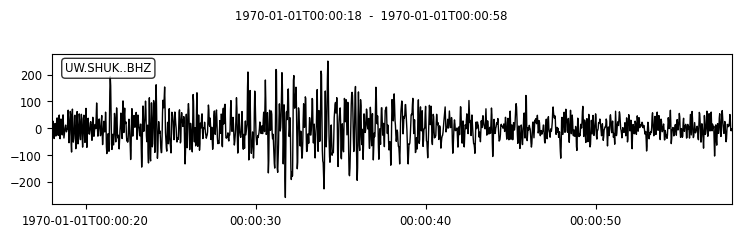

---
shukbhzrpba053 template original stream:


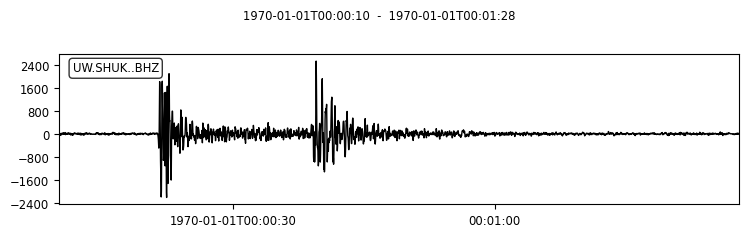

number of windows: 38
maximum amp window index: 11
Max Window:


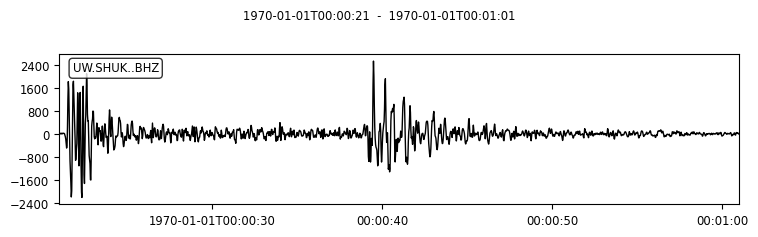

---
shukbhzrpba055 template original stream:


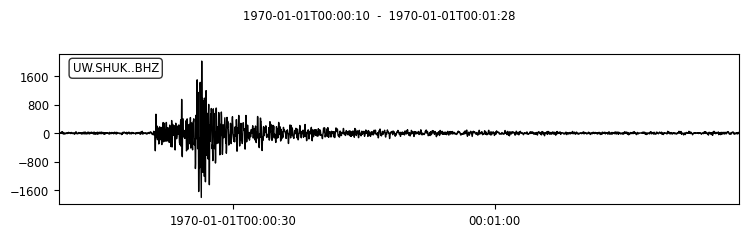

number of windows: 38
maximum amp window index: 11
Max Window:


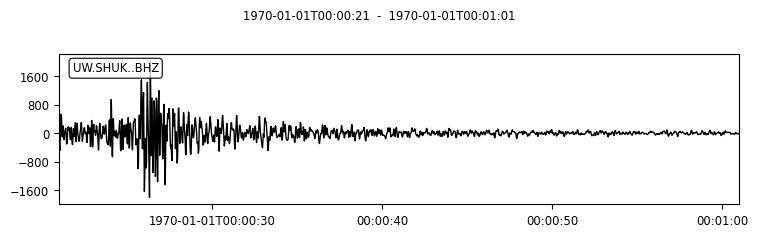

---
shukbhzrpba056 template original stream:


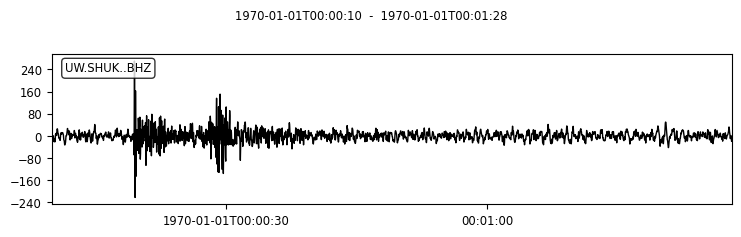

number of windows: 38
maximum amp window index: 0
Max Window:


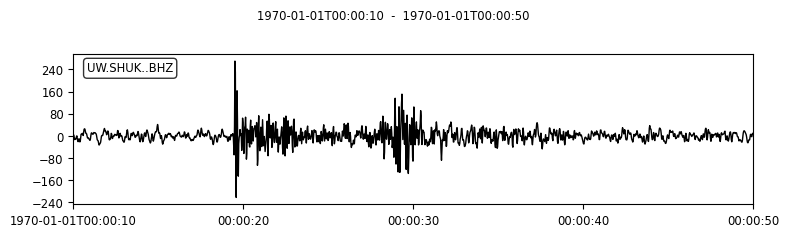

---
shukbhzrpba057 template original stream:


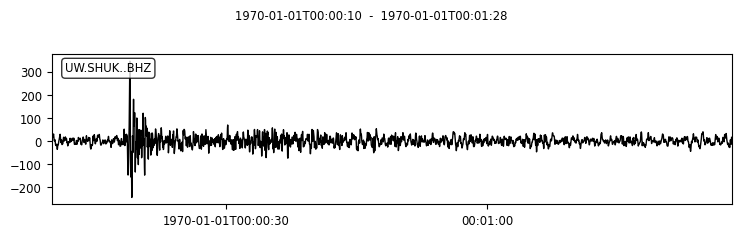

number of windows: 38
maximum amp window index: 8
Max Window:


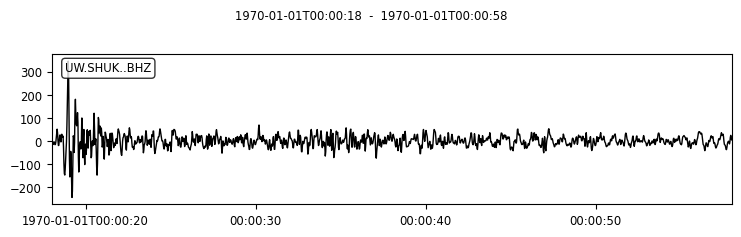

---
shukbhzrpba058 template original stream:


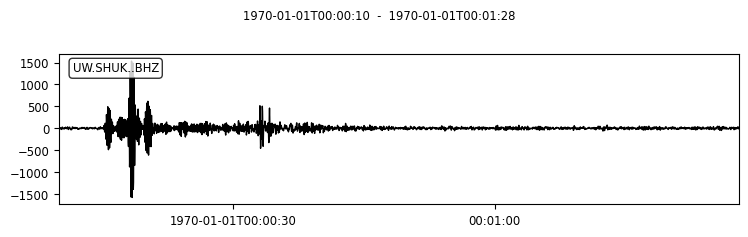

number of windows: 38
maximum amp window index: 5
Max Window:


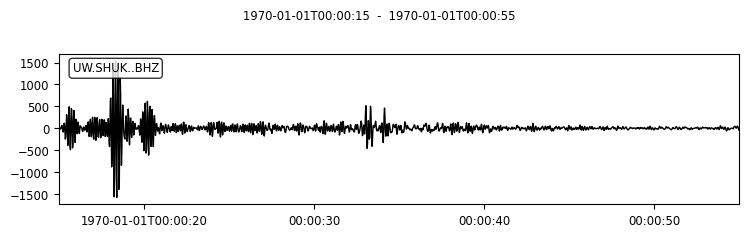

---
shukbhzrpba059 template original stream:


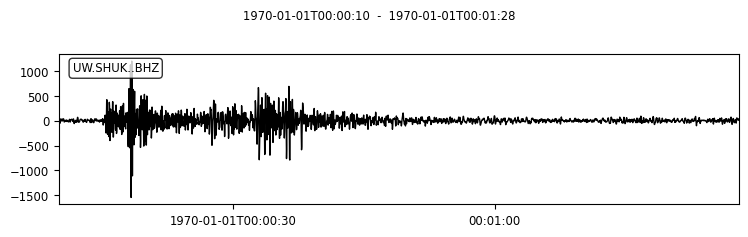

number of windows: 38
maximum amp window index: 5
Max Window:


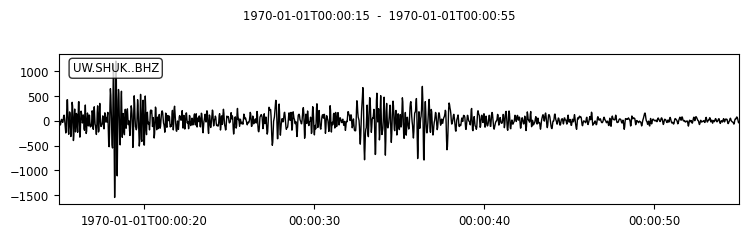

---
shukbhzrpba060 template original stream:


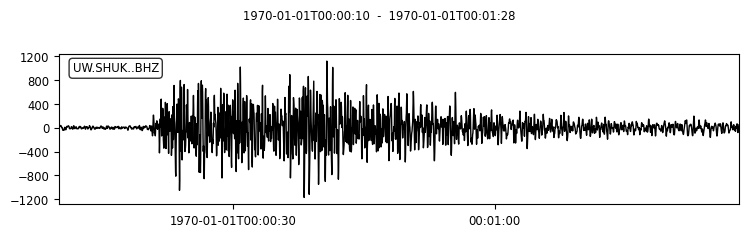

number of windows: 38
maximum amp window index: 11
Max Window:


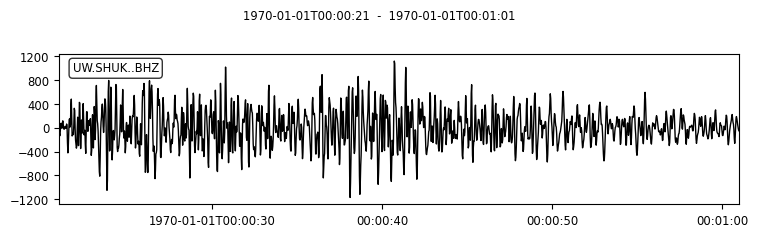

---
shukbhzrpba061 template original stream:


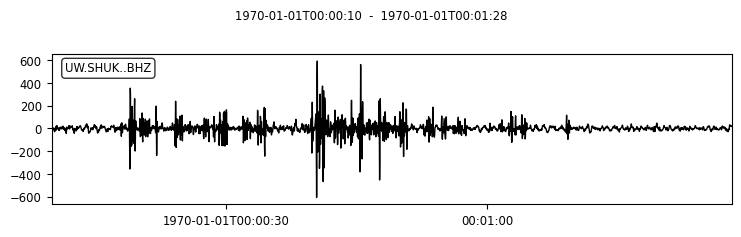

number of windows: 38
maximum amp window index: 8
Max Window:


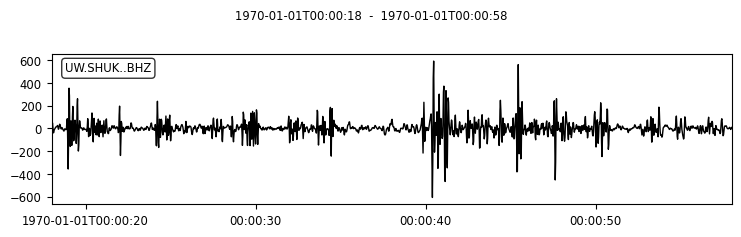

---
shukbhzrpba063 template original stream:


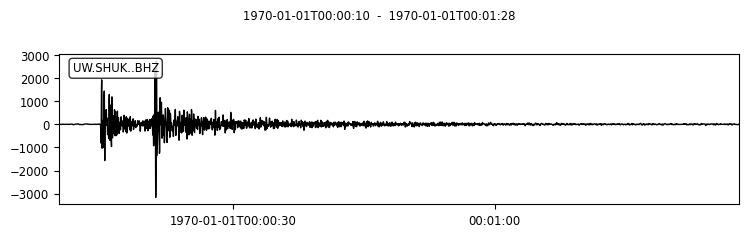

number of windows: 38
maximum amp window index: 4
Max Window:


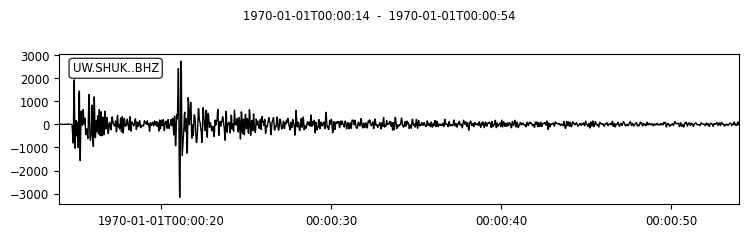

---
shukbhzrpba064 template original stream:


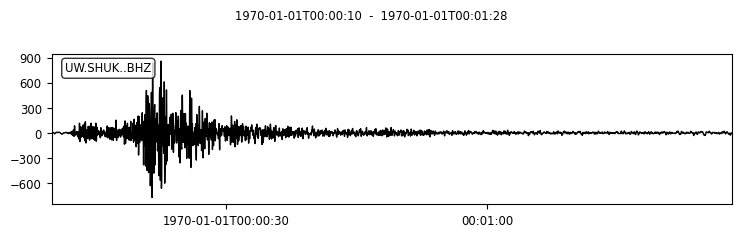

number of windows: 38
maximum amp window index: 2
Max Window:


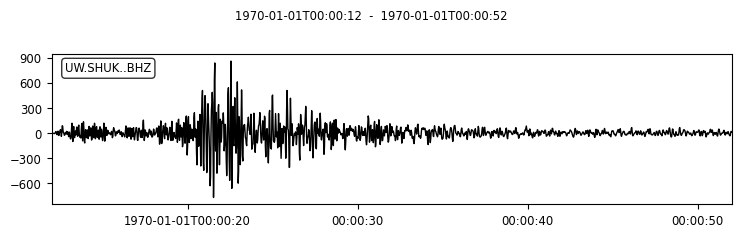

---
shukbhzrpba065 template original stream:


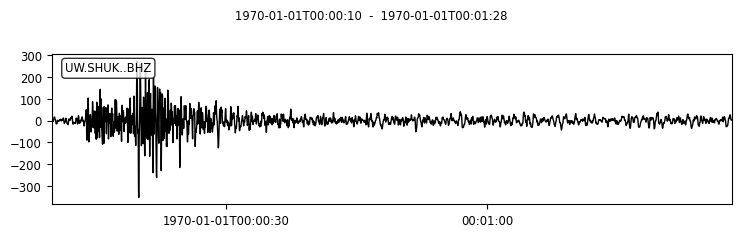

number of windows: 38
maximum amp window index: 4
Max Window:


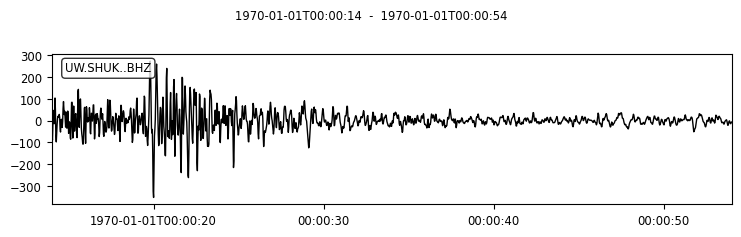

---
shukbhzrpba067 template original stream:


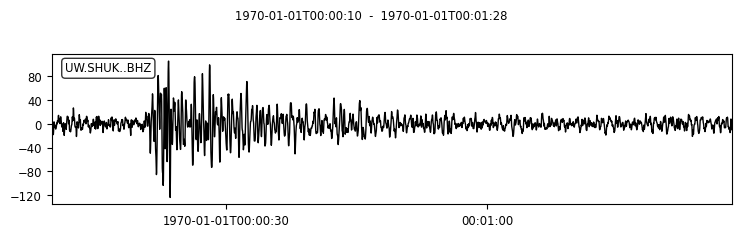

number of windows: 38
maximum amp window index: 9
Max Window:


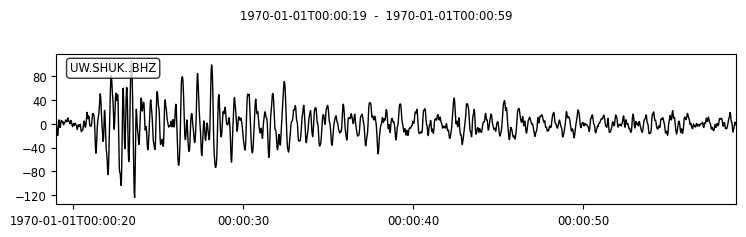

---
shukbhzrpba068 template original stream:


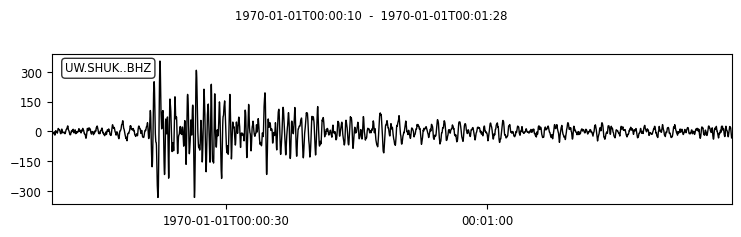

number of windows: 38
maximum amp window index: 8
Max Window:


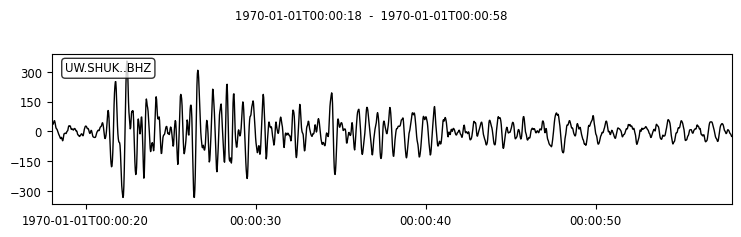

---
shukbhzrpba069 template original stream:


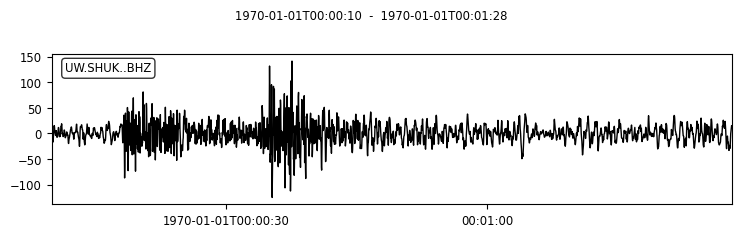

number of windows: 38
maximum amp window index: 8
Max Window:


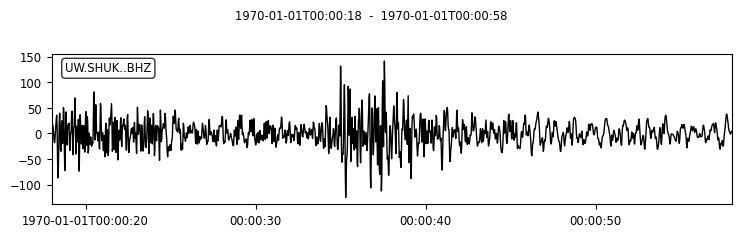

---
shukbhzrpba070 template original stream:


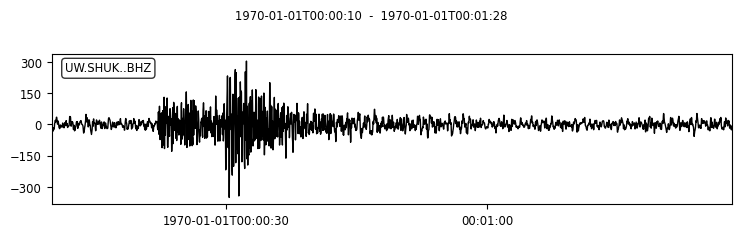

number of windows: 38
maximum amp window index: 8
Max Window:


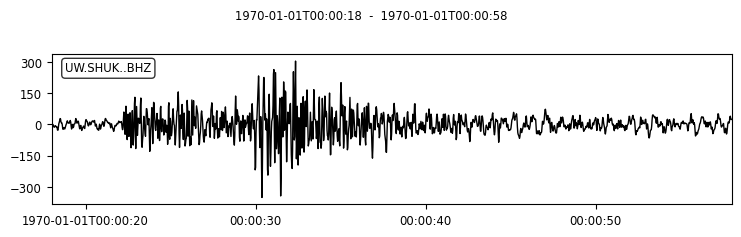

---
shukbhzrpba071 template original stream:


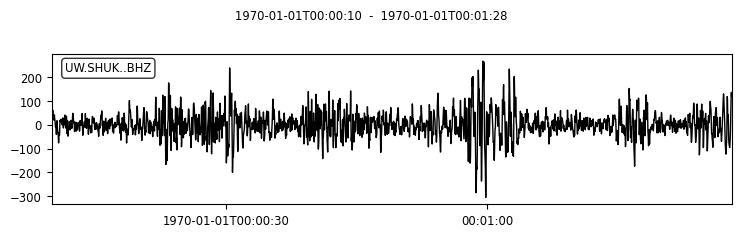

number of windows: 38
maximum amp window index: 13
Max Window:


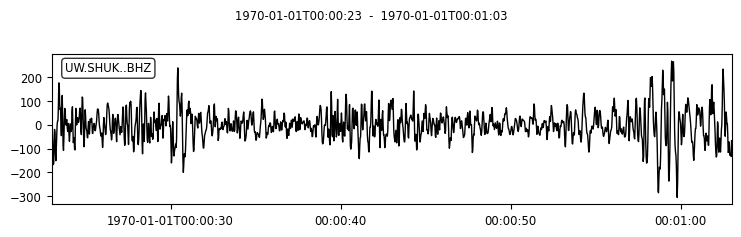

---
shukbhzrpba074 template original stream:


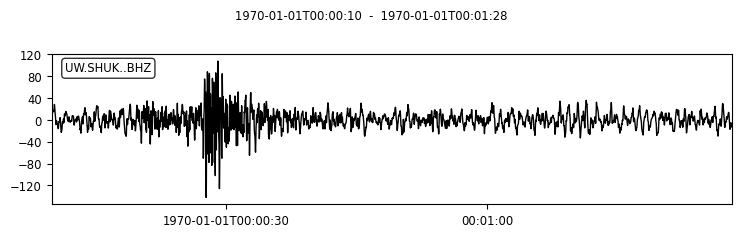

number of windows: 38
maximum amp window index: 1
Max Window:


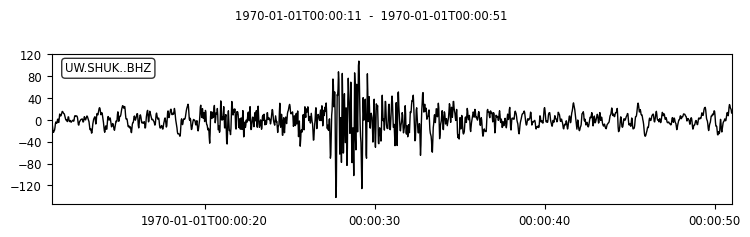

---
shukbhzrpba075 template original stream:


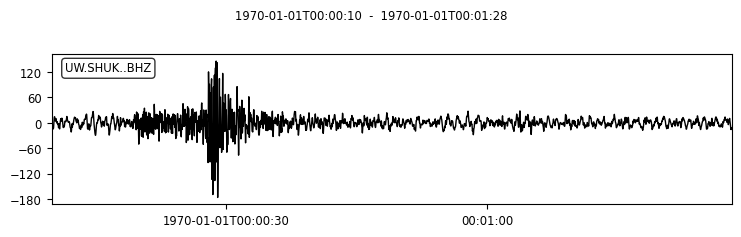

number of windows: 38
maximum amp window index: 0
Max Window:


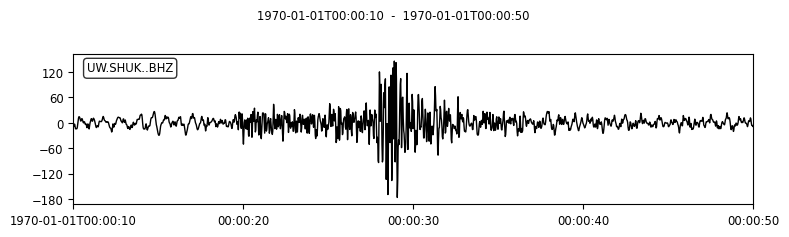

---
shukbhzrpba076 template original stream:


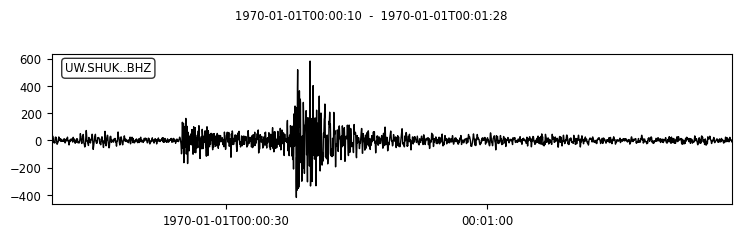

number of windows: 38
maximum amp window index: 14
Max Window:


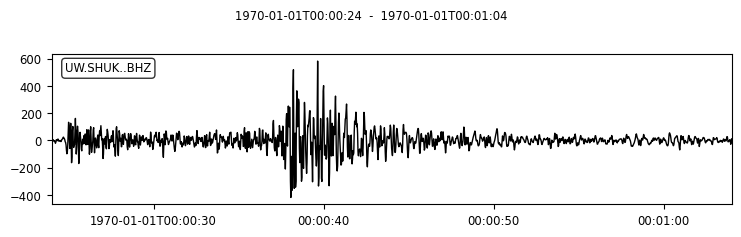

---
shukbhzrpba077 template original stream:


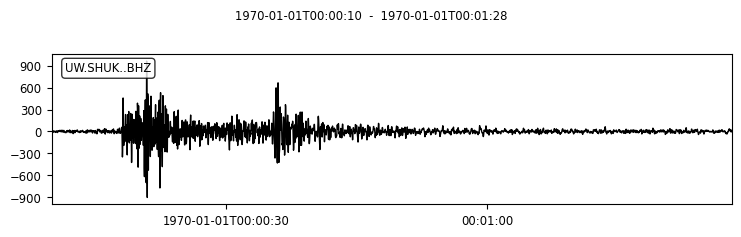

number of windows: 38
maximum amp window index: 7
Max Window:


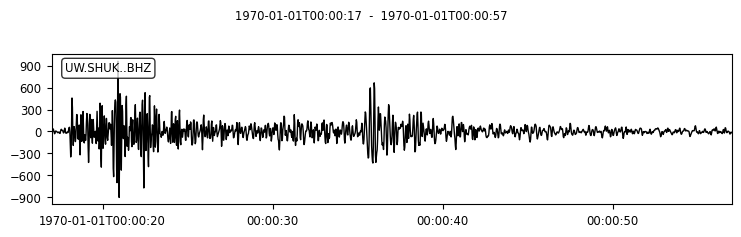

---
shukbhzrpba078 template original stream:


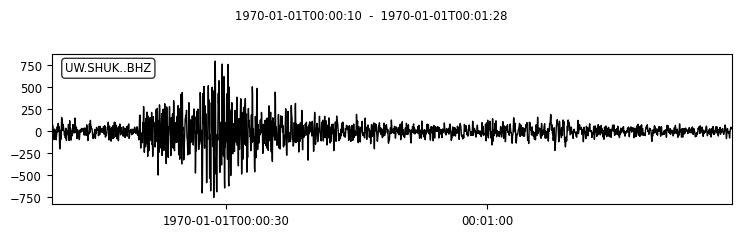

number of windows: 38
maximum amp window index: 0
Max Window:


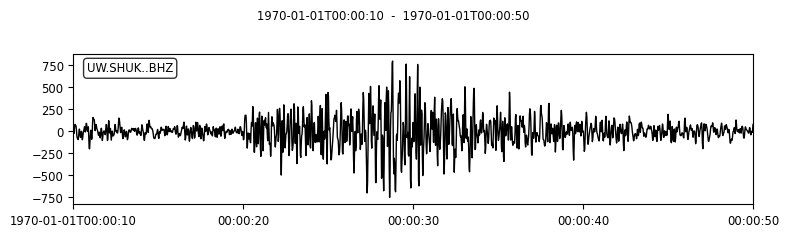

---
shukbhzrpba079 template original stream:


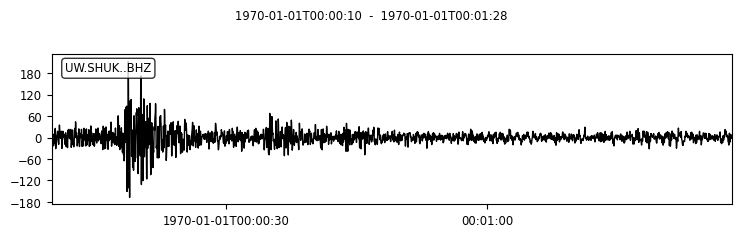

number of windows: 38
maximum amp window index: 0
Max Window:


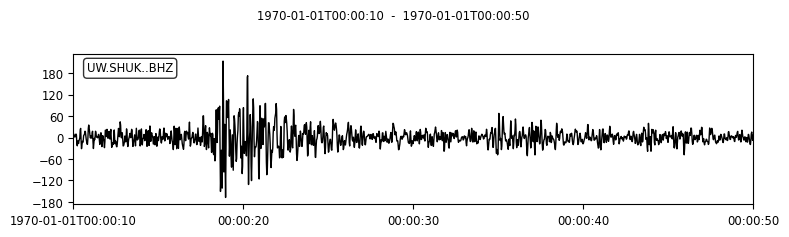

---
shukbhzrpba080 template original stream:


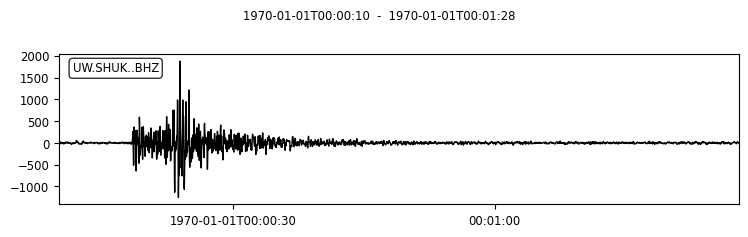

number of windows: 38
maximum amp window index: 8
Max Window:


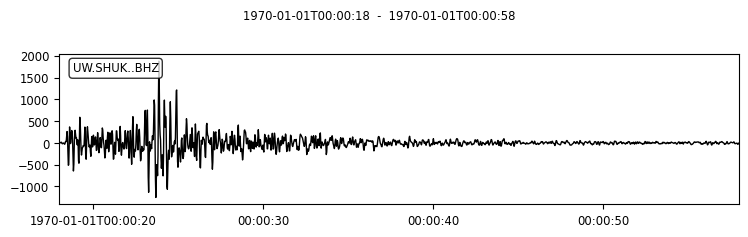

---
shukbhzrpba081 template original stream:


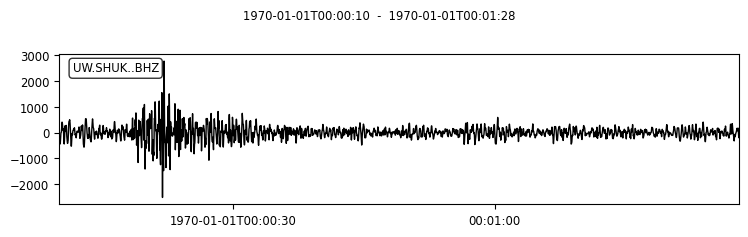

number of windows: 38
maximum amp window index: 0
Max Window:


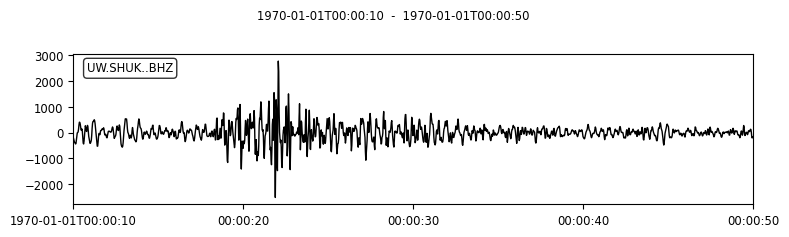

---
shukbhzrpba083 template original stream:


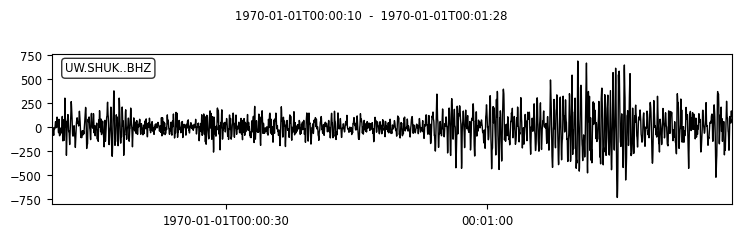

number of windows: 38
maximum amp window index: 38
Max Window:


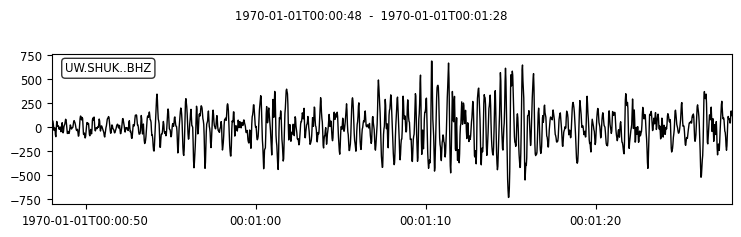

---
shukbhzrpba085 template original stream:


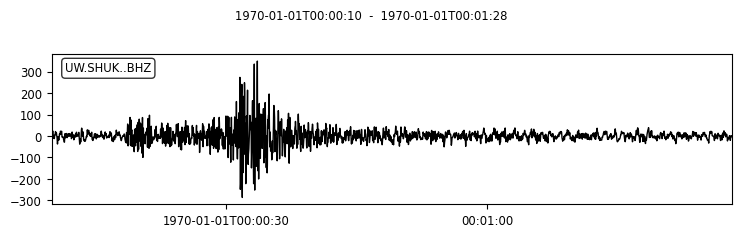

number of windows: 38
maximum amp window index: 6
Max Window:


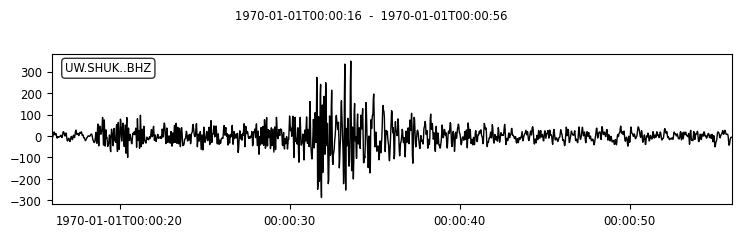

---
shukbhzrpba087 template original stream:


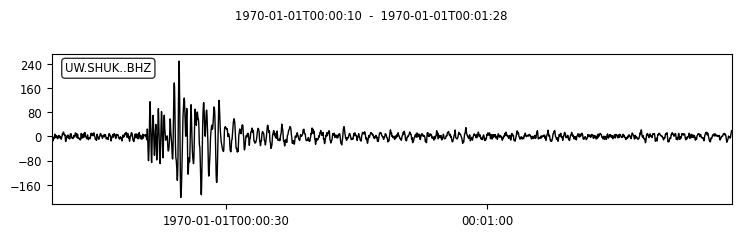

number of windows: 38
maximum amp window index: 8
Max Window:


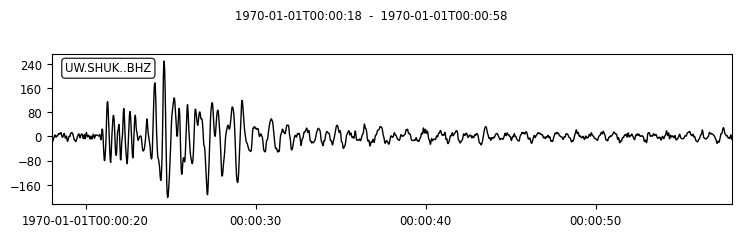

---
shukbhzrpba089 template original stream:


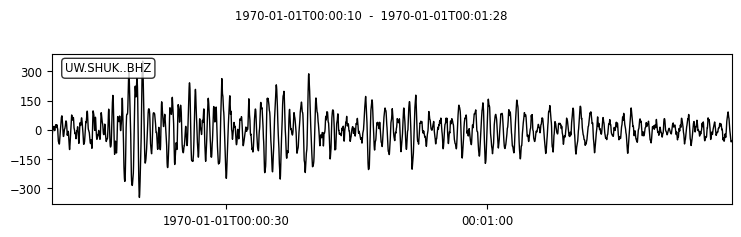

number of windows: 38
maximum amp window index: 2
Max Window:


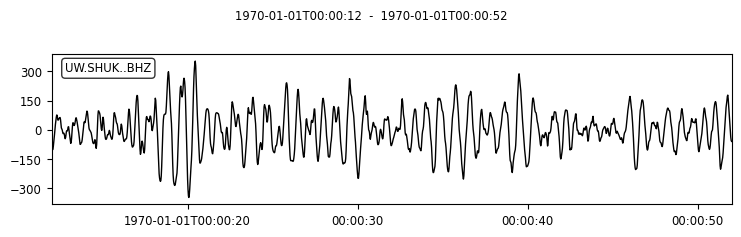

---
shukbhzrpba090 template original stream:


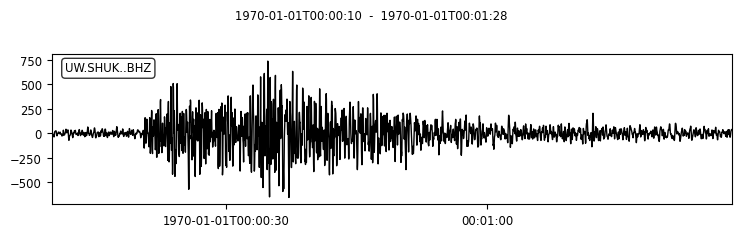

number of windows: 38
maximum amp window index: 11
Max Window:


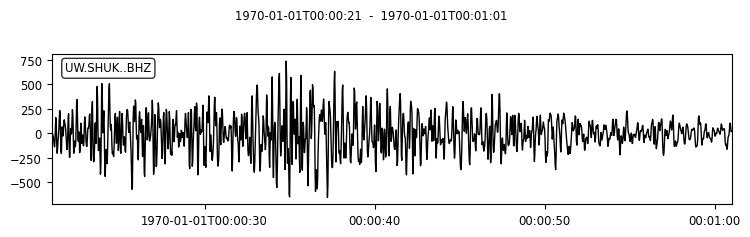

---
shukbhzrpba091 template original stream:


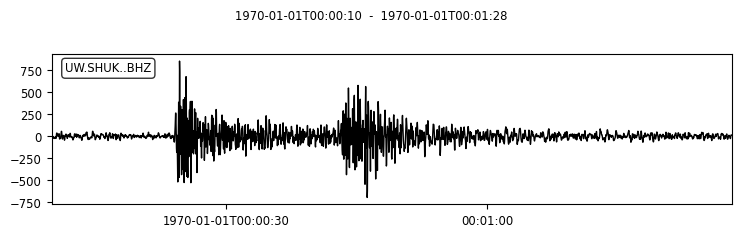

number of windows: 38
maximum amp window index: 14
Max Window:


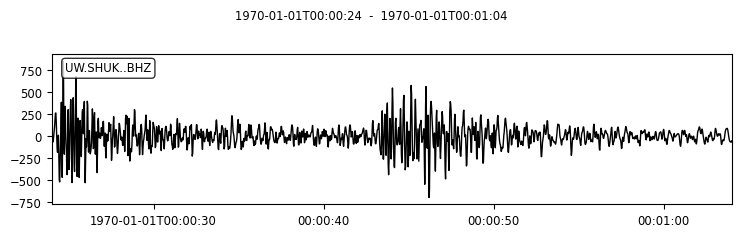

---
shukbhzrpba093 template original stream:


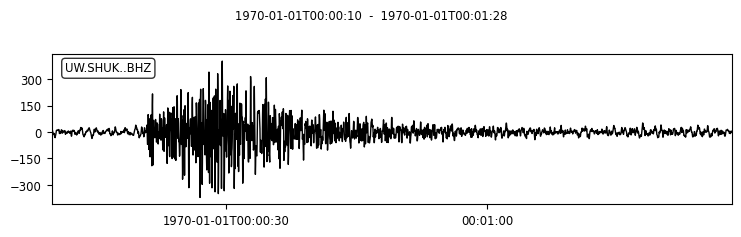

number of windows: 38
maximum amp window index: 9
Max Window:


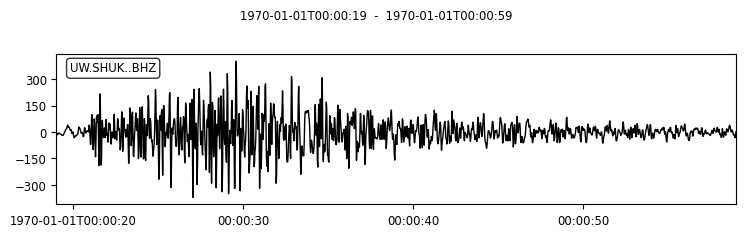

---
shukbhzrpba095 template original stream:


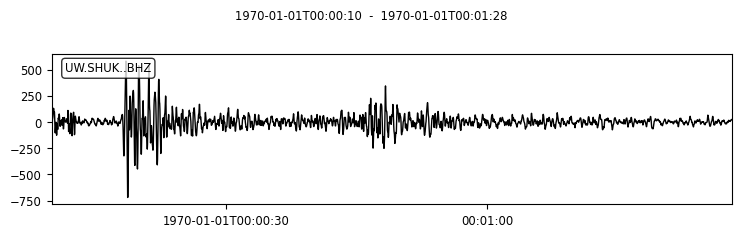

number of windows: 38
maximum amp window index: 8
Max Window:


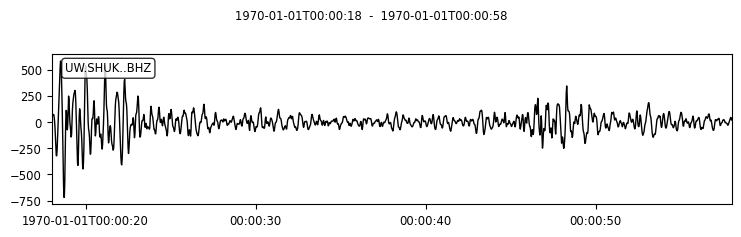

---
shukbhzrpba097 template original stream:


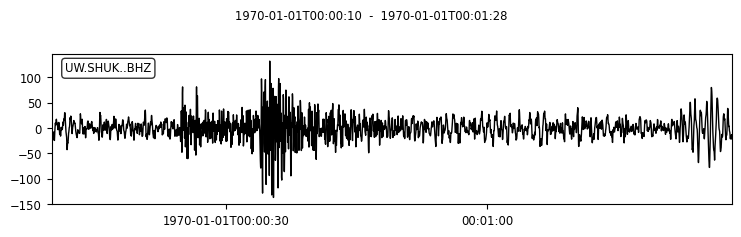

number of windows: 38
maximum amp window index: 13
Max Window:


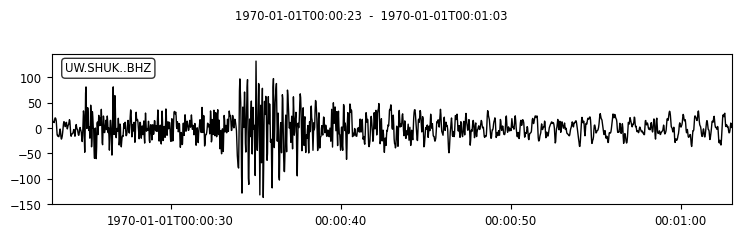

---
shukbhzrpba098 template original stream:


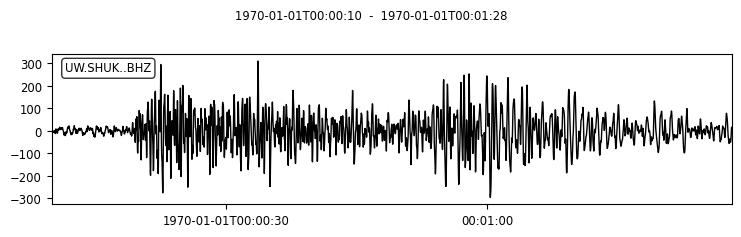

number of windows: 38
maximum amp window index: 11
Max Window:


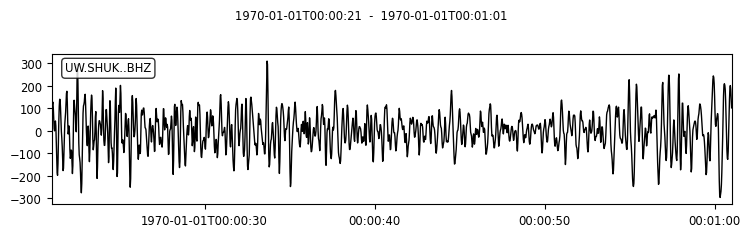

---
shukbhzrpba100 template original stream:


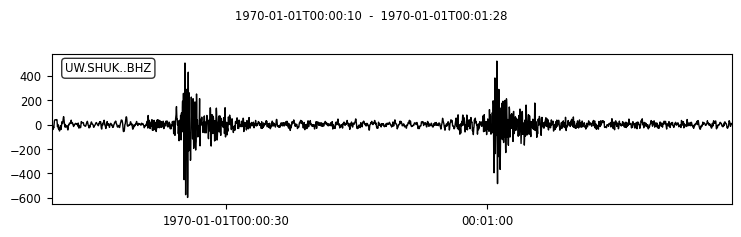

number of windows: 38
maximum amp window index: 15
Max Window:


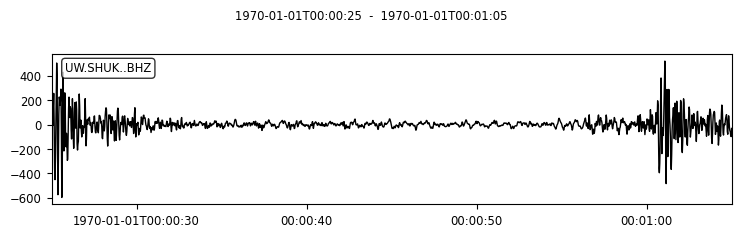

---
shukbhzrpba101 template original stream:


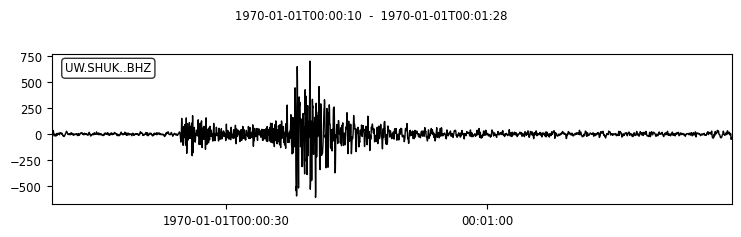

number of windows: 38
maximum amp window index: 14
Max Window:


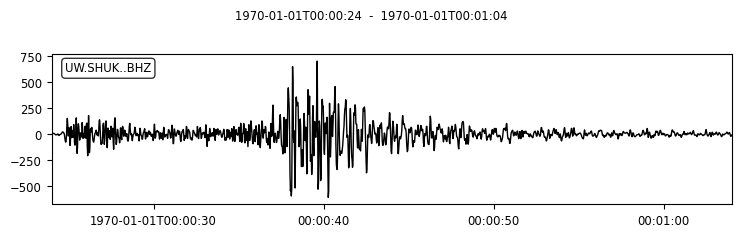

---
shukbhzrpba103 template original stream:


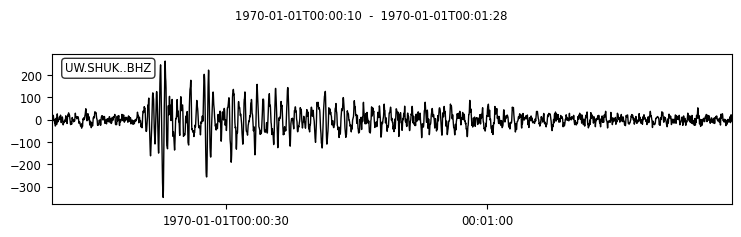

number of windows: 38
maximum amp window index: 11
Max Window:


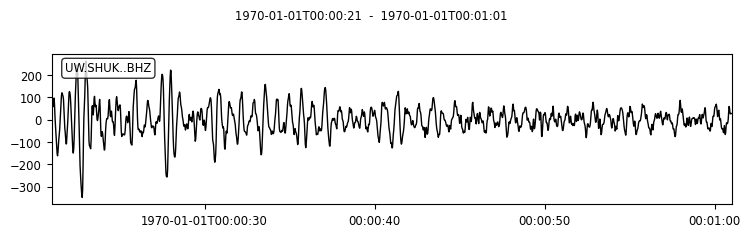

---
shukbhzrpba104 template original stream:


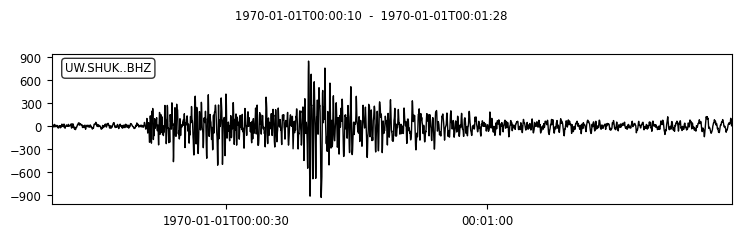

number of windows: 38
maximum amp window index: 11
Max Window:


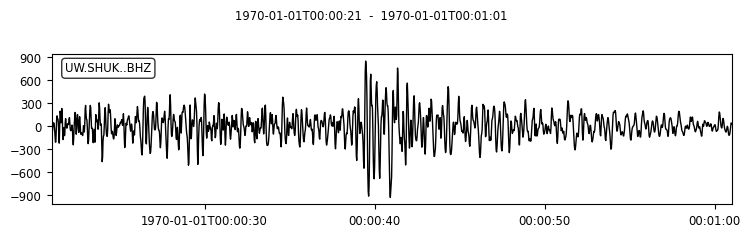

---
shukbhzrpba105 template original stream:


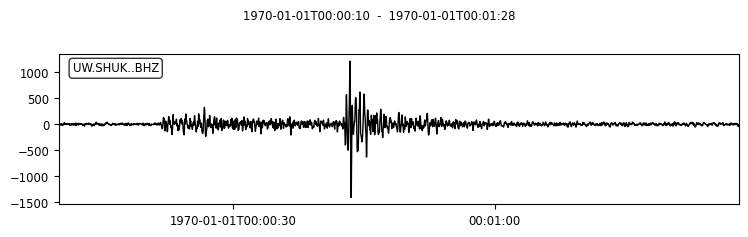

number of windows: 38
maximum amp window index: 11
Max Window:


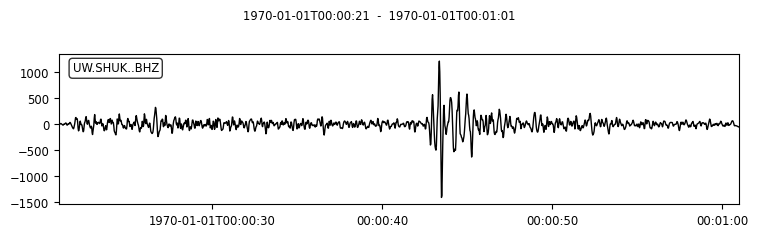

---
shukbhzrpba106 template original stream:


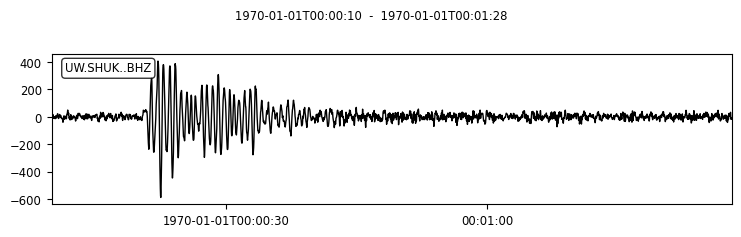

number of windows: 38
maximum amp window index: 10
Max Window:


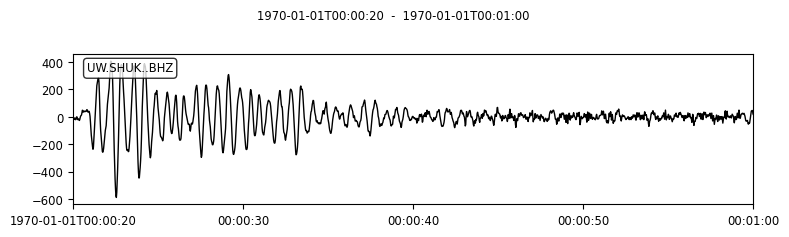

---
shukbhzrpba107 template original stream:


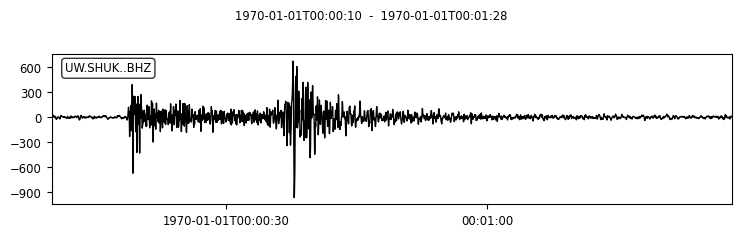

number of windows: 38
maximum amp window index: 8
Max Window:


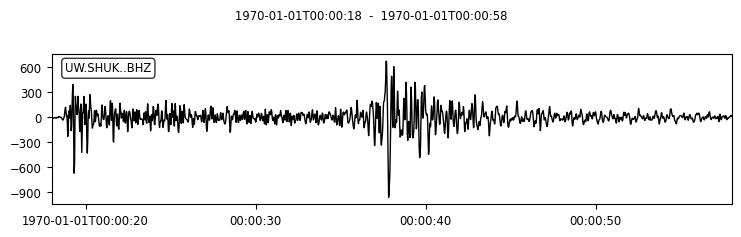

---
shukbhzrpba108 template original stream:


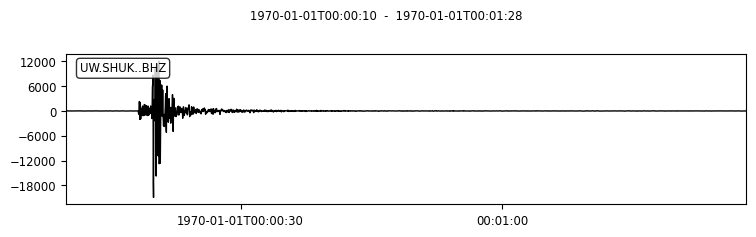

number of windows: 38
maximum amp window index: 8
Max Window:


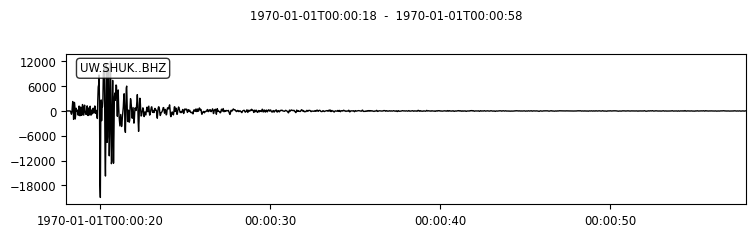

---
shukbhzrpba109 template original stream:


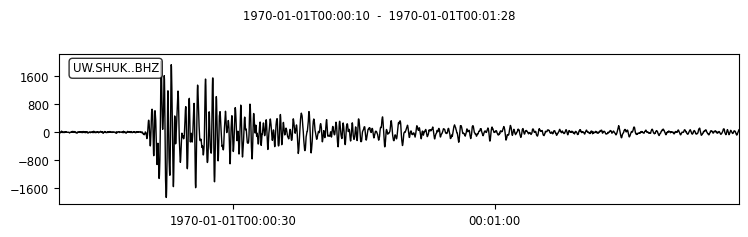

number of windows: 38
maximum amp window index: 10
Max Window:


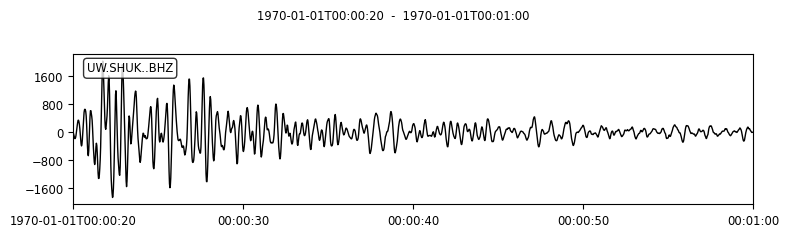

---
shukbhzrpba110 template original stream:


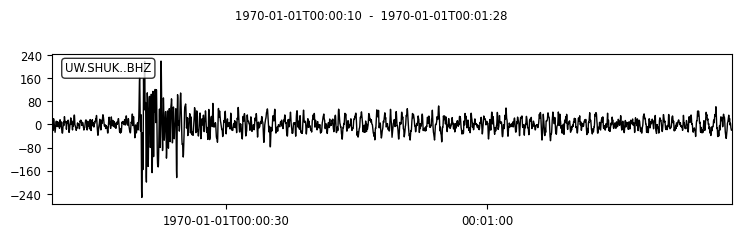

number of windows: 38
maximum amp window index: 9
Max Window:


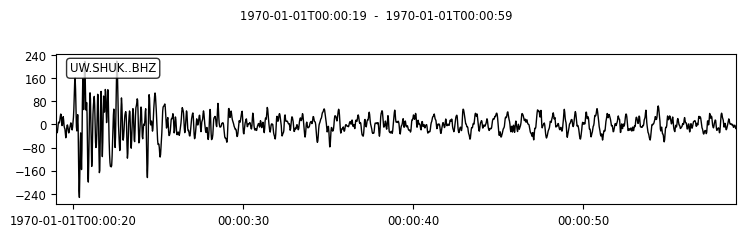

---
shukbhzrpba111 template original stream:


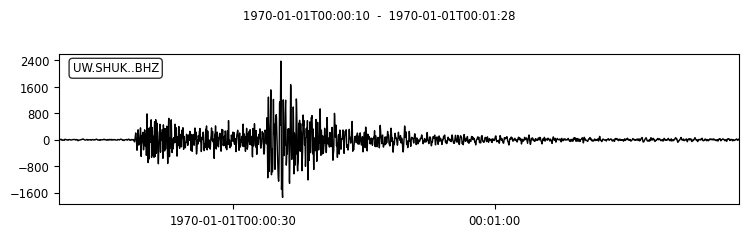

number of windows: 38
maximum amp window index: 9
Max Window:


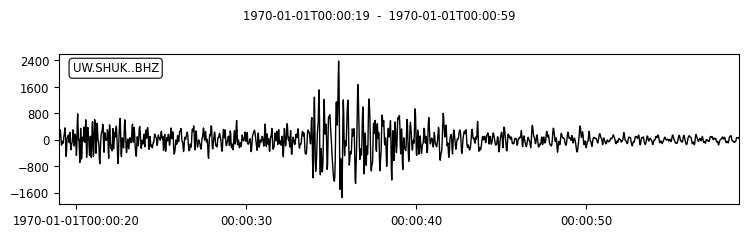

---
shukbhzrpba112 template original stream:


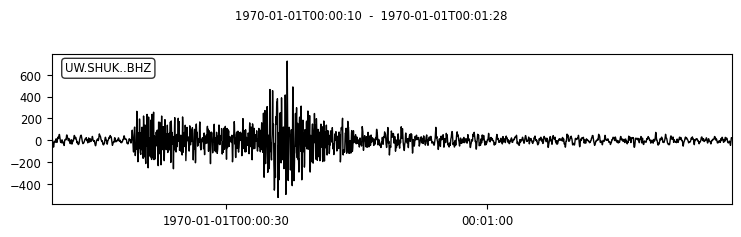

number of windows: 38
maximum amp window index: 9
Max Window:


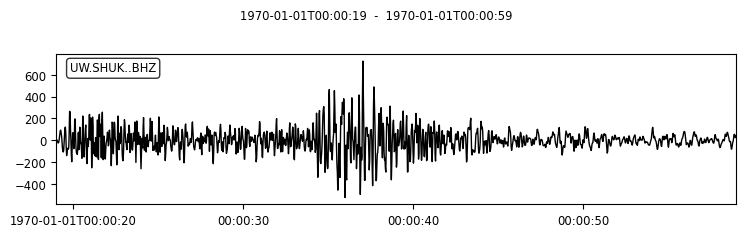

---
shukbhzrpba113 template original stream:


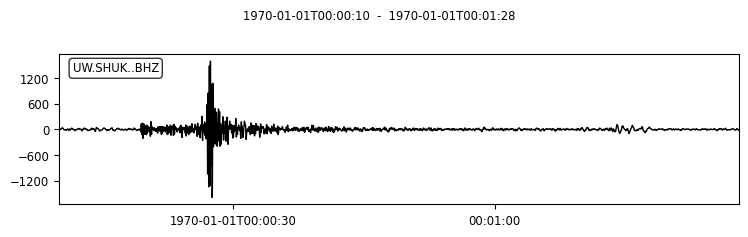

number of windows: 38
maximum amp window index: 3
Max Window:


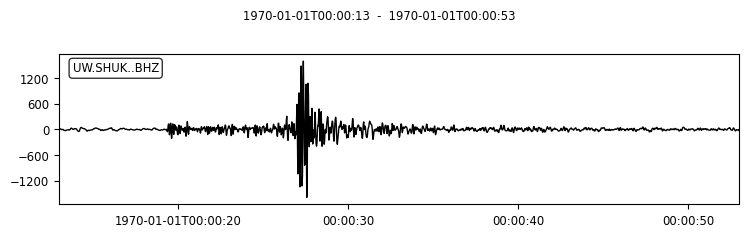

---
shukbhzrpba115 template original stream:


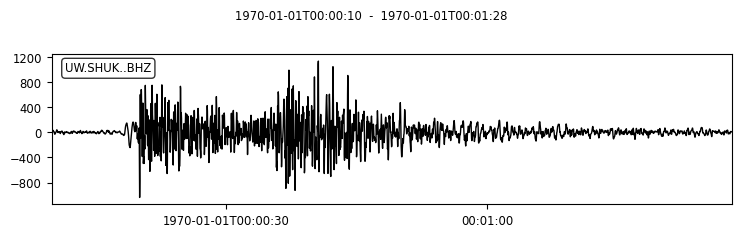

number of windows: 38
maximum amp window index: 9
Max Window:


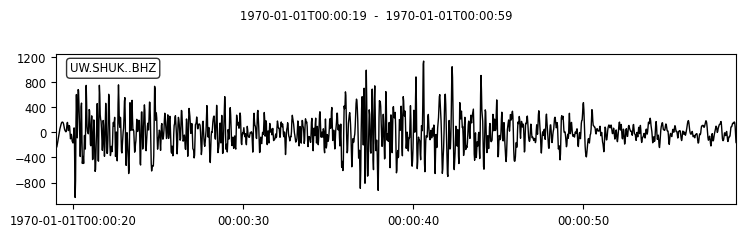

---
shukbhzrpba116 template original stream:


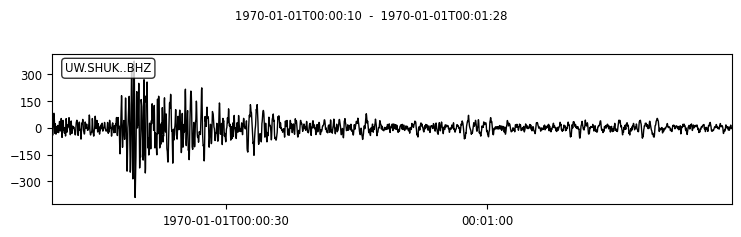

number of windows: 38
maximum amp window index: 0
Max Window:


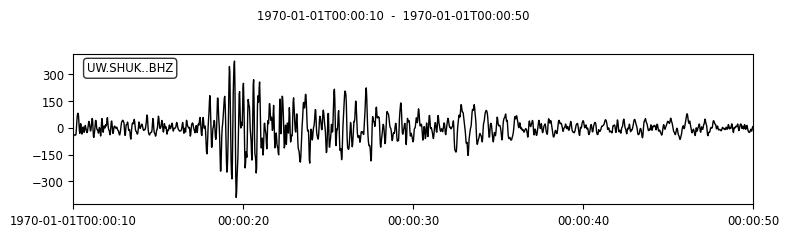

---
shukbhzrpba117 template original stream:


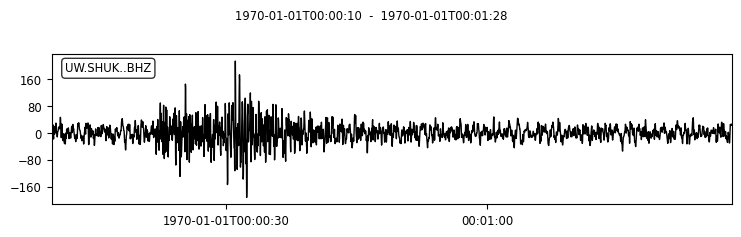

number of windows: 38
maximum amp window index: 8
Max Window:


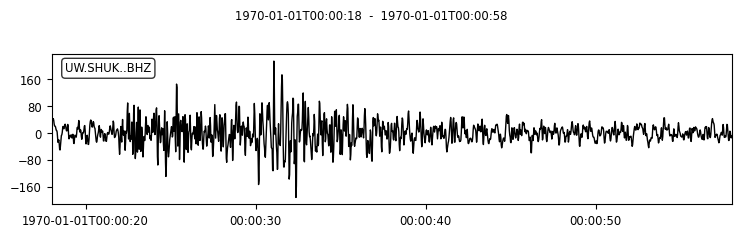

---
shukbhzrpba119 template original stream:


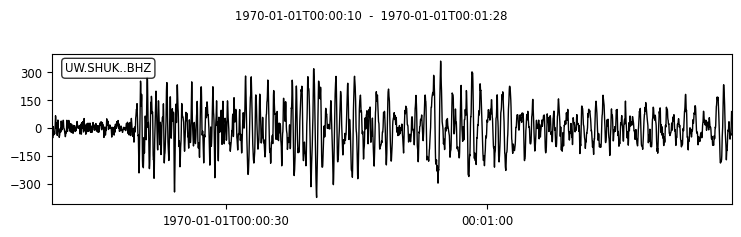

number of windows: 38
maximum amp window index: 10
Max Window:


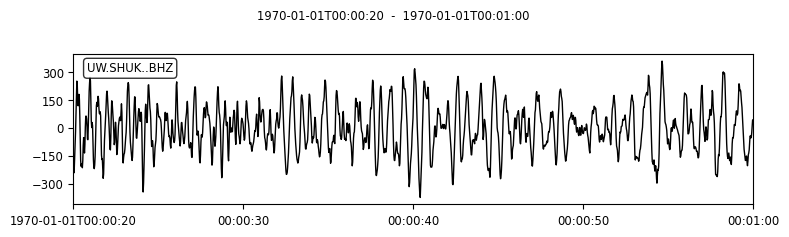

---
shukbhzrpba120 template original stream:


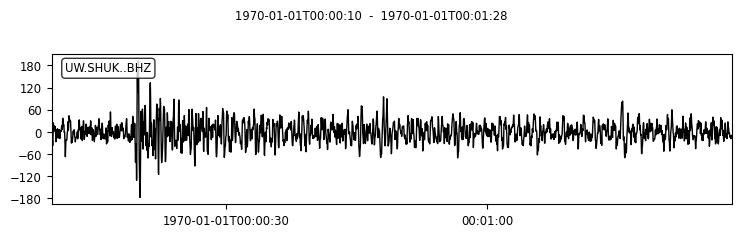

number of windows: 38
maximum amp window index: 8
Max Window:


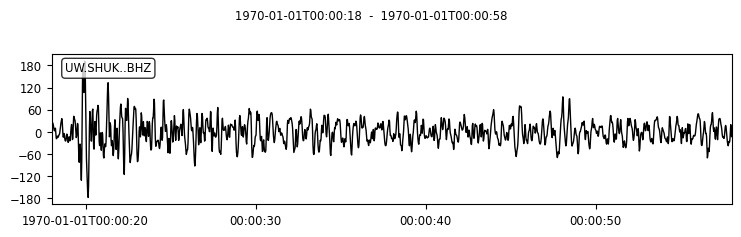

---
shukbhzrpba121 template original stream:


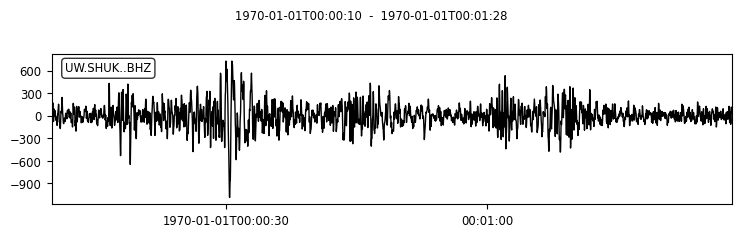

number of windows: 38
maximum amp window index: 5
Max Window:


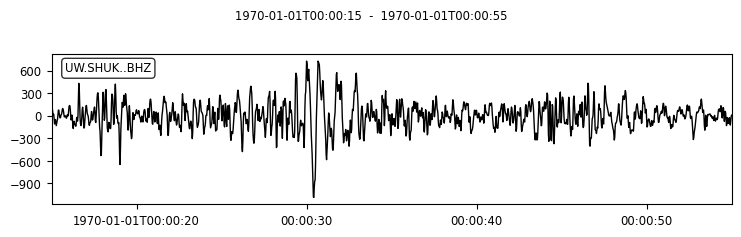

---
shukbhzrpba122 template original stream:


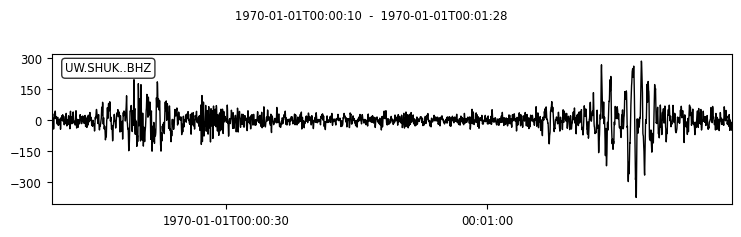

number of windows: 38
maximum amp window index: 38
Max Window:


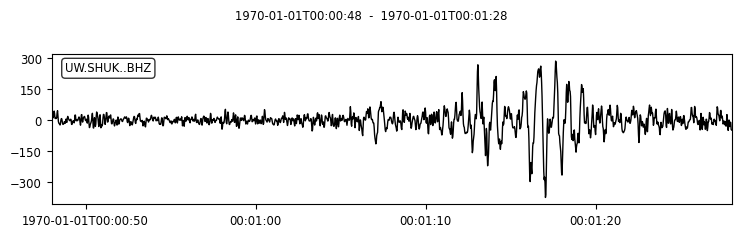

---
shukbhzrpba123 template original stream:


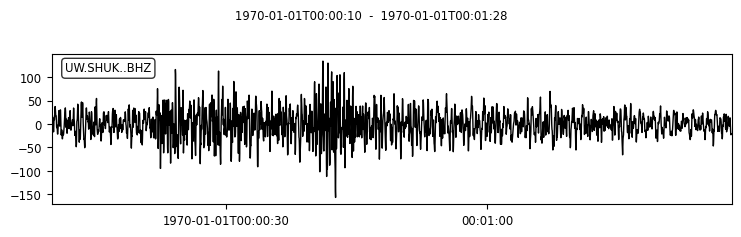

number of windows: 38
maximum amp window index: 12
Max Window:


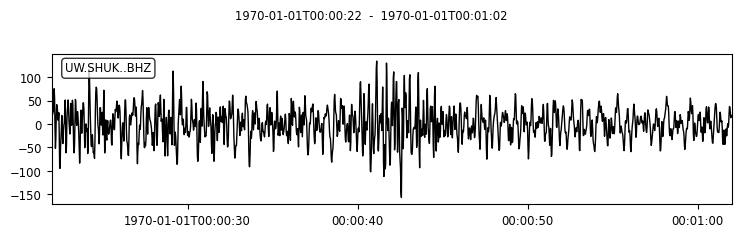

---
shukbhzrpba124 template original stream:


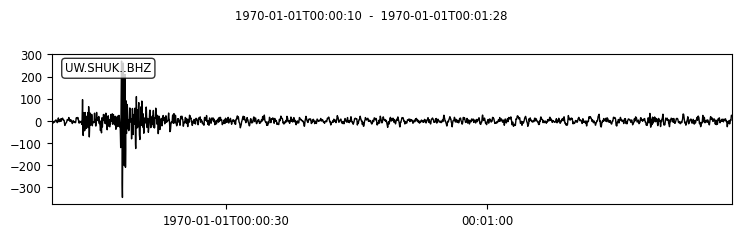

number of windows: 38
maximum amp window index: 1
Max Window:


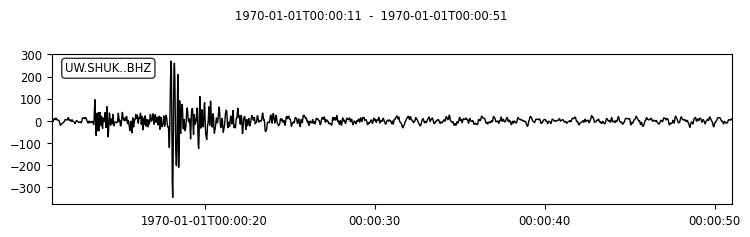

---
shukbhzrpba126 template original stream:


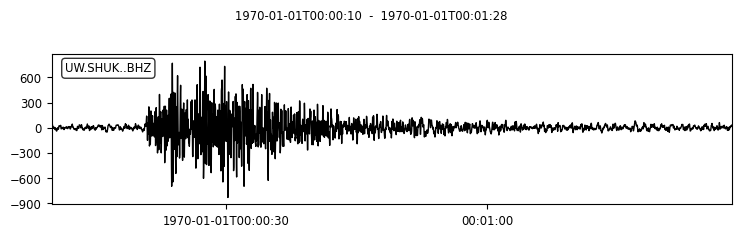

number of windows: 38
maximum amp window index: 11
Max Window:


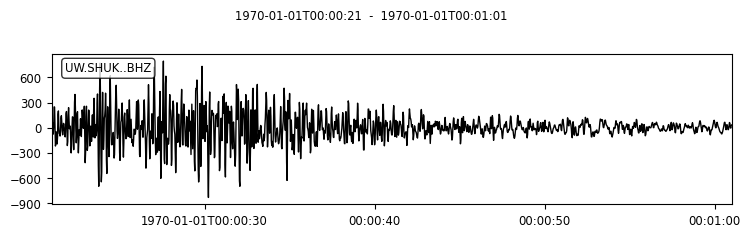

---
shukbhzrpba127 template original stream:


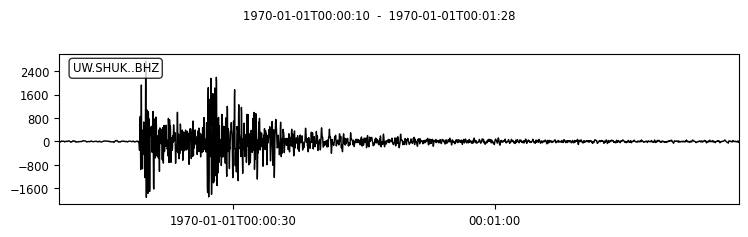

number of windows: 38
maximum amp window index: 9
Max Window:


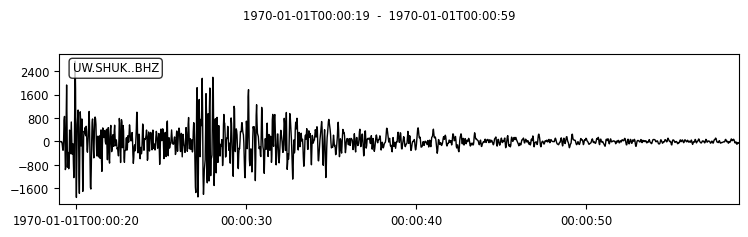

---
shukbhzrpba128 template original stream:


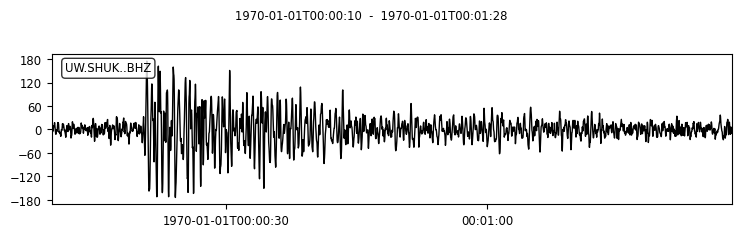

number of windows: 38
maximum amp window index: 10
Max Window:


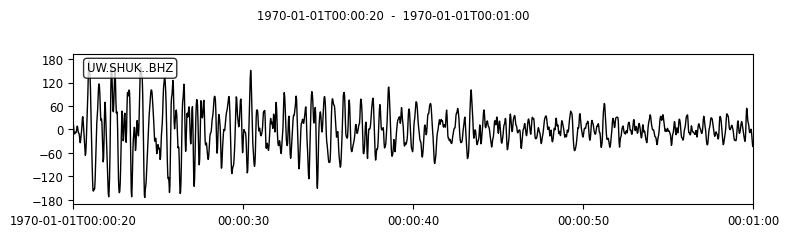

---
shukbhzrpba129 template original stream:


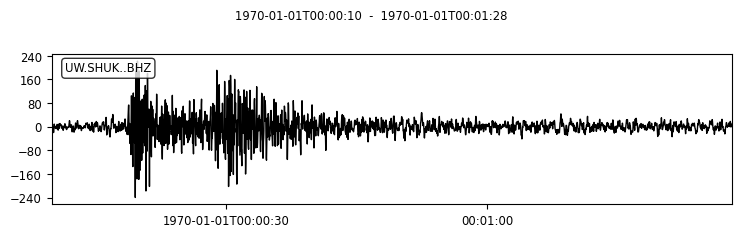

number of windows: 38
maximum amp window index: 6
Max Window:


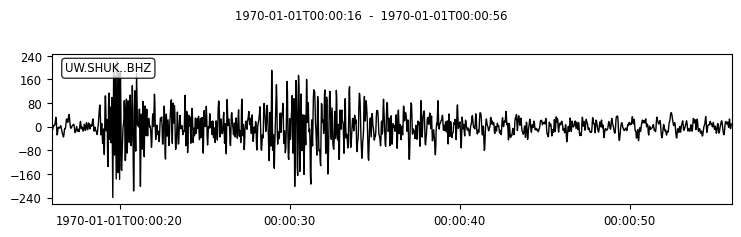

---
shukbhzrpba130 template original stream:


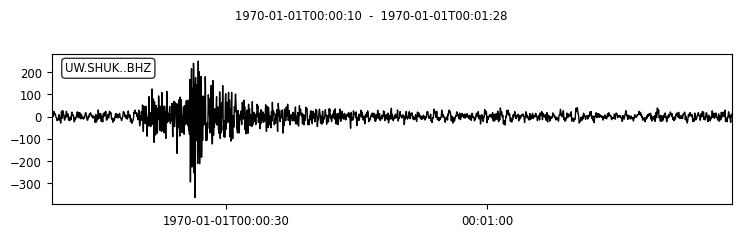

number of windows: 38
maximum amp window index: 6
Max Window:


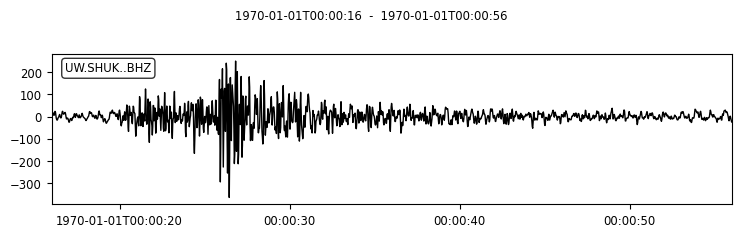

---
shukbhzrpba132 template original stream:


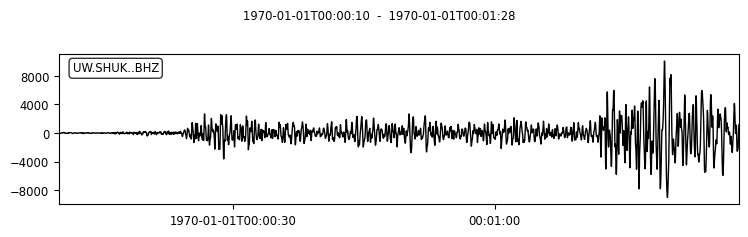

number of windows: 38
maximum amp window index: 38
Max Window:


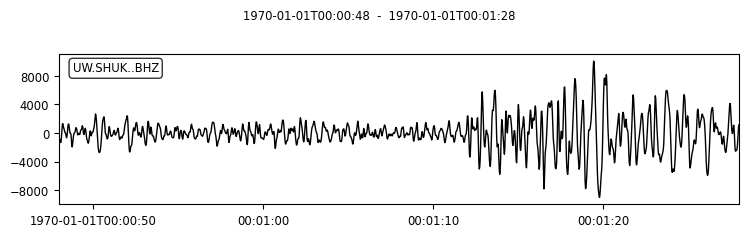

---
shukbhzrpba133 template original stream:


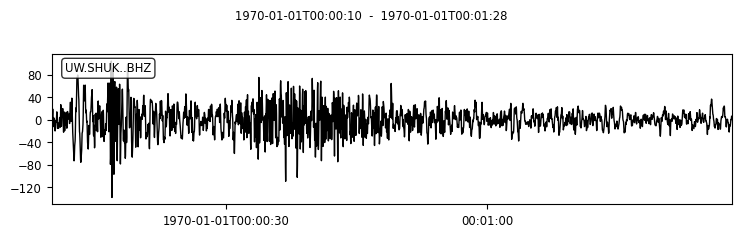

number of windows: 38
maximum amp window index: 2
Max Window:


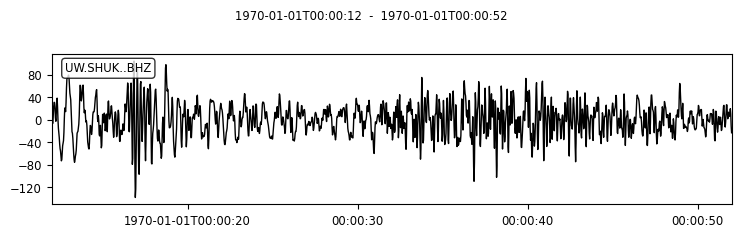

---
shukbhzrpba136 template original stream:


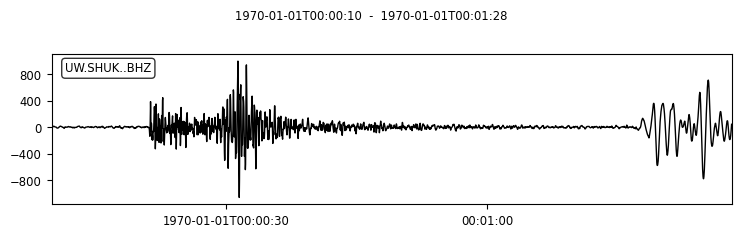

number of windows: 38
maximum amp window index: 11
Max Window:


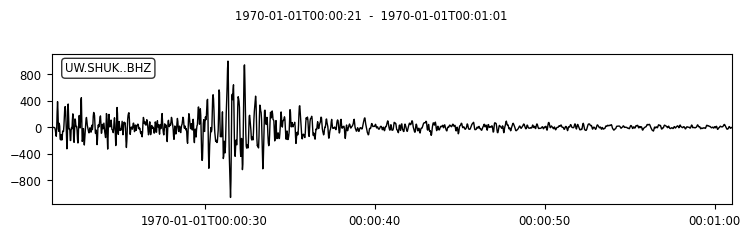

---
shukbhzrpba138 template original stream:


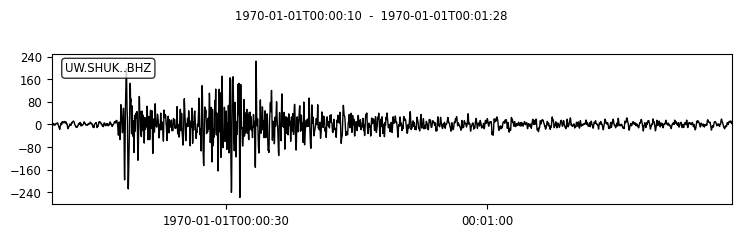

number of windows: 38
maximum amp window index: 7
Max Window:


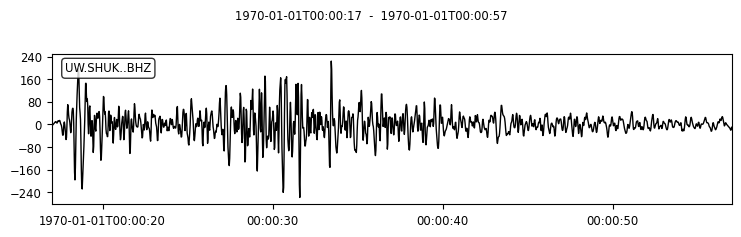

---
shukbhzrpba139 template original stream:


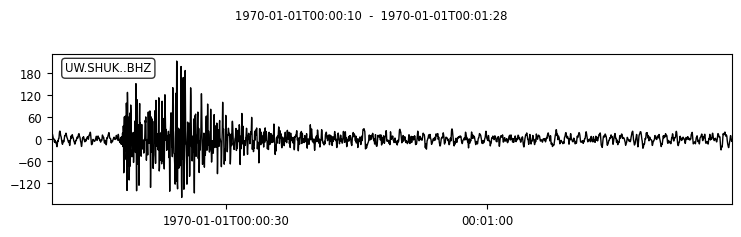

number of windows: 38
maximum amp window index: 8
Max Window:


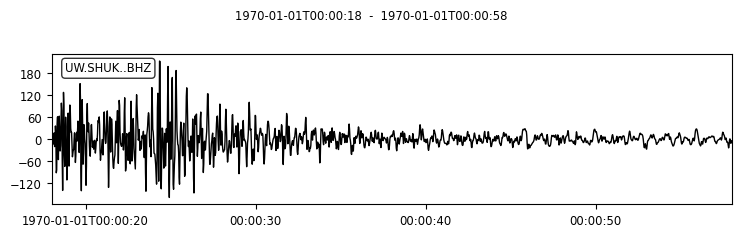

---
shukbhzrpba140 template original stream:


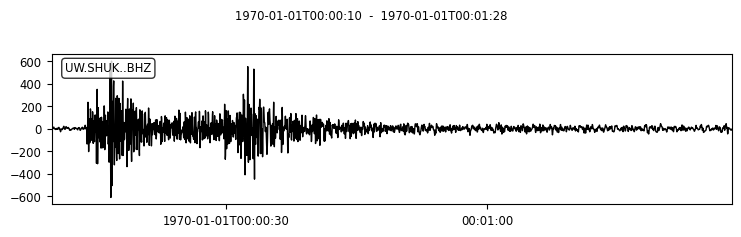

number of windows: 38
maximum amp window index: 4
Max Window:


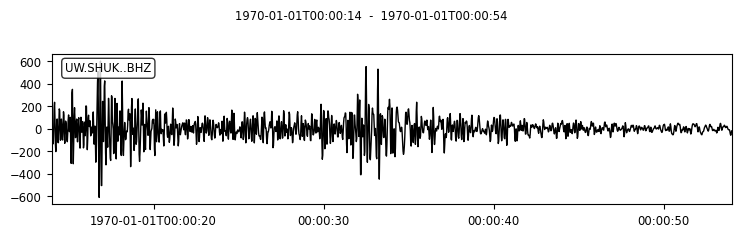

---
shukbhzrpba141 template original stream:


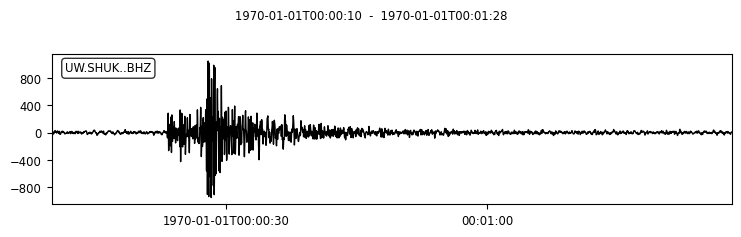

number of windows: 38
maximum amp window index: 12
Max Window:


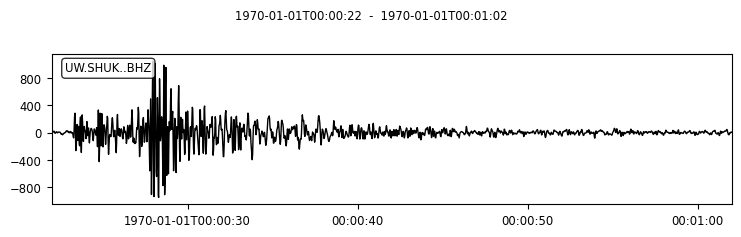

---
shukbhzrpba142 template original stream:


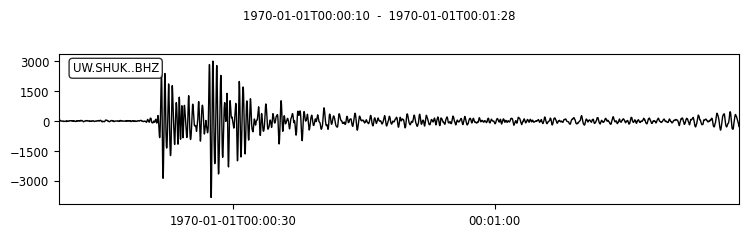

number of windows: 38
maximum amp window index: 11
Max Window:


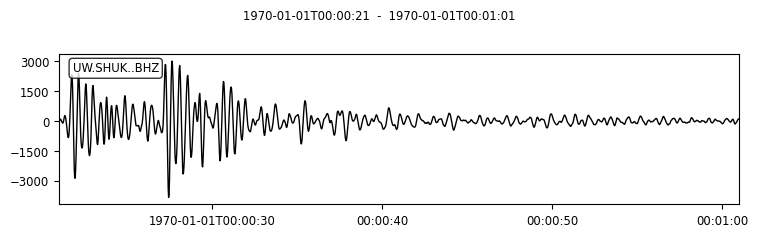

---
shukbhzrpba143 template original stream:


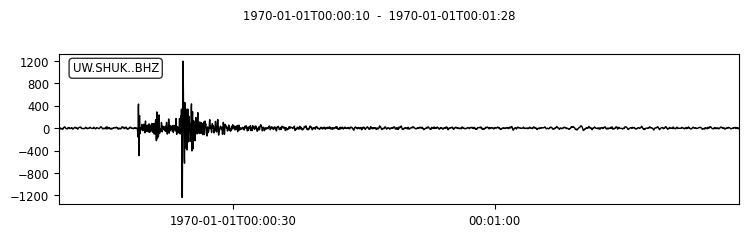

number of windows: 38
maximum amp window index: 5
Max Window:


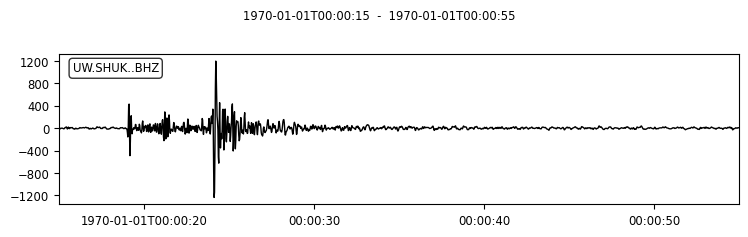

---
shukbhzrpba146 template original stream:


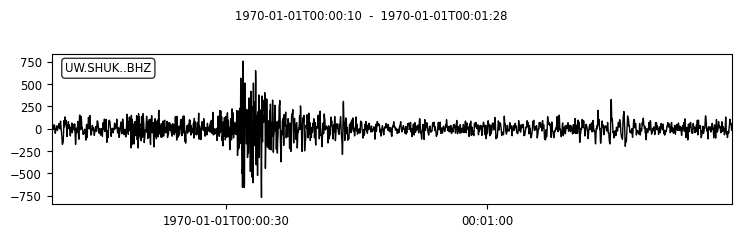

number of windows: 38
maximum amp window index: 1
Max Window:


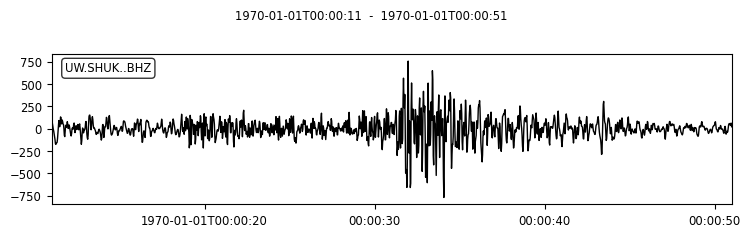

---
shukbhzrpba148 template original stream:


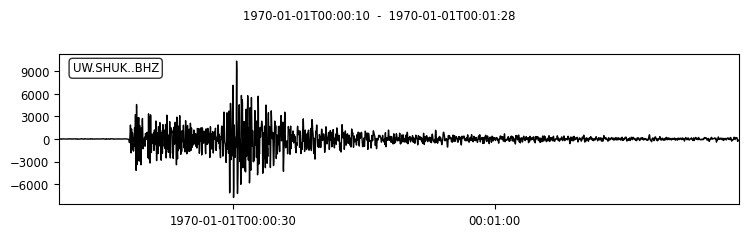

number of windows: 38
maximum amp window index: 8
Max Window:


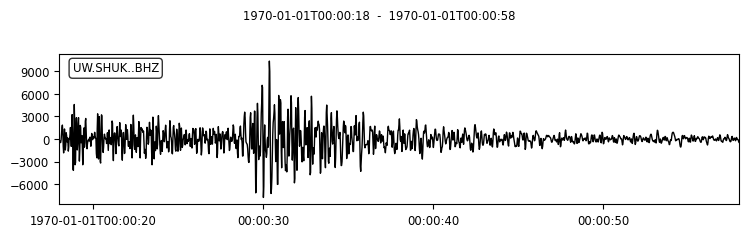

---
shukbhzrpba150 template original stream:


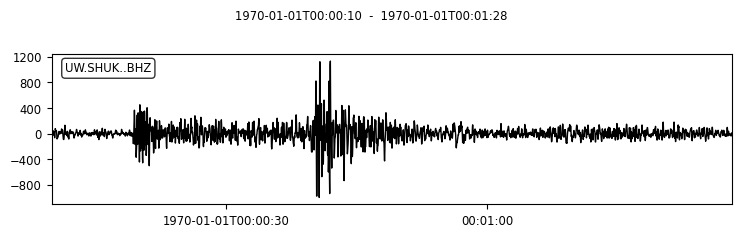

number of windows: 38
maximum amp window index: 9
Max Window:


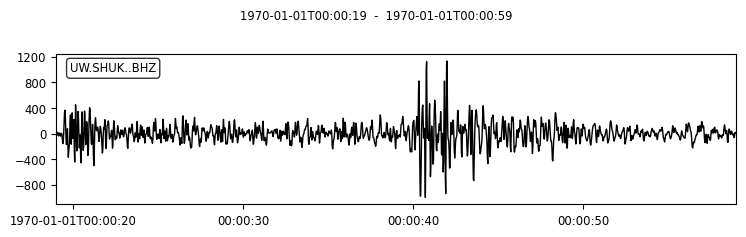

---
shukbhzrpba151 template original stream:


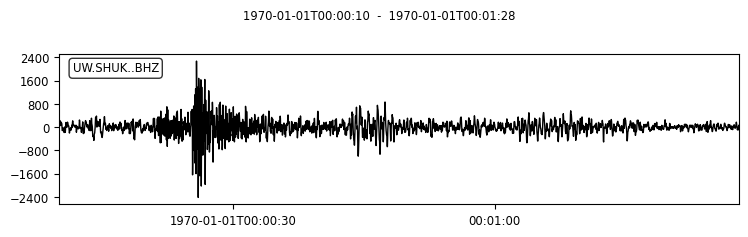

number of windows: 38
maximum amp window index: 3
Max Window:


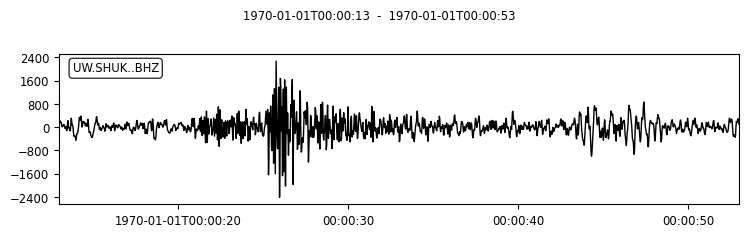

---
shukbhzrpba152 template original stream:


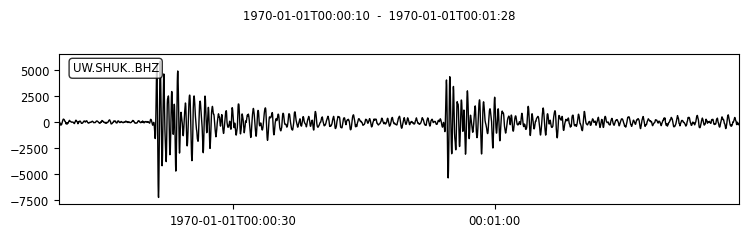

number of windows: 38
maximum amp window index: 11
Max Window:


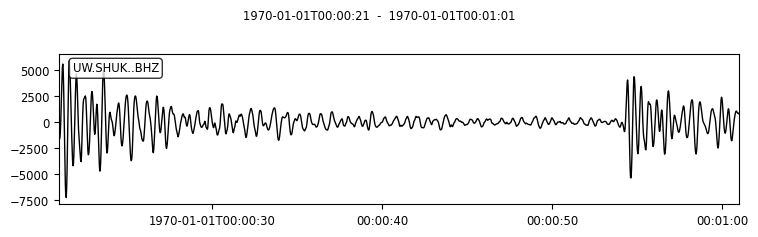

---
shukbhzrpba153 template original stream:


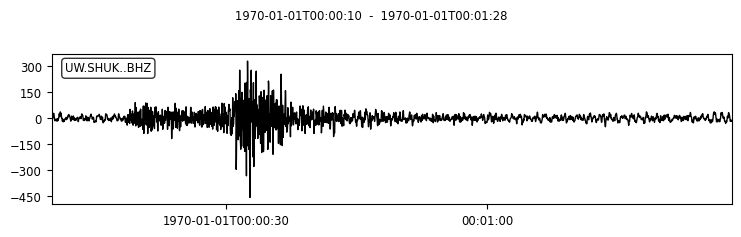

number of windows: 38
maximum amp window index: 5
Max Window:


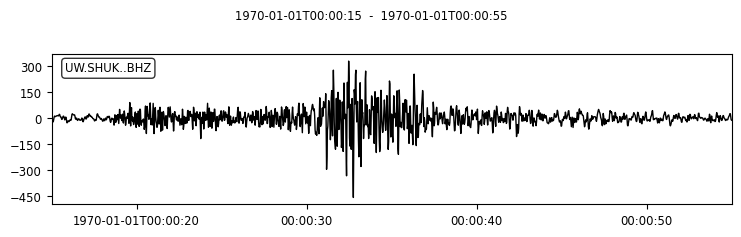

---
shukbhzrpba154 template original stream:


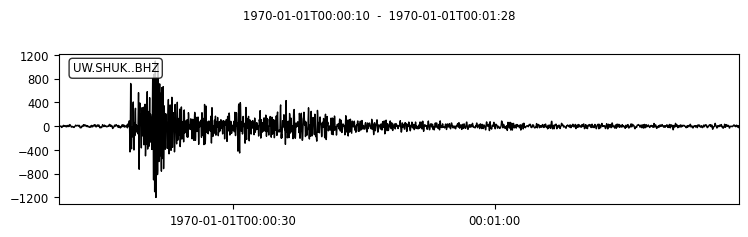

number of windows: 38
maximum amp window index: 8
Max Window:


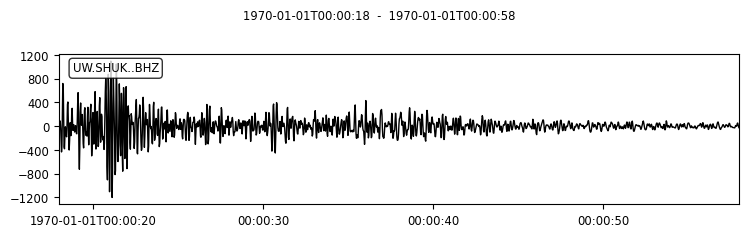

---
shukbhzrpba155 template original stream:


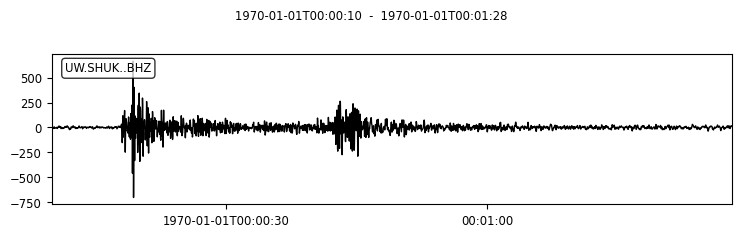

number of windows: 38
maximum amp window index: 8
Max Window:


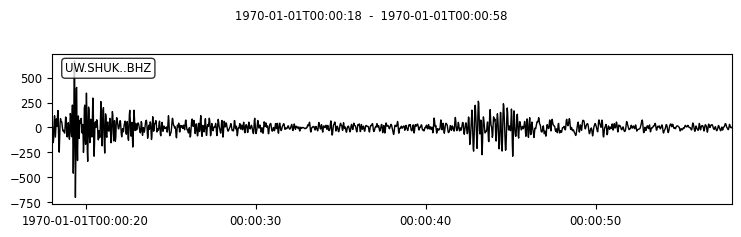

---
shukbhzrpba156 template original stream:


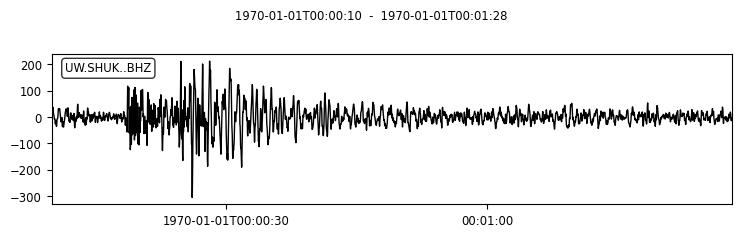

number of windows: 38
maximum amp window index: 8
Max Window:


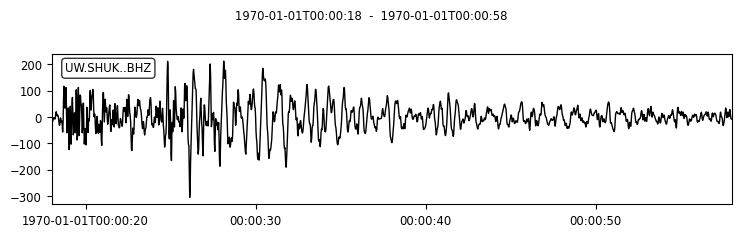

---
shukbhzrpba157 template original stream:


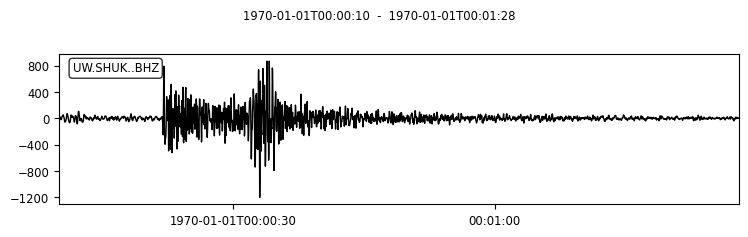

number of windows: 38
maximum amp window index: 11
Max Window:


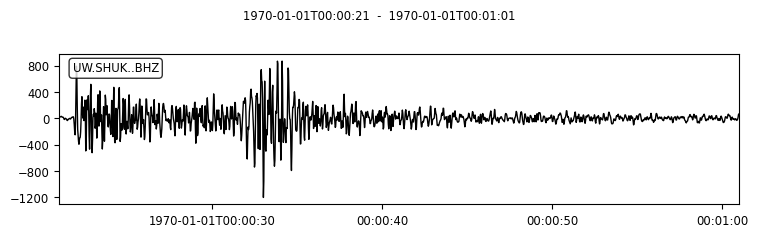

---
shukbhzrpba158 template original stream:


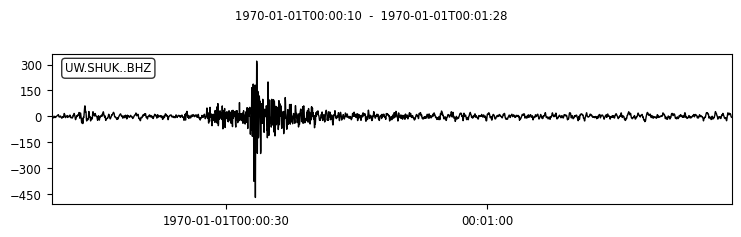

number of windows: 38
maximum amp window index: 3
Max Window:


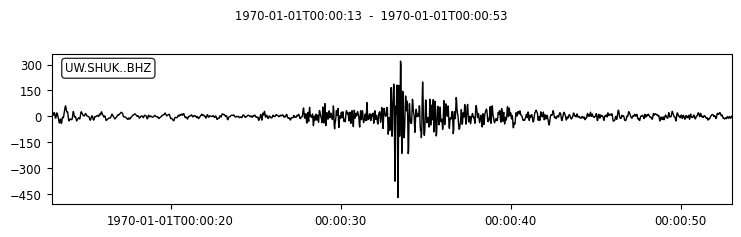

---
shukbhzrpba159 template original stream:


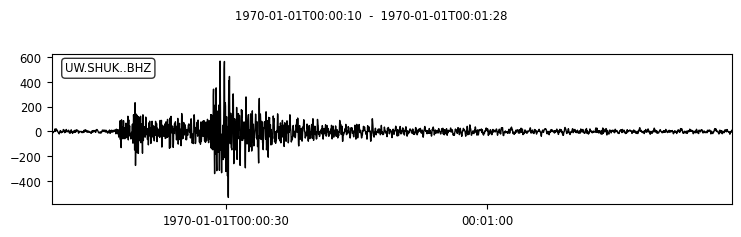

number of windows: 38
maximum amp window index: 7
Max Window:


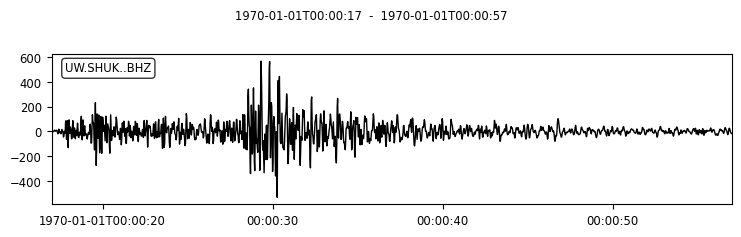

---
shukbhzrpba160 template original stream:


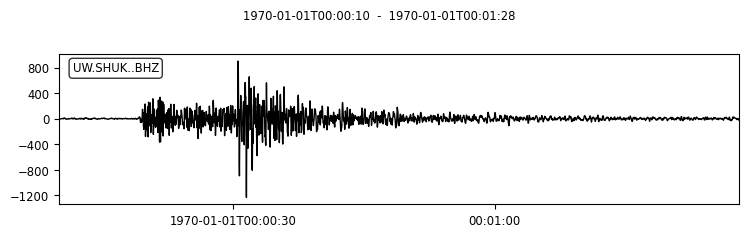

number of windows: 38
maximum amp window index: 9
Max Window:


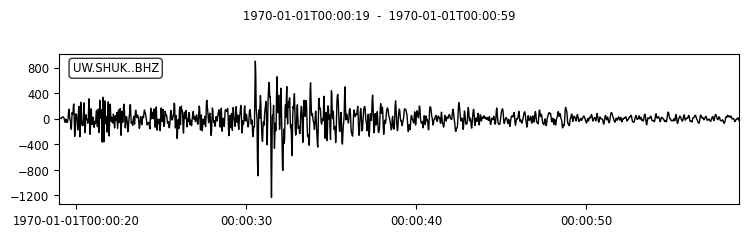

---
shukbhzrpba161 template original stream:


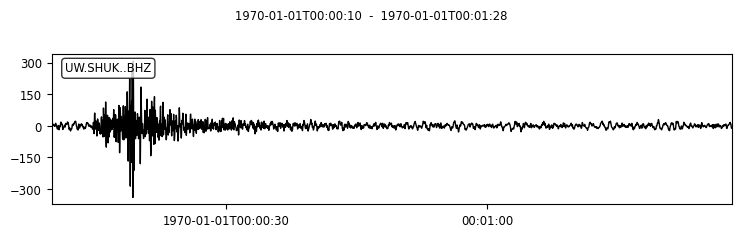

number of windows: 38
maximum amp window index: 1
Max Window:


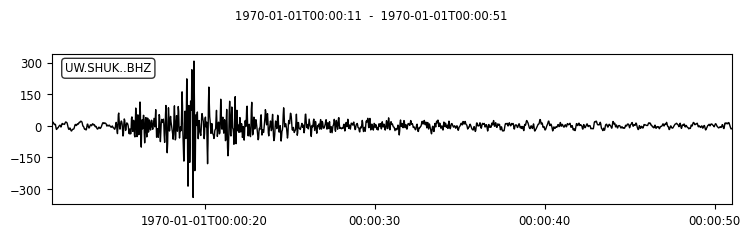

---
shukbhzrpba162 template original stream:


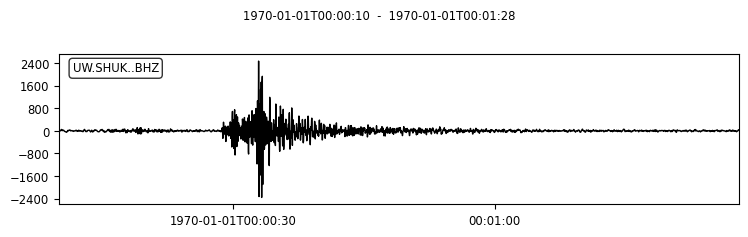

number of windows: 38
maximum amp window index: 16
Max Window:


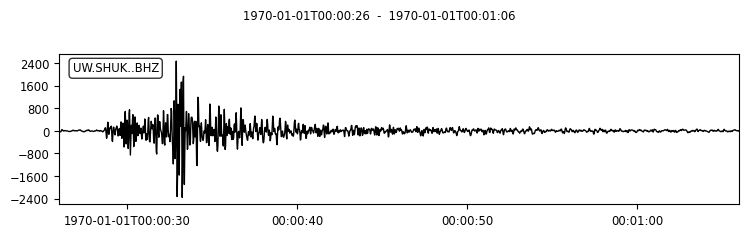

---
shukbhzrpba163 template original stream:


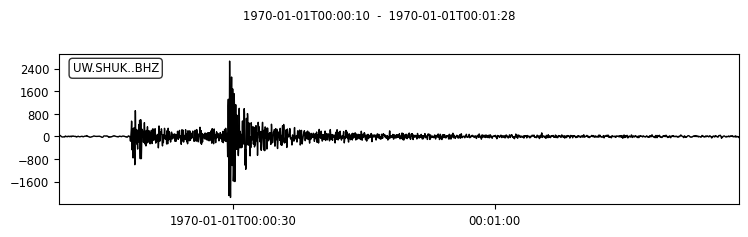

number of windows: 38
maximum amp window index: 8
Max Window:


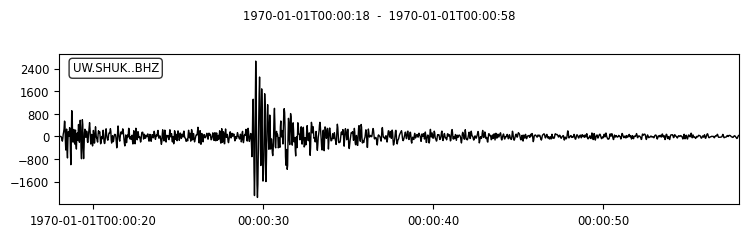

---
shukbhzrpba164 template original stream:


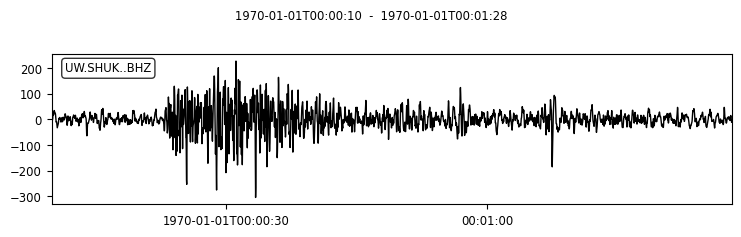

number of windows: 38
maximum amp window index: 13
Max Window:


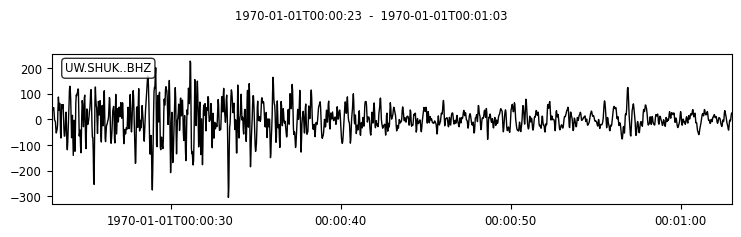

---
shukbhzrpba165 template original stream:


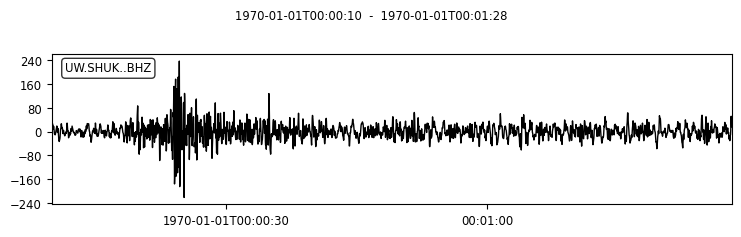

number of windows: 38
maximum amp window index: 7
Max Window:


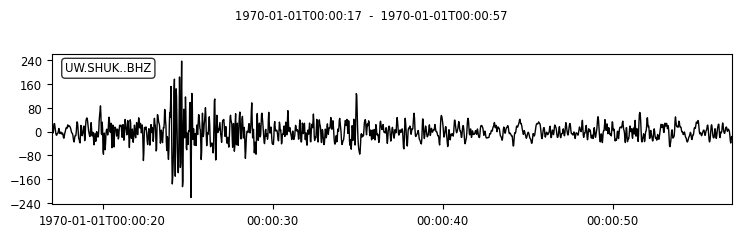

---
shukbhzrpba167 template original stream:


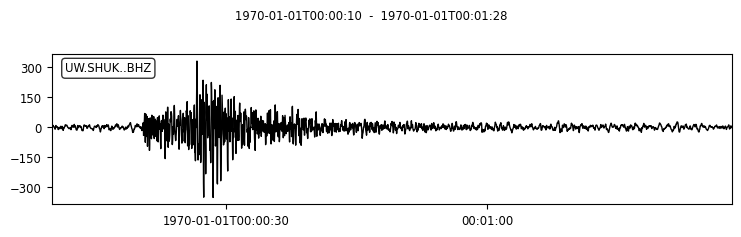

number of windows: 38
maximum amp window index: 10
Max Window:


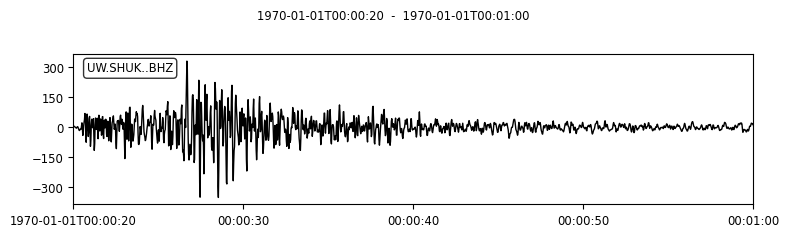

---
shukbhzrpba168 template original stream:


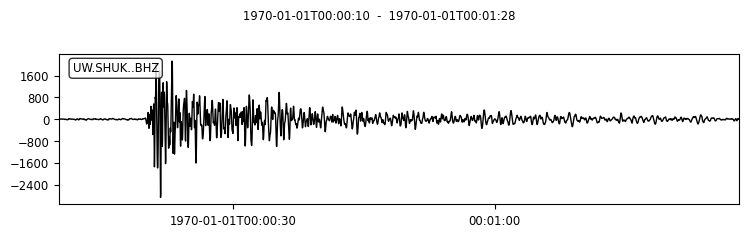

number of windows: 38
maximum amp window index: 10
Max Window:


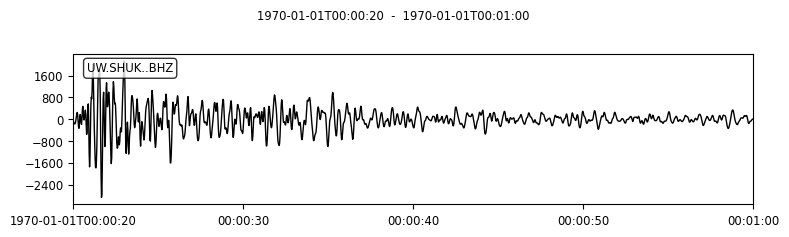

---
shukbhzrpba169 template original stream:


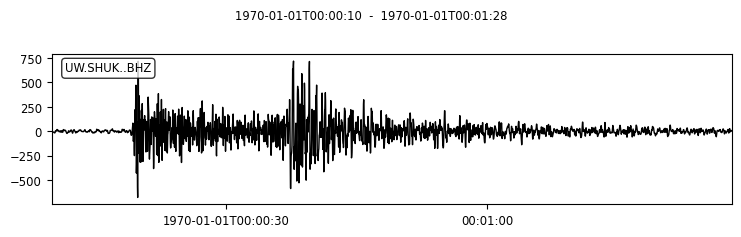

number of windows: 38
maximum amp window index: 9
Max Window:


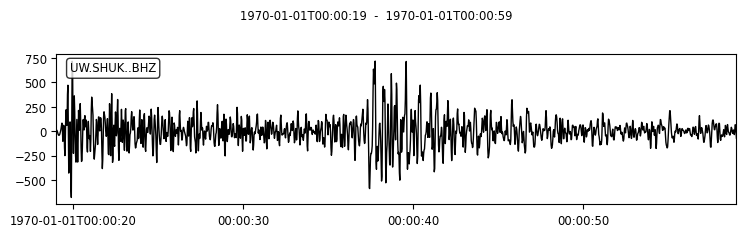

---
shukbhzrpba170 template original stream:


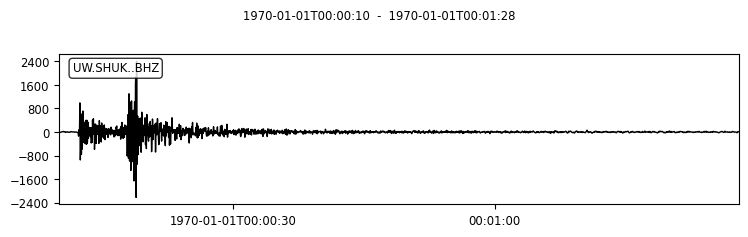

number of windows: 38
maximum amp window index: 2
Max Window:


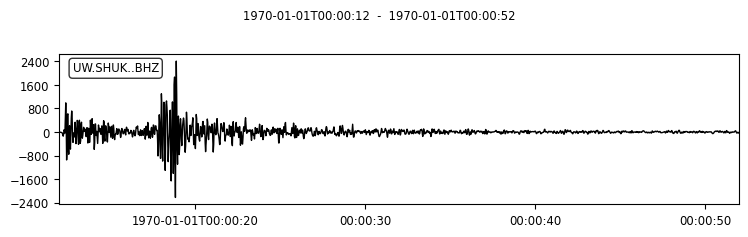

---
shukbhzrpba171 template original stream:


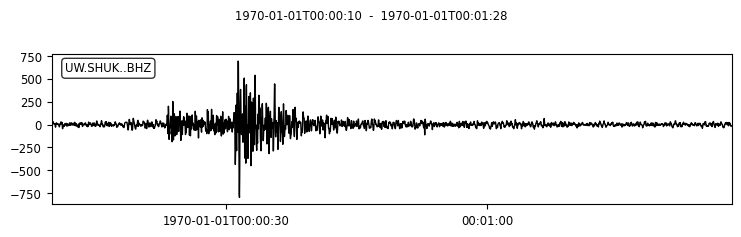

number of windows: 38
maximum amp window index: 8
Max Window:


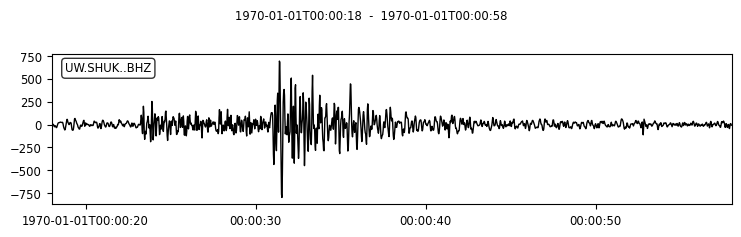

---
shukbhzrpba173 template original stream:


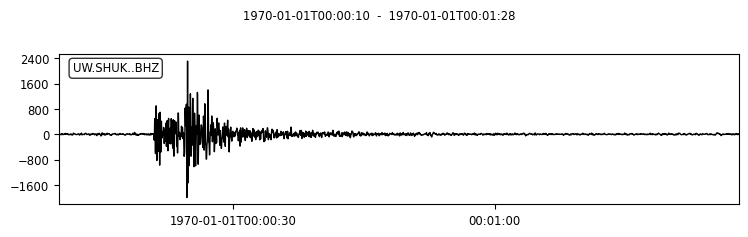

number of windows: 38
maximum amp window index: 8
Max Window:


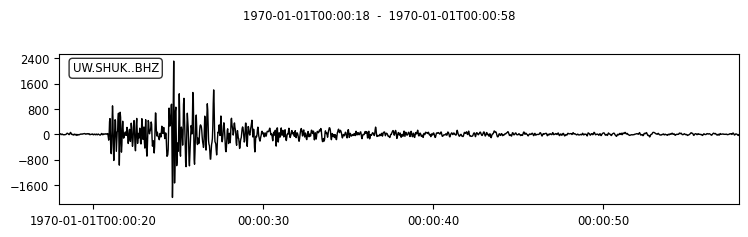

---
shukbhzrpba174 template original stream:


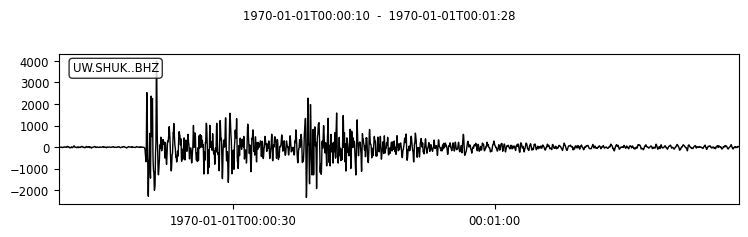

number of windows: 38
maximum amp window index: 10
Max Window:


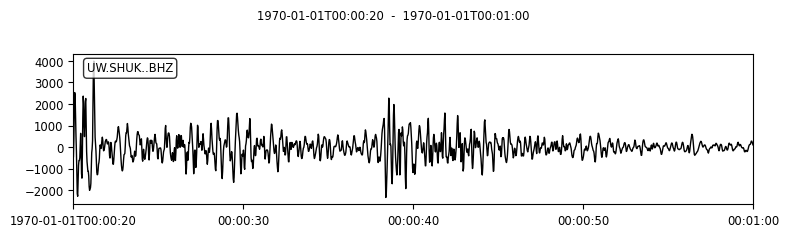

---
shukbhzrpba175 template original stream:


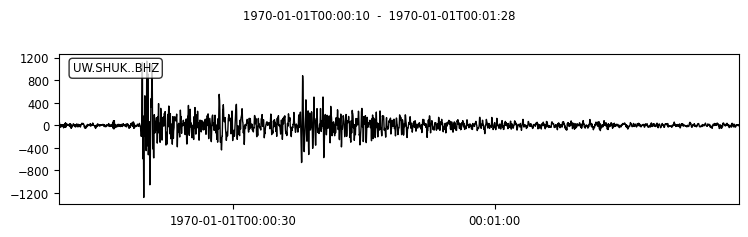

number of windows: 38
maximum amp window index: 9
Max Window:


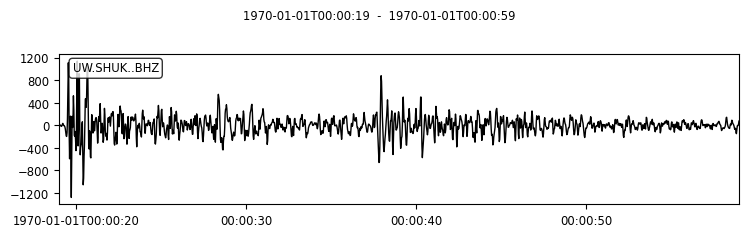

---
shukbhzrpba177 template original stream:


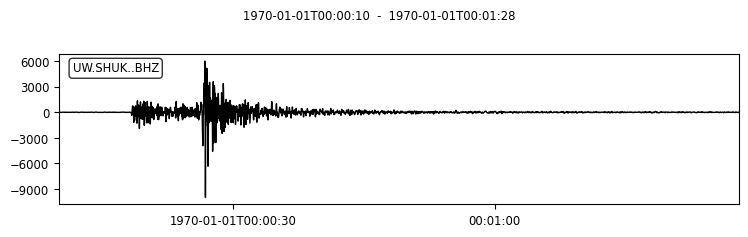

number of windows: 38
maximum amp window index: 8
Max Window:


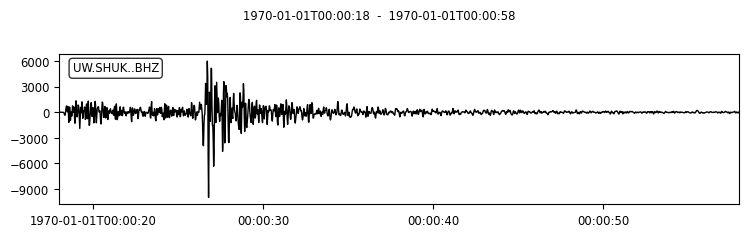

---
shukbhzrpba178 template original stream:


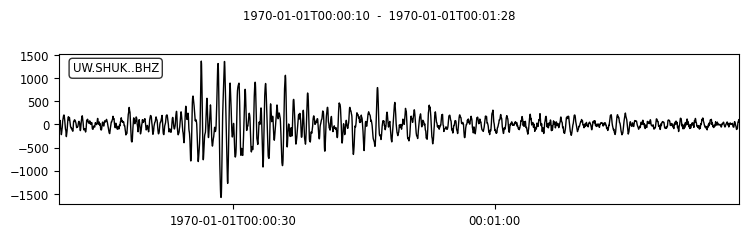

number of windows: 38
maximum amp window index: 8
Max Window:


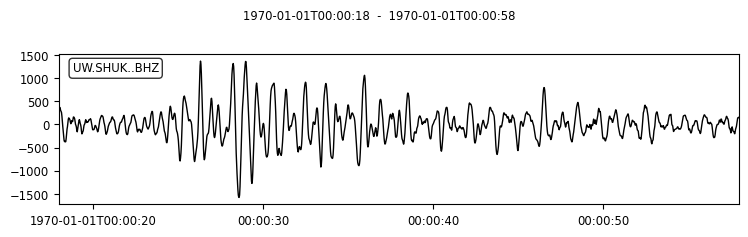

---
shukbhzrpba181 template original stream:


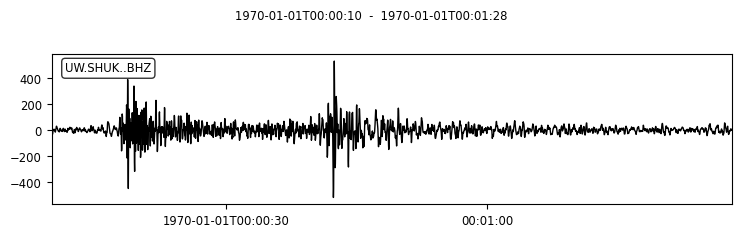

number of windows: 38
maximum amp window index: 8
Max Window:


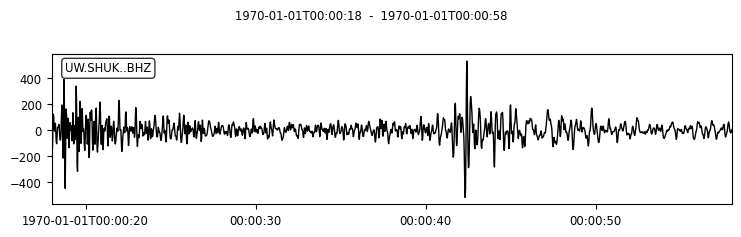

---
shukbhzrpba182 template original stream:


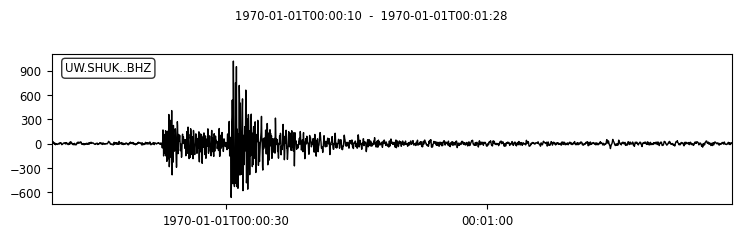

number of windows: 38
maximum amp window index: 12
Max Window:


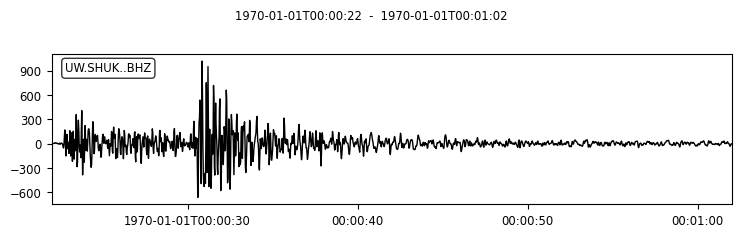

---
shukbhzrpba183 template original stream:


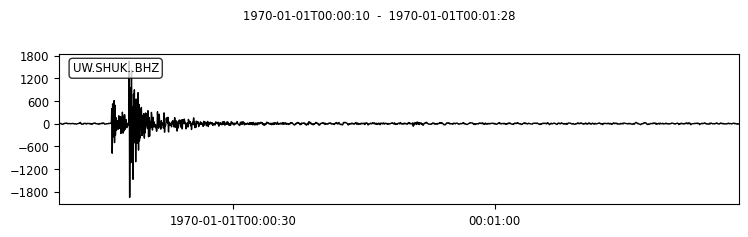

number of windows: 38
maximum amp window index: 5
Max Window:


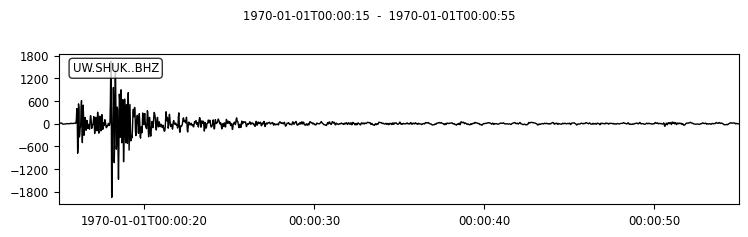

---
shukbhzrpba184 template original stream:


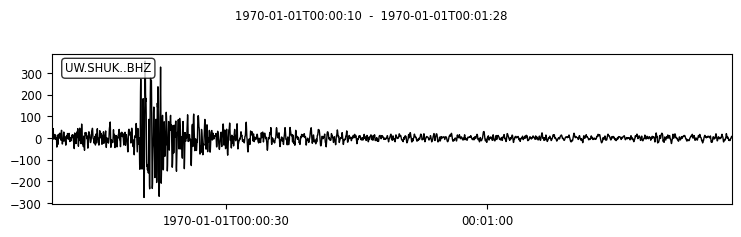

number of windows: 38
maximum amp window index: 0
Max Window:


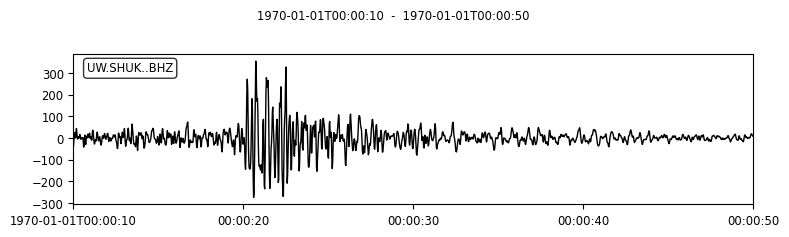

---
shukbhzrpba185 template original stream:


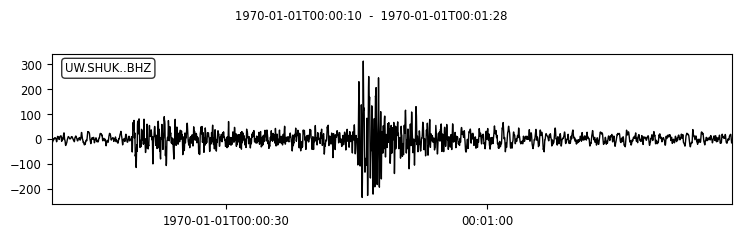

number of windows: 38
maximum amp window index: 9
Max Window:


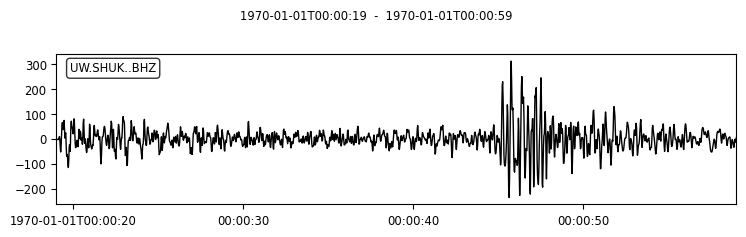

---
shukbhzrpba186 template original stream:


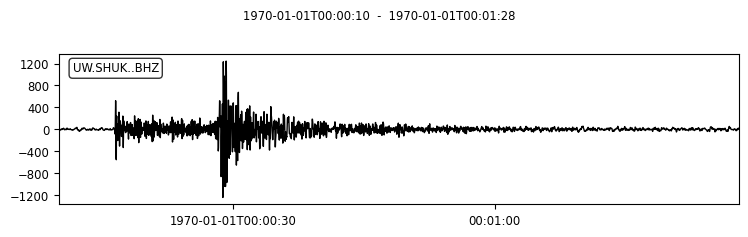

number of windows: 38
maximum amp window index: 6
Max Window:


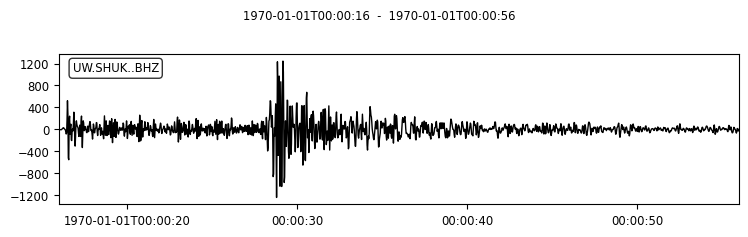

---
shukbhzrpba187 template original stream:


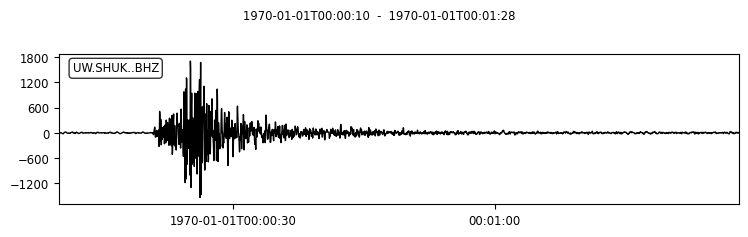

number of windows: 38
maximum amp window index: 11
Max Window:


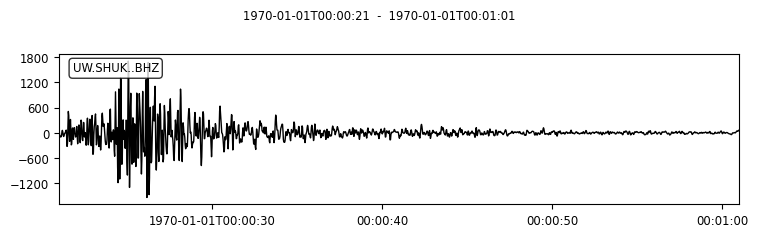

---
shukbhzrpba190 template original stream:


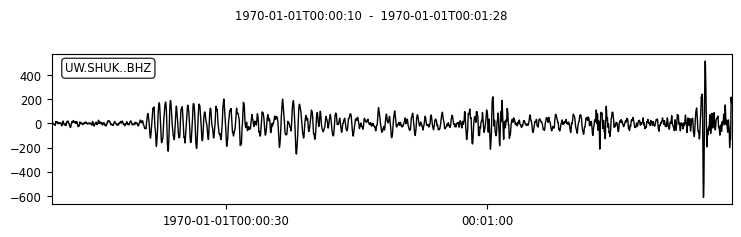

number of windows: 38
maximum amp window index: 11
Max Window:


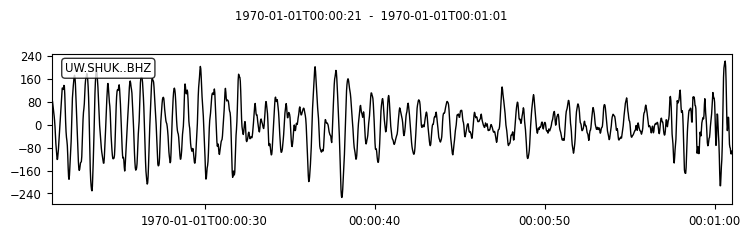

---
shukbhzrpba191 template original stream:


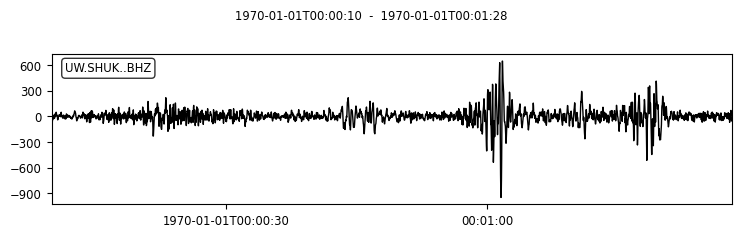

number of windows: 38
maximum amp window index: 31
Max Window:


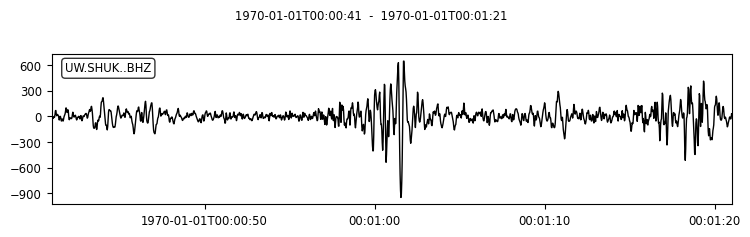

---
shukbhzrpba192 template original stream:


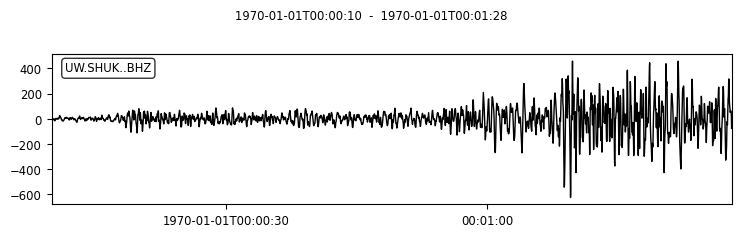

number of windows: 38
maximum amp window index: 38
Max Window:


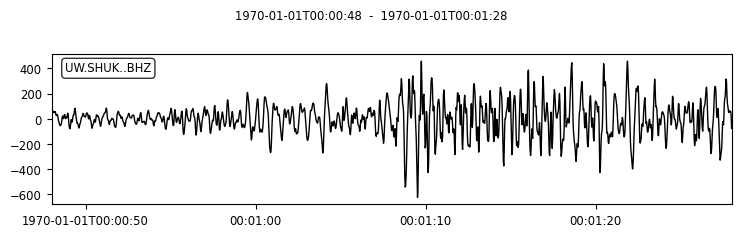

---
shukbhzrpba193 template original stream:


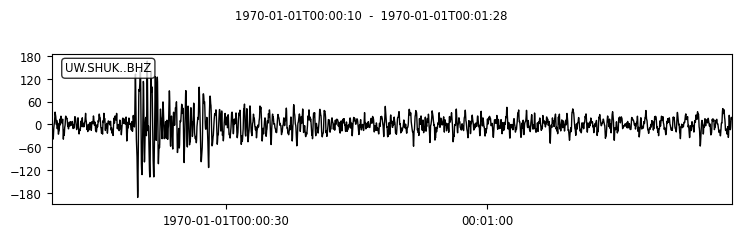

number of windows: 38
maximum amp window index: 8
Max Window:


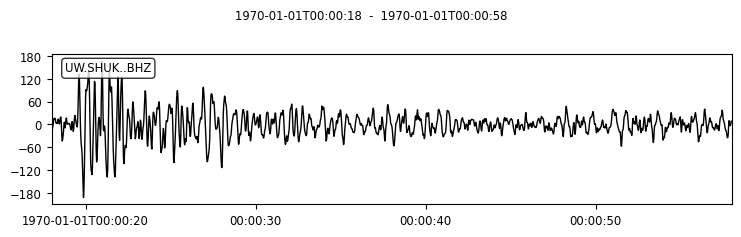

---
shukbhzrpba194 template original stream:


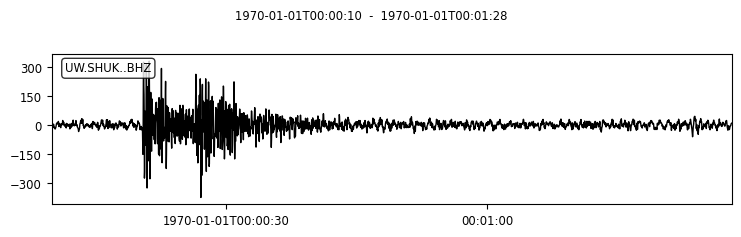

number of windows: 38
maximum amp window index: 9
Max Window:


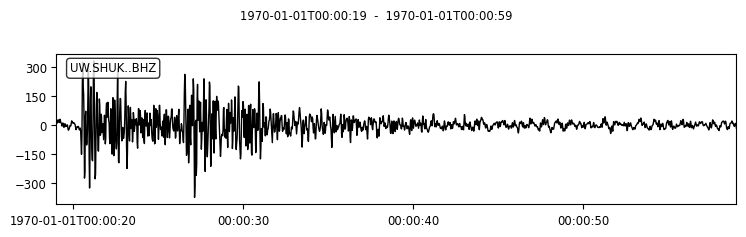

---
shukbhzrpba195 template original stream:


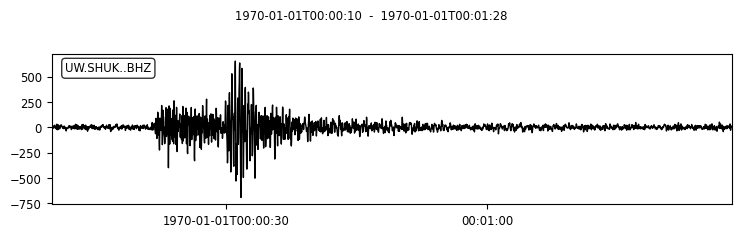

number of windows: 38
maximum amp window index: 11
Max Window:


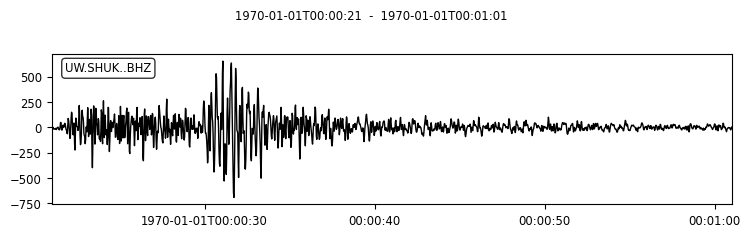

---
shukbhzrpba196 template original stream:


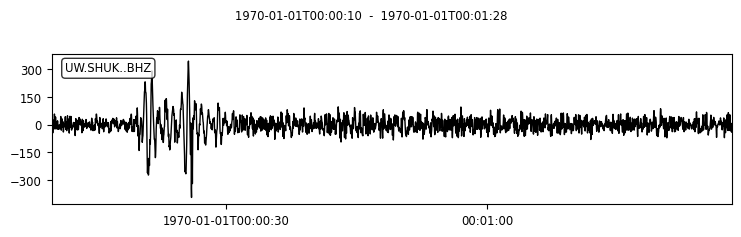

number of windows: 38
maximum amp window index: 9
Max Window:


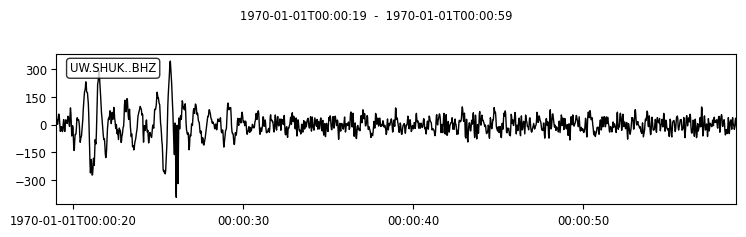

---
shukbhzrpba200 template original stream:


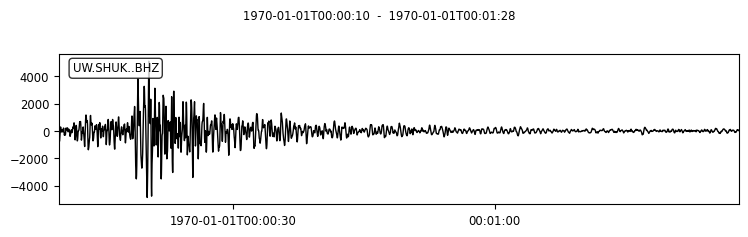

number of windows: 38
maximum amp window index: 0
Max Window:


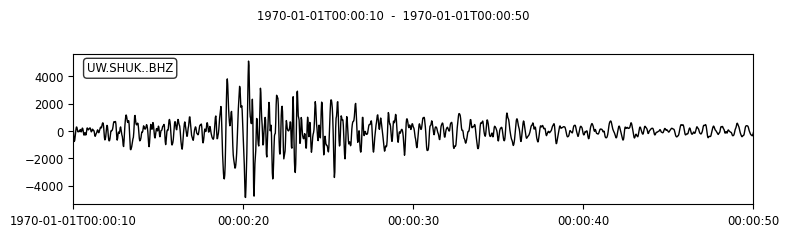

---
shukbhzrpba201 template original stream:


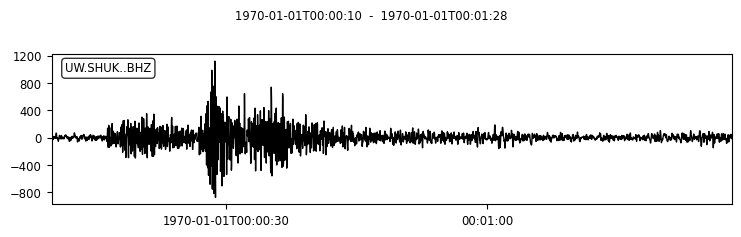

number of windows: 38
maximum amp window index: 6
Max Window:


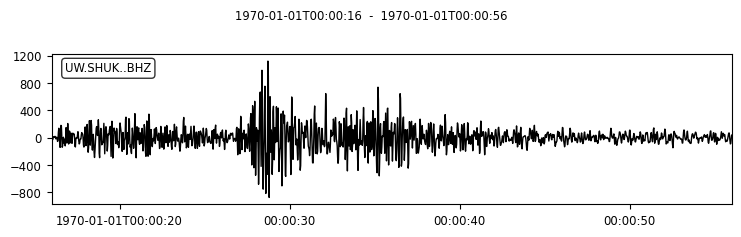

---
shukbhzrpba204 template original stream:


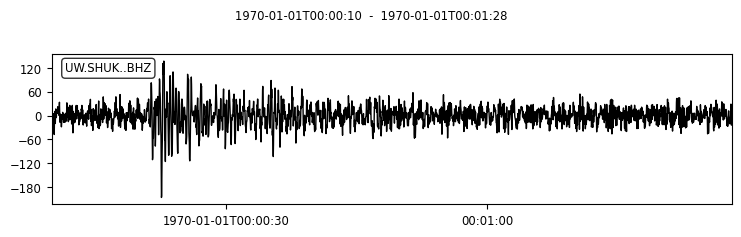

number of windows: 38
maximum amp window index: 4
Max Window:


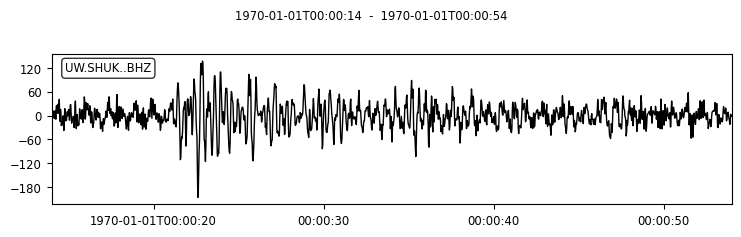

---
shukbhzrpba205 template original stream:


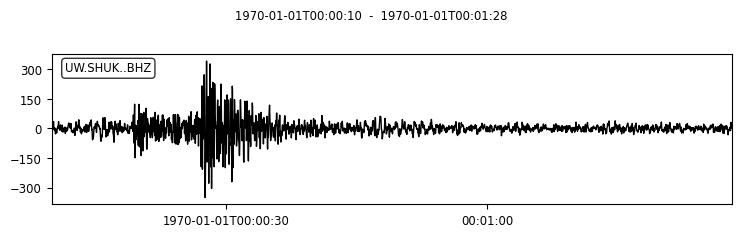

number of windows: 38
maximum amp window index: 4
Max Window:


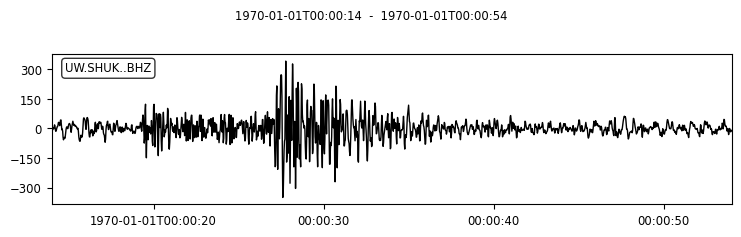

---
shukbhzrpba206 template original stream:


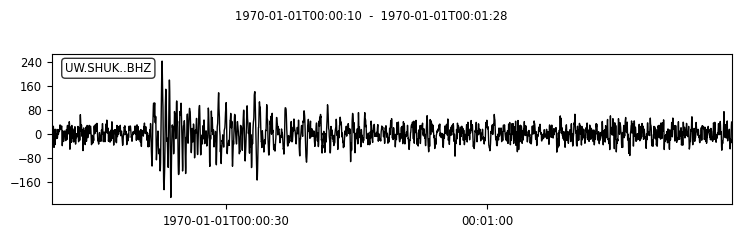

number of windows: 38
maximum amp window index: 11
Max Window:


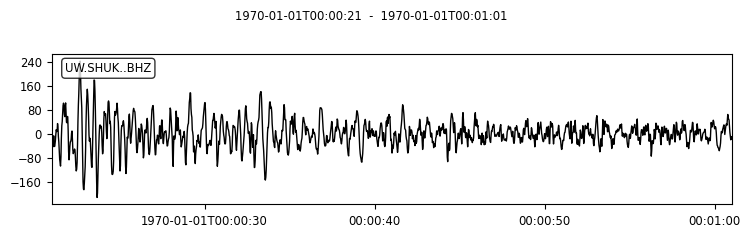

---
shukbhzrpba207 template original stream:


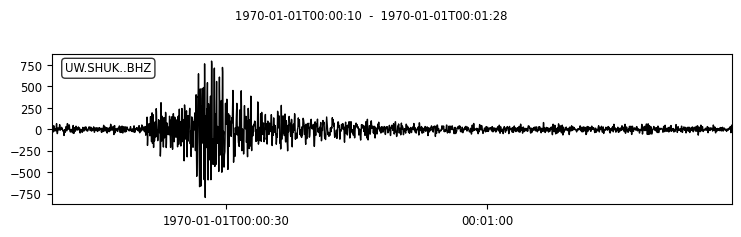

number of windows: 38
maximum amp window index: 10
Max Window:


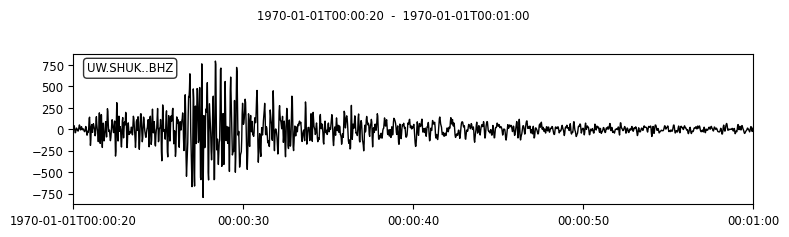

---
shukbhzrpba209 template original stream:


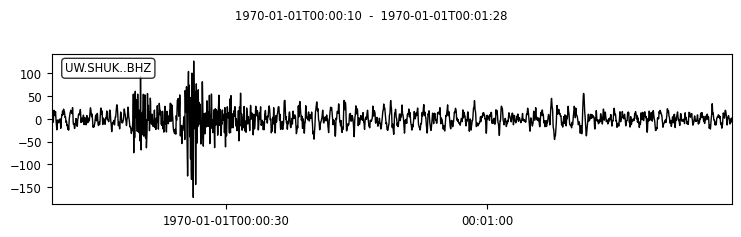

number of windows: 38
maximum amp window index: 9
Max Window:


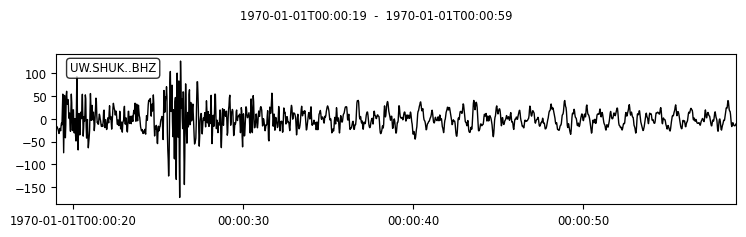

---
shukbhzrpba210 template original stream:


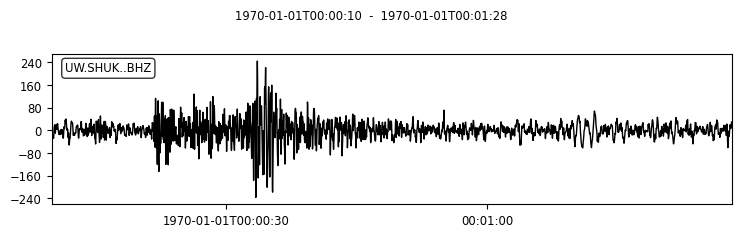

number of windows: 38
maximum amp window index: 2
Max Window:


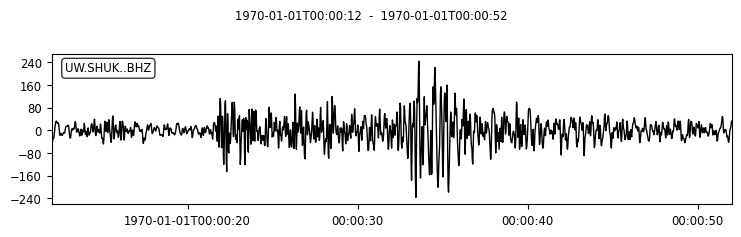

---
shukbhzrpba211 template original stream:


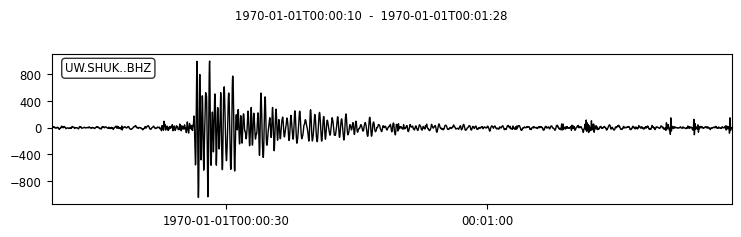

number of windows: 38
maximum amp window index: 11
Max Window:


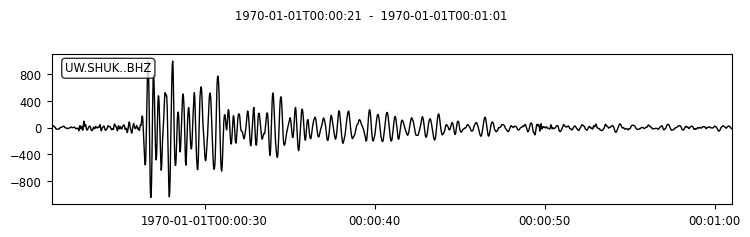

---
shukbhzrpba212 template original stream:


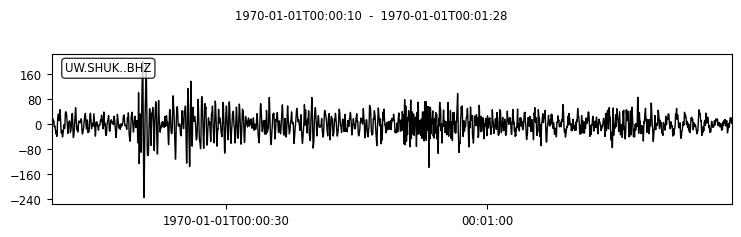

number of windows: 38
maximum amp window index: 9
Max Window:


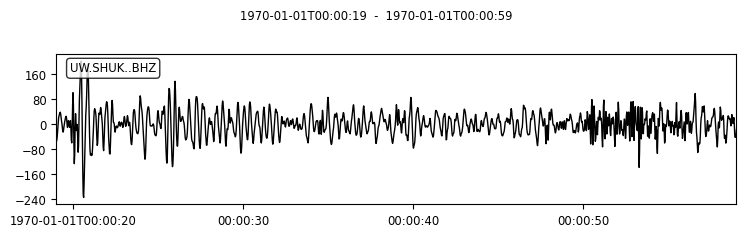

---
shukbhzrpba214 template original stream:


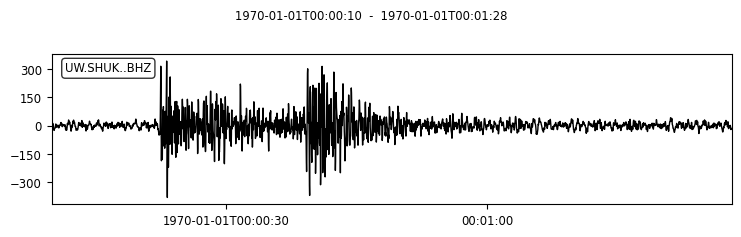

number of windows: 38
maximum amp window index: 12
Max Window:


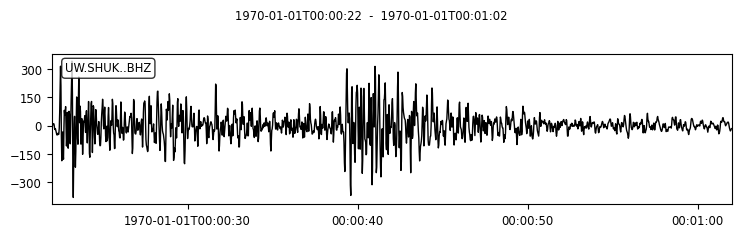

---
shukbhzrpba215 template original stream:


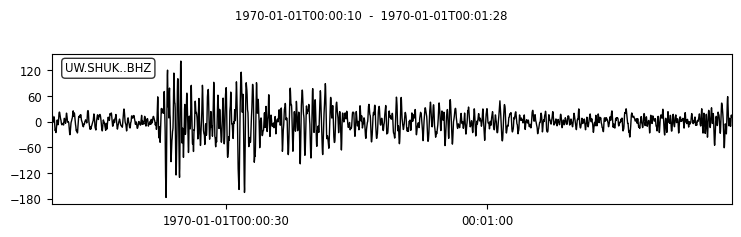

number of windows: 38
maximum amp window index: 12
Max Window:


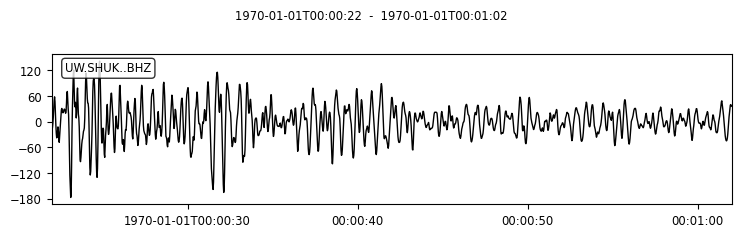

---
shukbhzrpba216 template original stream:


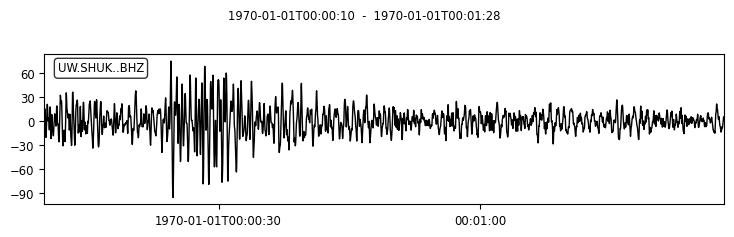

number of windows: 38
maximum amp window index: 0
Max Window:


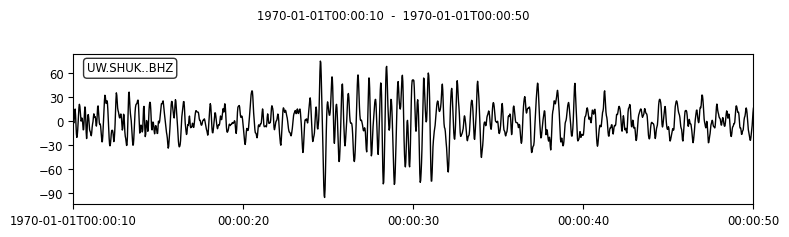

---
shukbhzrpba217 template original stream:


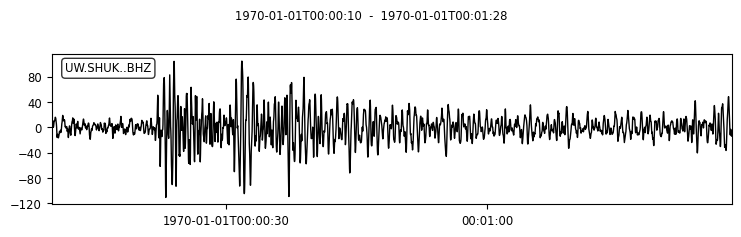

number of windows: 38
maximum amp window index: 12
Max Window:


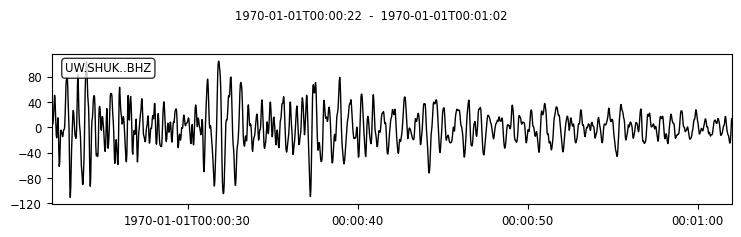

---
shukbhzrpba222 template original stream:


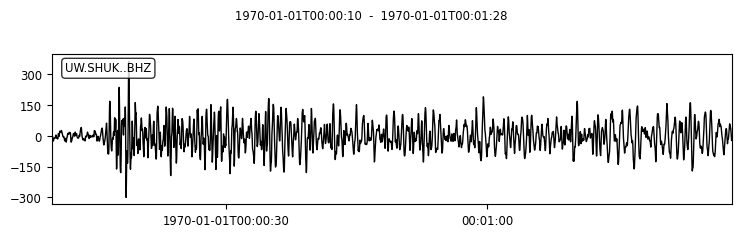

number of windows: 38
maximum amp window index: 5
Max Window:


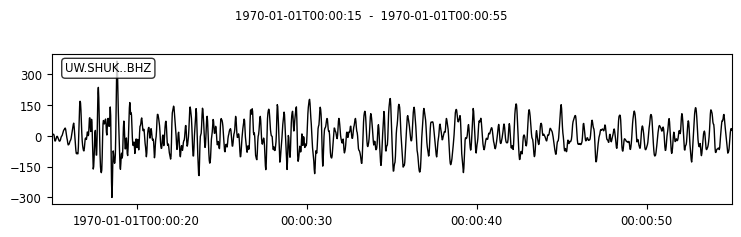

---
shukbhzrpba223 template original stream:


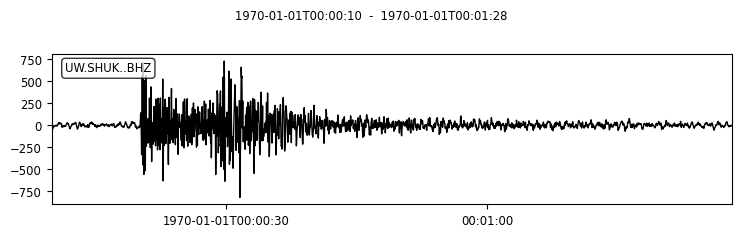

number of windows: 38
maximum amp window index: 10
Max Window:


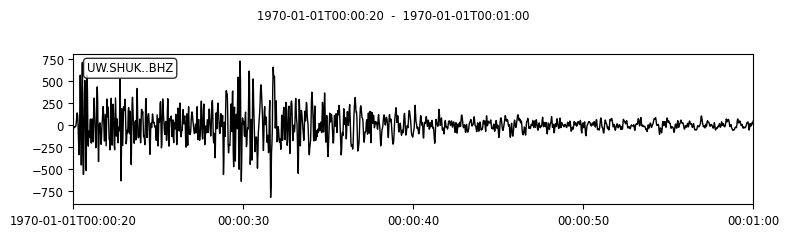

---
shukbhzrpba224 template original stream:


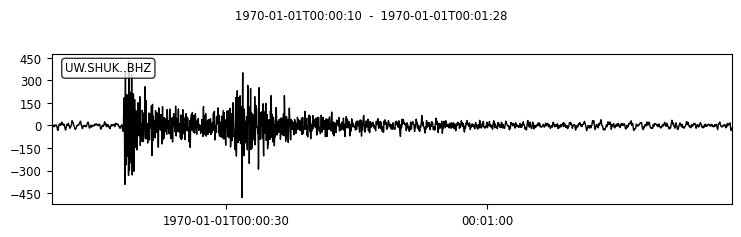

number of windows: 38
maximum amp window index: 8
Max Window:


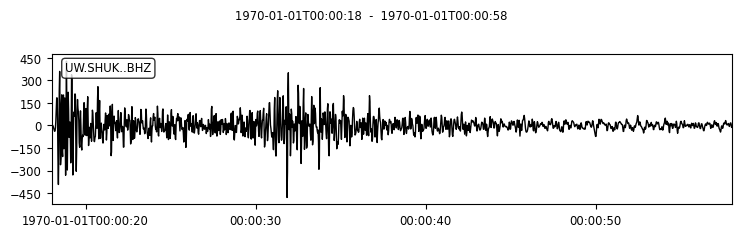

---
shukbhzrpba225 template original stream:


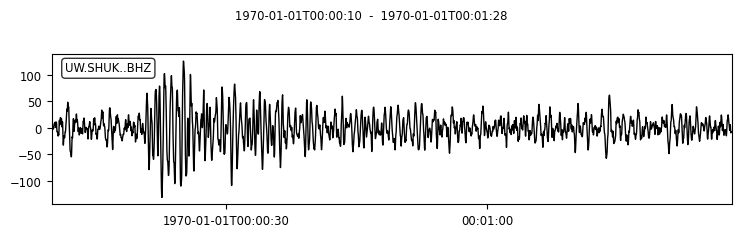

number of windows: 38
maximum amp window index: 6
Max Window:


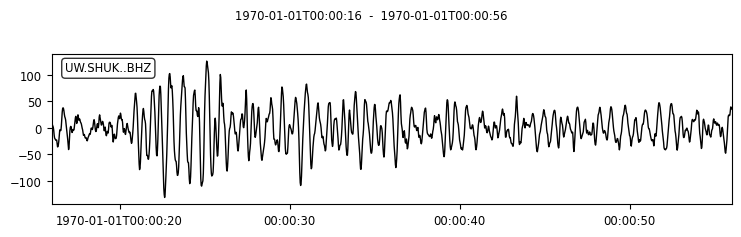

---
shukbhzrpba228 template original stream:


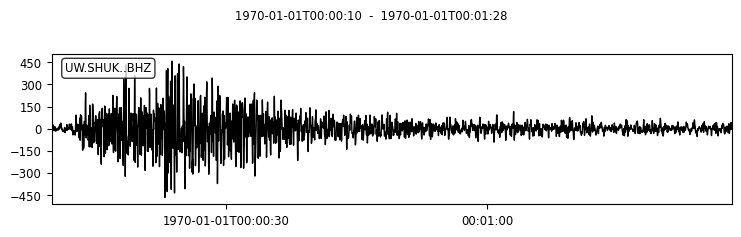

number of windows: 38
maximum amp window index: 2
Max Window:


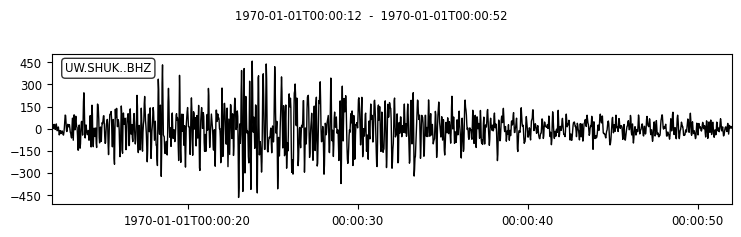

---
shukbhzrpba229 template original stream:


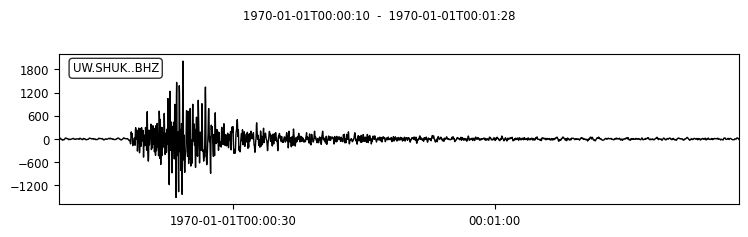

number of windows: 38
maximum amp window index: 8
Max Window:


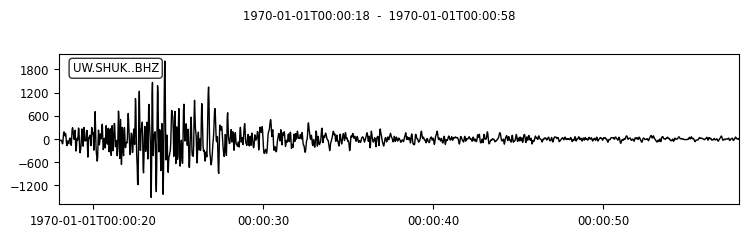

---
shukbhzrpba230 template original stream:


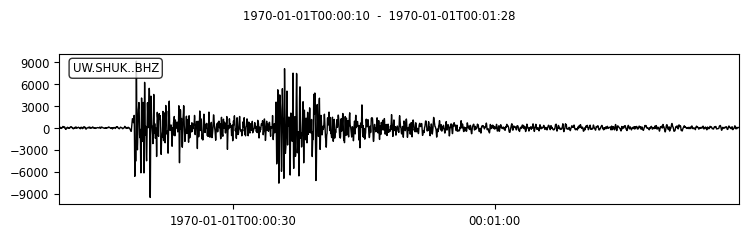

number of windows: 38
maximum amp window index: 8
Max Window:


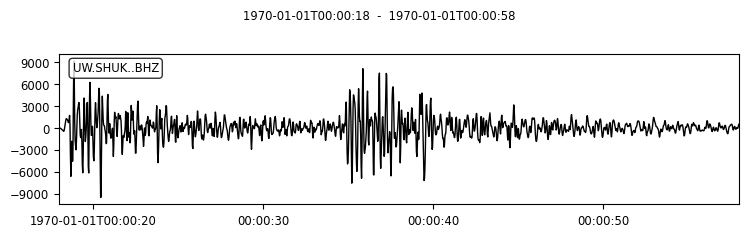

---
shukbhzrpba231 template original stream:


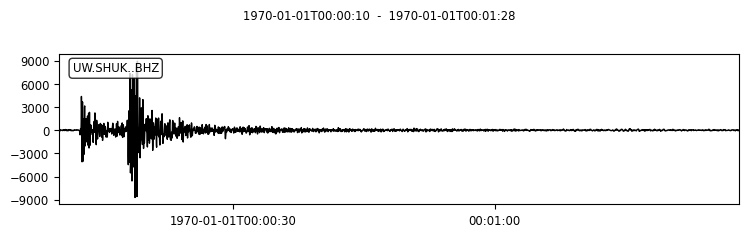

number of windows: 38
maximum amp window index: 2
Max Window:


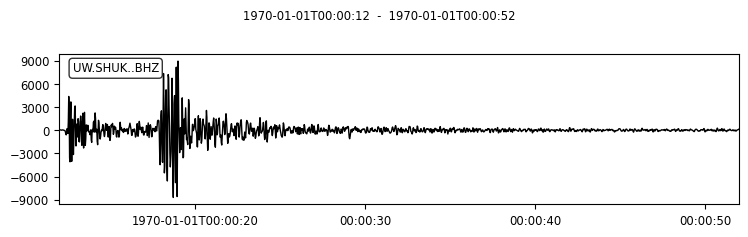

---


In [4]:
tdf = pd.DataFrame(data={'template_name':[],'waveform':[]}) #make a two column dataframe with labels

for f_name in glob(f'{path}{filename}'): #loop thru tgz files at a volcano
    T = Tribe().read(f_name)
    
    
    for t in T: #loop thru tgz file
        print(f'{t.name} template original stream:') #show original stream

        t.st.plot();

        max_stream = maxwindow(st=t.st,winlen=winlen) #maxwindow func
        
        ###
        #INTEGRATE NETWORK NAME FROM f_name INTO t.name SO THAT DIFF NETWORK, SAME STATION NAME ARE NOT CONFUSED #
        ###
        
        tdf.loc[len(tdf)+1] = [t.name,max_stream[0].data] #add this trimmed template to the df at index len+1 
#         max_stream[0].spectrogram() #show spectrogram
        print('---') #barrier

#         break
#     break #when break is on, only first station will be added

In [5]:
tdf_spare = tdf.copy() #create a copy of the unaltered df for easier testing
# tdf = tdf_spare #make tdf refer to this copy

In [6]:
#test tdf
tdf

,template_name,waveform
1,vdbehzrpba013,"[-4.18870490677264, -3.740318445597053, -0.727..."
2,vdbehzrpba017,"[53.56497799937018, 7.316679721872349, -11.813..."
3,vdbehzrpba018,"[-0.1858976156594072, -3.5841753150650426, -2...."
4,vdbehzrpba019,"[0.5736164817925817, -0.9598055924373123, -2.8..."
5,vdbehzrpba020,"[2.7230568753076234, 3.4310653034134635, 5.097..."
...,...,...
504,shukbhzrpba225,"[5.775725864335447, 7.692638855744917, 5.48804..."
505,shukbhzrpba228,"[2.4897973889753864, 27.52437997500134, 29.749..."
506,shukbhzrpba229,"[-27.629146841403465, -36.608695959988175, -42..."
507,shukbhzrpba230,"[15.21161585203848, -40.38393578200238, -66.93..."


In [7]:
l_list = []
for i in range(1,508):
    l = len(tdf['waveform'][i])
    if l != 1601:
        print('inx',i,'l=',l)
    
# print(np.unique(l_list))

Calculate spectrograms from trimmed template df

In [8]:
fSTFT, tSTFT, STFT_raw = sp.spectrogram(
    x=np.stack(tdf["waveform"].values),
    fs=fs,
    nperseg=nperseg,
    noverlap=noverlap,
    nfft=nfft,
    scaling=sgramScaling,
    axis=-1,
    mode=sgramMode
)

In [9]:
#quality check
np.isnan(STFT_raw).any()

False

In [10]:
#bandpass filter, optional
freq_slice = np.where((fSTFT >= fqmin) & (fSTFT <= fqmax))
fSTFT   = fSTFT[freq_slice]
STFT_0 = STFT_raw[:,freq_slice,:].squeeze()

In [11]:
normConstant = np.median(STFT_0, axis=(1,2))
STFT_norm = STFT_0 / normConstant[:,np.newaxis,np.newaxis]  # norm by median
del STFT_0
STFT_dB = 20*np.log10(STFT_norm, where=STFT_norm != 0) # convert to dB
del STFT_norm
STFT = np.maximum(0, STFT_dB) # make sure nonnegative
del STFT_dB

tdf["stft"] = list(STFT)
tdf.head()

,template_name,waveform,stft
1,vdbehzrpba013,"[-4.18870490677264, -3.740318445597053, -0.727...","[[8.356429282945783, 3.846324920480569, 14.651..."
2,vdbehzrpba017,"[53.56497799937018, 7.316679721872349, -11.813...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3453263..."
3,vdbehzrpba018,"[-0.1858976156594072, -3.5841753150650426, -2....","[[4.819324896366959, 1.6561637149008948, 1.663..."
4,vdbehzrpba019,"[0.5736164817925817, -0.9598055924373123, -2.8...","[[11.992554950805257, 15.486734868535905, 13.6..."
5,vdbehzrpba020,"[2.7230568753076234, 3.4310653034134635, 5.097...","[[9.59276559723431, 13.082124596919439, 11.755..."


In [12]:
#quality check
bad_idx = tdf["stft"][tdf["stft"].apply(lambda x: np.isnan(x).any())].index
print(f"Bad spectrograms: \n{tdf.loc[bad_idx].template_name}")
tdf = tdf.drop(bad_idx).sort_values("template_name")

#this can mess with index sometimes (?)

Bad spectrograms: 
Series([], Name: template_name, dtype: object)


/tmp/ipykernel_3290557/4288673595.py:6: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[0].pcolormesh(tSTFT,fSTFT,STFT_raw[n_spectrogram,freq_slice,:].squeeze())
/tmp/ipykernel_3290557/4288673595.py:11: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  ax[1].pcolormesh(tSTFT,fSTFT, STFT[n_spectrogram])


Text(0.5, 1.0, 'Normalized spectrogram')

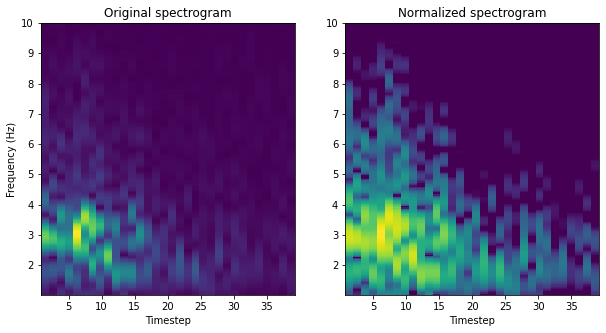

In [13]:
#plotting example spectrogram
n_spectrogram = 0 # index of spectrogram to plot

f, ax = plt.subplots(1,2, figsize=(10,5))

ax[0].pcolormesh(tSTFT,fSTFT,STFT_raw[n_spectrogram,freq_slice,:].squeeze())
ax[0].set_xlabel("Timestep")
ax[0].set_ylabel("Frequency (Hz)")
ax[0].set_title("Original spectrogram")

ax[1].pcolormesh(tSTFT,fSTFT, STFT[n_spectrogram])
ax[1].set_xlabel("Timestep")
ax[1].set_title("Normalized spectrogram")

In [14]:
#save spectrogram df as a csv
#tdf.to_csv(f'{homedir}{volc}_{winlen}s_window_spectrograms.csv',index=False)

#right now this is kind of useless, it to_csv doesn't save the full waveform 
#or stft arrays, so they would have to be modified to be saved or saved in some other way

## Run Specufex

At the moment, specufex is installed in a python kernel that jupyter_hub cannot access, so this part is being done in a .py script. Below will be the code in that script

In [15]:
nmf = BayesianNonparametricNMF(np.stack(tdf["stft"].values).shape)

In [16]:
batches = 100000
batch_size = 1

t = trange(batches, desc="NMF fit progress ", leave=True)
for i in t:
    idx = np.random.randint(len(tdf["stft"].values), size=batch_size)
    nmf.fit(tdf["stft"].iloc[idx].values)
    t.set_postfix_str(f"Patterns: {nmf.num_pat}")

NMF fit progress : 100%|██████████| 100000/100000 [22:07<00:00, 75.35it/s, Patterns: 20]


In [ ]:
plt.pcolormesh(nmf.EW@np.diag(nmf.EA[0]))
plt.xlabel("NMF pattern number")
plt.xticks(range(0,nmf.num_pat,2), range(0,nmf.num_pat,2))
plt.ylabel("Frequency (Hz)")
plt.show()